# Notable plots 5/31/2017

## Imports, constants, and helper functions

In [1]:
# General imports
import os

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd


In [2]:
# metadata parsing options and fcn:
from experimentdataanalysis.parsing.metadataparsing \
    import analyze_scan_filepath, analyze_string_for_dict_pairs
this_element_keyword_list = [("TRKR", "IsTRKR?", True),
                             ("RSA", "IsRSA?", True)]
next_element_keyword_list = [("Ind", "Scan_2D_Index"),
                             ("2Dscan", ["Scan_2D_Type", "Scan_1D_Type"])]
in_this_element_keyword_list = [("Vcm", "Electric Field (V/cm)"),
                                ("mT", "Magnetic Field (mT)"),
                                ("K", "Set Temperature (K)"),
                                ("nm", "Wavelength (nm)"),
                                ("ps", "Delay Time (ps)"),
                                ("run", "RunIndex"),
                                ("V", "Voltage (V)"),
                                ("x", "Scan_2D_Coord"),
                                ("uWpump", "Pump Power (uW)"),
                                ("uWprobe", "Probe Power (uW)"),
                                ("TestPhaseShift", "TestPhaseShift Experiment #"),
                                ("repeats", "# repeats"),
                               ]
parsing_keyword_lists = [this_element_keyword_list,
                         next_element_keyword_list,
                         in_this_element_keyword_list]

def analyze_filepath_and_header(filepath, header_string, existing_info_dict=None):
    if existing_info_dict is None:
        existing_info_dict = {}
    info_dict = analyze_scan_filepath(filepath, existing_info_dict, parsing_keyword_lists)
    analyze_string_for_dict_pairs(header_string, info_dict)
    if {'Scan_2D_Type', 'Scan_2D_Coord'}.issubset(info_dict.keys()):
        info_dict[info_dict['Scan_2D_Type']] = info_dict['Scan_2D_Coord']
    if 'BExternal' in info_dict.keys():
        info_dict['Magnetic Field (mT)'] = info_dict['BExternal']
    return info_dict


In [3]:
# dataframe import fcns:



In [4]:
# import jtplot submodule from jupyterthemes IF installed
import importlib
jtplot_found = importlib.util.find_spec("jtplot") is not None
if jtplot_found:
    from jupyterthemes import jtplot
    # - currently installed theme will be used to
    jtplot.style(ticks=False, grid=False, fscale=1.6)
    # set the default figure size
    jtplot.figsize(x=6., y=6.)
    # needed to avoid spurious error messages with imshow...
    import warnings
    warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")


In [5]:
# plotting fcns
# helper fcn for labelling axes with nonconsecutive values:
def get_inflection_points(series):
    trend_sign = np.sign(series.iloc[1] - series.iloc[0])
    yvals_iterator = series.items()
    last_yind, last_yval = next(yvals_iterator)  # pop off and add first (ind, val) pair
    inflection_point_indices = [last_yind]
    inflection_point_values = [last_yval]
    for y_ind, y_val in yvals_iterator:
        if np.sign(y_val - last_yval) == -1 * trend_sign:
            trend_sign = -1 * trend_sign
            inflection_point_indices.append(last_yind)
            inflection_point_values.append(last_yval)
        last_yind, last_yval = y_ind, y_val
    inflection_point_indices.append(y_ind)  # add last (ind, val) pair, too
    inflection_point_values.append(y_val)
    return inflection_point_indices, inflection_point_values

# plot TRKR vs B-field in 2D
def plot_dataframe_2d(df, data_column,
                      x_values_column=None, y_values_column=None,
                      ax=None):
    """
    Plots a dataframe in 2D. Expects a 2-level multi-index and/or
    for x_values_column and y_values_column parameters to be given.
    If dataframe is 2-level-indexed _and_ one or both columns given,
    the indices will be used to determine location of data in plot,
    but the values in the column will be used as labels - this allows
    for axes that repeat values, sweep up and down, etc.
    """
    include_higher_index_levels = False  # not sure if worth including
    # flatten as pivot_table() handles errors much better than unstack()
    if df.index.nlevels == 1:
        if (x_values_column is None) or (y_values_column is None):
            raise ValueError("plot_dataframe_2d requires either a 2-level " +
                             "multi-indexed dataframe or both x_- and y_- " +
                             "values_column parameters to be given.")
        x_index_column = x_values_column
        y_index_column = y_values_column
    else:
#         # flatten to 2-level multi-index
#         excess_levels = [-ind for ind in range(1, df.index.nlevels + 1)
#                          if ind > 2]
#             df = df.reset_index(level=excess_levels)
#             if any(df.index.duplicated()):
#                 raise ValueError("plot_dataframe_2d cannot automatically " +
#                                  "flatten this dataframe to 2 levels without " +
#                                  "repeating indices")
        excess_index_columns = list(df.index.names[:-2])
        y_index_column = df.index.names[-2]
        x_index_column = df.index.names[-1]
    flatdf = df.reset_index()
    if include_higher_index_levels:
        pivot_index_column = excess_index_columns + [y_index_column]
    else:
        pivot_index_column = y_index_column
    pivot_df = flatdf.pivot_table(values=[data_column, x_values_column, y_values_column],
                                  index=[pivot_index_column],
                                  columns=[x_index_column],
                                  aggfunc=lambda x: x.head(1),
                                  fill_value=0)
    xvals_df = pivot_df[x_values_column]  # pd.DataFrames in meshgrid()-style 
    yvals_df = pivot_df[y_values_column]
    xvals_s = xvals_df.iloc[0]  # pd.Series w/matching x-dimensional indexing
    yvals_s = yvals_df.T.iloc[0]
    zvals_df = pivot_df[data_column]

    if ax is None:
        plt.figure(figsize=(6,6))
        ax = plt.subplot(111)
    ax.imshow(zvals_df, cmap='jet', interpolation='nearest', aspect=0.8 * len(xvals_s) / len(yvals_s))

#     plot_label_column_names = ['wavelength', 'pump_power']
#     plotlabel = "\n".join(['{}: {}'.format(colname, dataframe.loc[run_id][colname].iloc[0])
#                            for colname in plot_label_column_names])
#     ax.text(1.1, 0.9, plotlabel, verticalalignment='top', horizontalalignment='left',
#             transform=ax.transAxes, color='black', fontsize=16)

    def get_axis_ticks(axis_data_series, use_inflection_points=False):
        if use_inflection_points:
            return get_inflection_points(axis_data_series)
        else:
            if len(axis_data_series) < 6:
                return xvals_s.index, xvals_s.values
            else:
                 return None, []
    x_tick_label_indices, x_tick_label_values = get_axis_ticks(xvals_s,
                                                               use_inflection_points=False)
    x_tick_labels = ["{:.1f} ns".format(val / 1000)
                     for val in x_tick_label_values]
    y_tick_label_indices, y_tick_label_values = get_axis_ticks(yvals_s,
                                                               use_inflection_points=True)
    y_tick_labels = ["{:d} mT".format(int(val * 1000))
                     for val in y_tick_label_values]
    if x_tick_label_indices is not None:
        plt.xticks(x_tick_label_indices, x_tick_labels)
    if x_tick_label_indices is not None:
        plt.yticks(y_tick_label_indices, y_tick_labels)

    plt.show()
        
def plot_2d_with_run_id_slider(dataframe, data_column,
                               x_values_column=None, y_values_column=None):
    """
    Expects a 3-level-multi-indexed dataframe and a column name corresponding
    to the value to be plotted. Optionally, columns containing values corresponding
    to each axis can be provided, otherwise the labels in the dataframe's index
    will be used.
    """
    def plot_2d_by_3rd_index(dataframe, third_index):
        plot_dataframe_2d(dataframe.xs(third_index, level=-3), 
                          data_column, x_values_column, y_values_column)

    run_id_slider = widgets.IntSlider(min=0, max=dataframe.index.get_level_values('run_id').max(),
                                      value=0, description='Run ID:')
    widgets.interact(plot_2d_by_3rd_index, dataframe=widgets.fixed(dataframe), run_id=run_id_slider);


# Loading directory

In [ ]:
# REQUIRED: directory to examine
#parent_dir = ('C:\\Data\\apr2017')
parent_dir = ('C:\\Data\\august_data')

# REQUIRED: data storage format information
num_headerlines = 4

# REQUIRED: filename key for data files, will load only these
filename_key = '.dat'

# OPTIONAL: criteria for grouping runs
run_criteria = 'directory'
if run_criteria is not 'directory':
    raise NotImplementedError("currently only supported run criteria is grouping-by-directory")

# OPTIONAL: info_dict-based filtering, fcns returning False if data should be ignored
filter_fcns = [
#                lambda info_dict: info_dict.get("TestPhaseShift Experiment #") == 5,
#                lambda info_dict: info_dict.get("# repeats", 1) <= 2,
               lambda info_dict: "alignment" not in info_dict.get("Filepath"),
              ]

# OPTIONAL: specify a scalar value to be used as the measurement error of given y-values, i.e., their "error bars"
data_fixed_uncertainty = None


# LOAD AND NOMINALLY FILTER DATA:
unfiltered_filepath_list = []
file_metadata_list = []
file_dataframes_list = []
for dirpath, dirnames, filenames in os.walk(parent_dir):
    for filename in filenames:
        if filename_key in filename:
            unfiltered_filepath_list.append(os.path.join(dirpath, filename))

last_dir = ''
run_counter = -1
filtered_file_list_index = 0
filtered_filepath_list = []
for filepath in unfiltered_filepath_list:
    with open(filepath) as file_lines_iterator:
        header_lines = [next(file_lines_iterator) for line in range(num_headerlines)]
        file_metadata = analyze_filepath_and_header(filepath, ''.join(header_lines))
        file_dataframe = pd.read_csv(filepath_or_buffer=file_lines_iterator,
                                     header=0,
                                     index_col=False,  # no auto-index, needed when tabs at end of each line
                                     sep='\t',
                                     skiprows=0)
        if not all([filter_fcn(file_metadata) for filter_fcn in filter_fcns]):
            continue
        file_dataframe['file_index'] = filtered_file_list_index
        filtered_file_list_index += 1
        filtered_filepath_list.append(filepath)

        # determine Run ID
        if run_criteria == 'directory':
            current_dir = filepath.split('\\')[-2]
            if current_dir != last_dir:
                last_dir = current_dir
                run_counter += 1
            file_metadata['Run ID'] = run_counter
        
        file_dataframes_list.append(file_dataframe)
        file_metadata_list.append(file_metadata)

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_DelayTime_-500_to_7000.dat


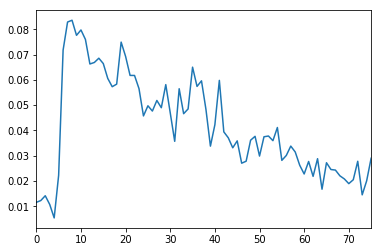

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorY_-200_to_0.dat


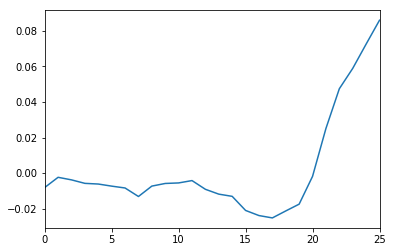

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorY_-200_to_200.dat


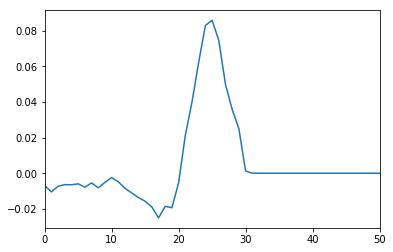

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorY_-80_to_-2.5.dat


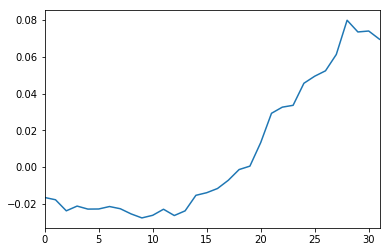

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-200_to_-8.dat


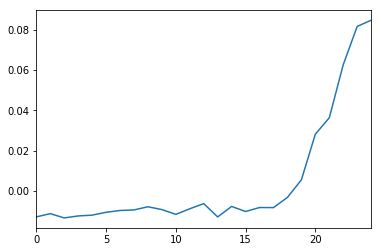

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-200_to_200.dat


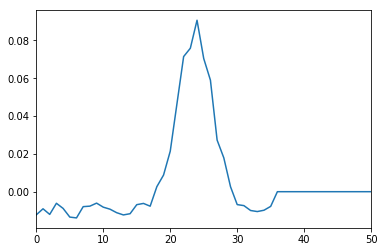

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-2500_to_-1500.dat


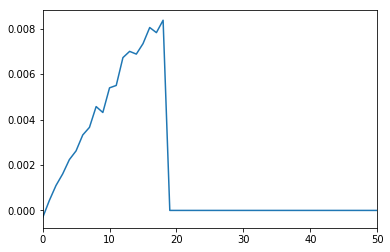

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-2500_to_-1500_run2.dat


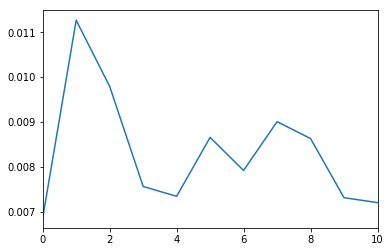

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-2500_to_-4000.dat


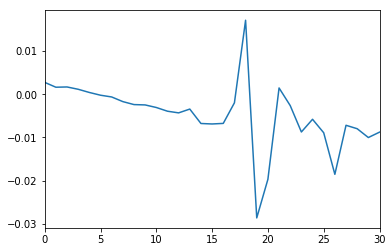

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-80_to_0.dat


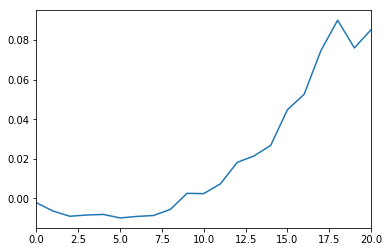

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_MirrorZ_-80_to_60.dat


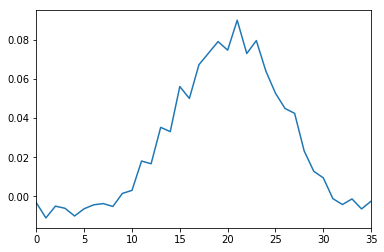

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_10_MirrorY -80_to_50 MirrorZ -35x.dat


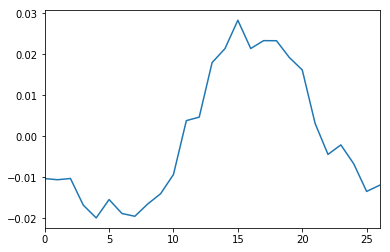

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_11_MirrorY -80_to_50 MirrorZ -30x.dat


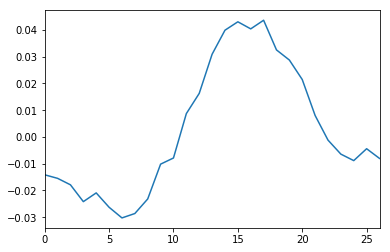

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_12_MirrorY -80_to_50 MirrorZ -25x.dat


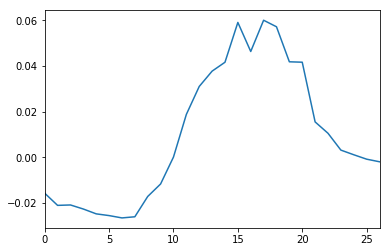

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_13_MirrorY -80_to_50 MirrorZ -20x.dat


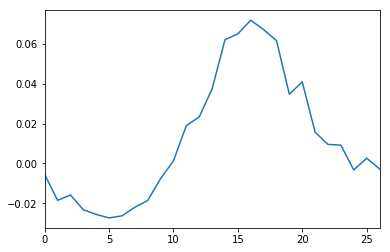

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_14_MirrorY -80_to_50 MirrorZ -15x.dat


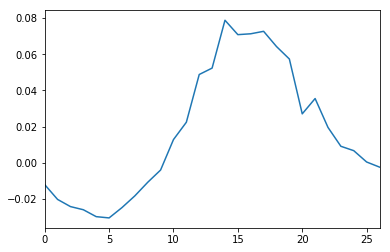

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_15_MirrorY -80_to_50 MirrorZ -10x.dat


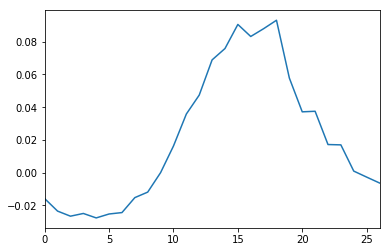

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_16_MirrorY -80_to_50 MirrorZ -5x.dat


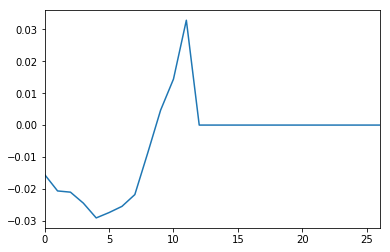

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_1_MirrorY -80_to_50 MirrorZ -80x.dat


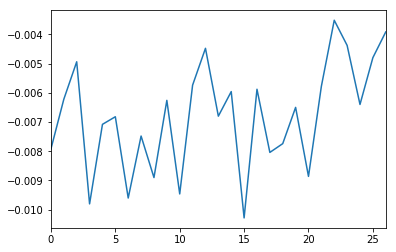

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_2_MirrorY -80_to_50 MirrorZ -75x.dat


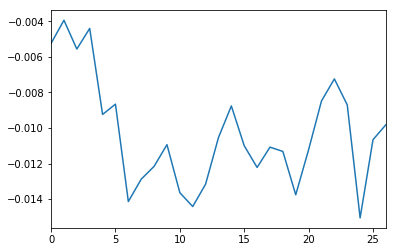

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_3_MirrorY -80_to_50 MirrorZ -70x.dat


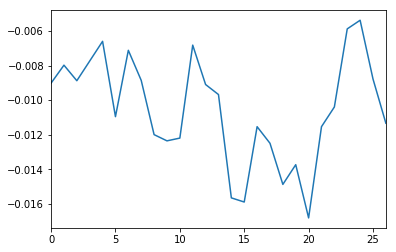

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_4_MirrorY -80_to_50 MirrorZ -65x.dat


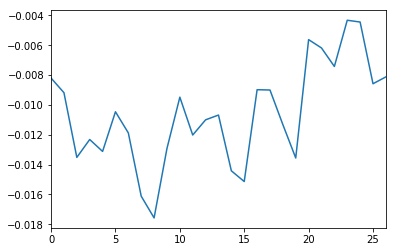

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_5_MirrorY -80_to_50 MirrorZ -60x.dat


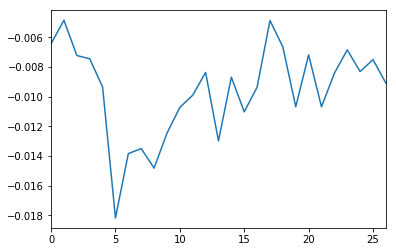

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_6_MirrorY -80_to_50 MirrorZ -55x.dat


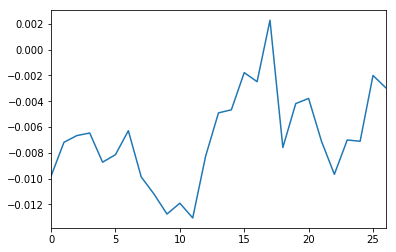

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_7_MirrorY -80_to_50 MirrorZ -50x.dat


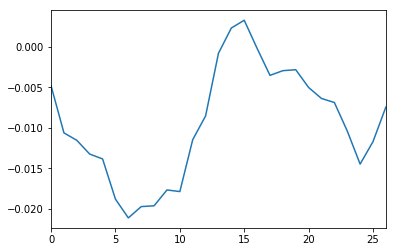

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_8_MirrorY -80_to_50 MirrorZ -45x.dat


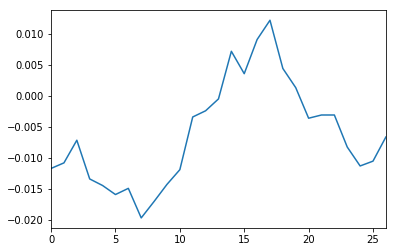

C:\Data\apr2017\170405\GeneralScan_033XT-B11_819.0nm_30K_2Dscan_MirrorZ_MirrorY\Ind_9_MirrorY -80_to_50 MirrorZ -40x.dat


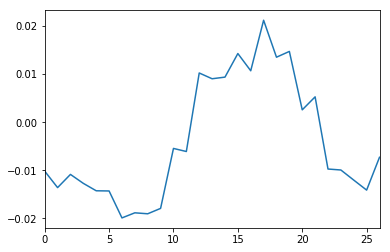

C:\Data\apr2017\170407\SignalMagnitudeTest_probe200uW___818.56nm_10K_DelayTime_-500_to_3000.dat


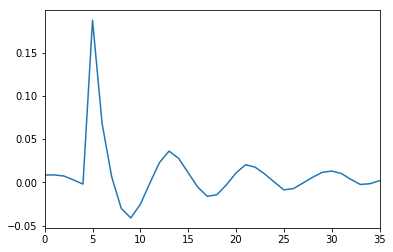

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


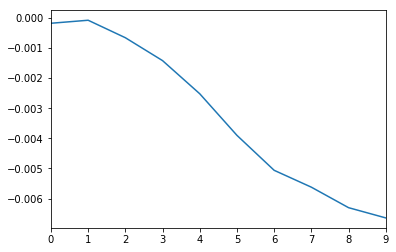

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


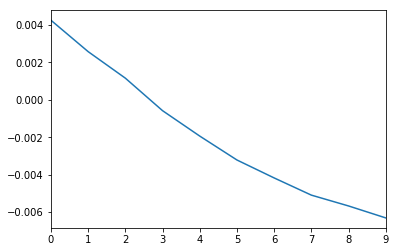

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


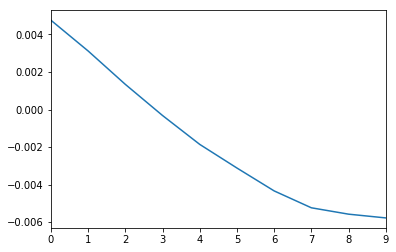

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


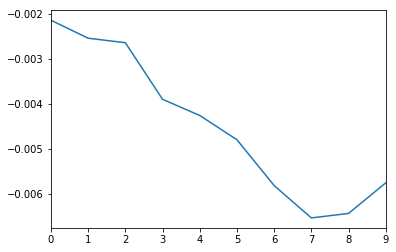

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


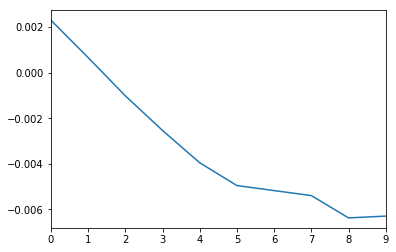

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


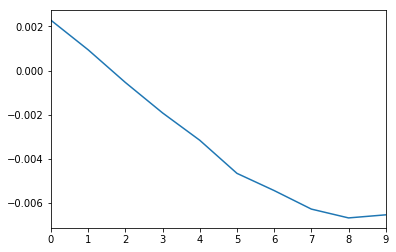

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


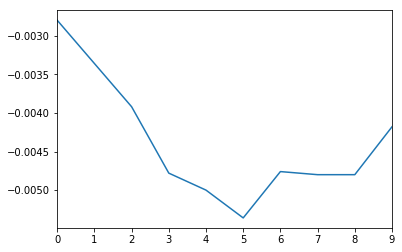

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


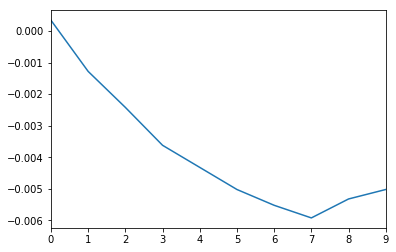

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


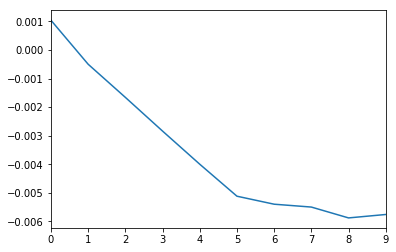

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


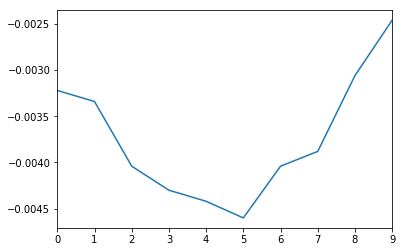

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


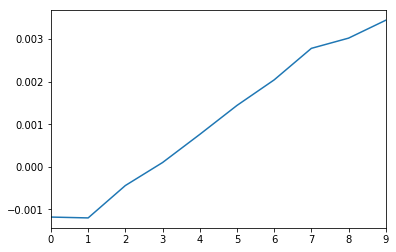

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


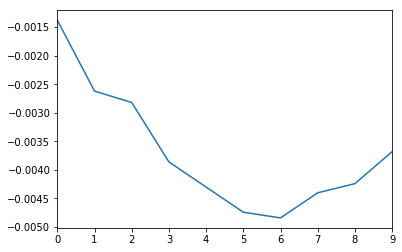

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


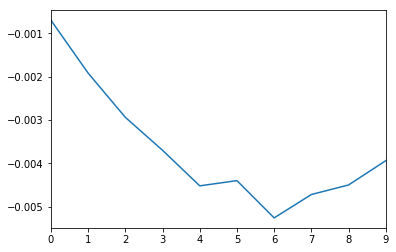

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


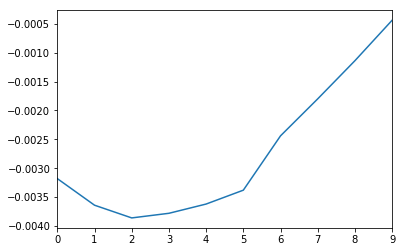

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


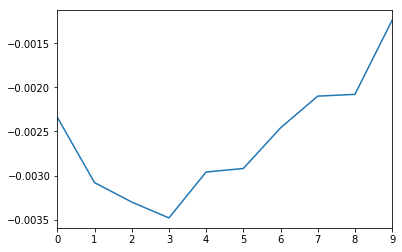

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


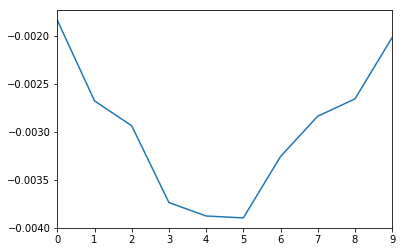

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


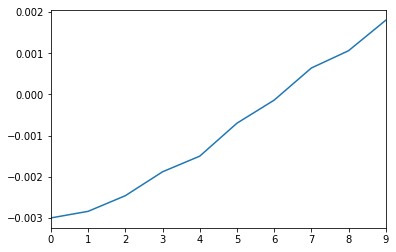

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


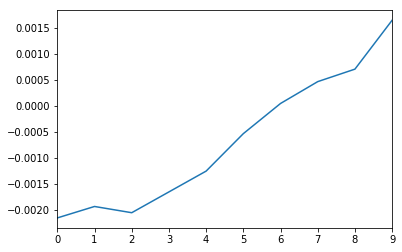

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


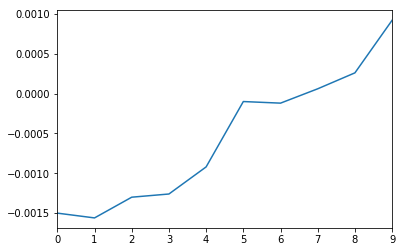

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


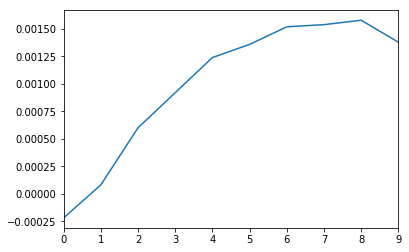

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


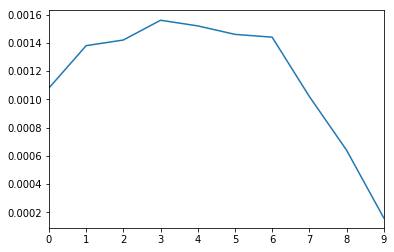

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


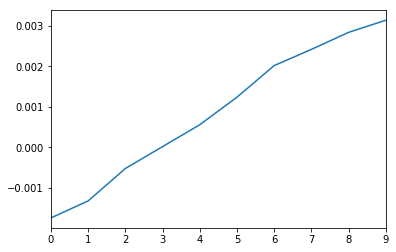

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


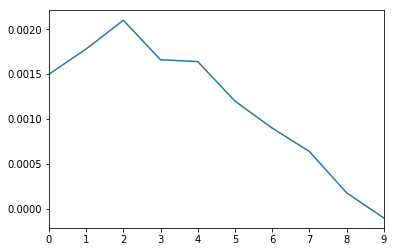

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


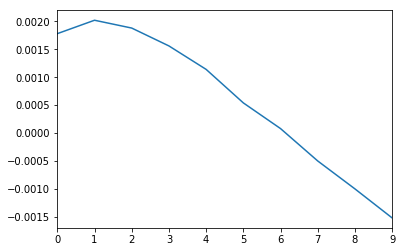

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


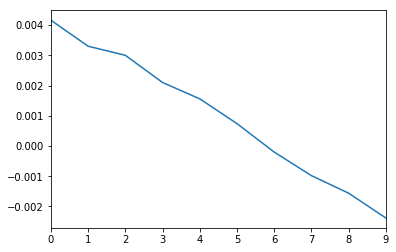

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


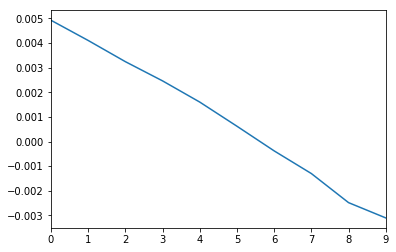

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


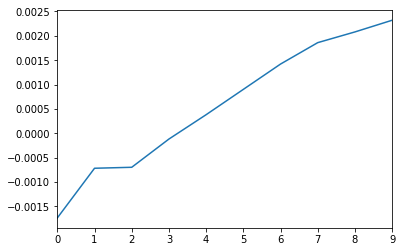

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


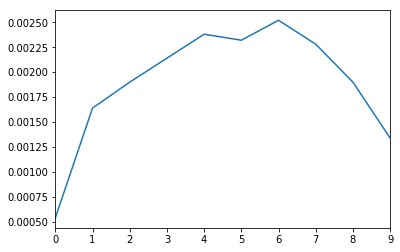

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


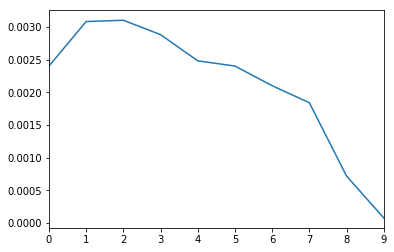

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


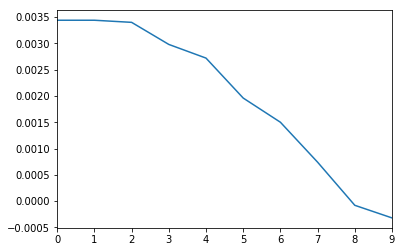

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


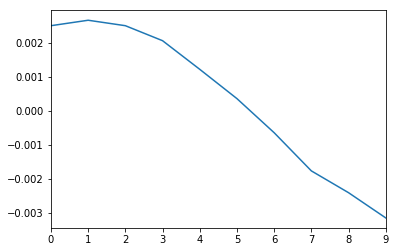

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


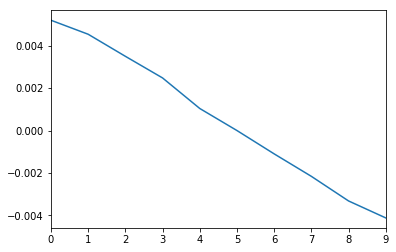

C:\Data\apr2017\170407\PhaseLockTest_probe052uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


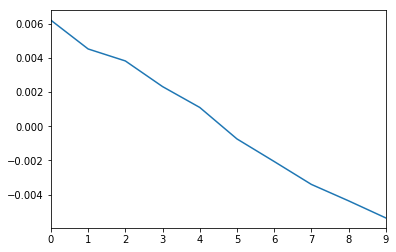

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


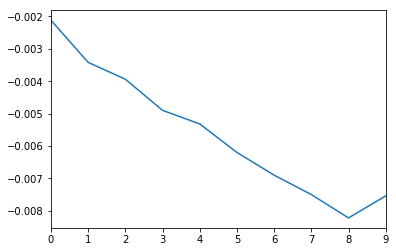

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


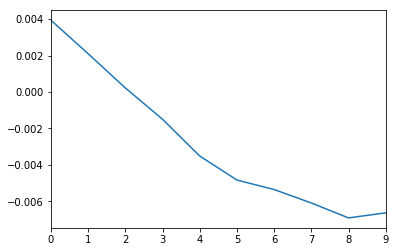

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


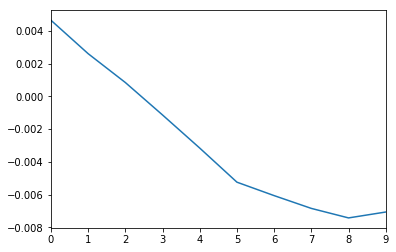

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


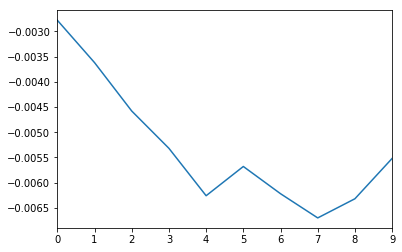

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


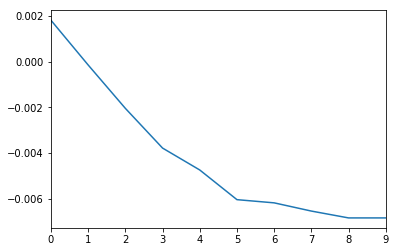

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


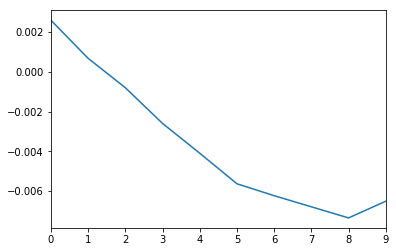

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


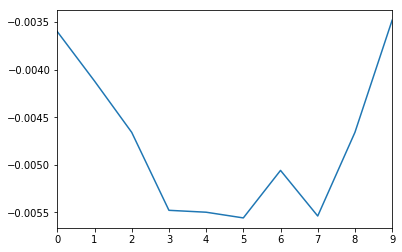

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


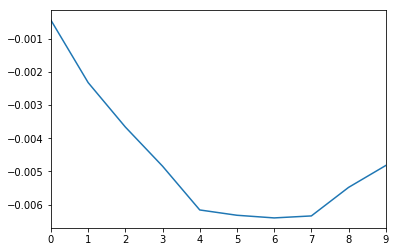

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


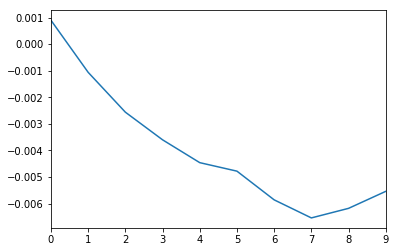

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


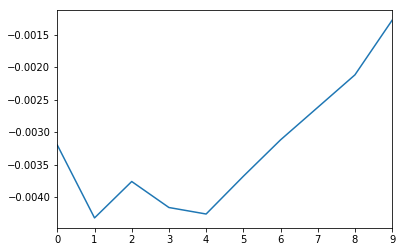

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


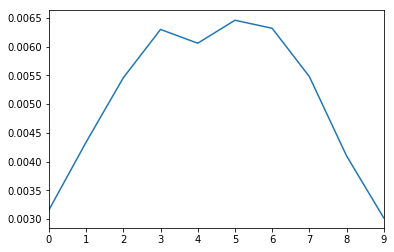

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


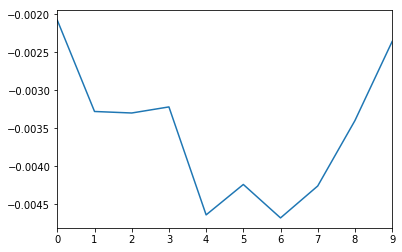

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


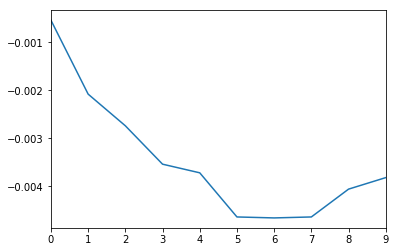

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


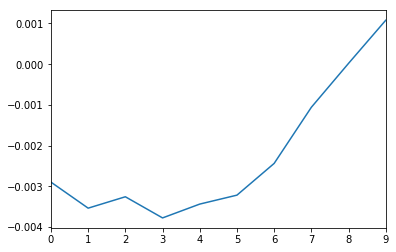

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


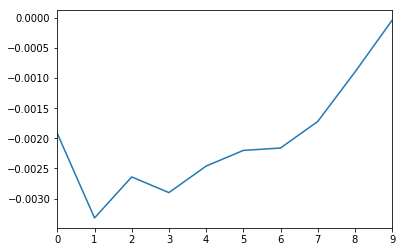

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


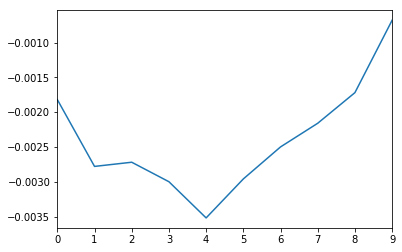

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


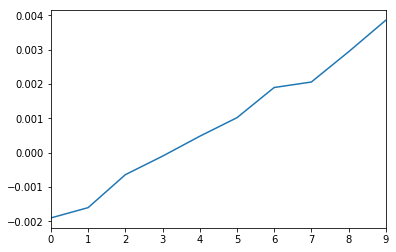

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


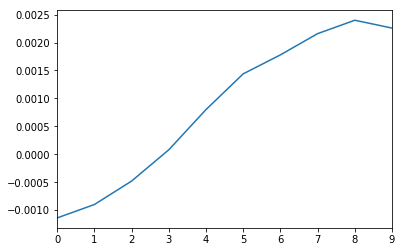

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


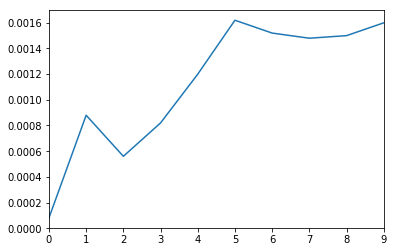

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


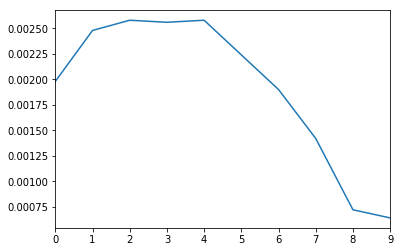

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


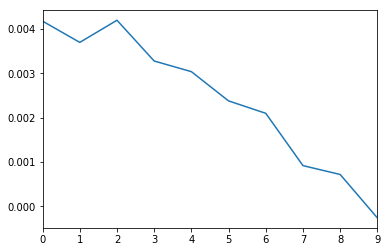

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


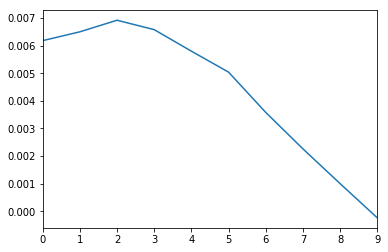

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


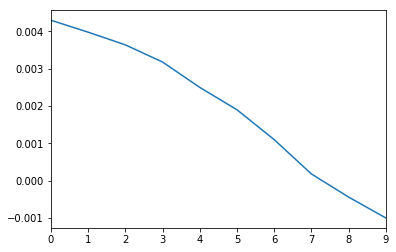

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


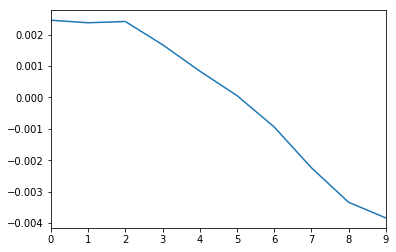

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


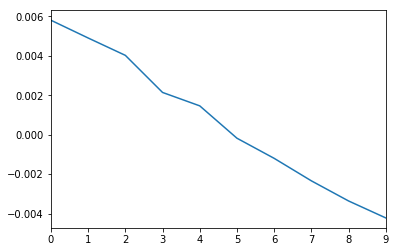

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


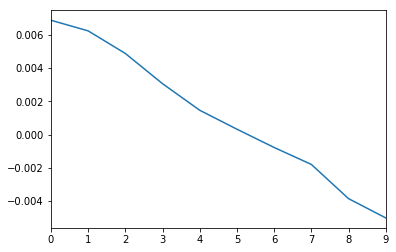

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


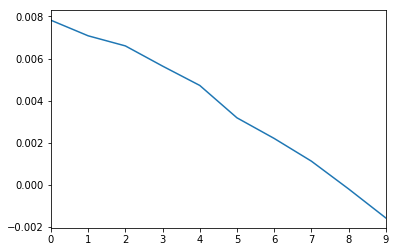

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


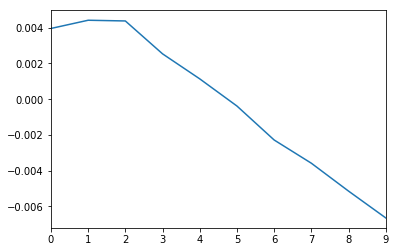

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


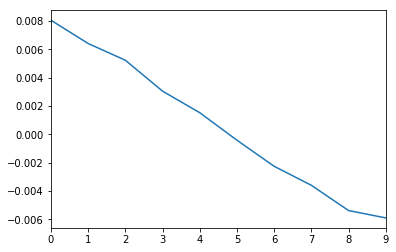

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


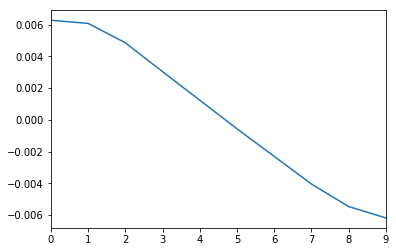

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


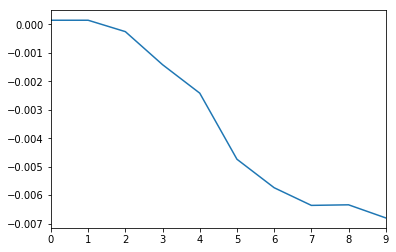

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


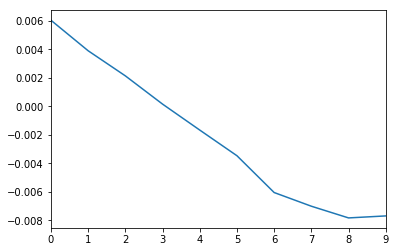

C:\Data\apr2017\170407\PhaseLockTest_probe090uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


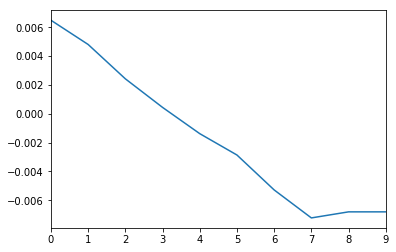

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


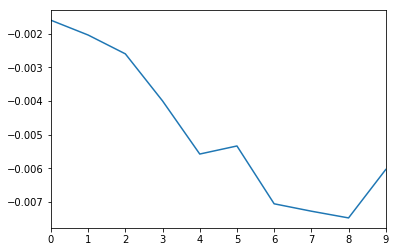

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


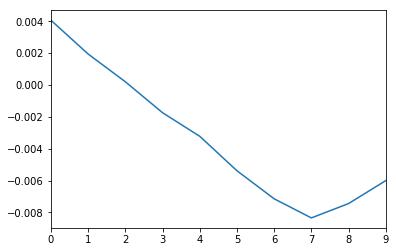

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


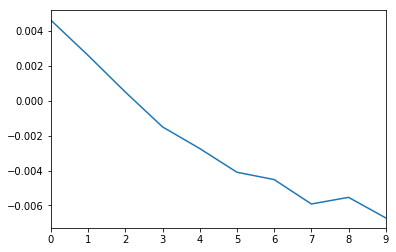

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


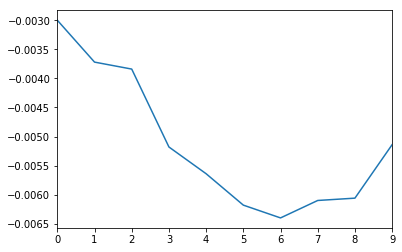

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


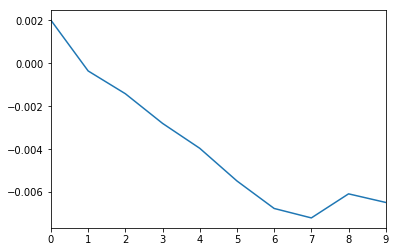

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


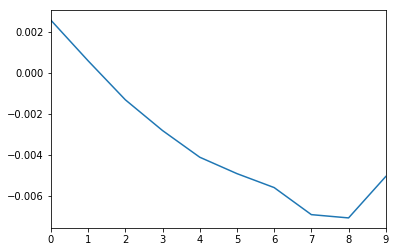

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


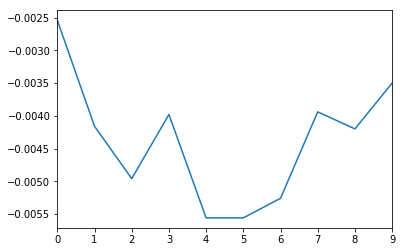

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


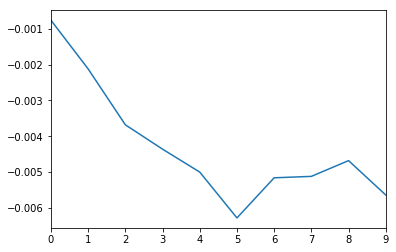

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


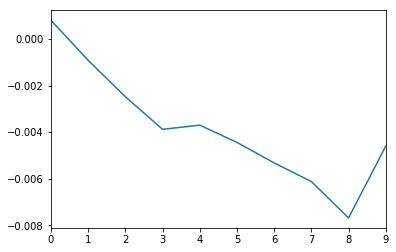

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


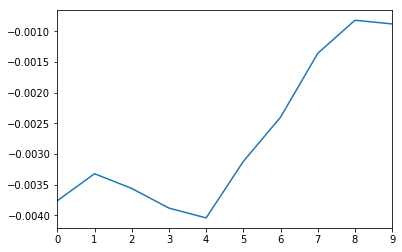

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


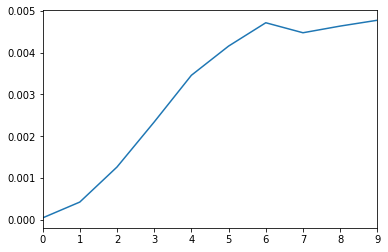

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


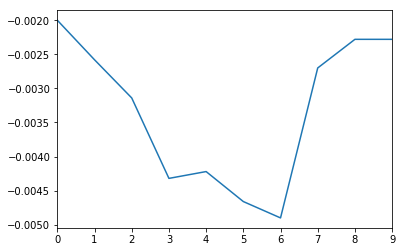

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


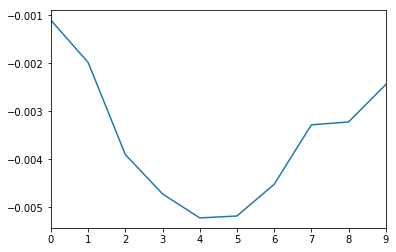

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


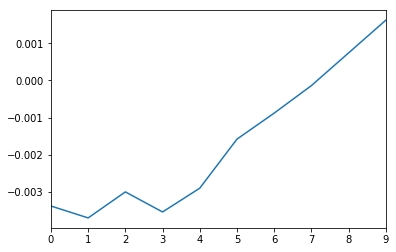

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


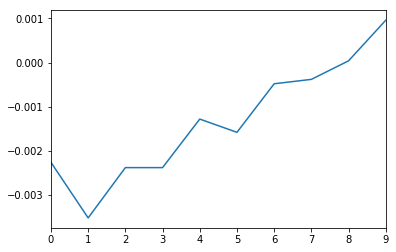

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


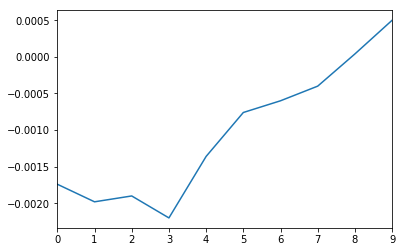

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


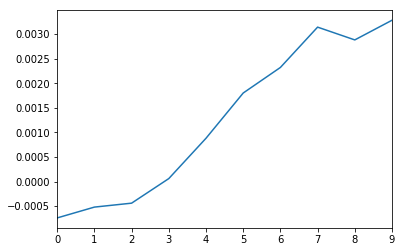

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


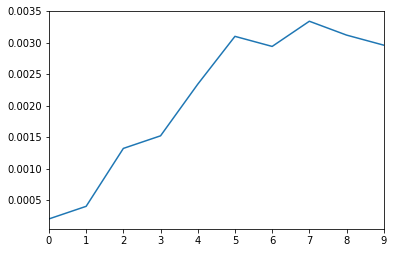

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


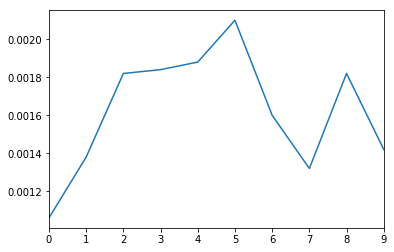

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


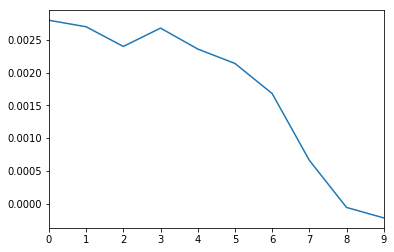

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


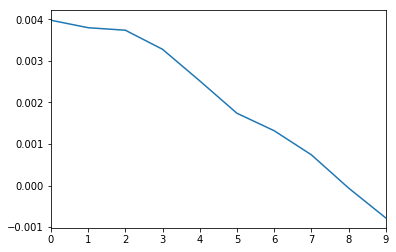

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


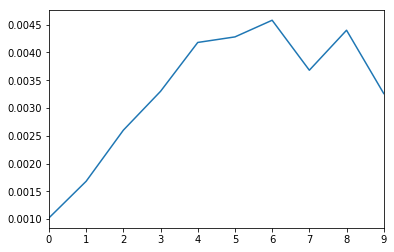

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


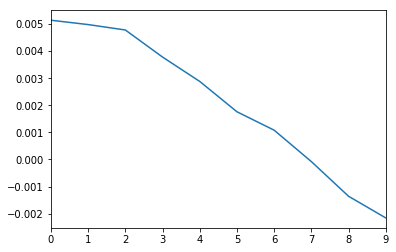

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


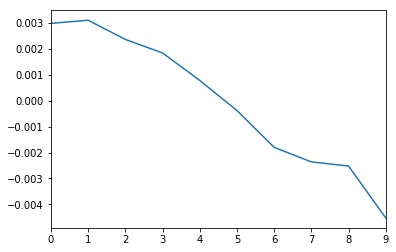

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


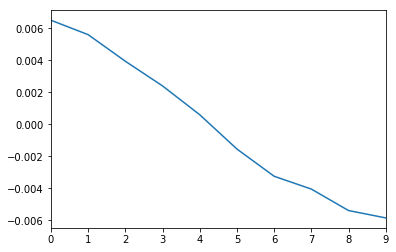

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


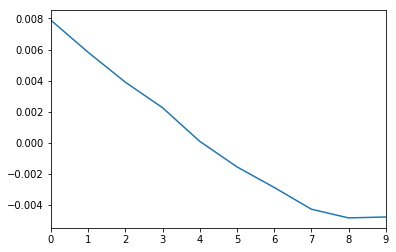

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


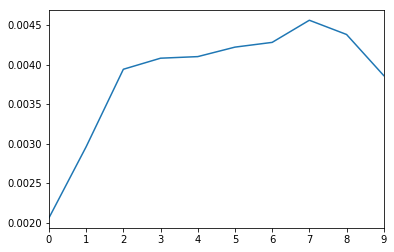

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


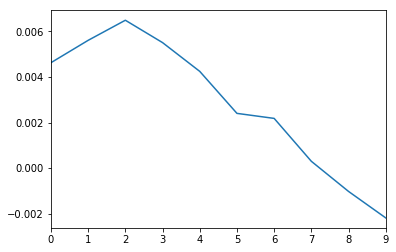

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


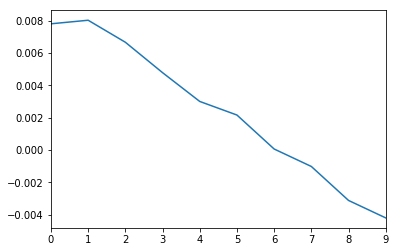

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


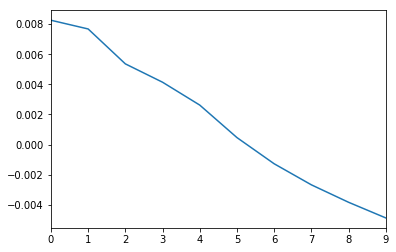

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


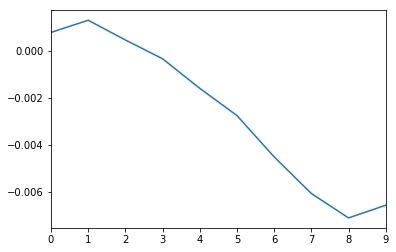

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


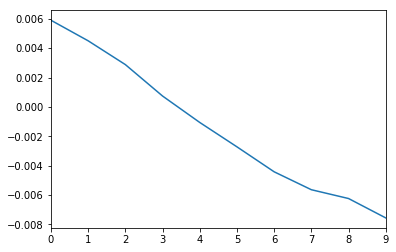

C:\Data\apr2017\170407\PhaseLockTest_probe130uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


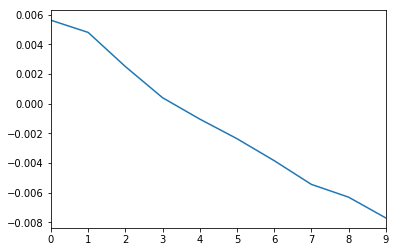

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


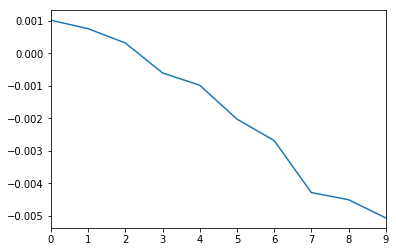

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


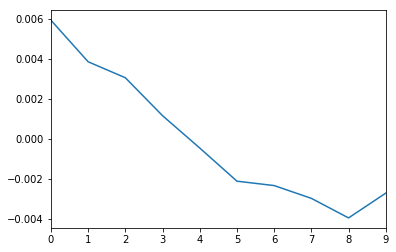

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


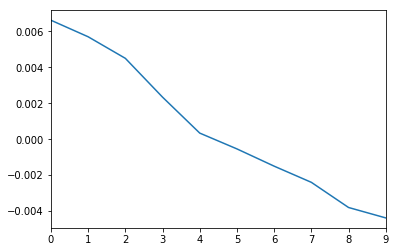

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


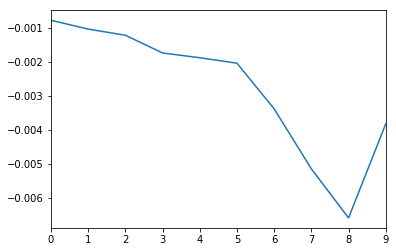

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


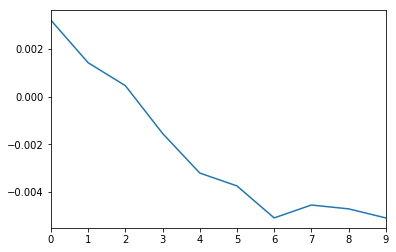

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


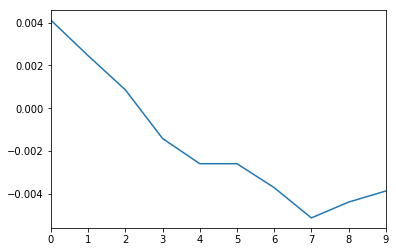

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


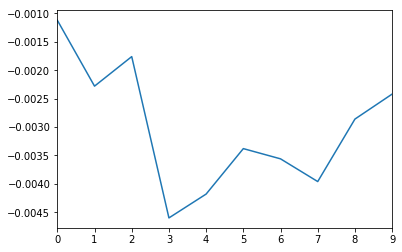

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


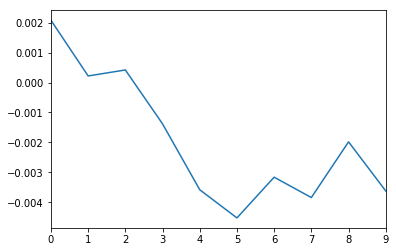

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


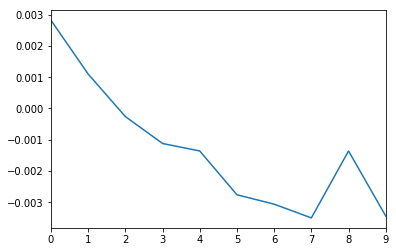

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


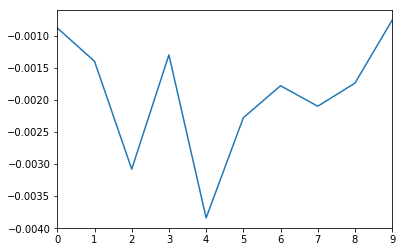

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


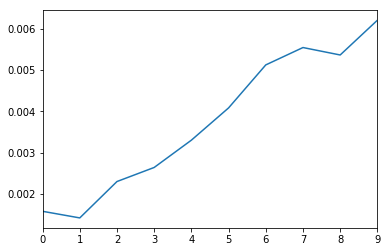

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


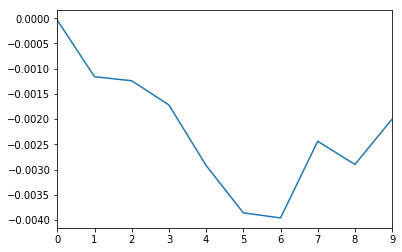

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


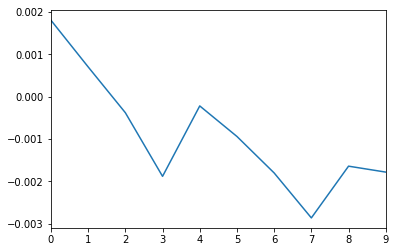

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


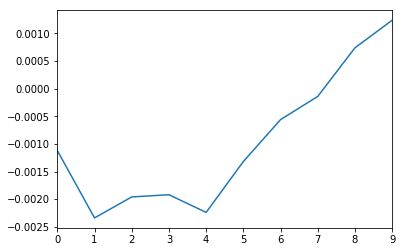

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


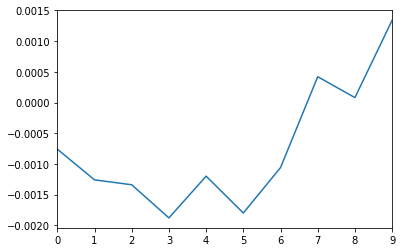

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


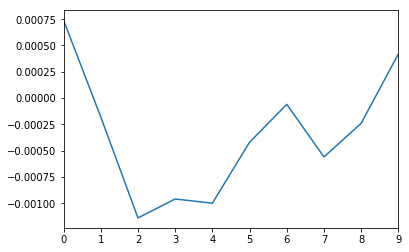

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


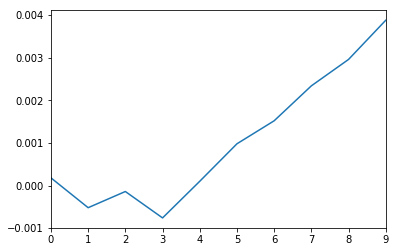

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


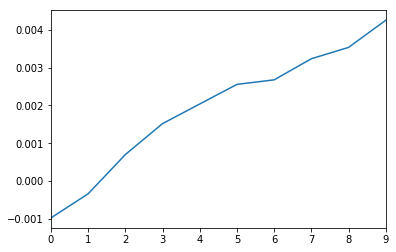

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


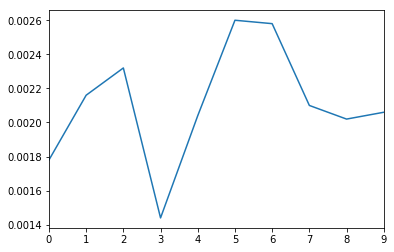

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


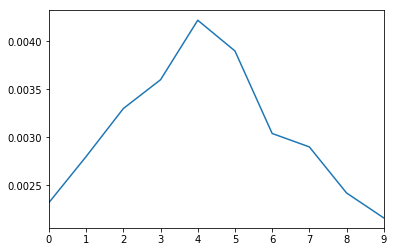

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


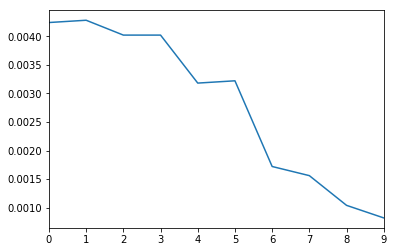

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


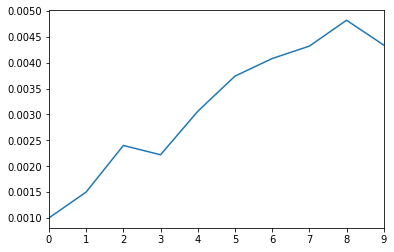

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


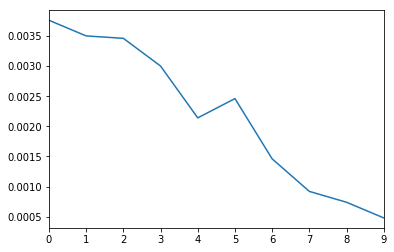

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


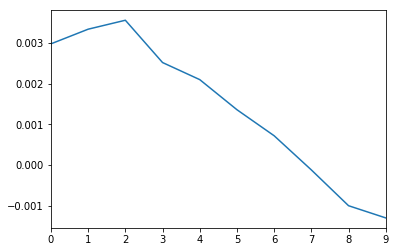

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


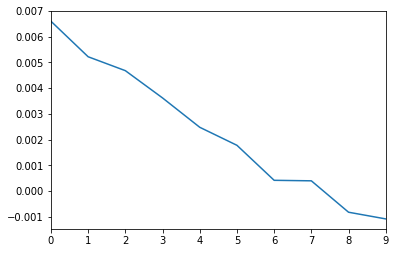

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


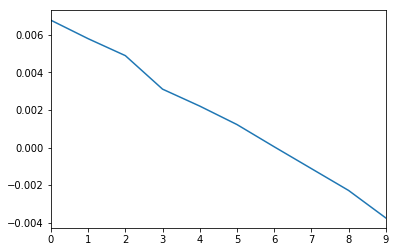

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


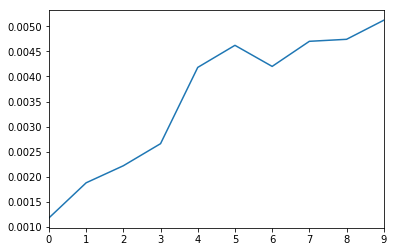

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


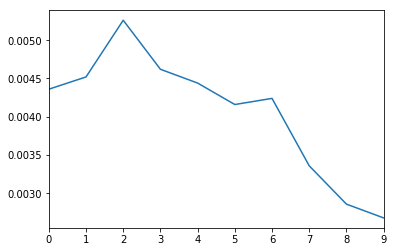

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


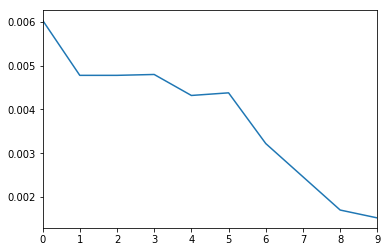

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


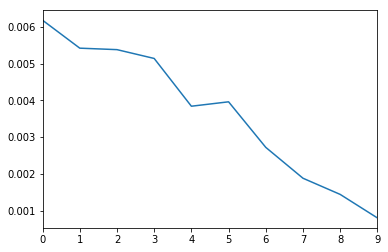

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


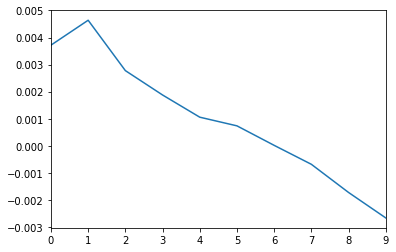

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


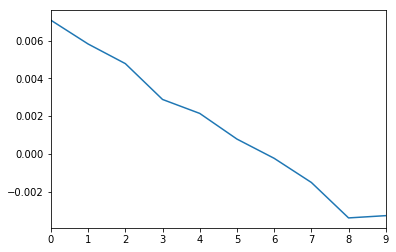

C:\Data\apr2017\170407\PhaseLockTest_probe168uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


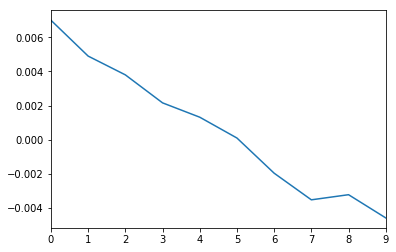

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


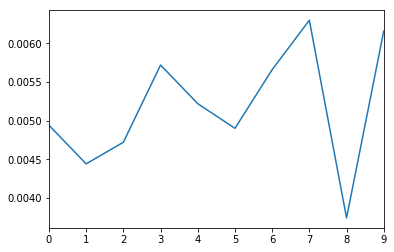

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


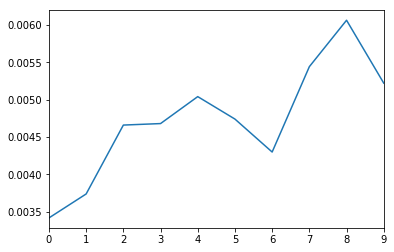

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


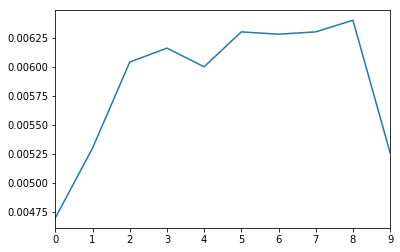

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


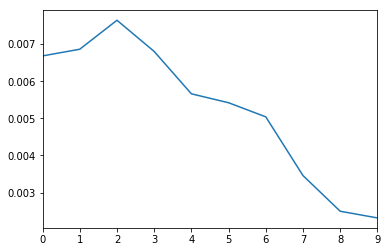

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


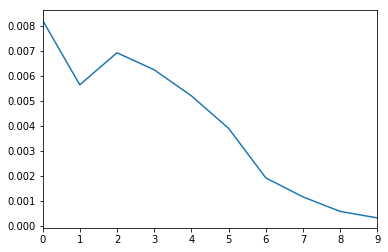

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


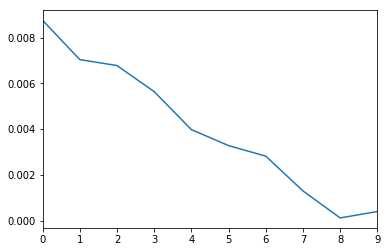

C:\Data\apr2017\170407\PhaseLockTest_probe200uW___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


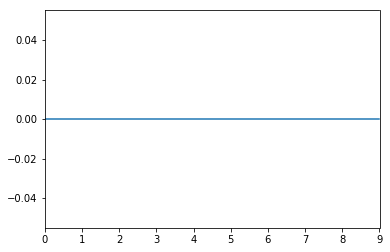

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


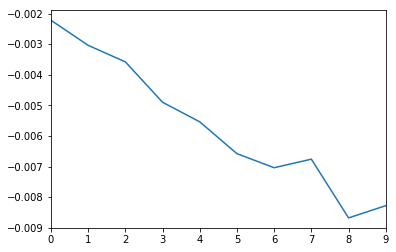

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


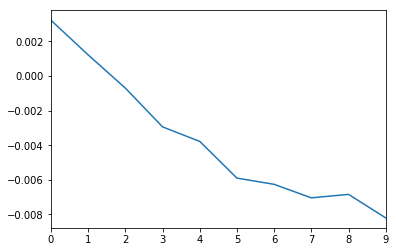

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


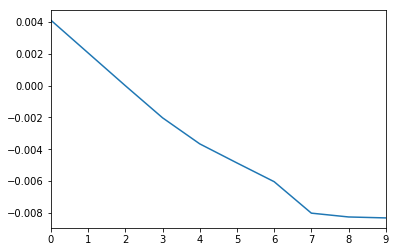

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


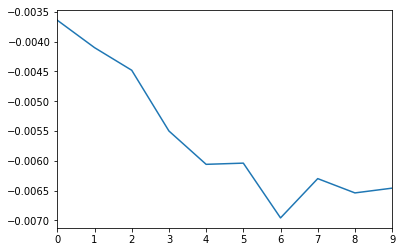

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


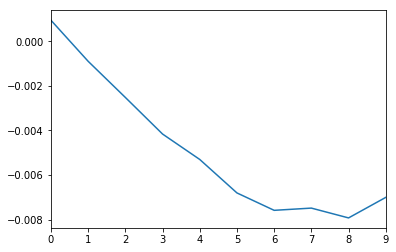

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


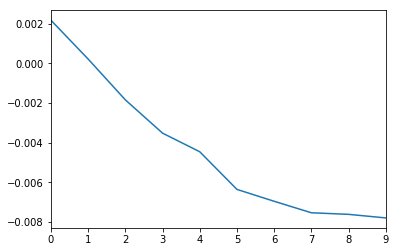

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


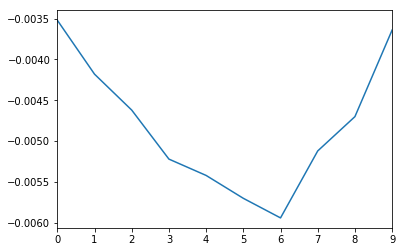

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


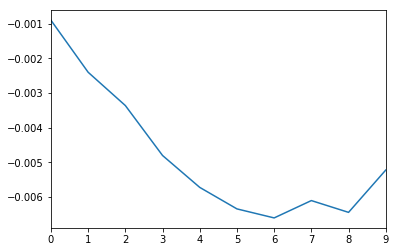

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


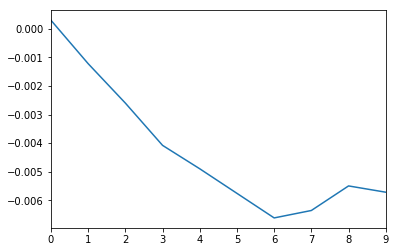

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


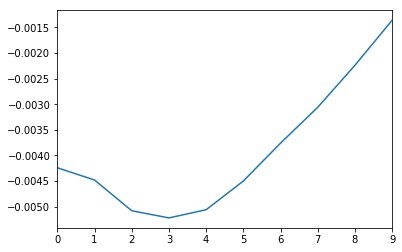

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


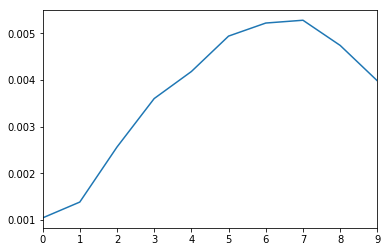

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


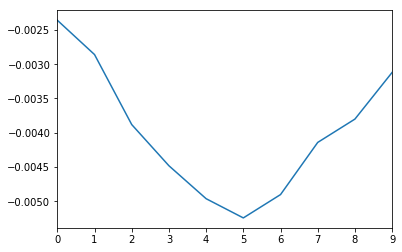

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


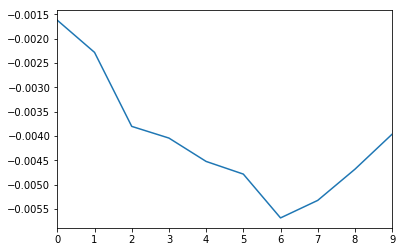

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


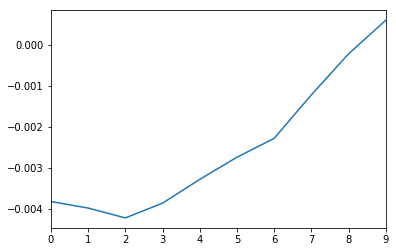

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


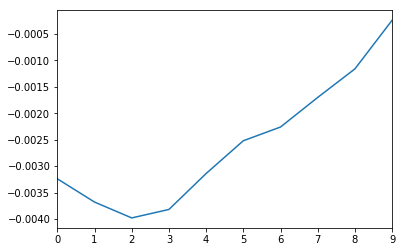

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


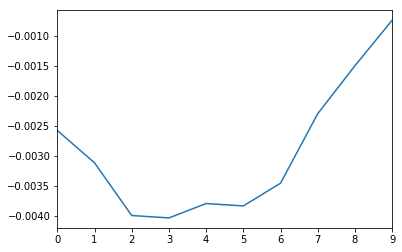

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


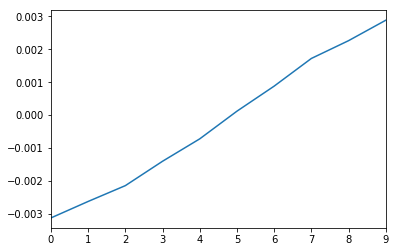

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


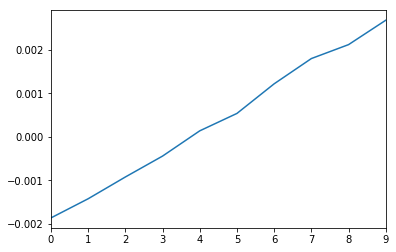

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


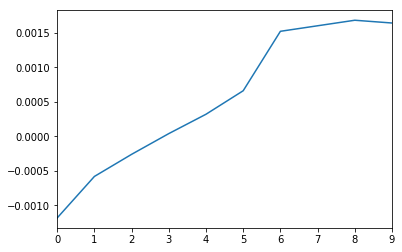

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


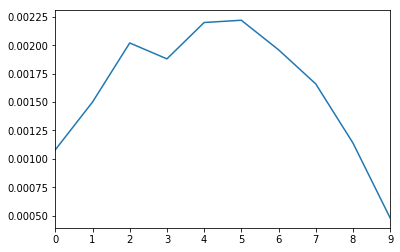

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


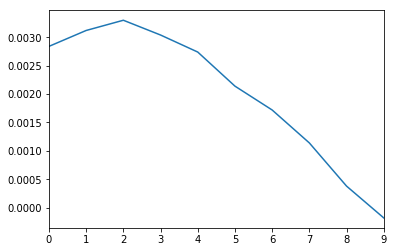

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


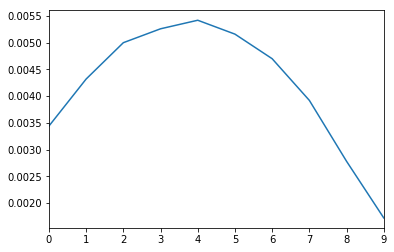

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


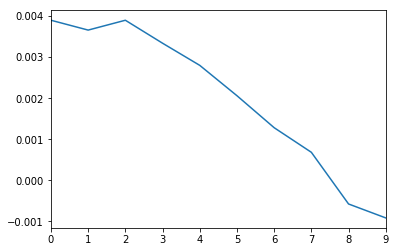

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


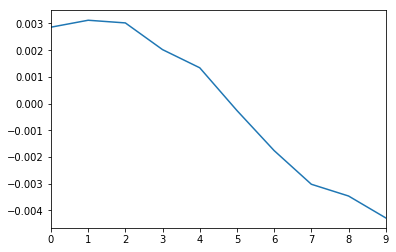

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


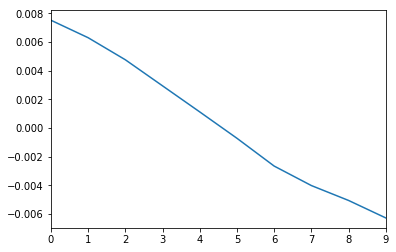

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


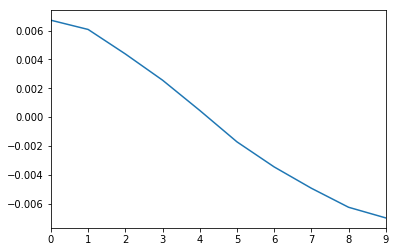

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


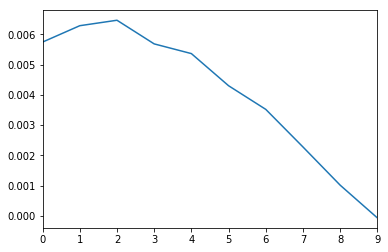

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


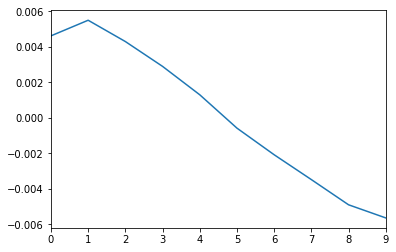

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


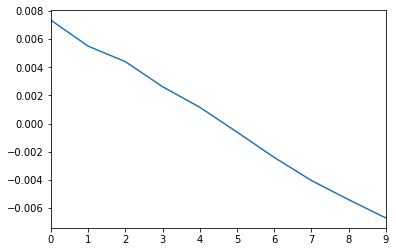

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


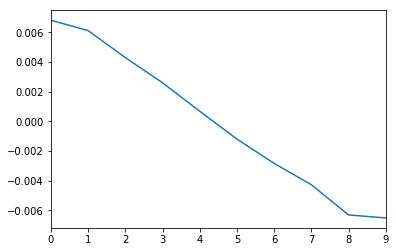

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


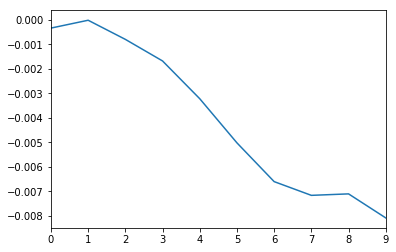

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


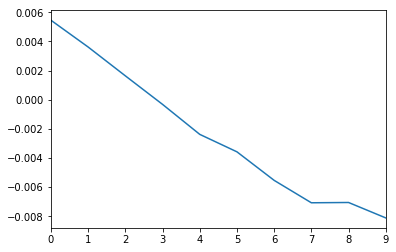

C:\Data\apr2017\170407\PhaseLockTest_probe71uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


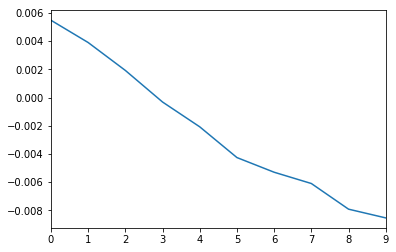

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


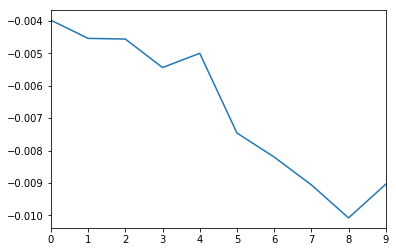

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


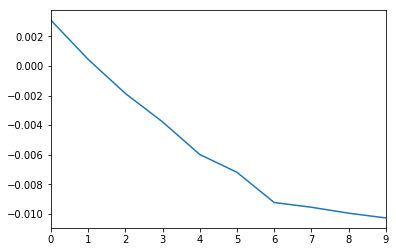

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


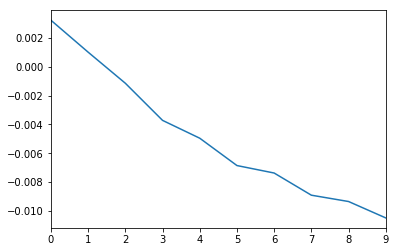

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


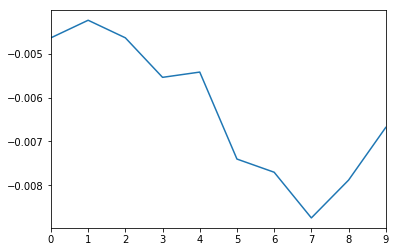

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


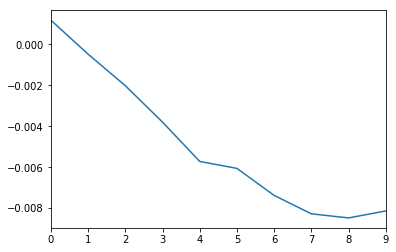

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


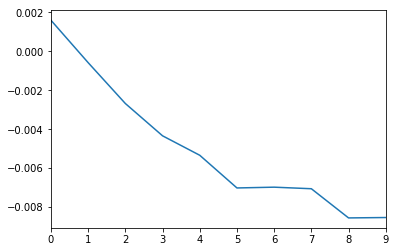

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


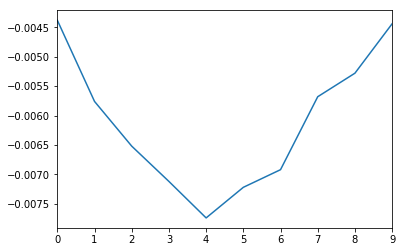

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


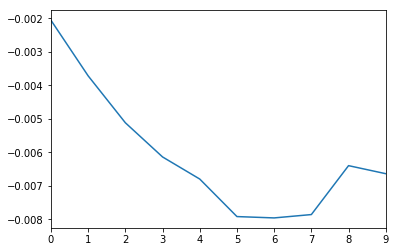

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


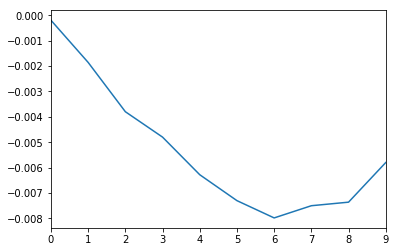

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


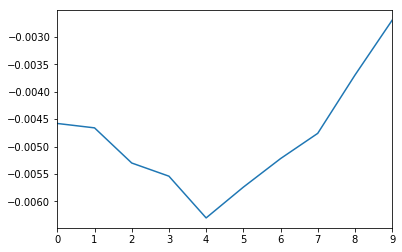

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


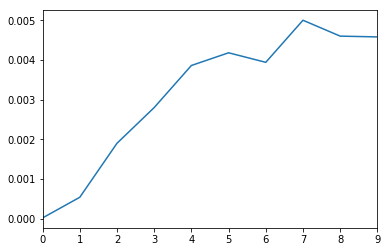

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


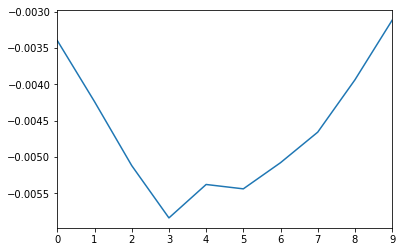

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


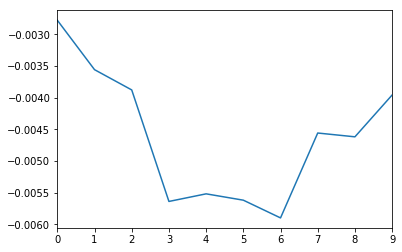

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


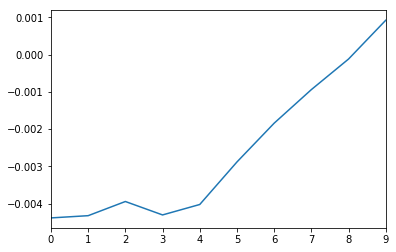

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


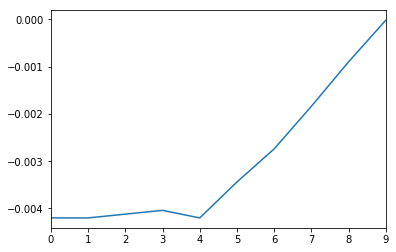

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


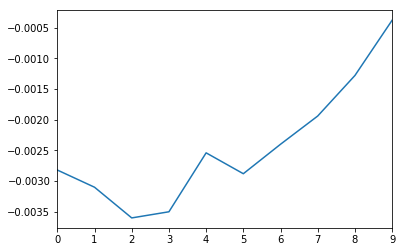

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


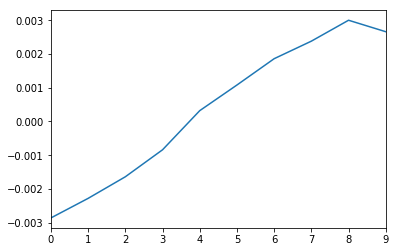

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


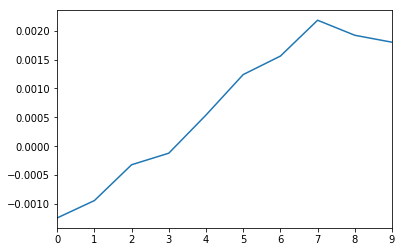

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


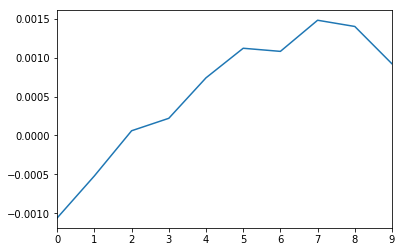

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


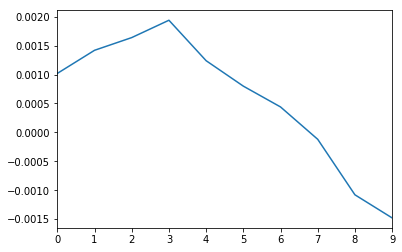

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


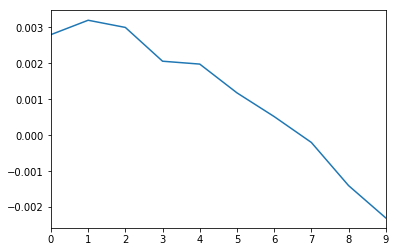

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


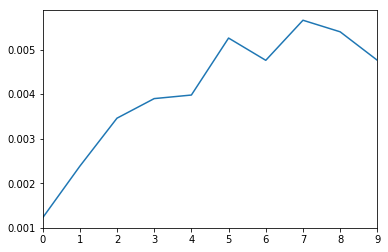

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


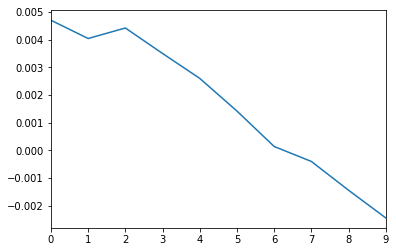

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


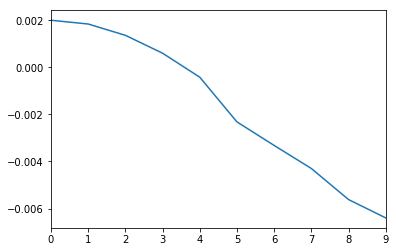

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


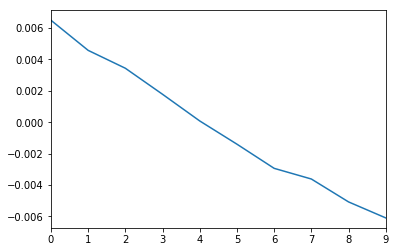

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


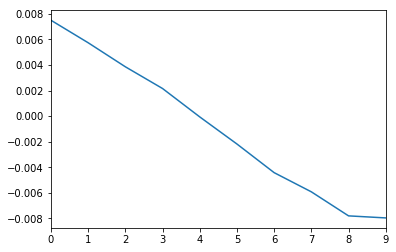

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


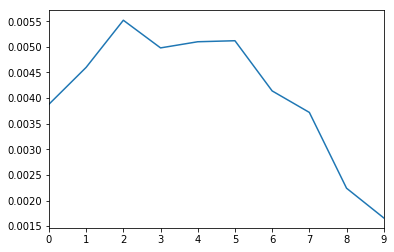

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


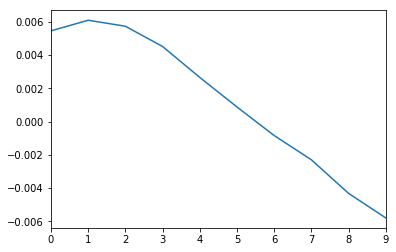

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


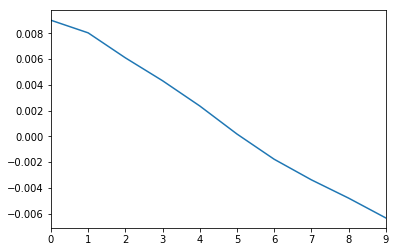

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


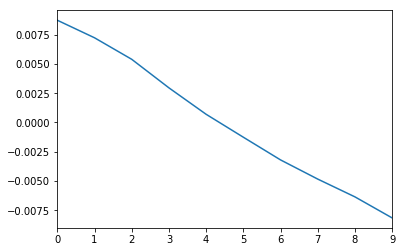

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


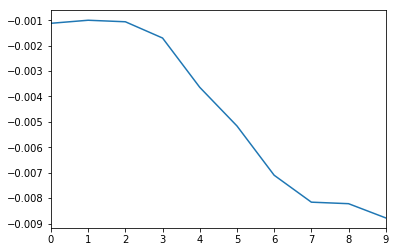

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


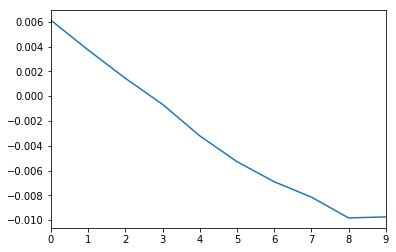

C:\Data\apr2017\170407\PhaseLockTest_probe96uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


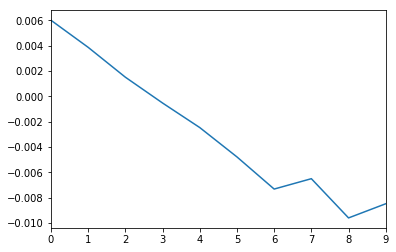

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


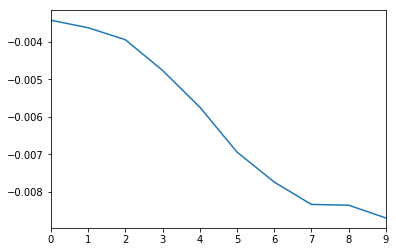

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


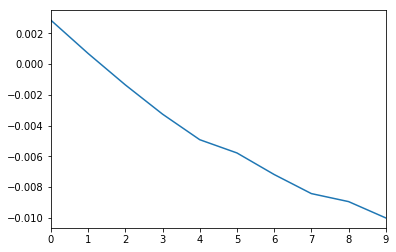

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


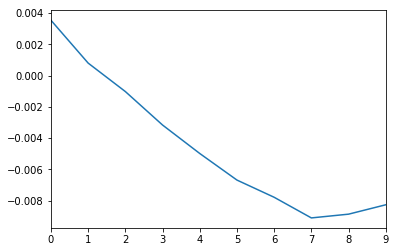

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


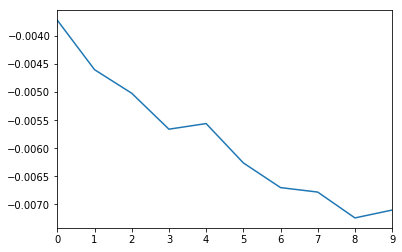

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


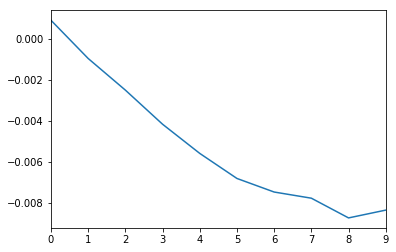

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


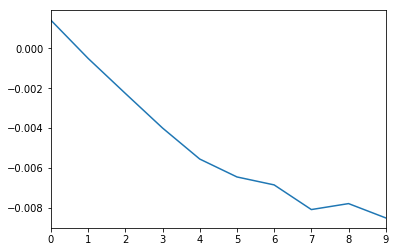

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


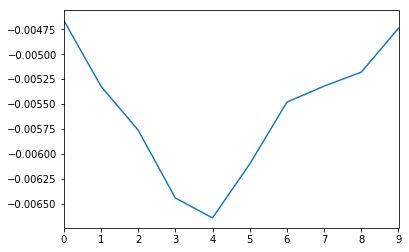

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


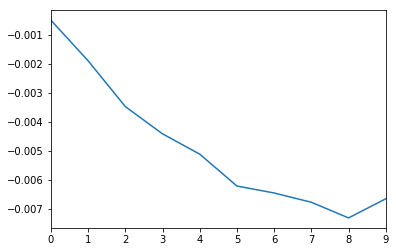

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


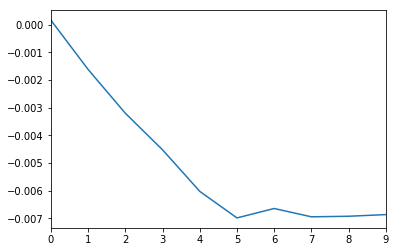

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


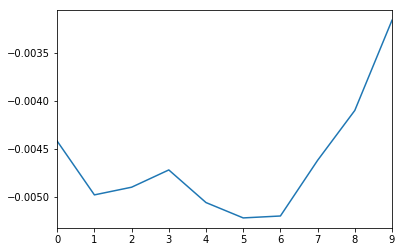

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


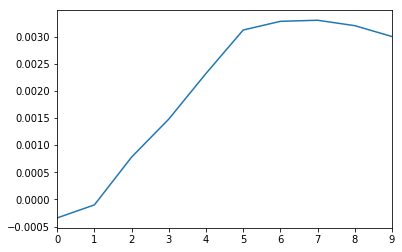

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


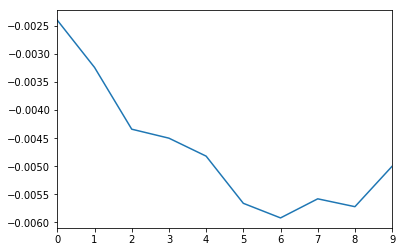

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


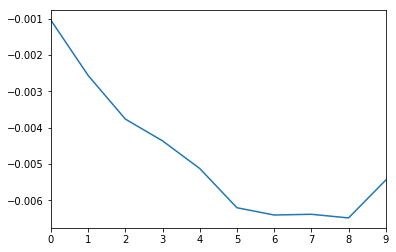

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


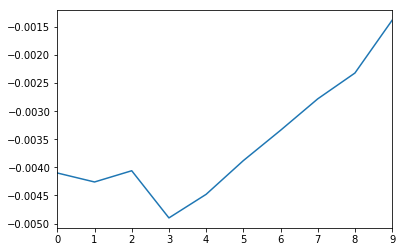

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


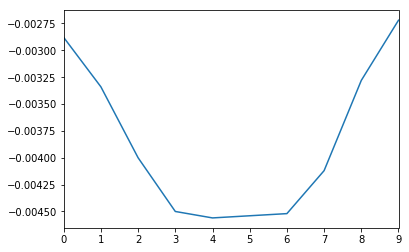

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


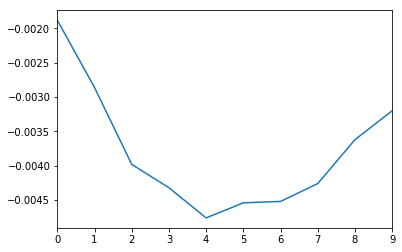

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


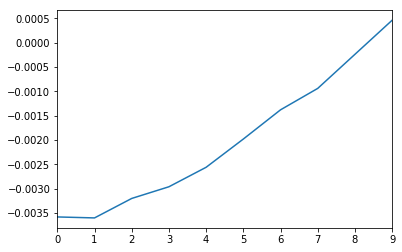

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


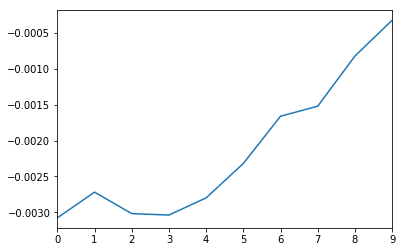

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


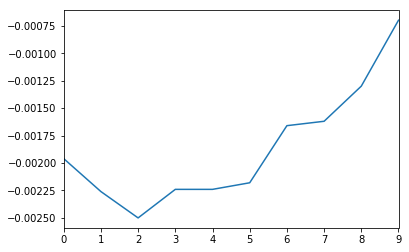

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


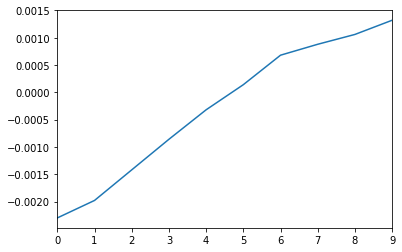

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


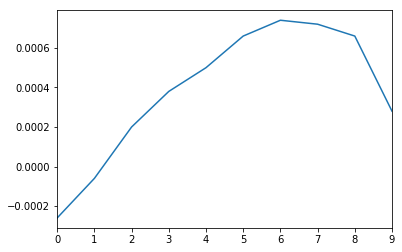

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


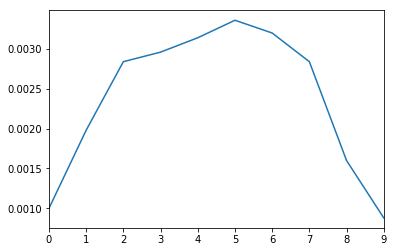

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


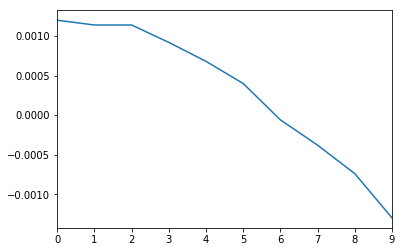

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


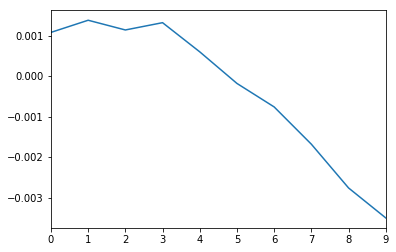

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


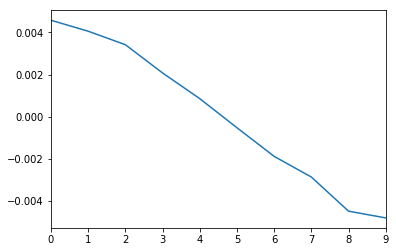

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


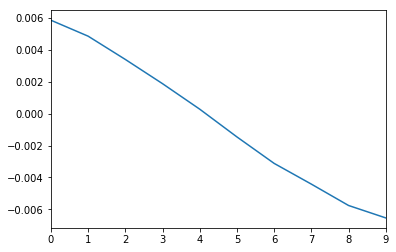

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


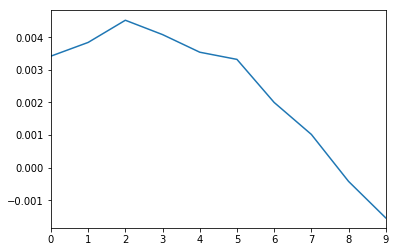

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


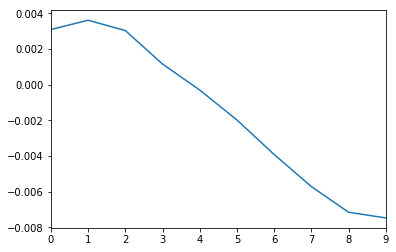

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


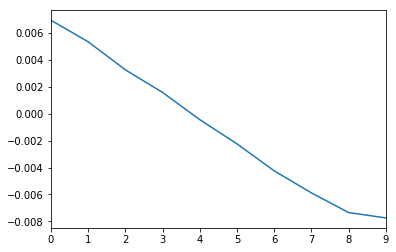

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


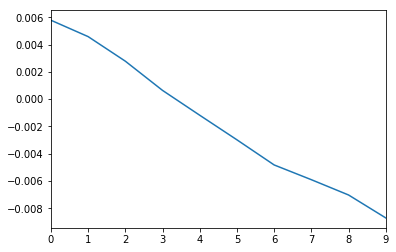

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


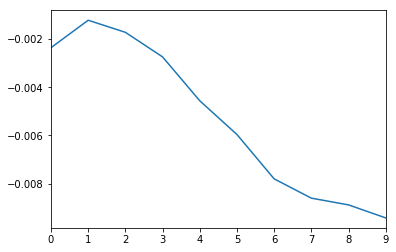

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


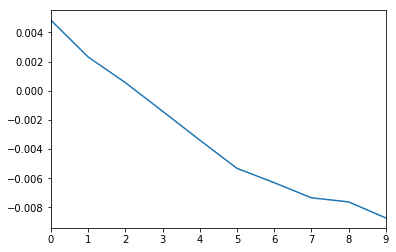

C:\Data\apr2017\170407\PhaseLockTest_pump0530uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


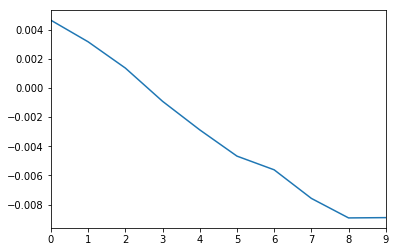

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


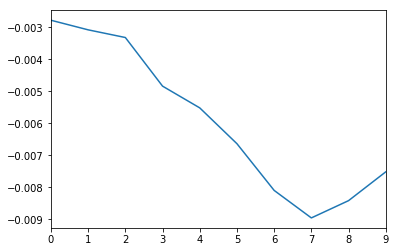

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


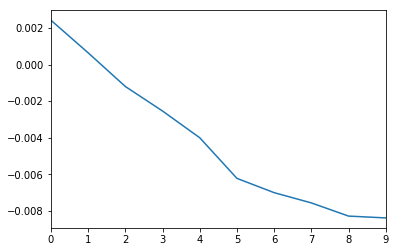

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


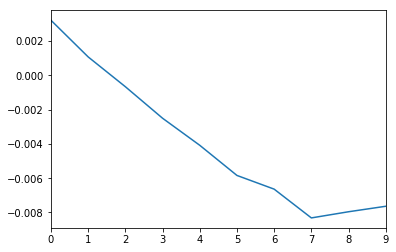

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


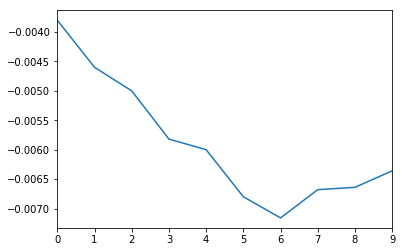

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


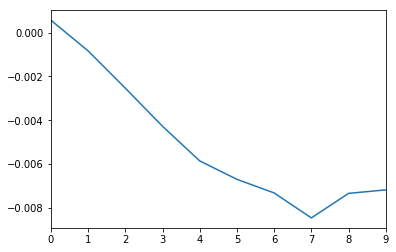

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


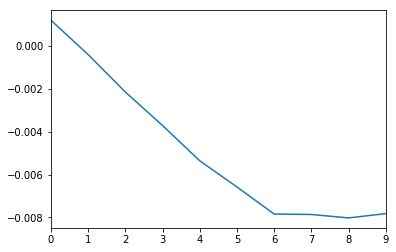

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


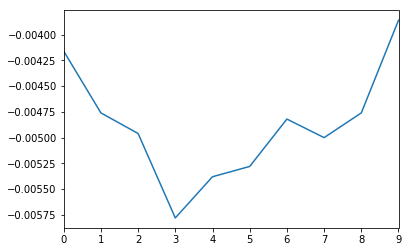

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


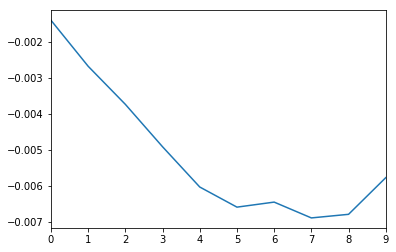

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


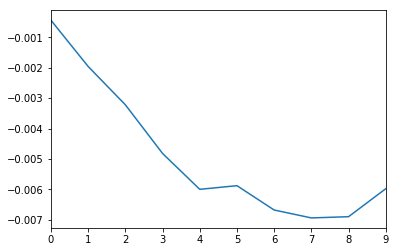

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


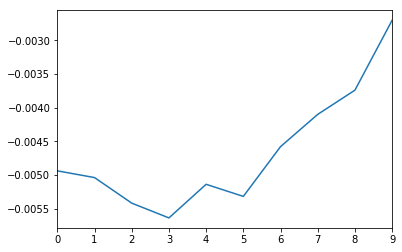

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


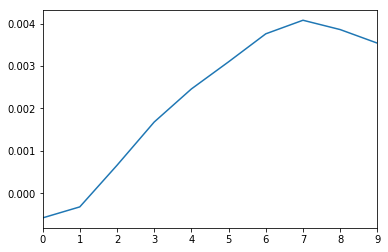

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


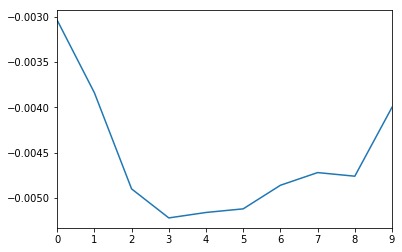

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


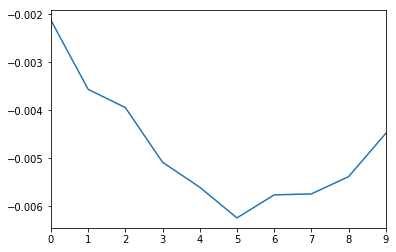

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


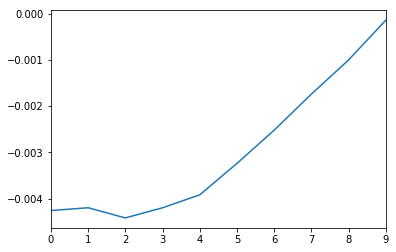

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


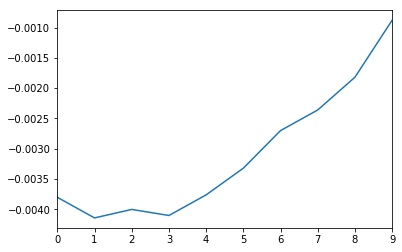

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


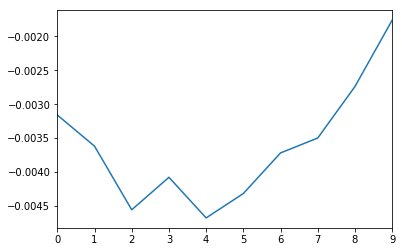

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


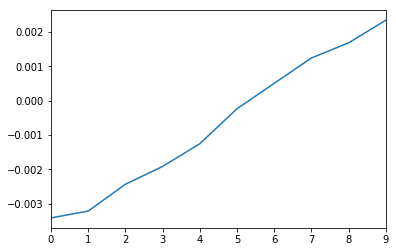

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


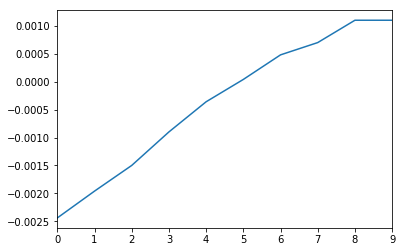

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


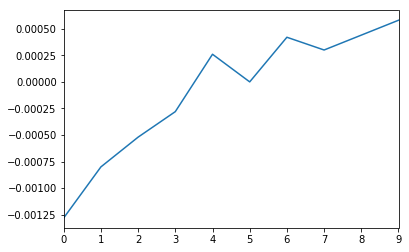

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


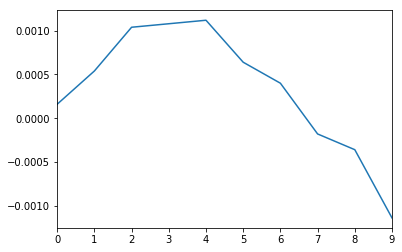

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


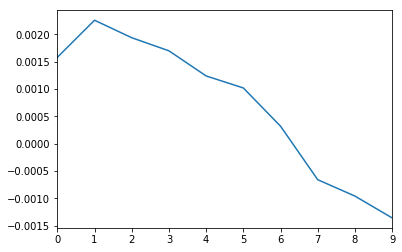

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


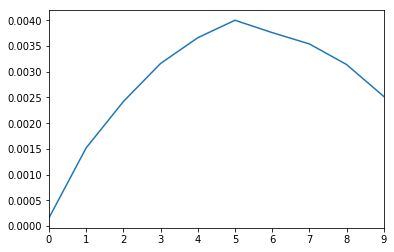

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


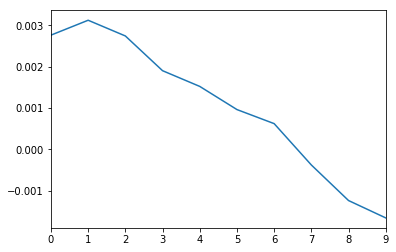

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


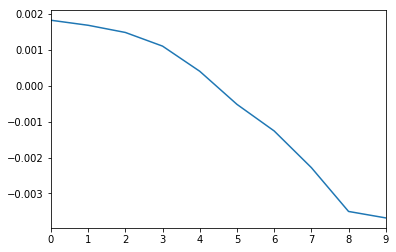

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


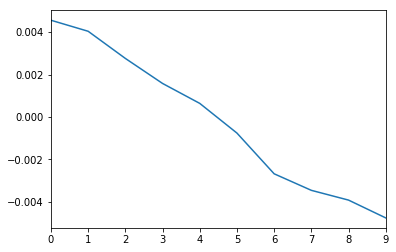

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


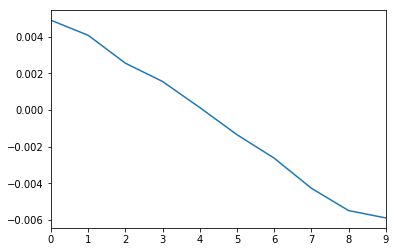

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


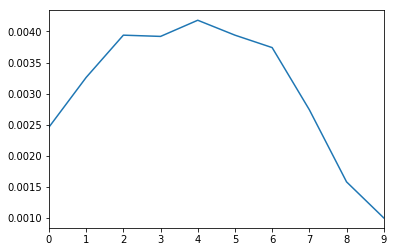

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


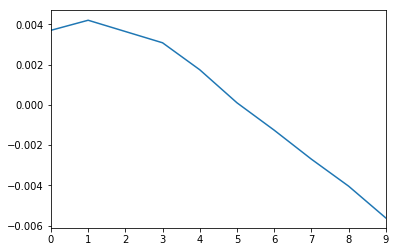

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


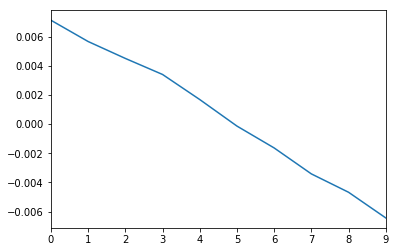

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


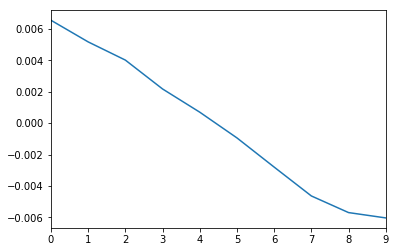

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


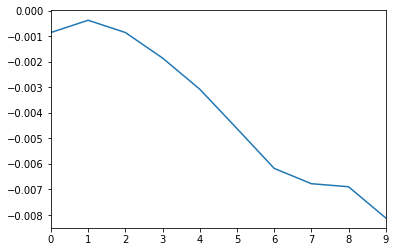

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


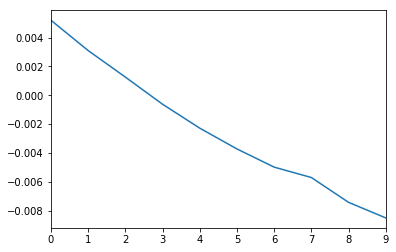

C:\Data\apr2017\170407\PhaseLockTest_pump0930uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


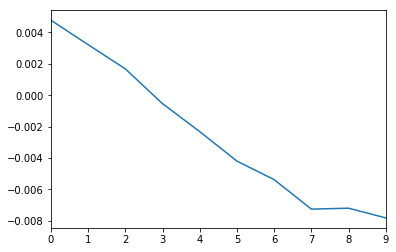

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


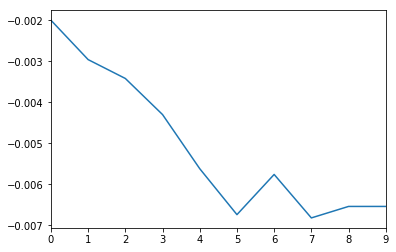

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


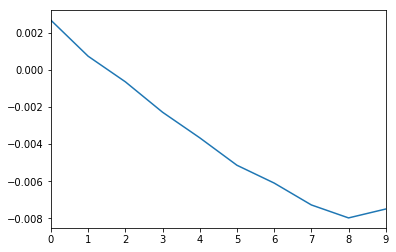

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


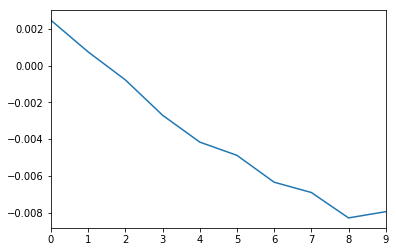

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


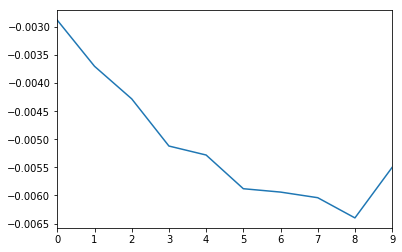

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


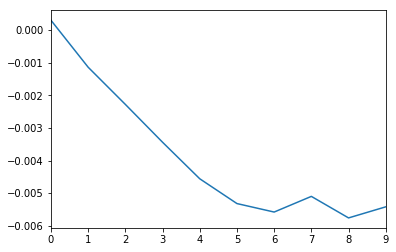

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


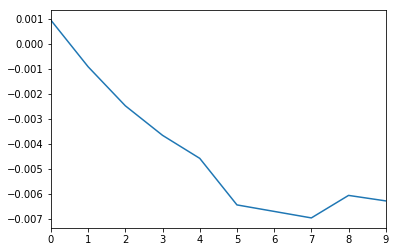

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


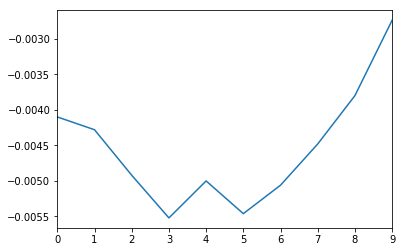

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


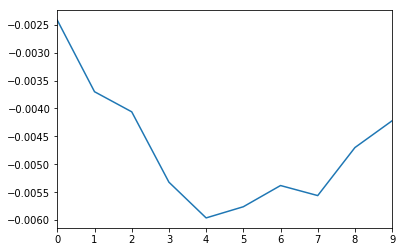

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


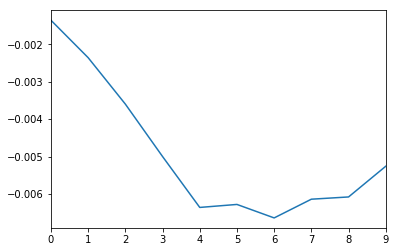

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


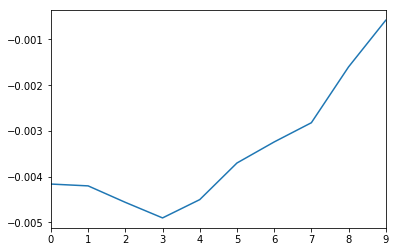

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


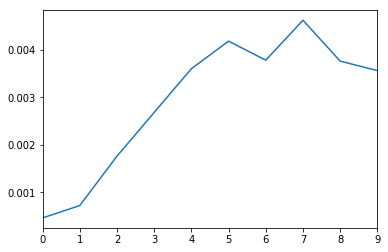

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


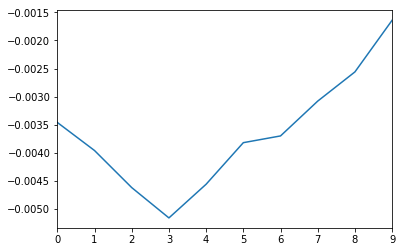

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.122x.dat


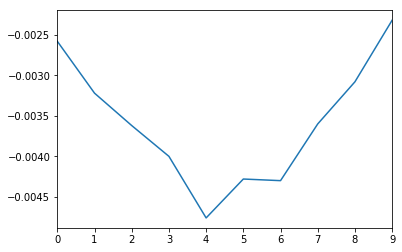

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.124x.dat


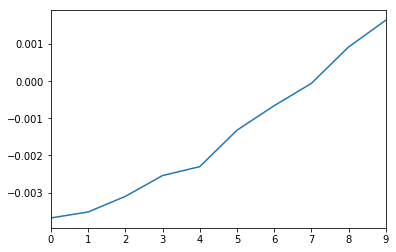

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.124x.dat


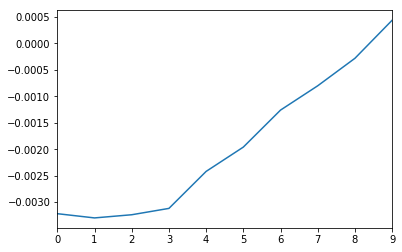

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.124x.dat


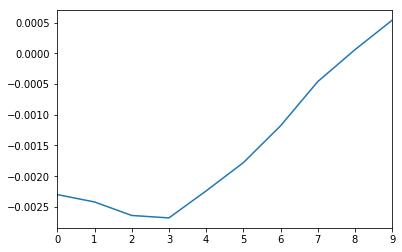

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.126x.dat


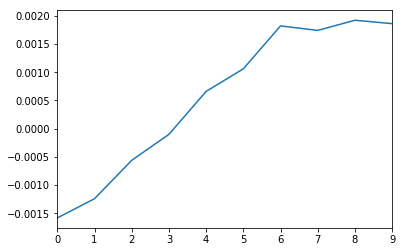

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.126x.dat


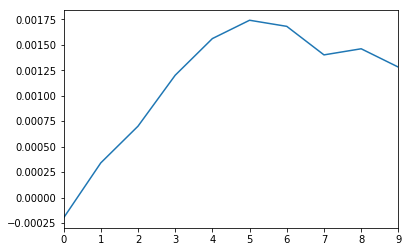

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.126x.dat


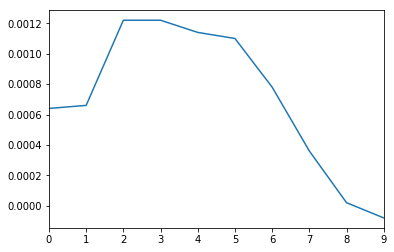

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.128x.dat


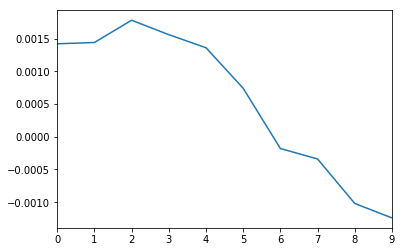

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.128x.dat


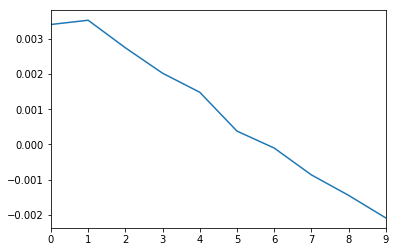

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


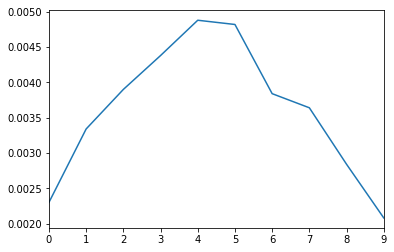

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.128x.dat


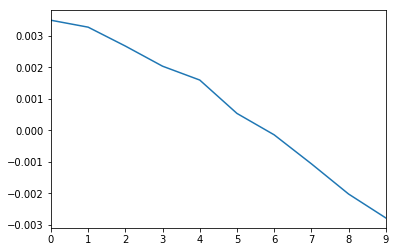

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.13x.dat


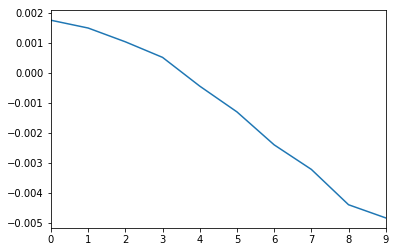

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.13x.dat


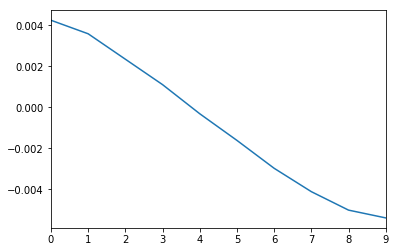

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.13x.dat


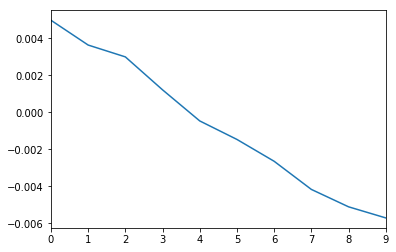

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


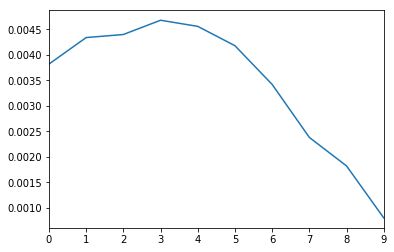

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


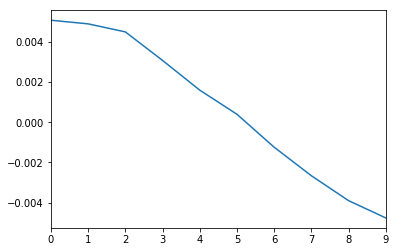

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


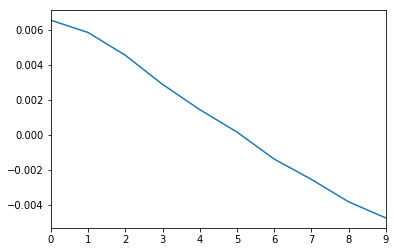

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


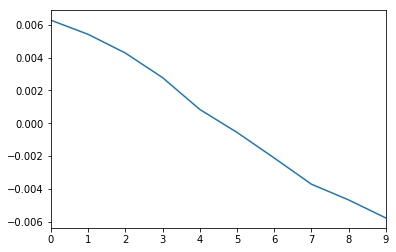

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


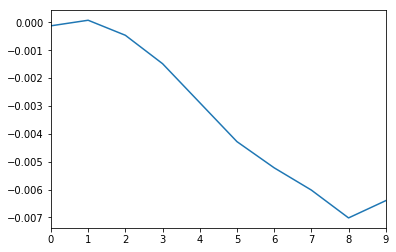

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


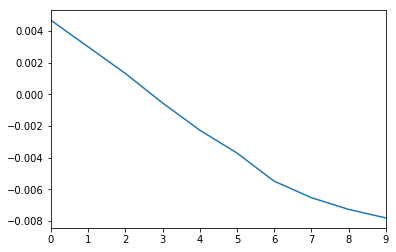

C:\Data\apr2017\170407\PhaseLockTest_pump1300uW___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


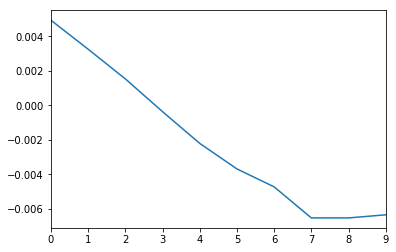

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.116x.dat


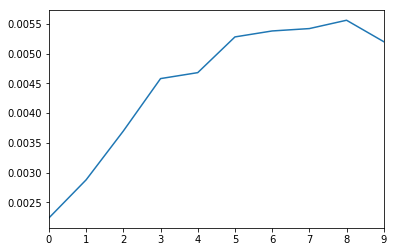

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.116x.dat


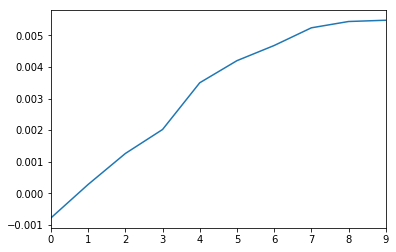

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.116x.dat


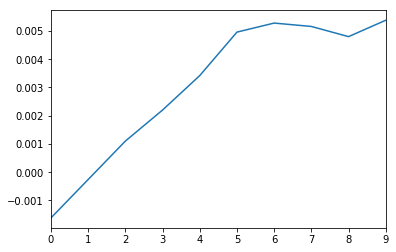

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.118x.dat


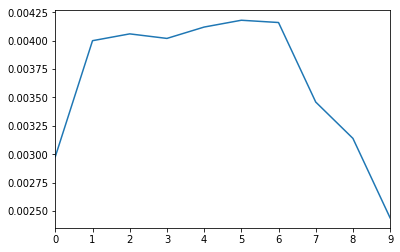

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.118x.dat


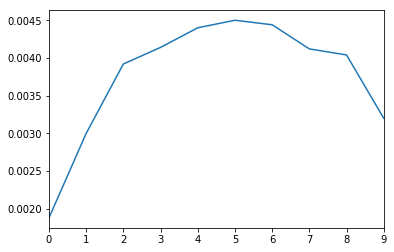

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.118x.dat


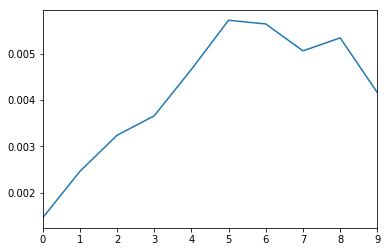

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.12x.dat


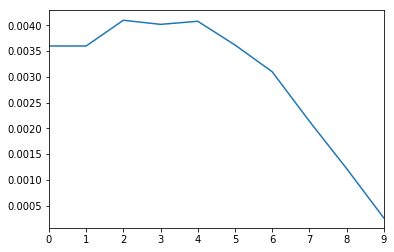

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.12x.dat


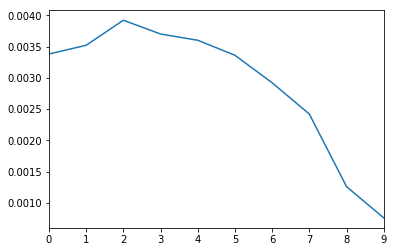

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.12x.dat


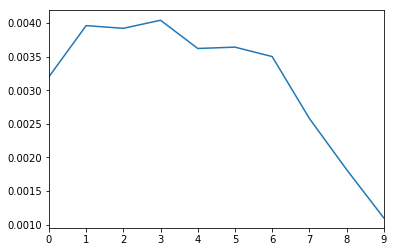

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.122x.dat


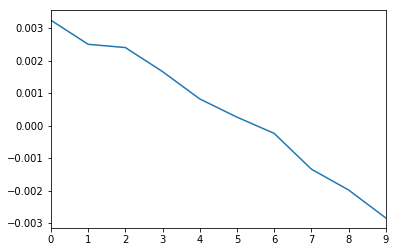

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.11x.dat


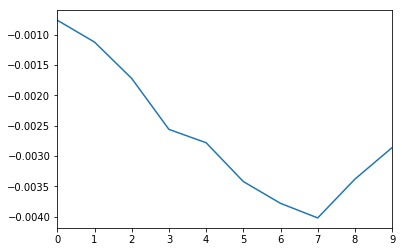

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.122x.dat


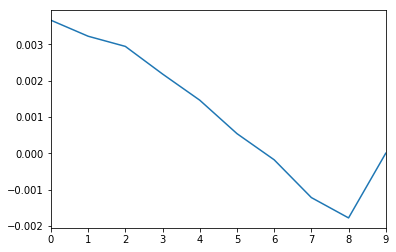

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.11x.dat


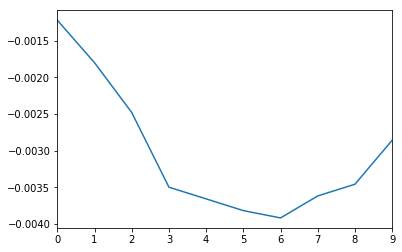

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.11x.dat


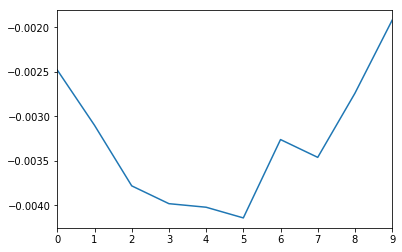

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.112x.dat


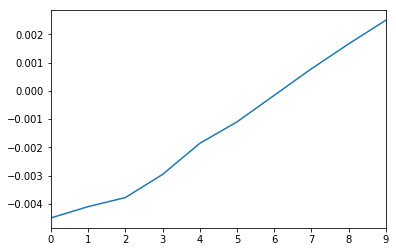

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.112x.dat


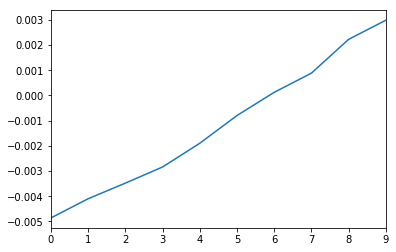

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.112x.dat


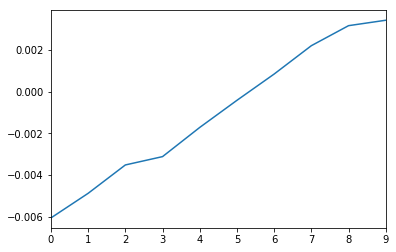

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.114x.dat


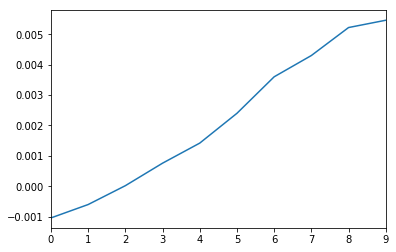

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.114x.dat


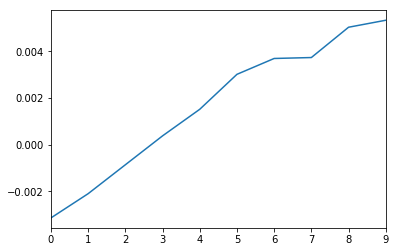

C:\Data\apr2017\170407\PhaseLockTest_WavelengthDependence___818.71nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.114x.dat


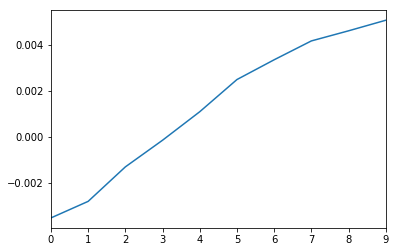

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_RSA___818.53nm_10K_BExternal_0.186_to_0.194.dat


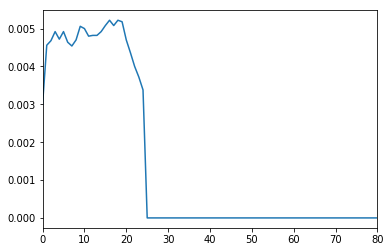

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_RSA___818.53nm_10K_BExternal_0.186_to_0.194_run2.dat


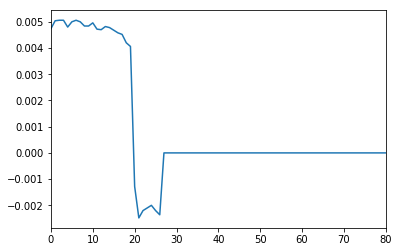

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_RSA___818.53nm_10K_BExternal_0.186_to_0.194_run3.dat


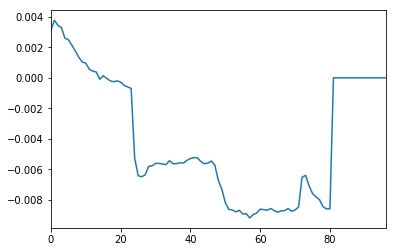

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_RSA___818.53nm_10K_BExternal_0.186_to_0.194_run4.dat


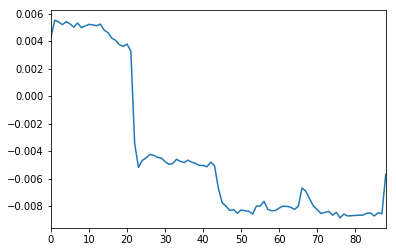

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.204x.dat


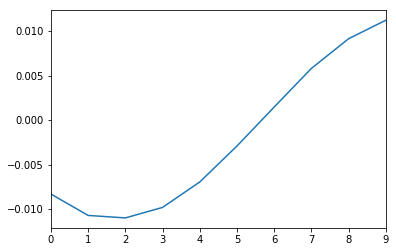

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.204x.dat


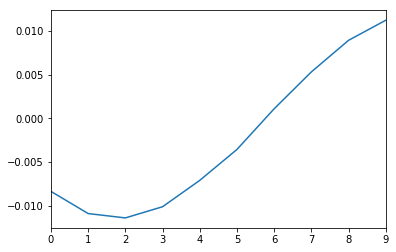

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.204x.dat


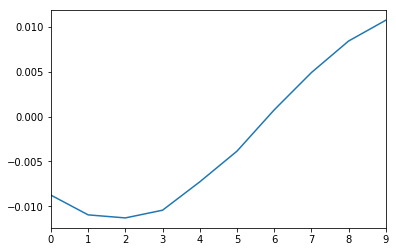

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.206x.dat


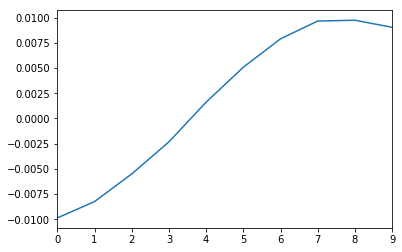

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.206x.dat


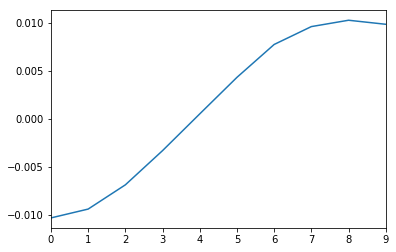

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.206x.dat


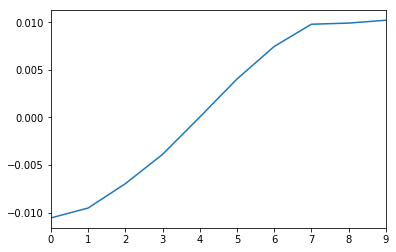

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.206x.dat


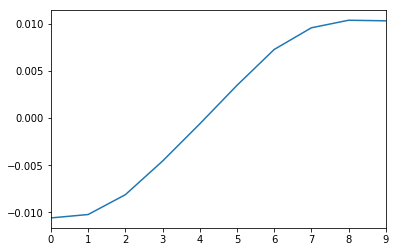

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.208x.dat


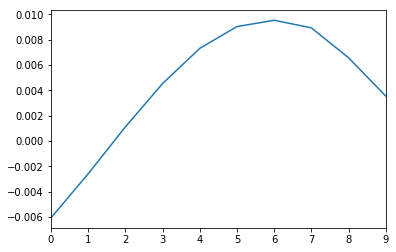

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.208x.dat


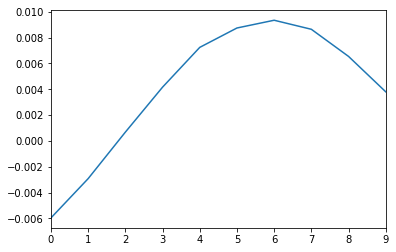

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.208x.dat


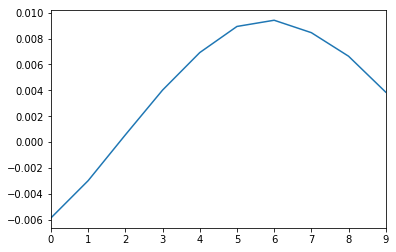

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.2x.dat


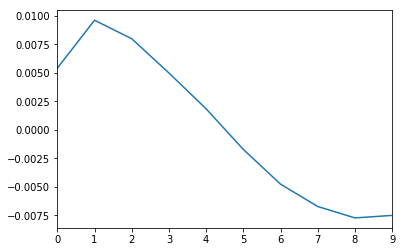

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.208x.dat


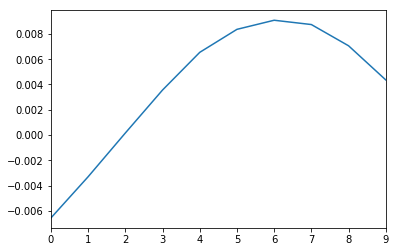

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.21x.dat


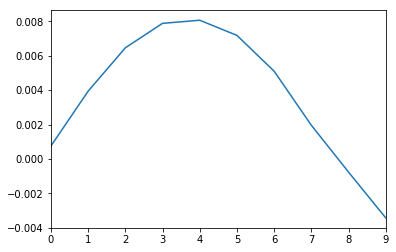

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.21x.dat


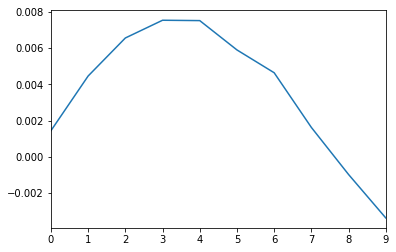

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.21x.dat


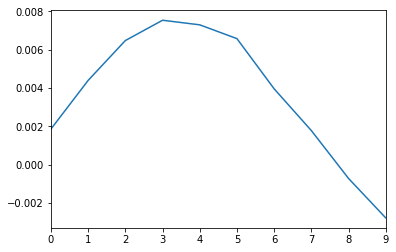

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.21x.dat


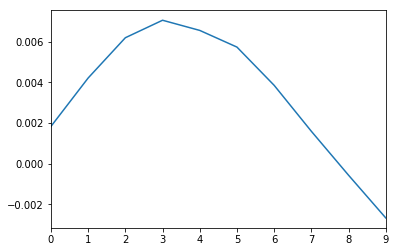

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.212x.dat


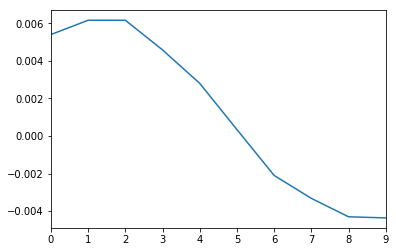

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.212x.dat


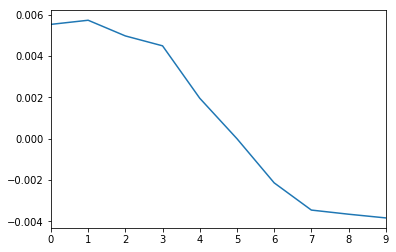

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.212x.dat


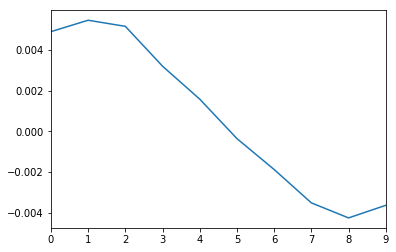

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.212x.dat


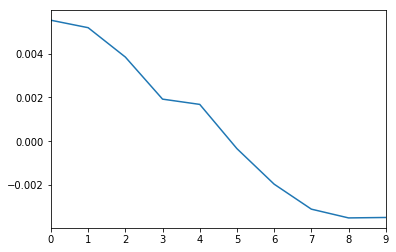

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.214x.dat


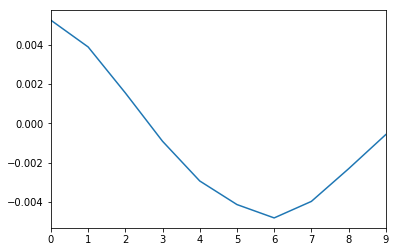

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.2x.dat


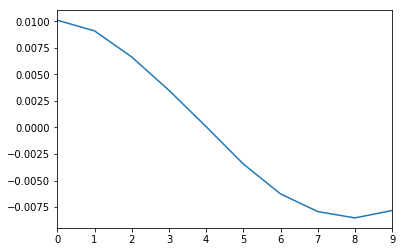

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.214x.dat


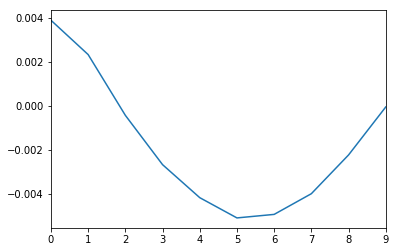

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.214x.dat


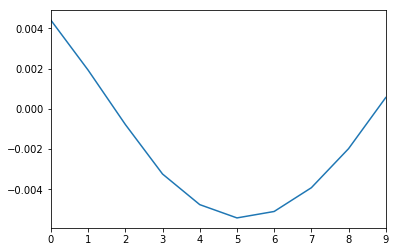

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.214x.dat


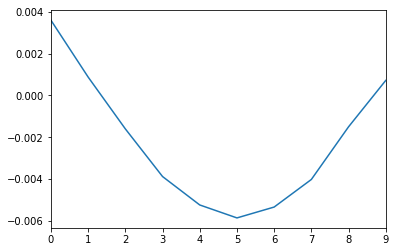

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.216x.dat


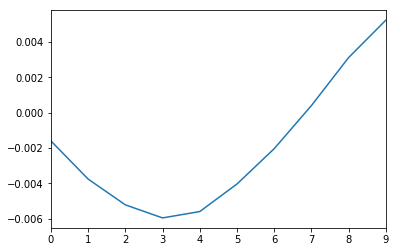

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal 0.216x.dat


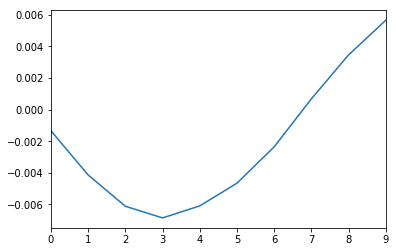

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal 0.216x.dat


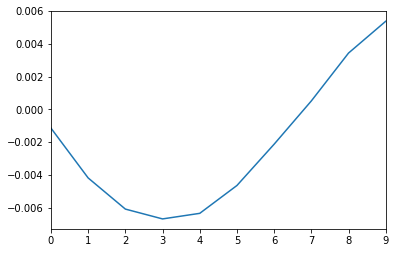

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal 0.216x.dat


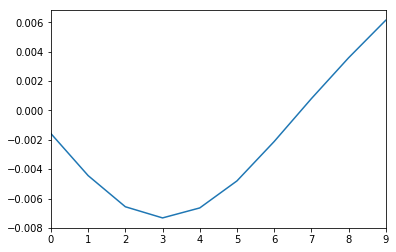

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal 0.218x.dat


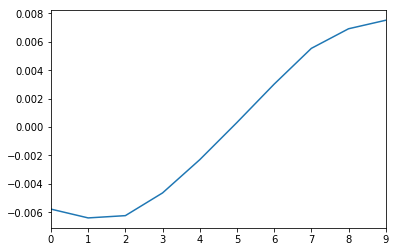

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal 0.218x.dat


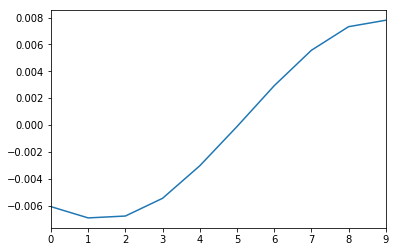

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal 0.218x.dat


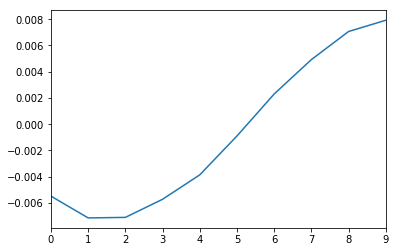

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.2x.dat


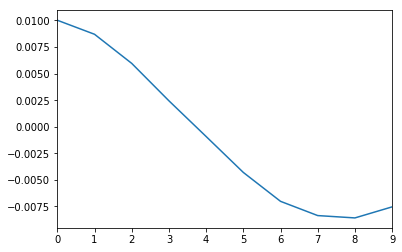

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal 0.218x.dat


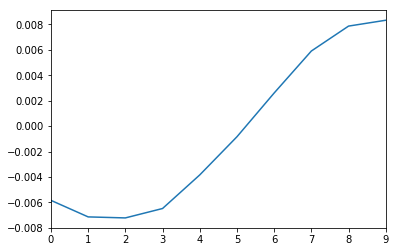

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal 0.22x.dat


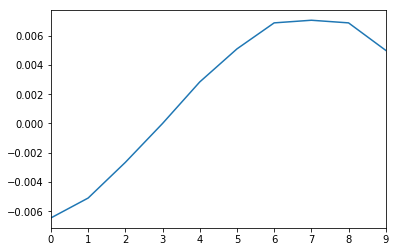

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal 0.22x.dat


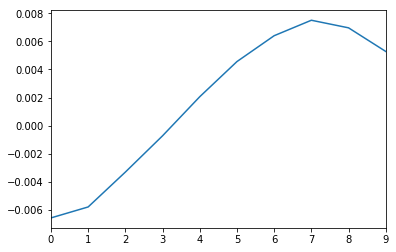

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal 0.22x.dat


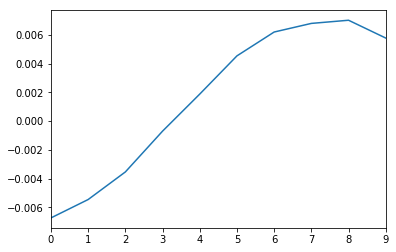

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal 0.22x.dat


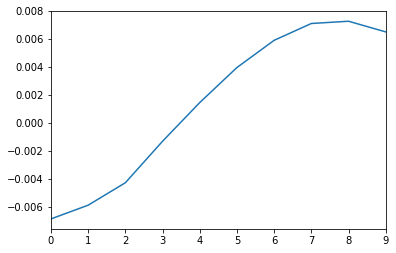

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal 0.222x.dat


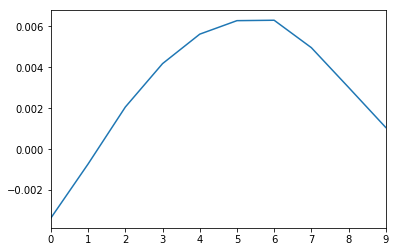

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal 0.222x.dat


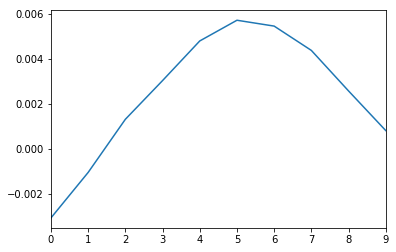

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal 0.222x.dat


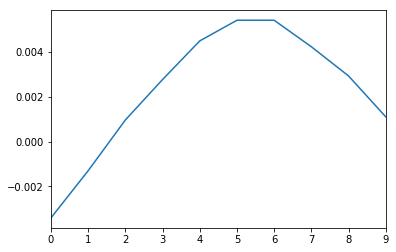

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal 0.222x.dat


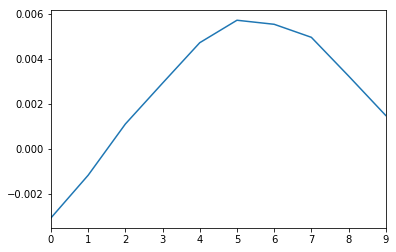

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal 0.224x.dat


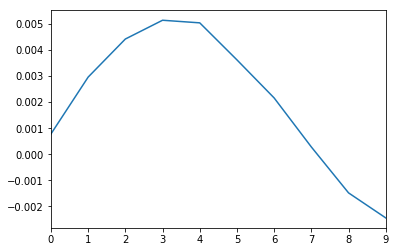

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.2x.dat


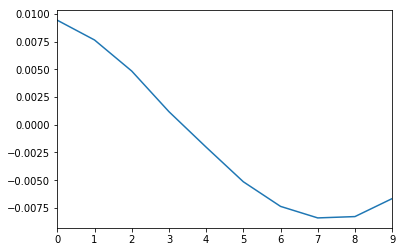

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal 0.224x.dat


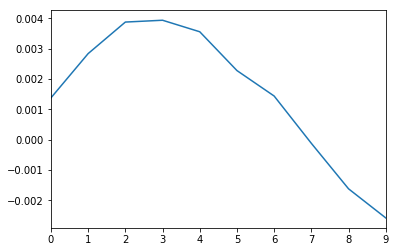

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal 0.224x.dat


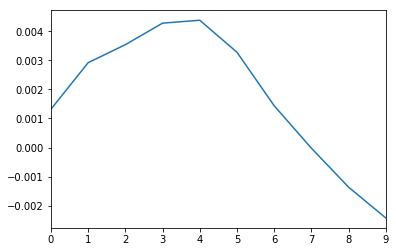

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal 0.224x.dat


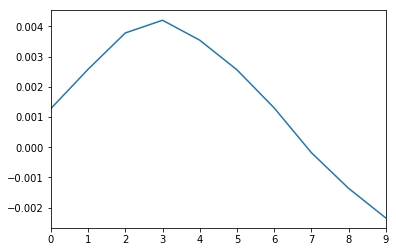

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal 0.226x.dat


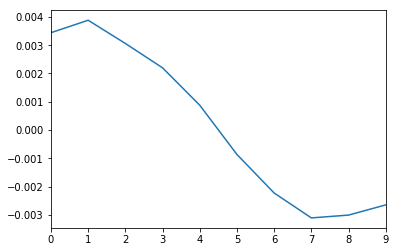

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal 0.226x.dat


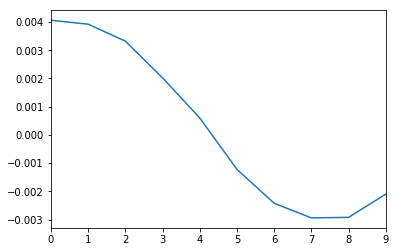

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal 0.226x.dat


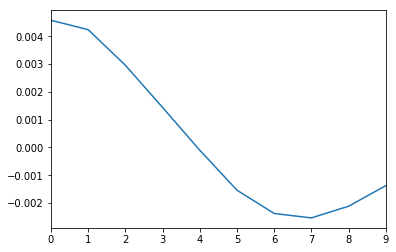

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal 0.226x.dat


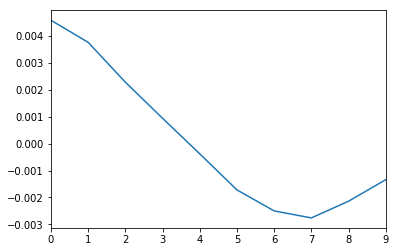

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal 0.228x.dat


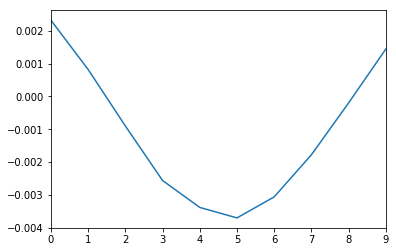

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal 0.228x.dat


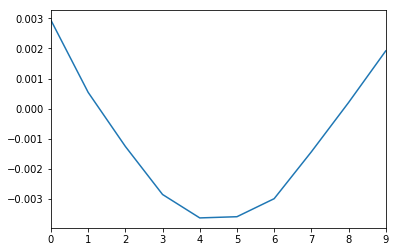

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal 0.228x.dat


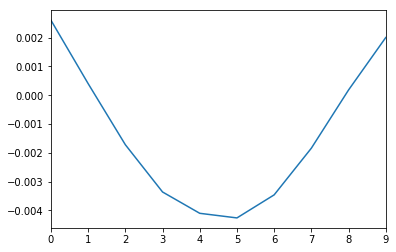

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.202x.dat


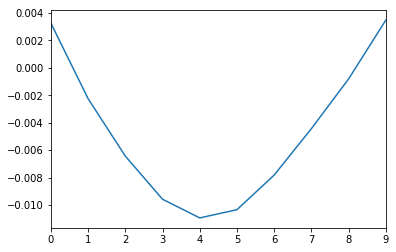

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal 0.228x.dat


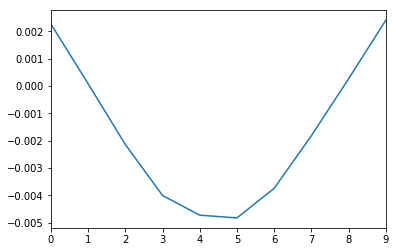

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal 0.23x.dat


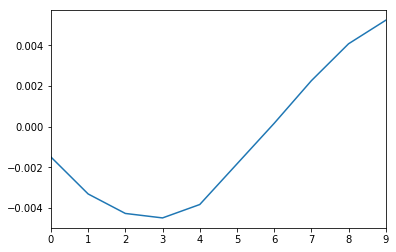

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal 0.23x.dat


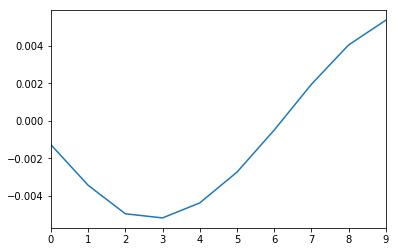

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal 0.23x.dat


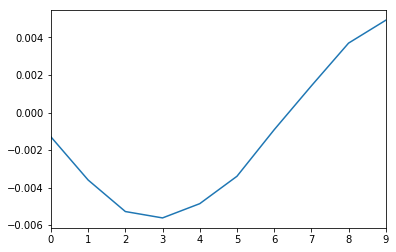

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal 0.23x.dat


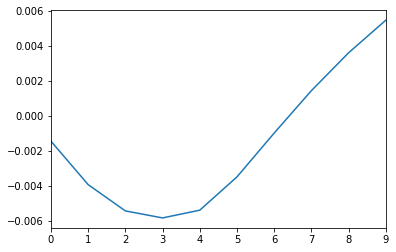

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal 0.232x.dat


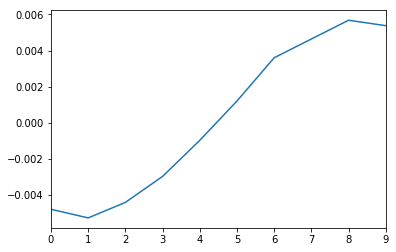

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal 0.232x.dat


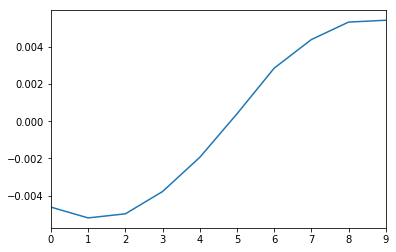

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal 0.232x.dat


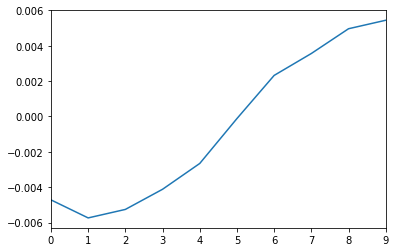

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal 0.232x.dat


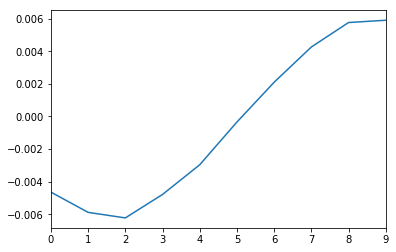

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal 0.234x.dat


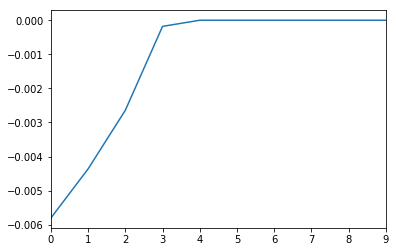

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.202x.dat


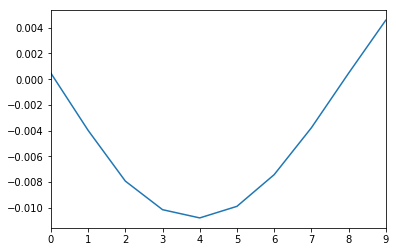

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.202x.dat


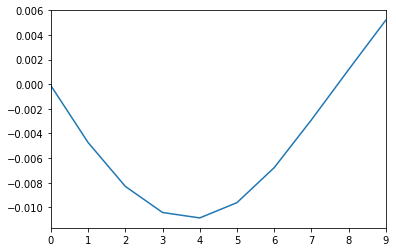

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.202x.dat


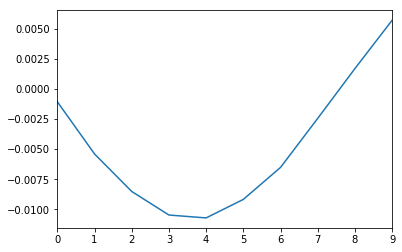

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_1.5mTstep___818.82nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.204x.dat


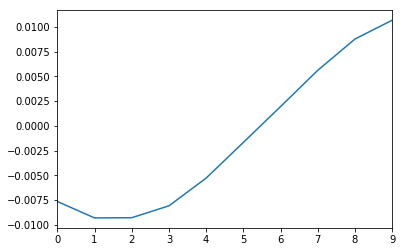

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal -0.186x.dat


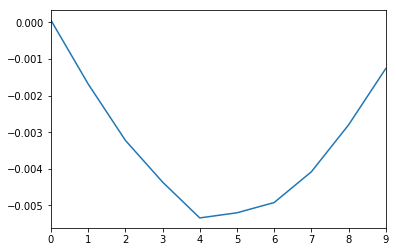

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal -0.186x.dat


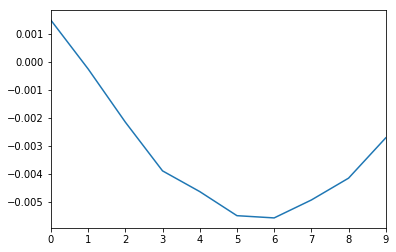

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal -0.186x.dat


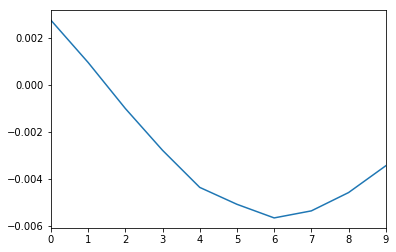

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal -0.189x.dat


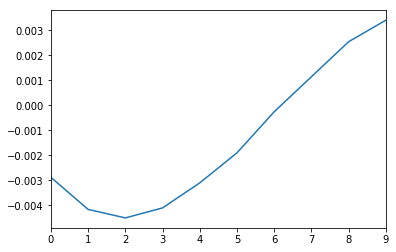

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal -0.189x.dat


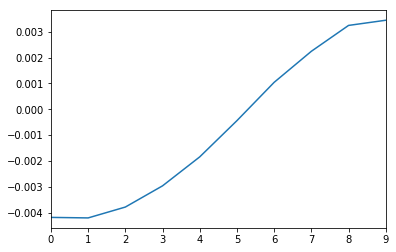

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal -0.189x.dat


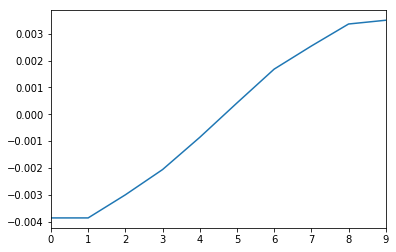

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal -0.189x.dat


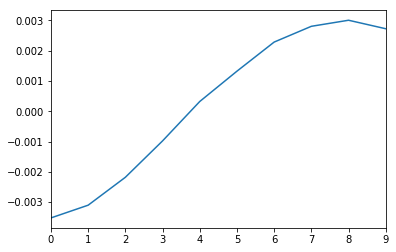

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal -0.192x.dat


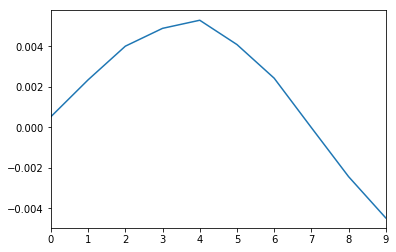

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal -0.192x.dat


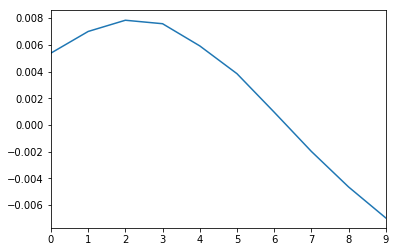

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal -0.192x.dat


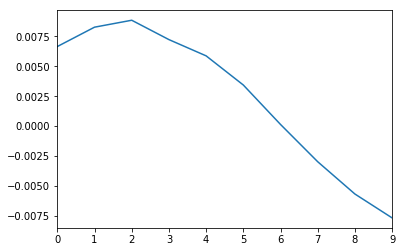

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal -0.18x.dat


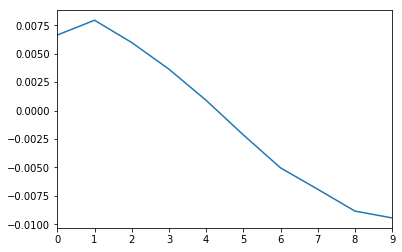

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal -0.192x.dat


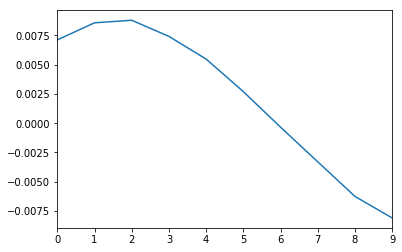

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal -0.195x.dat


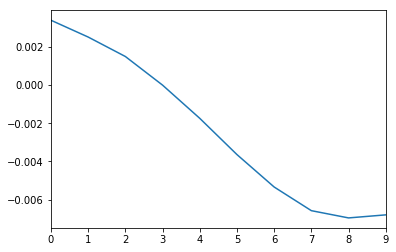

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal -0.195x.dat


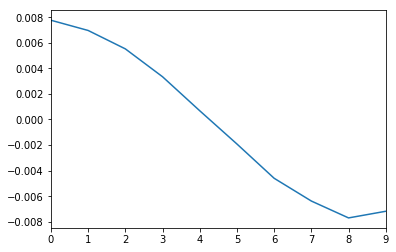

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal -0.195x.dat


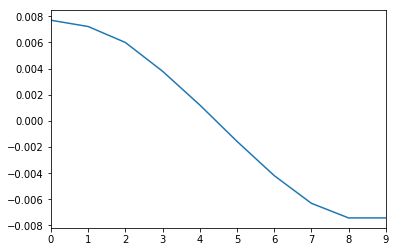

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal -0.195x.dat


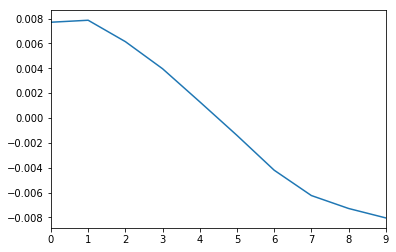

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal -0.198x.dat


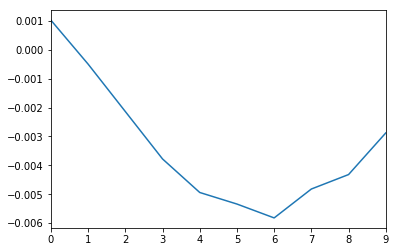

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal -0.198x.dat


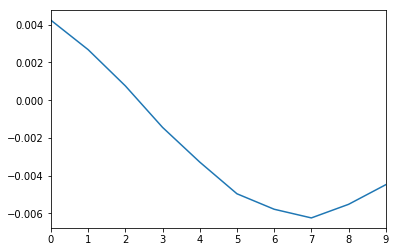

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal -0.198x.dat


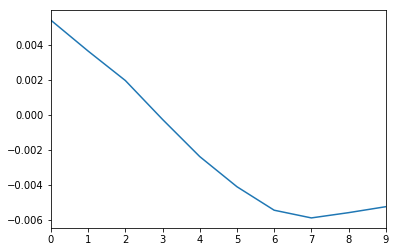

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal -0.198x.dat


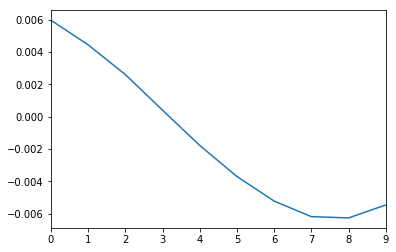

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal -0.201x.dat


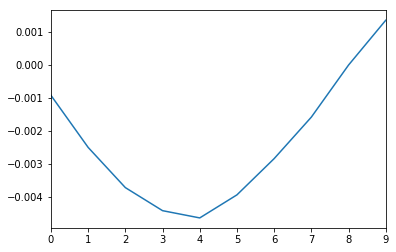

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal -0.18x.dat


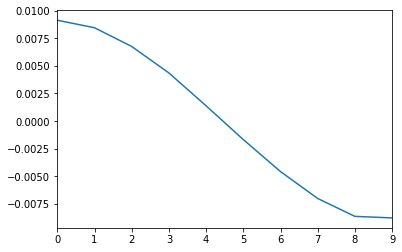

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal -0.201x.dat


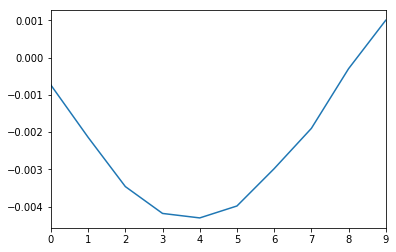

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal -0.201x.dat


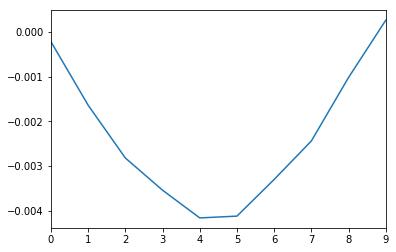

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal -0.201x.dat


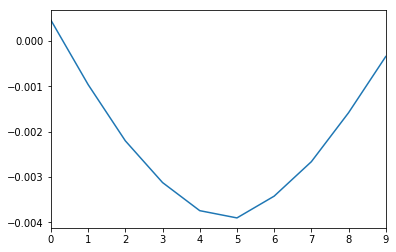

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal -0.204x.dat


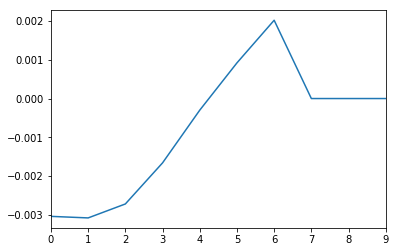

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal -0.18x.dat


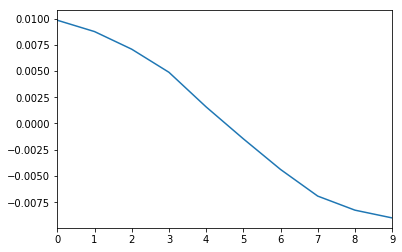

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal -0.18x.dat


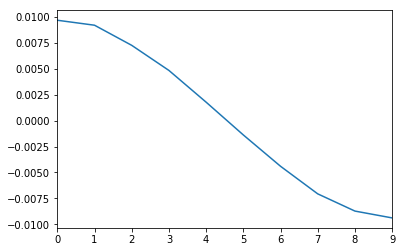

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal -0.183x.dat


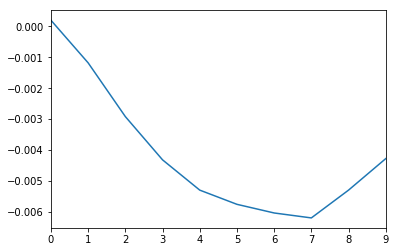

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal -0.183x.dat


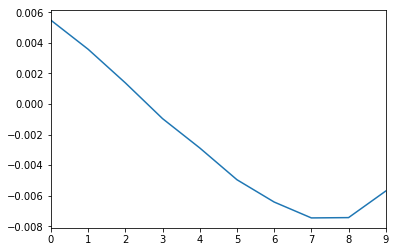

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal -0.183x.dat


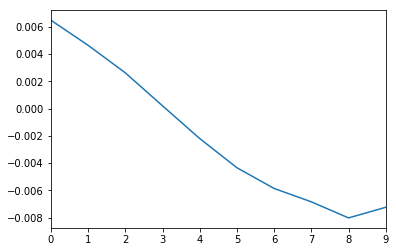

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal -0.183x.dat


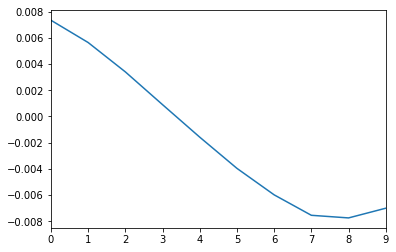

C:\Data\apr2017\170409\CANCELLED_TestPhaseShift_1030uWpump_3mTstep_negative___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal -0.186x.dat


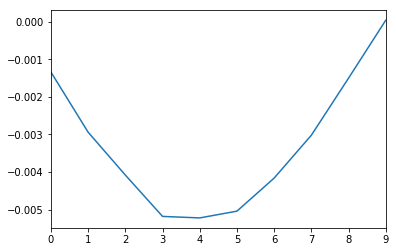

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


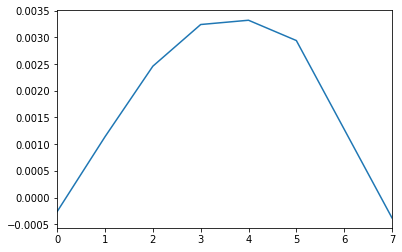

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


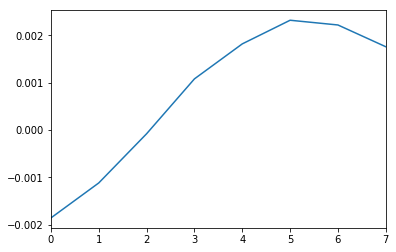

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


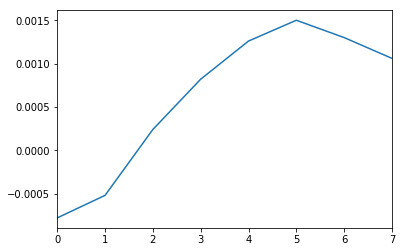

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


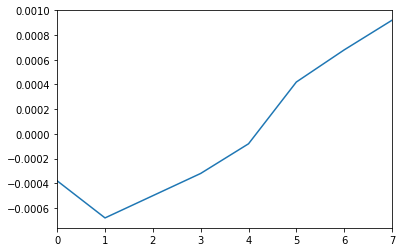

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


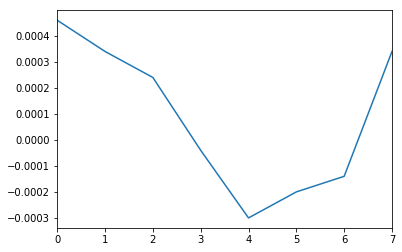

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


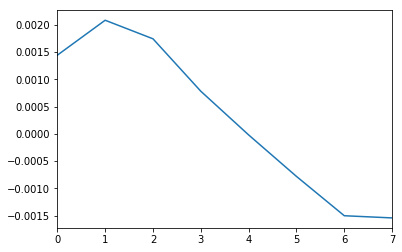

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


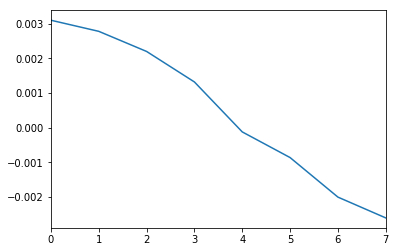

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


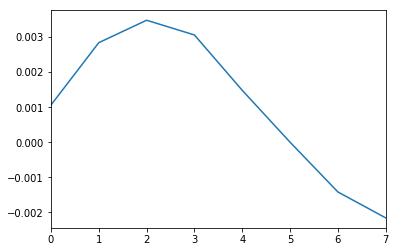

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


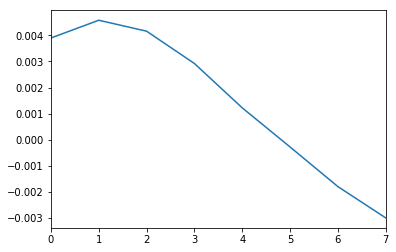

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


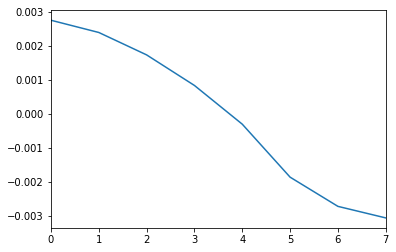

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


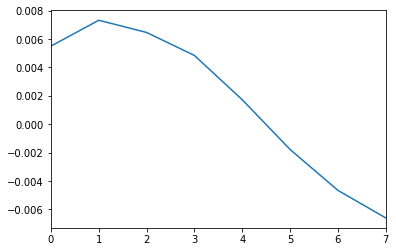

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


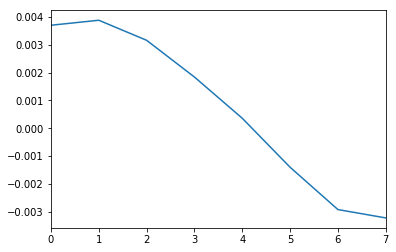

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


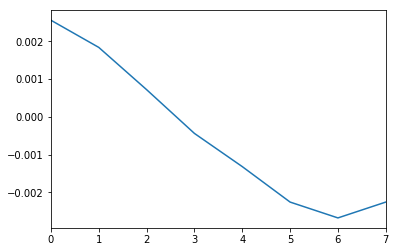

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


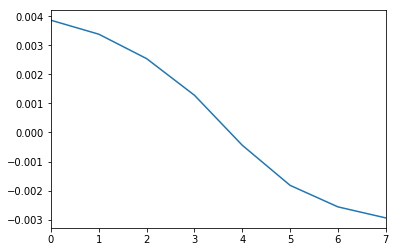

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


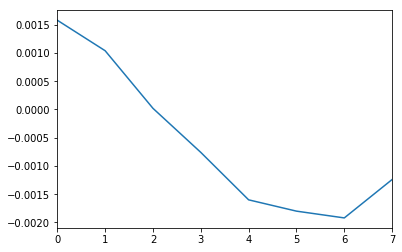

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


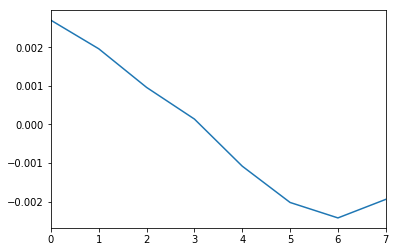

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


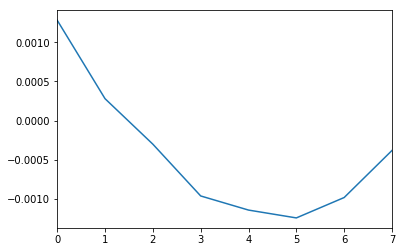

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


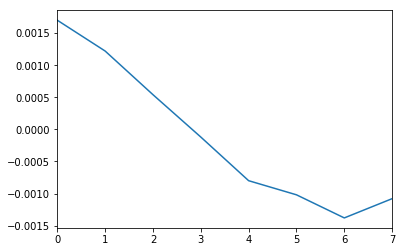

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


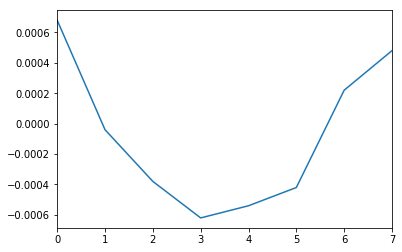

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


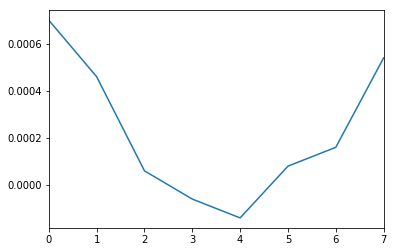

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


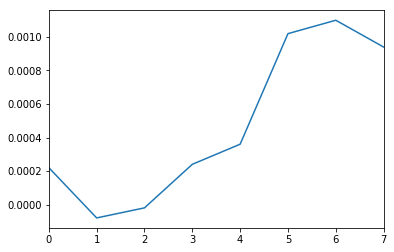

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


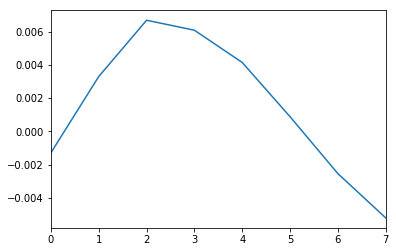

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


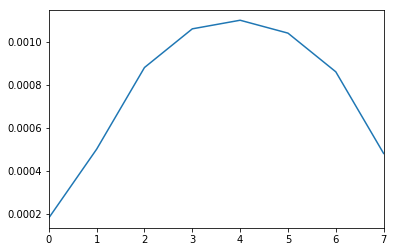

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


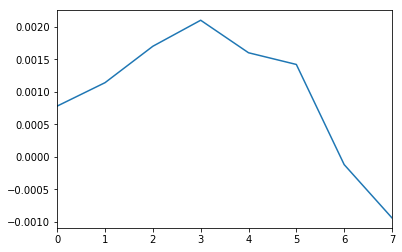

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


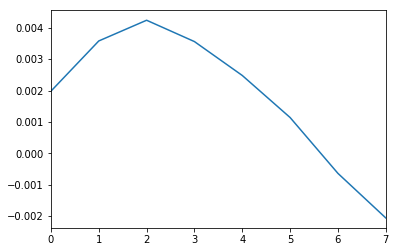

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


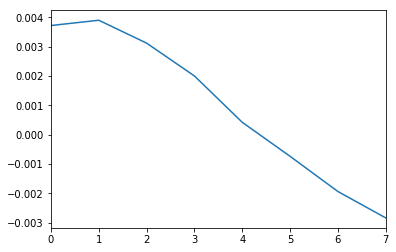

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


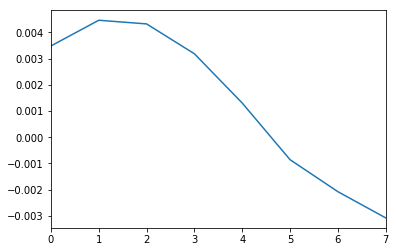

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


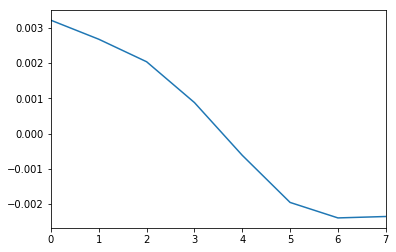

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


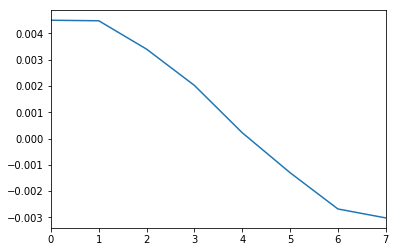

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


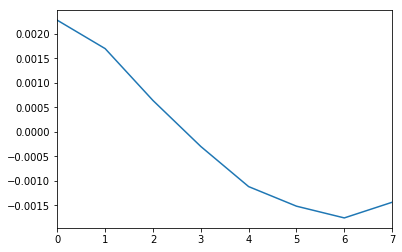

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


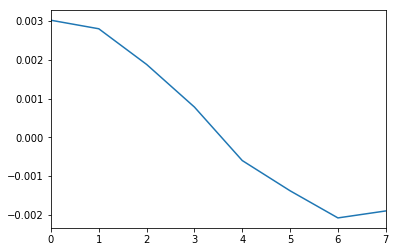

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


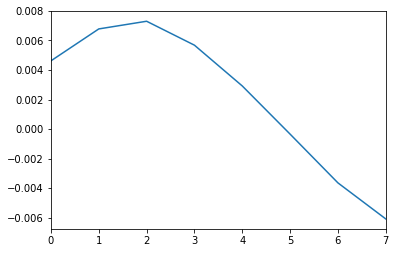

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


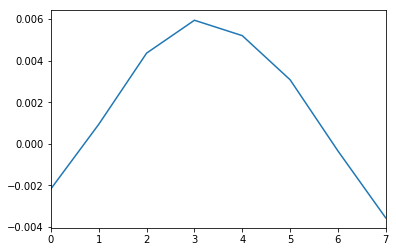

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


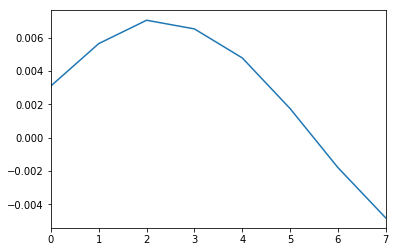

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


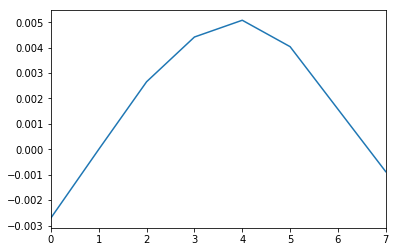

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


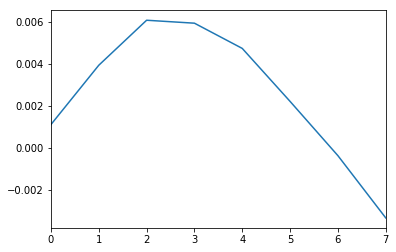

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


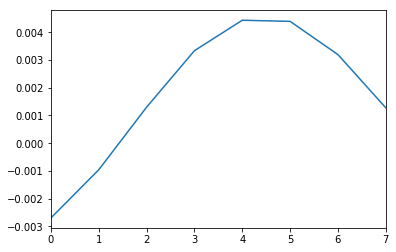

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


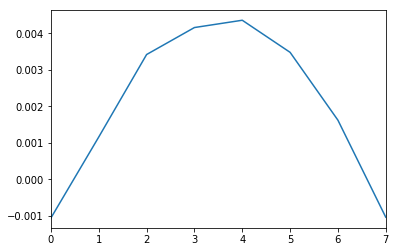

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


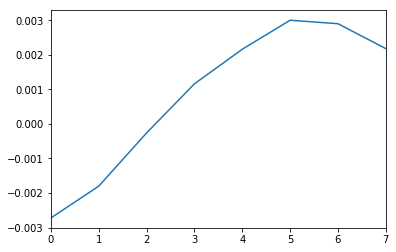

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


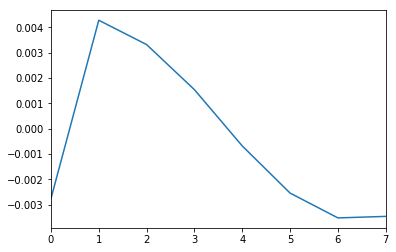

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


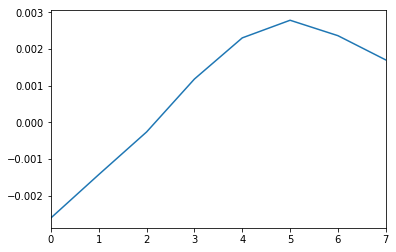

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


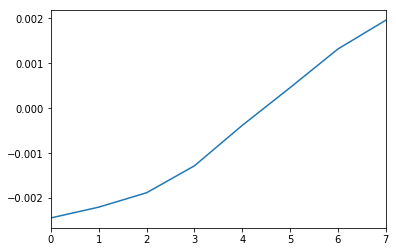

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


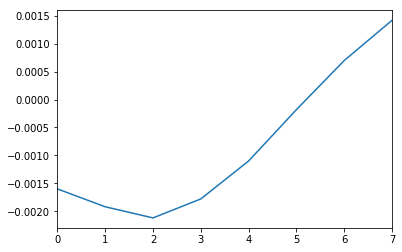

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


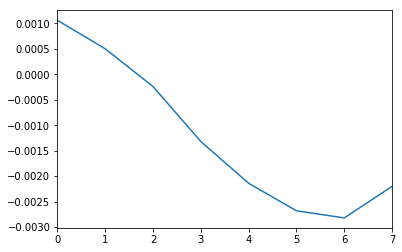

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


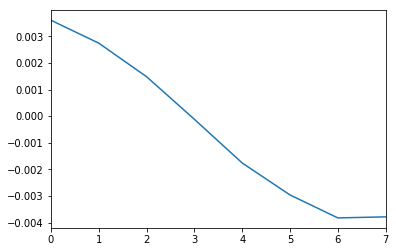

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


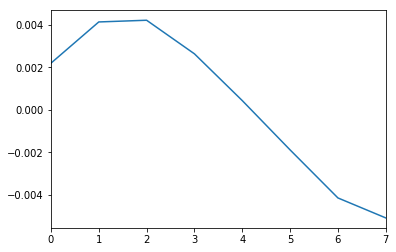

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


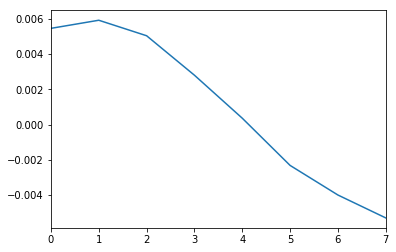

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


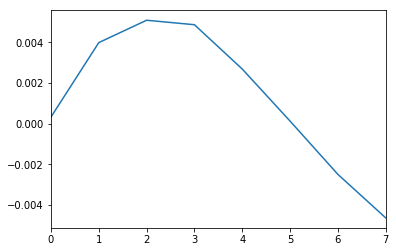

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


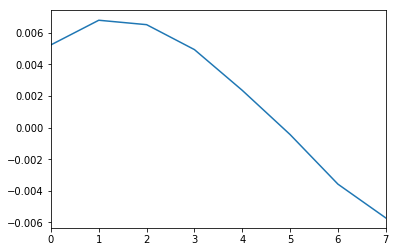

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


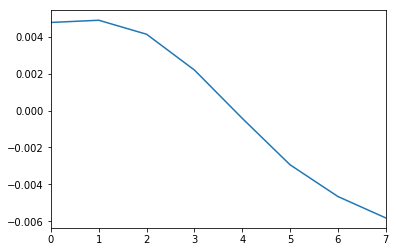

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


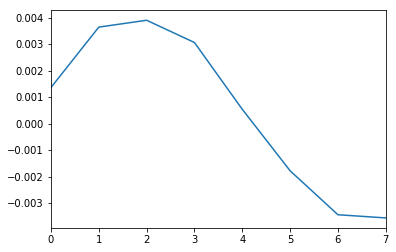

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


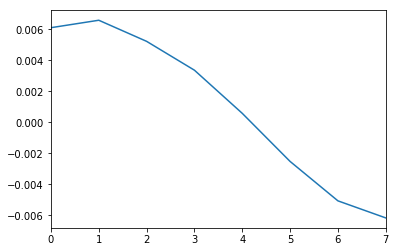

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


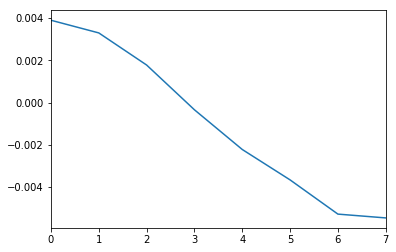

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


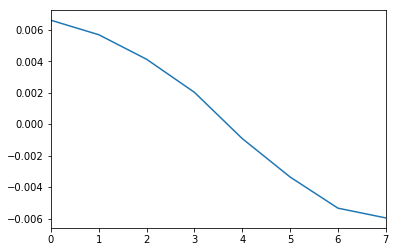

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


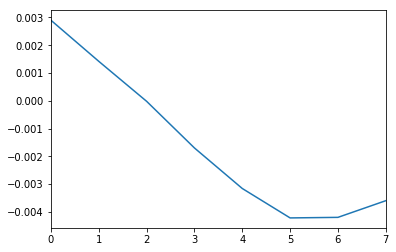

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


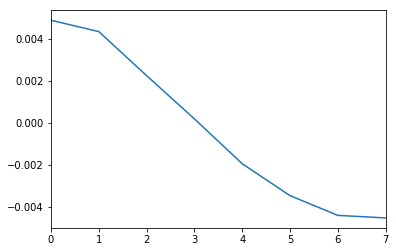

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


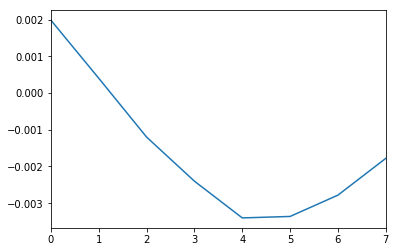

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


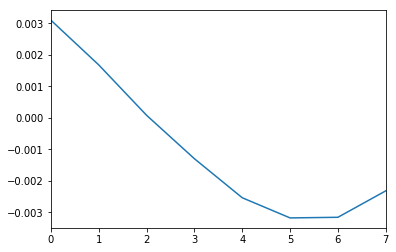

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


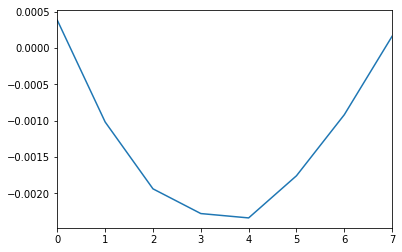

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


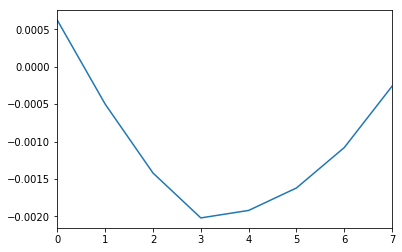

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


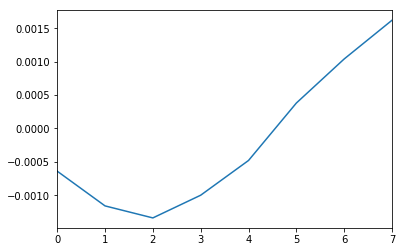

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


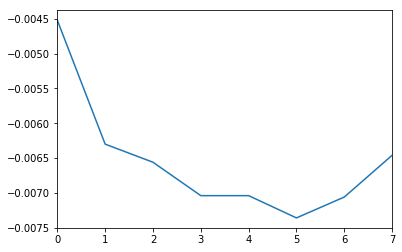

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


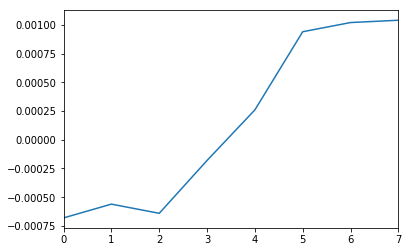

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


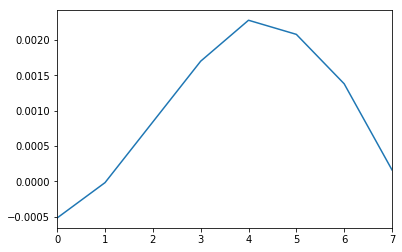

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


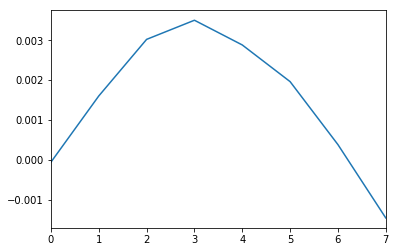

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


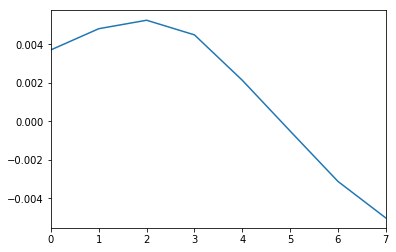

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


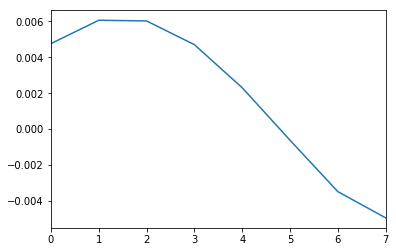

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


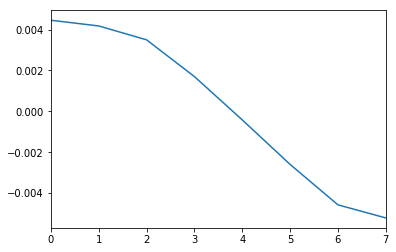

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


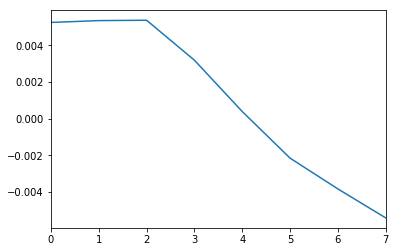

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


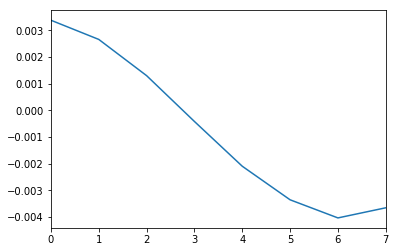

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


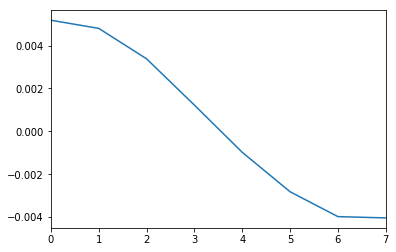

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


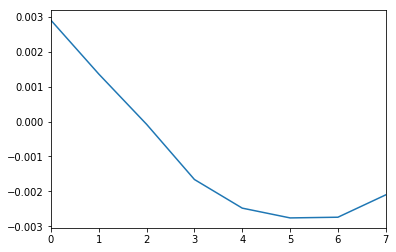

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


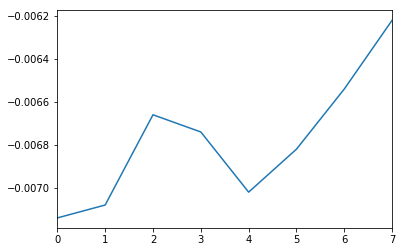

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


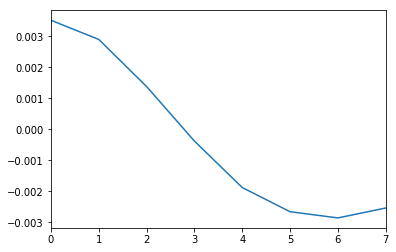

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


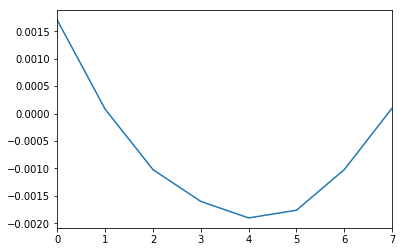

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


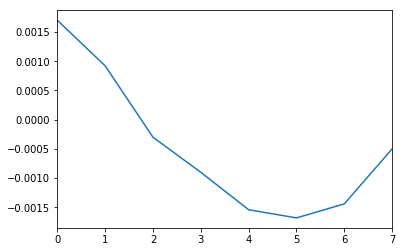

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


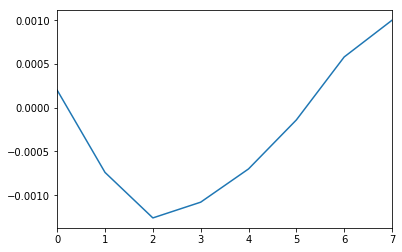

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


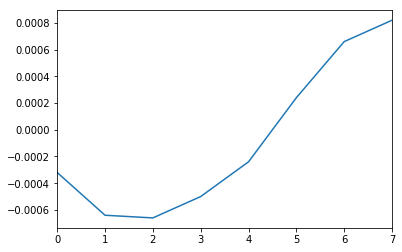

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


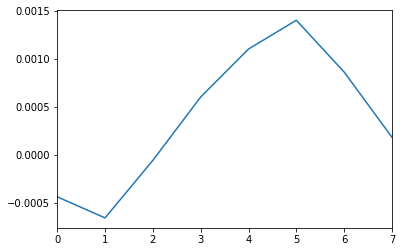

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


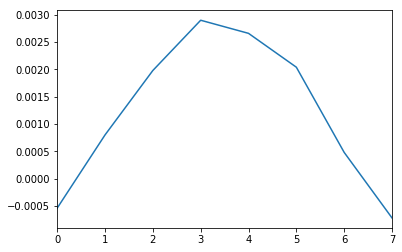

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


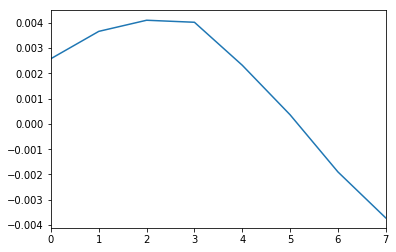

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


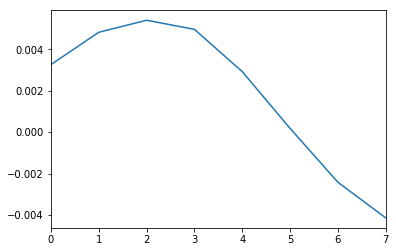

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


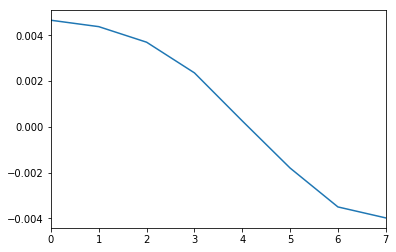

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


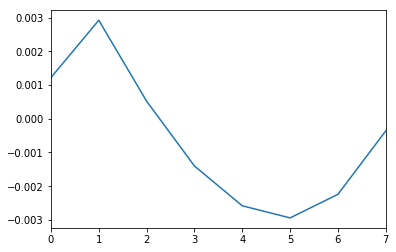

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


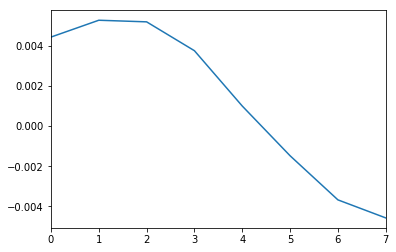

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


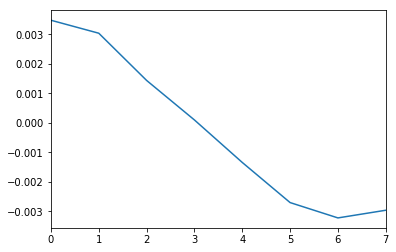

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


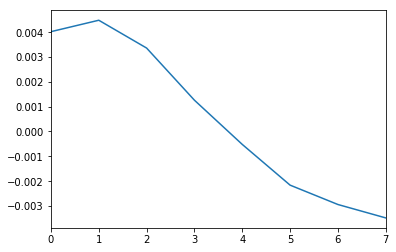

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


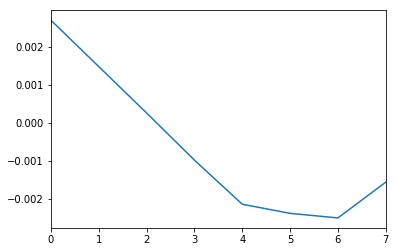

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


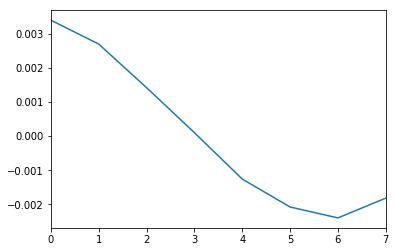

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


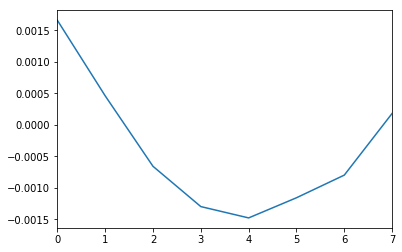

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


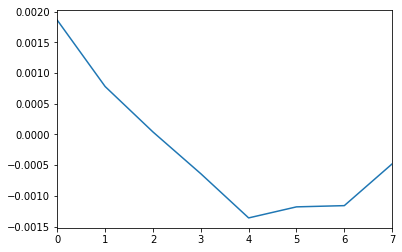

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


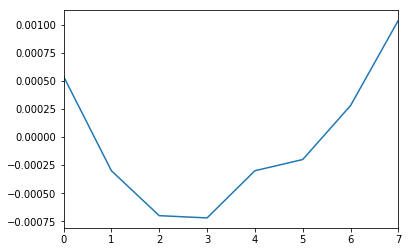

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


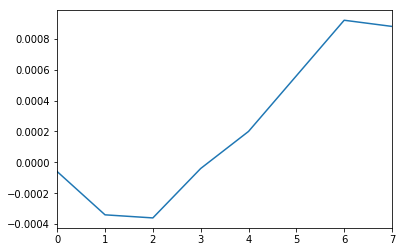

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


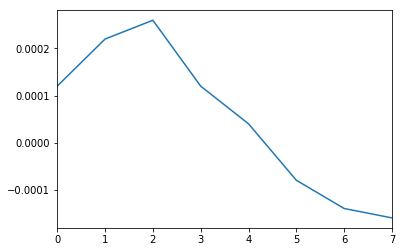

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


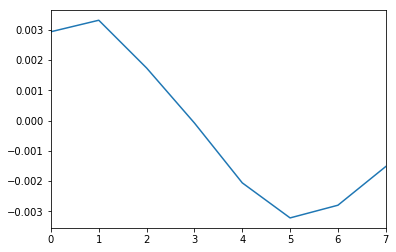

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


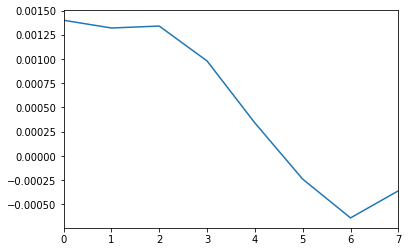

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


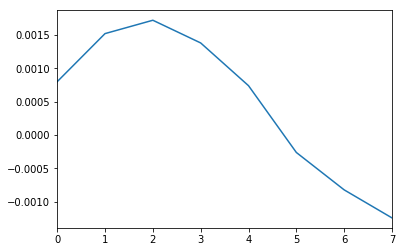

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


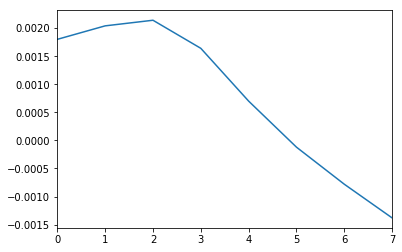

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


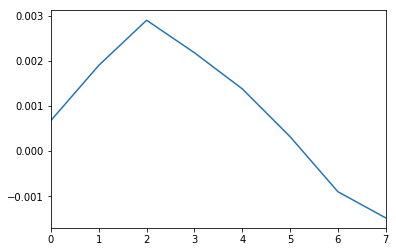

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


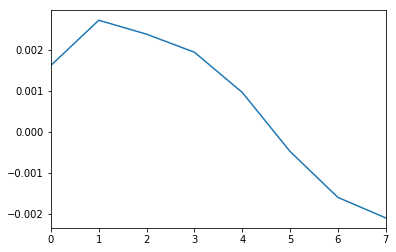

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


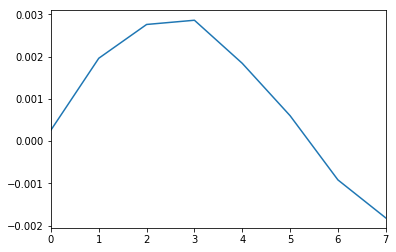

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


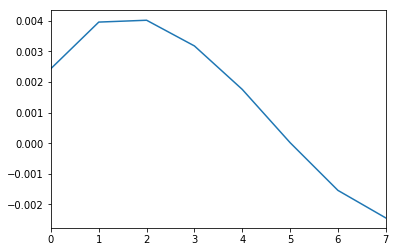

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


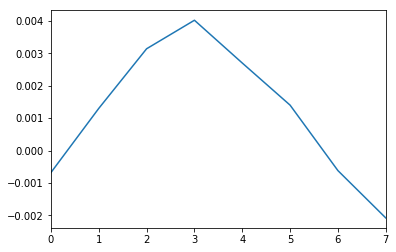

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


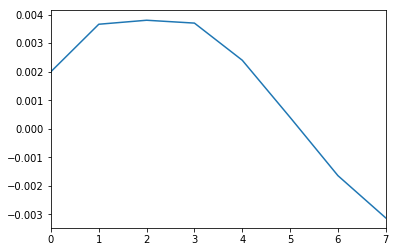

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


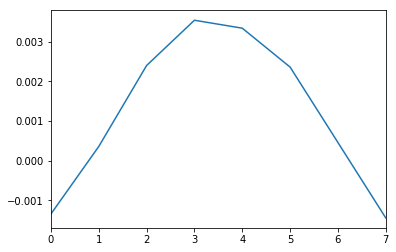

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


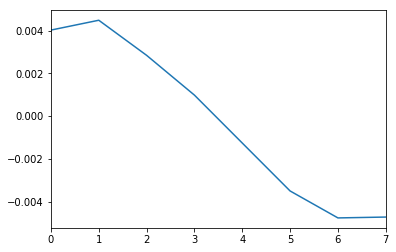

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


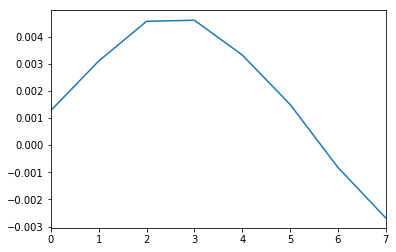

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


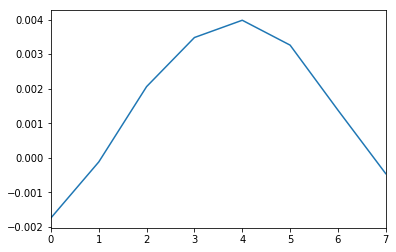

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


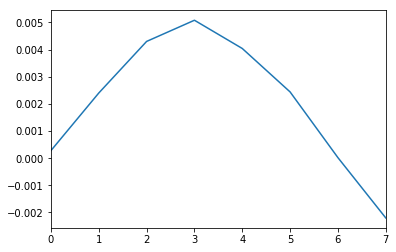

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


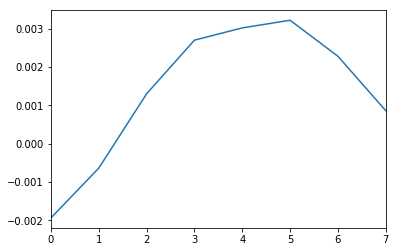

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


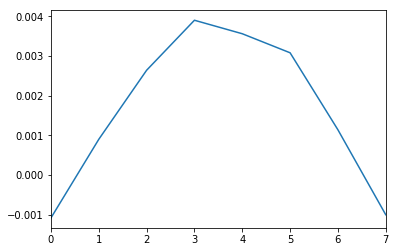

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


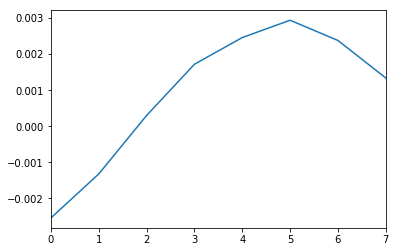

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


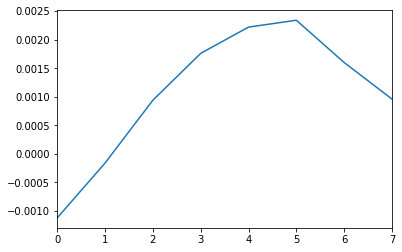

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


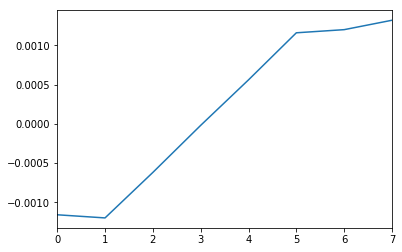

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


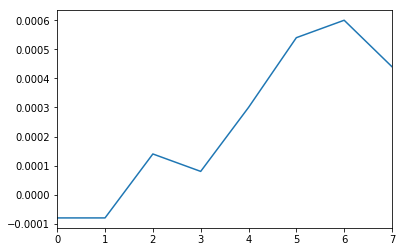

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


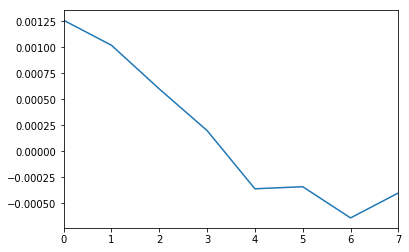

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


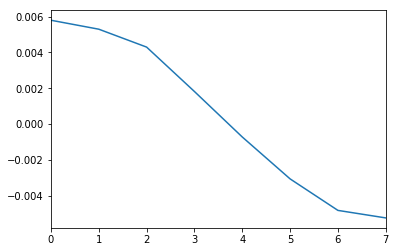

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


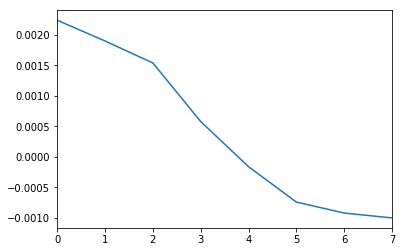

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


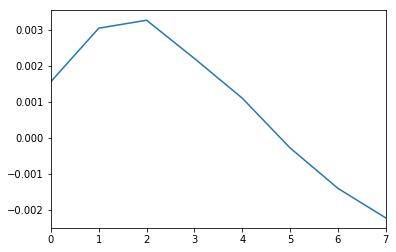

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


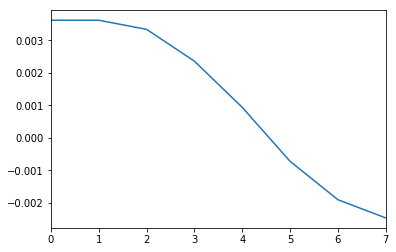

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


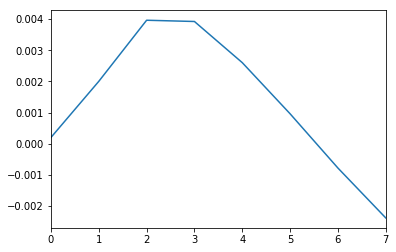

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


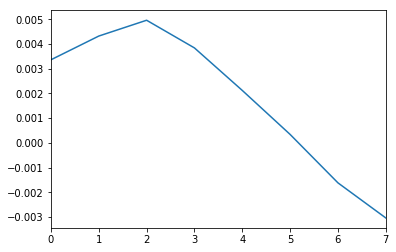

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


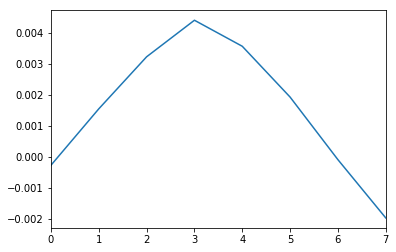

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


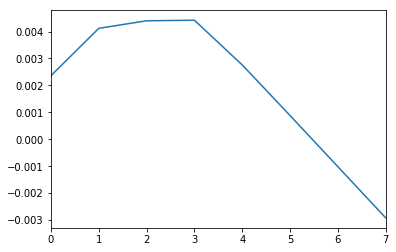

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


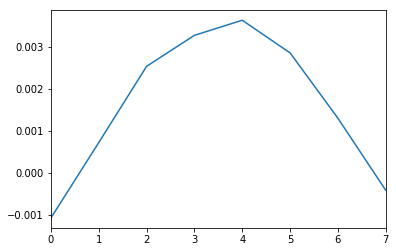

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


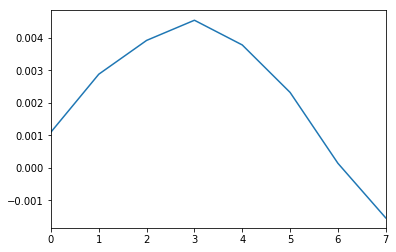

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


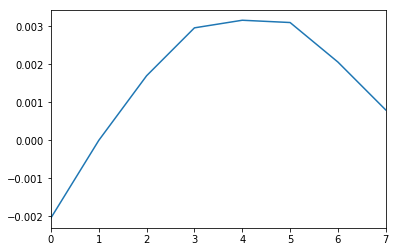

C:\Data\apr2017\170409\TestPhaseShift2_0530uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


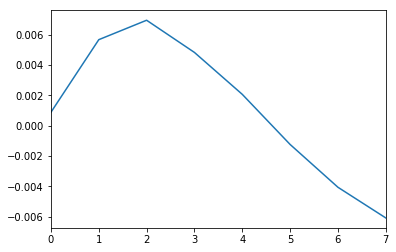

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.218x.dat


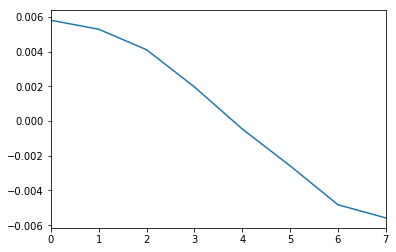

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.206x.dat


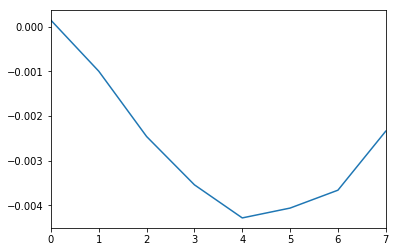

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.204x.dat


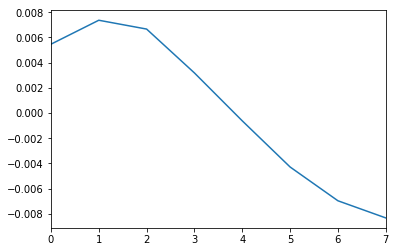

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.202x.dat


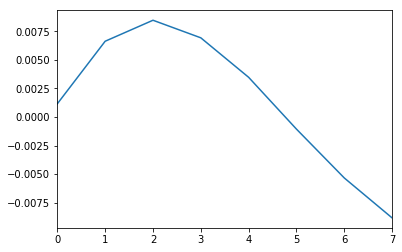

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.2x.dat


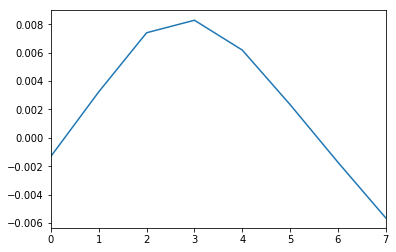

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.198x.dat


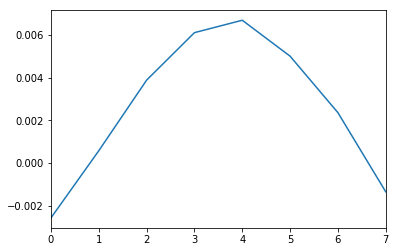

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.196x.dat


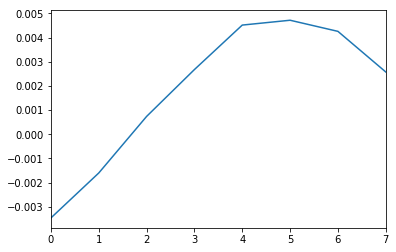

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.194x.dat


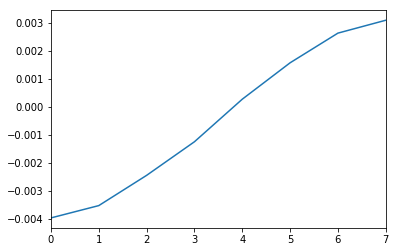

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.192x.dat


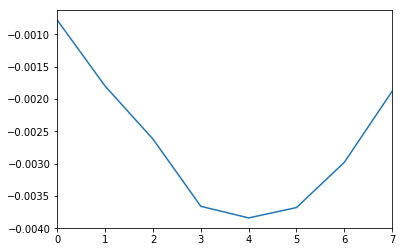

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.19x.dat


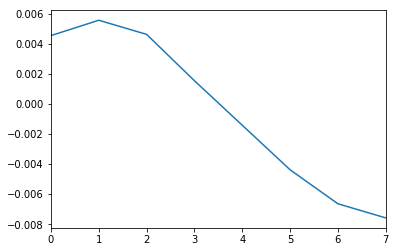

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.188x.dat


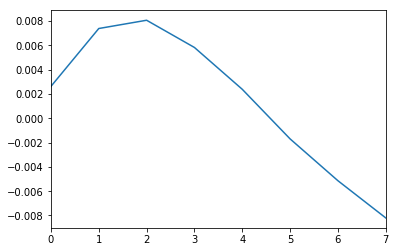

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


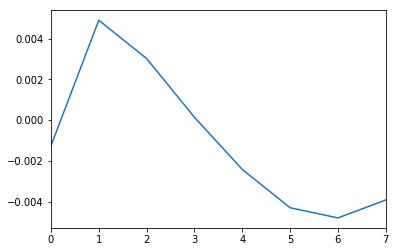

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.186x.dat


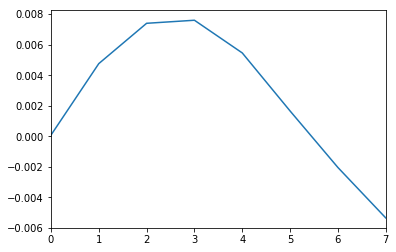

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.188x.dat


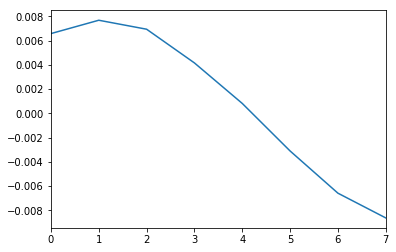

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.19x.dat


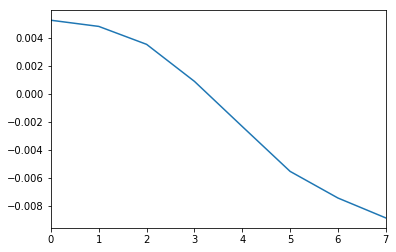

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.192x.dat


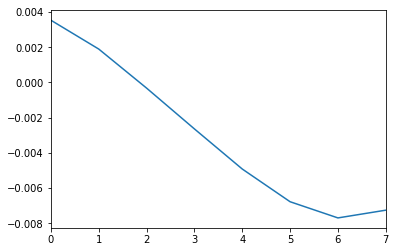

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.194x.dat


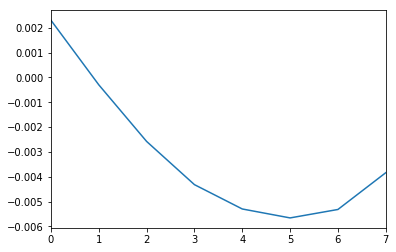

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.196x.dat


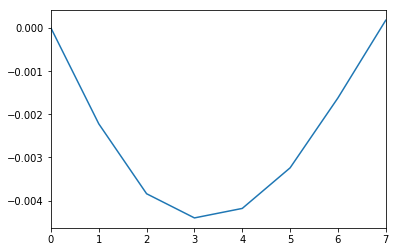

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.198x.dat


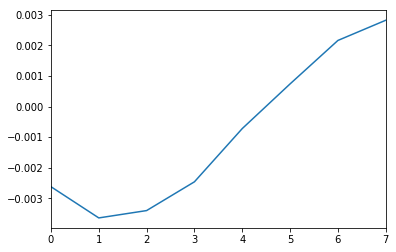

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


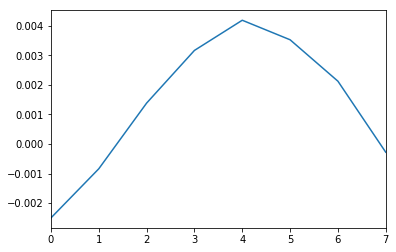

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.202x.dat


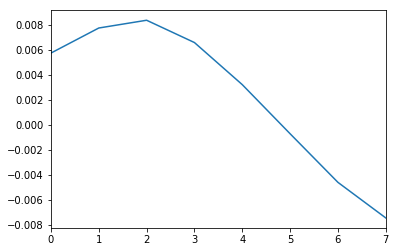

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.204x.dat


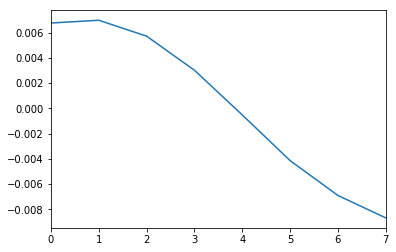

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal 0x.dat


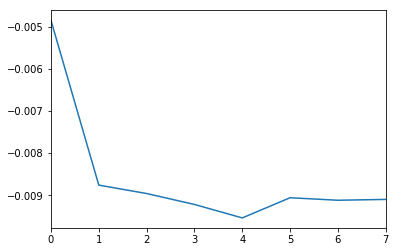

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.206x.dat


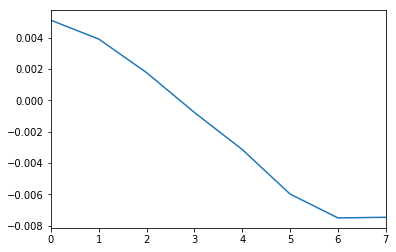

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.208x.dat


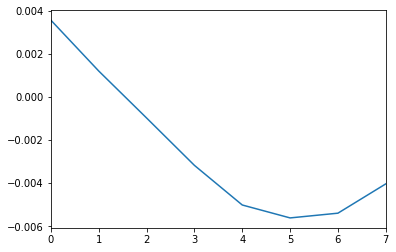

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.21x.dat


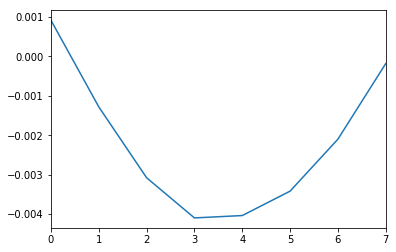

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.212x.dat


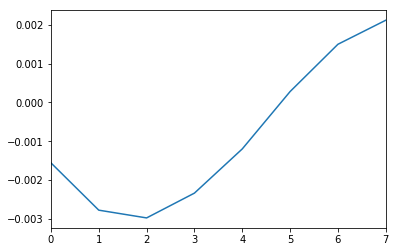

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.214x.dat


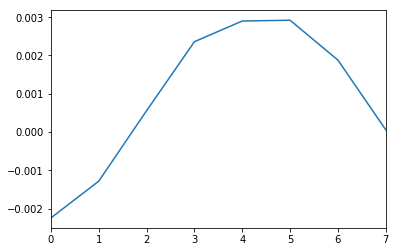

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.216x.dat


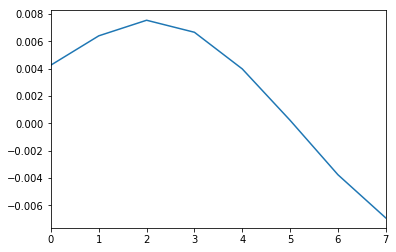

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.218x.dat


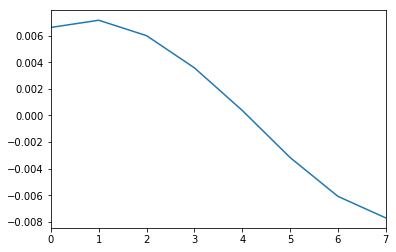

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.22x.dat


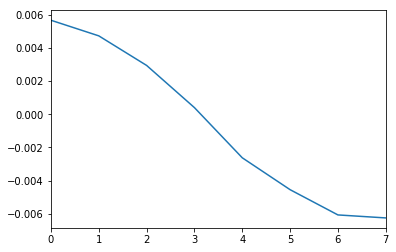

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.222x.dat


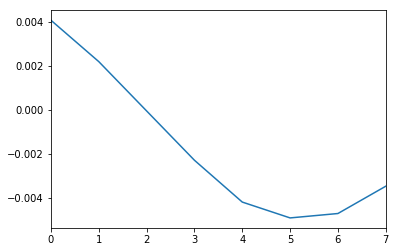

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.224x.dat


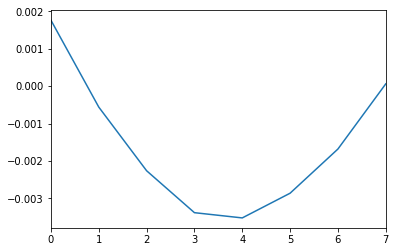

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0.3x.dat


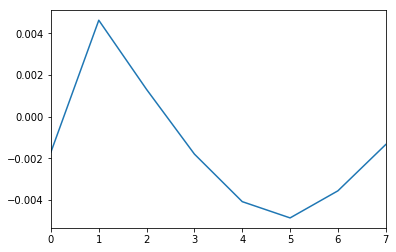

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.226x.dat


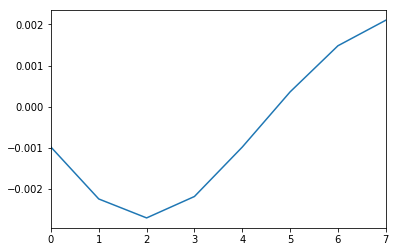

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.228x.dat


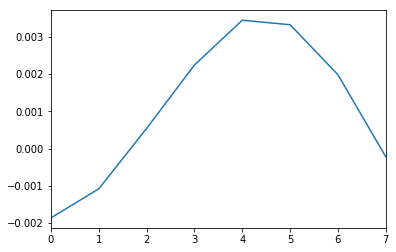

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.23x.dat


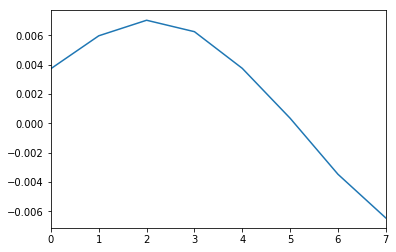

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.232x.dat


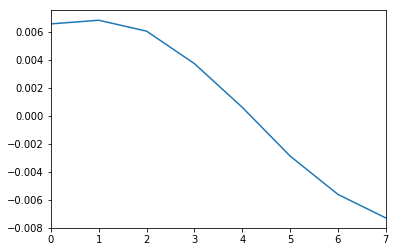

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.234x.dat


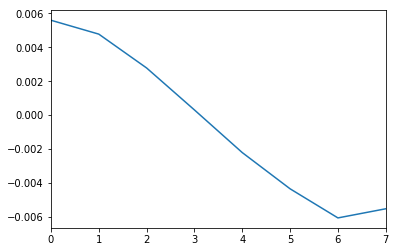

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.236x.dat


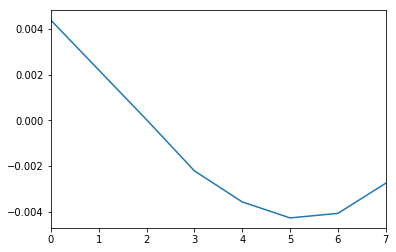

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.238x.dat


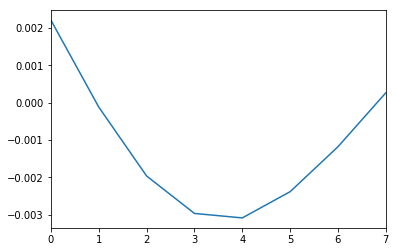

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.24x.dat


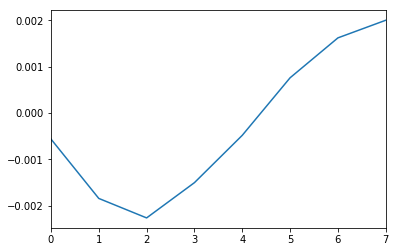

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.242x.dat


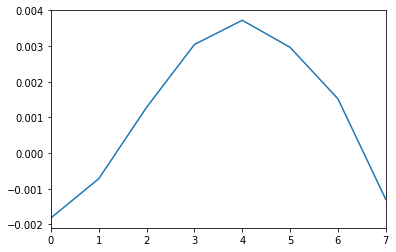

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.244x.dat


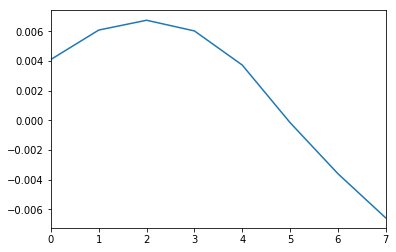

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0.218x.dat


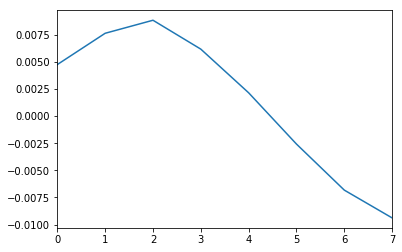

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.246x.dat


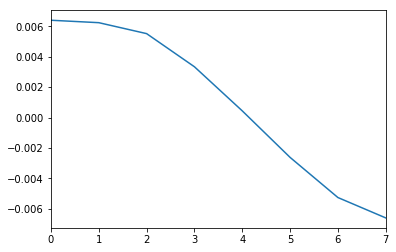

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.248x.dat


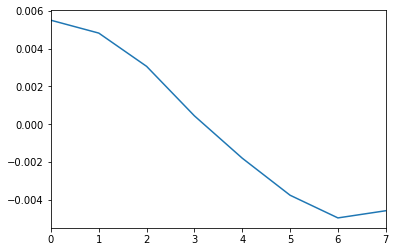

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.25x.dat


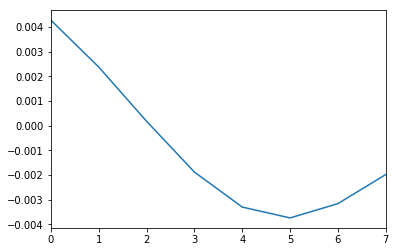

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.248x.dat


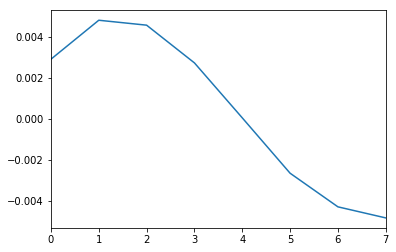

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.246x.dat


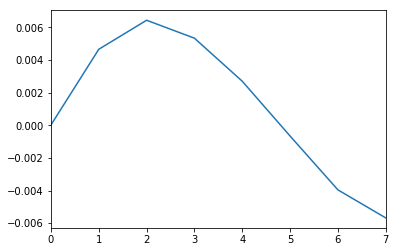

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.244x.dat


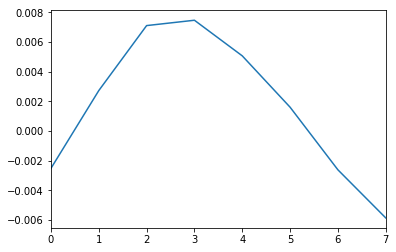

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.242x.dat


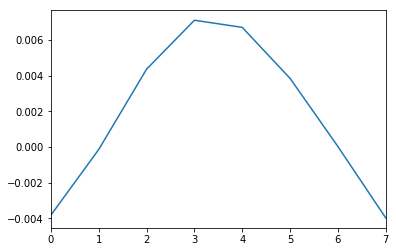

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.24x.dat


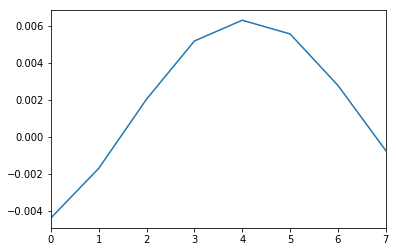

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.238x.dat


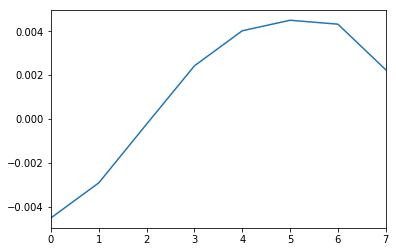

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.236x.dat


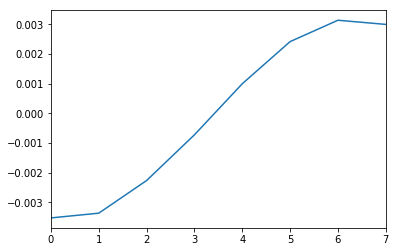

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.216x.dat


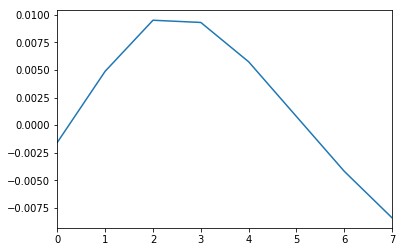

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.234x.dat


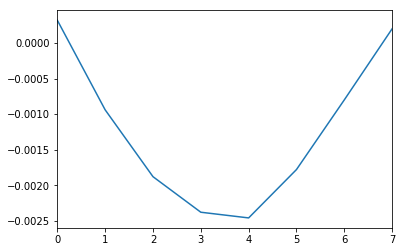

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.232x.dat


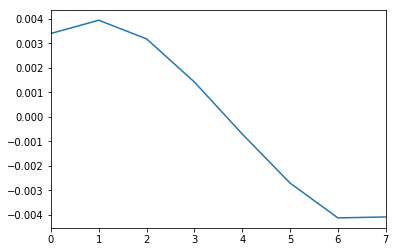

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.23x.dat


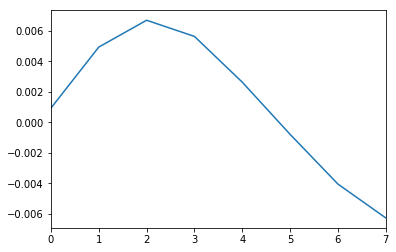

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.228x.dat


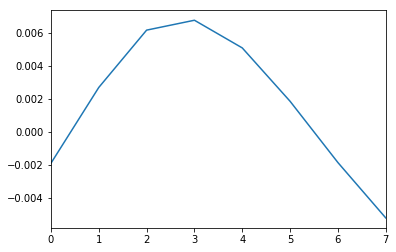

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.226x.dat


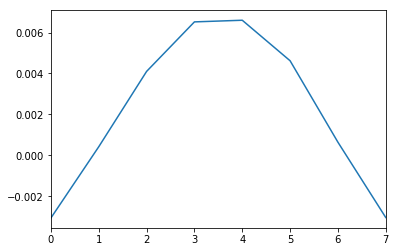

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.224x.dat


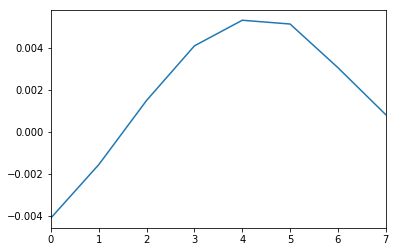

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.222x.dat


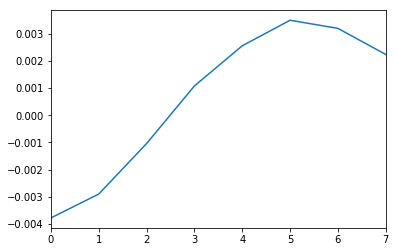

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.22x.dat


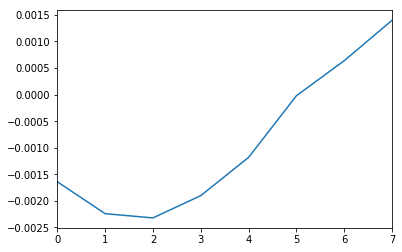

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.218x.dat


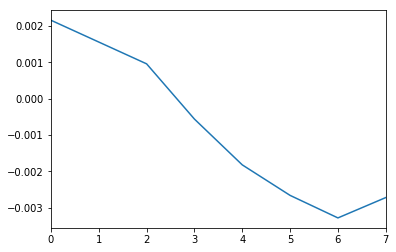

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.216x.dat


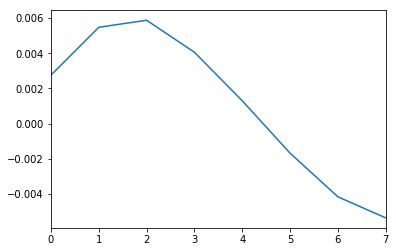

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.214x.dat


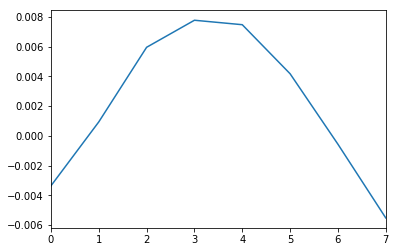

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.214x.dat


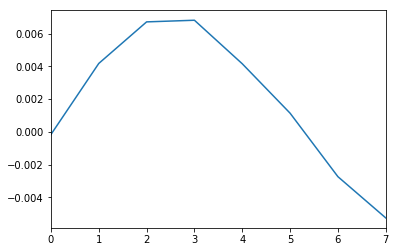

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.212x.dat


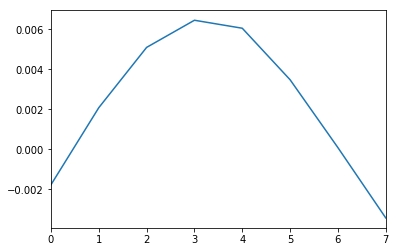

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.21x.dat


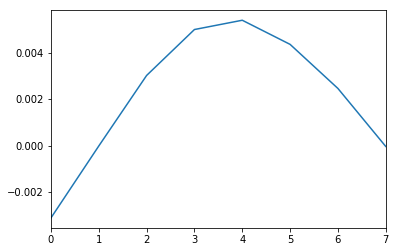

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.208x.dat


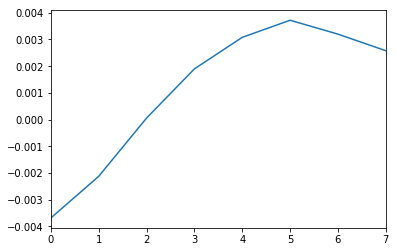

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.206x.dat


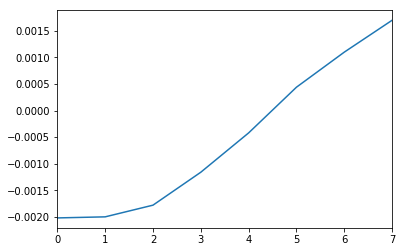

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.204x.dat


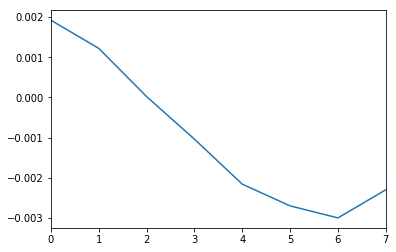

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.202x.dat


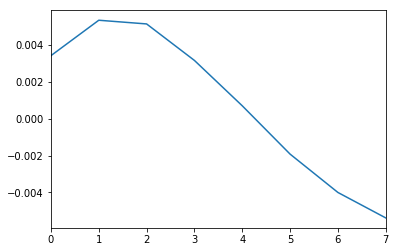

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.2x.dat


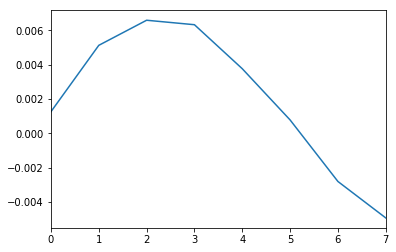

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.198x.dat


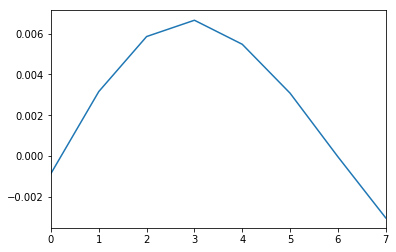

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.196x.dat


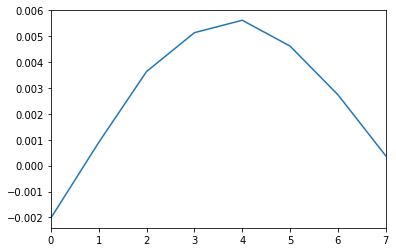

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.212x.dat


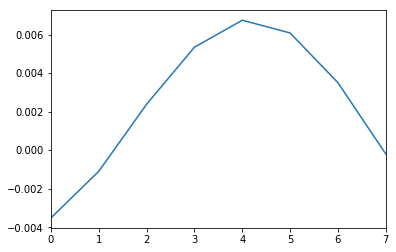

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.194x.dat


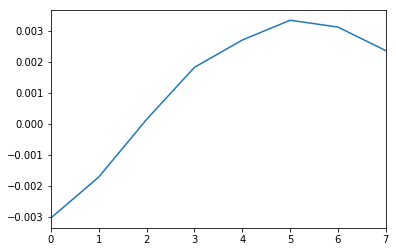

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.192x.dat


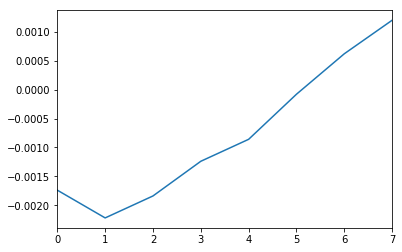

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.19x.dat


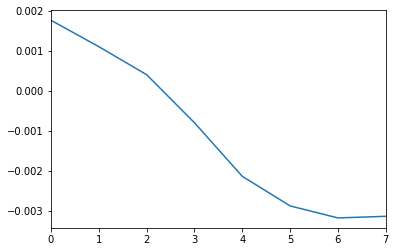

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.188x.dat


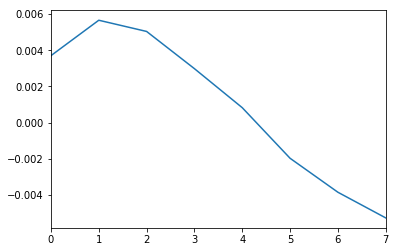

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.186x.dat


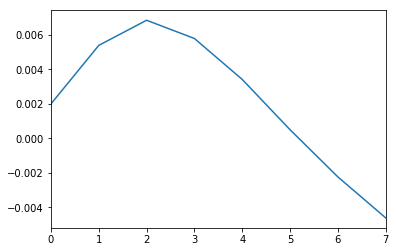

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.188x.dat


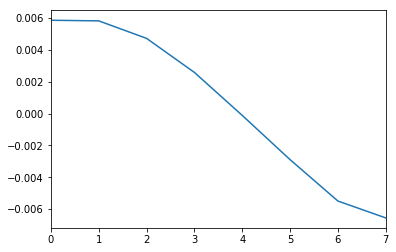

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.19x.dat


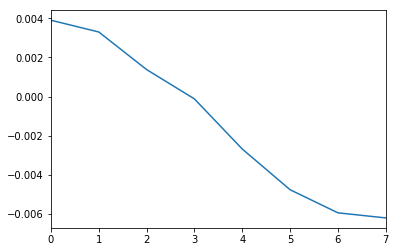

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.192x.dat


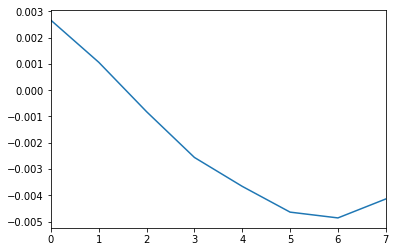

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.194x.dat


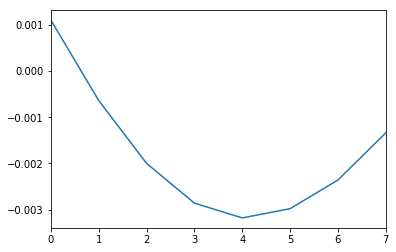

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.196x.dat


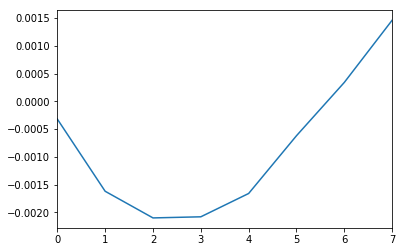

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.21x.dat


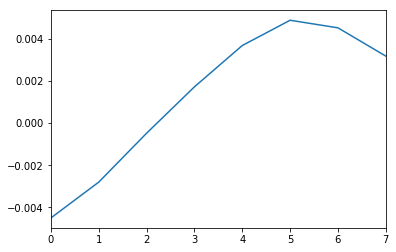

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.198x.dat


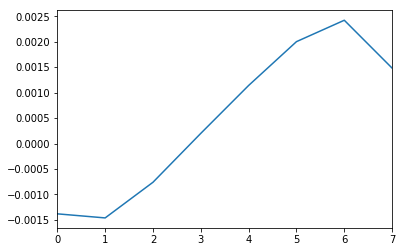

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.2x.dat


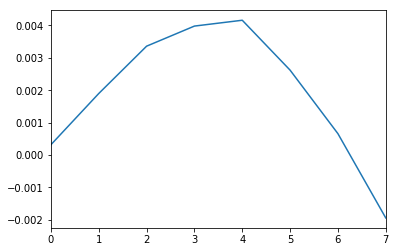

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.202x.dat


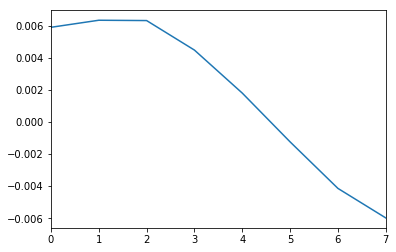

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.204x.dat


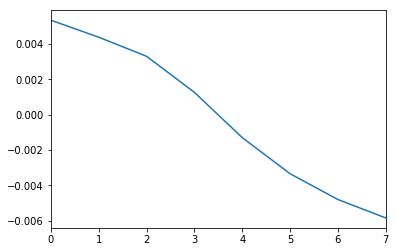

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.206x.dat


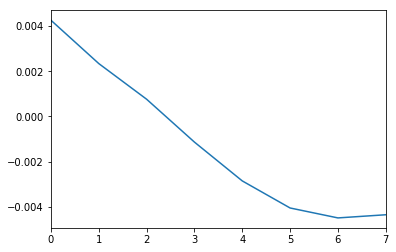

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.208x.dat


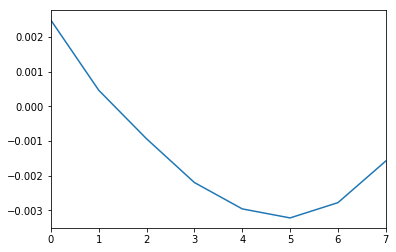

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.21x.dat


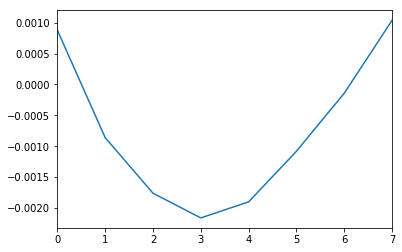

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.212x.dat


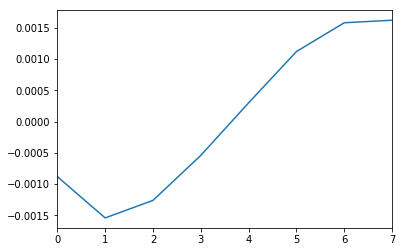

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.214x.dat


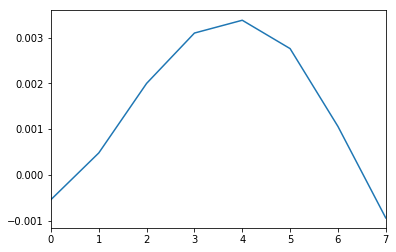

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.216x.dat


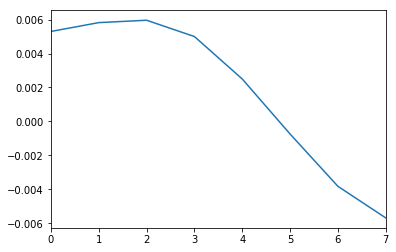

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.208x.dat


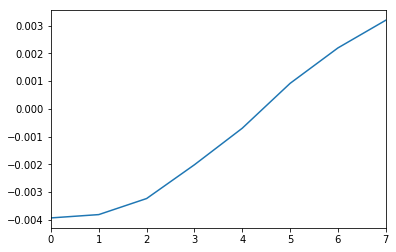

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.25x.dat


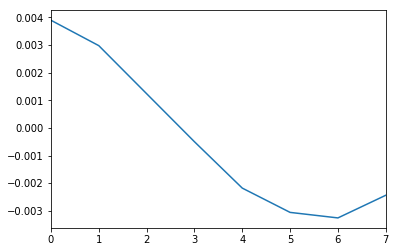

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.25x.dat


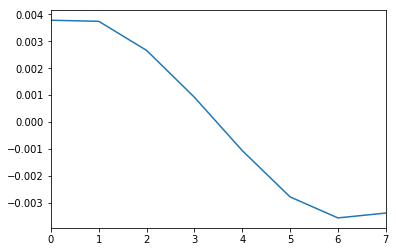

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.248x.dat


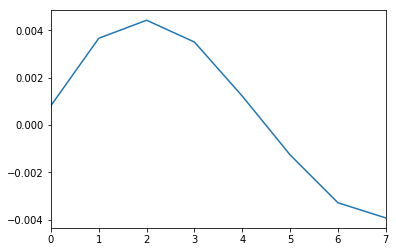

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.248x.dat


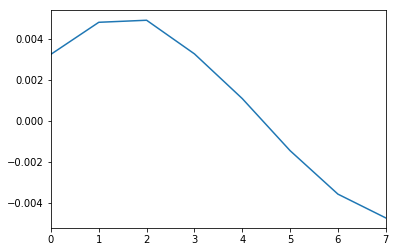

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.246x.dat


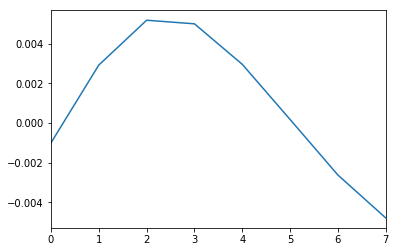

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.246x.dat


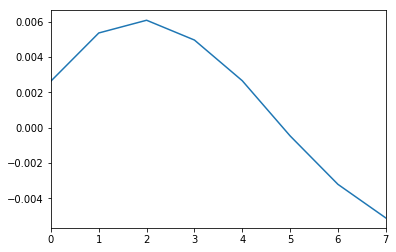

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.244x.dat


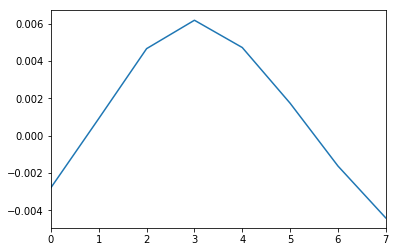

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.244x.dat


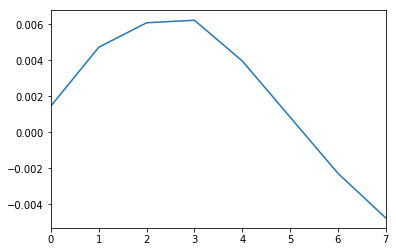

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.242x.dat


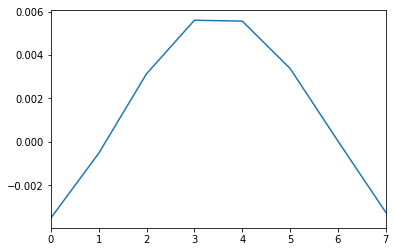

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.242x.dat


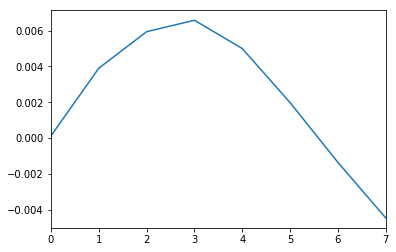

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.212x.dat


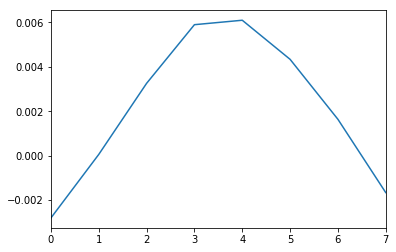

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.24x.dat


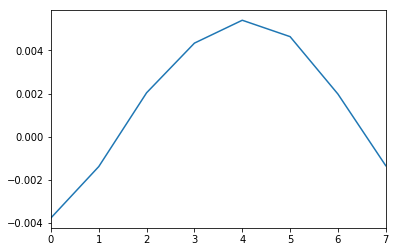

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.24x.dat


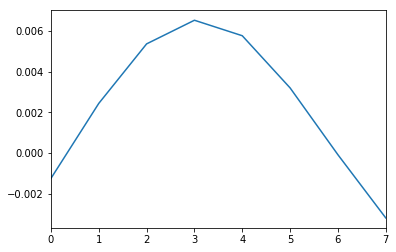

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.238x.dat


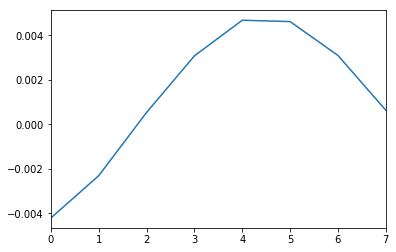

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.238x.dat


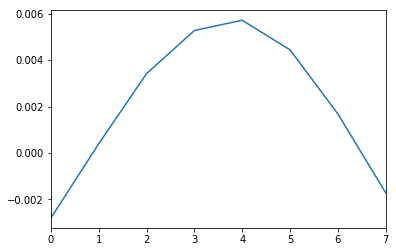

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.236x.dat


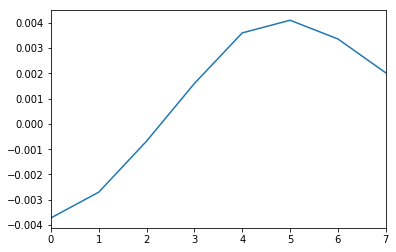

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.236x.dat


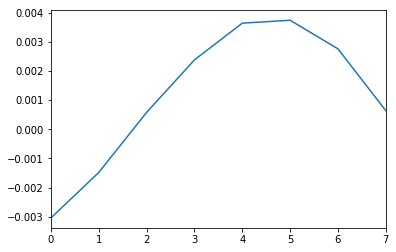

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.234x.dat


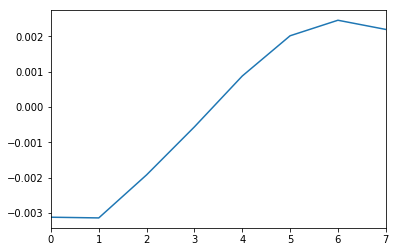

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.234x.dat


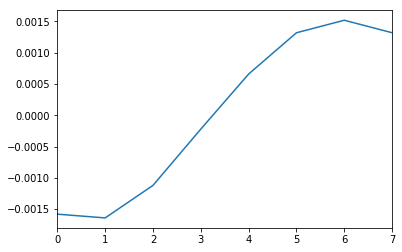

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.232x.dat


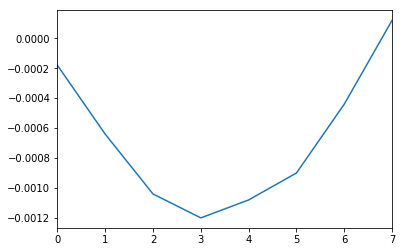

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.232x.dat


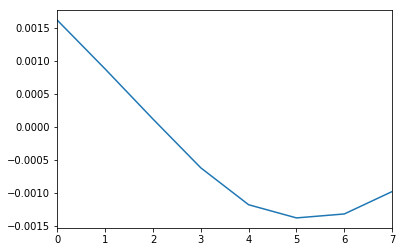

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.212x.dat


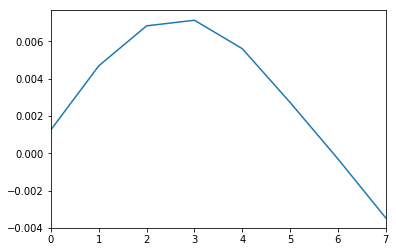

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.23x.dat


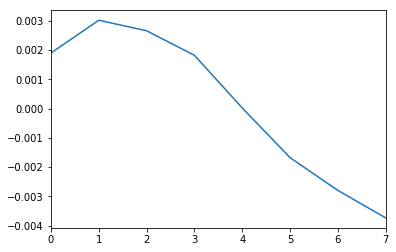

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.23x.dat


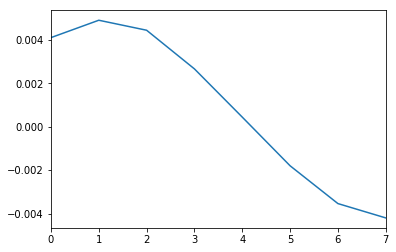

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.228x.dat


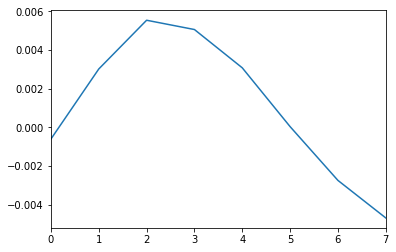

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.228x.dat


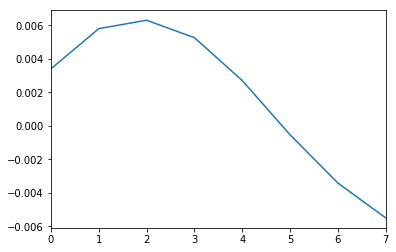

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.226x.dat


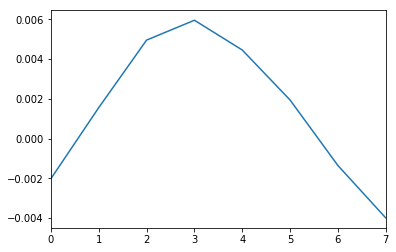

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.226x.dat


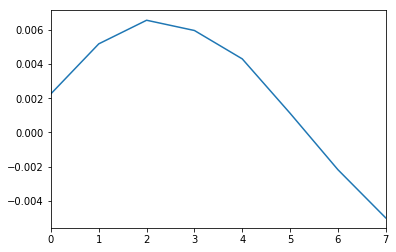

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.224x.dat


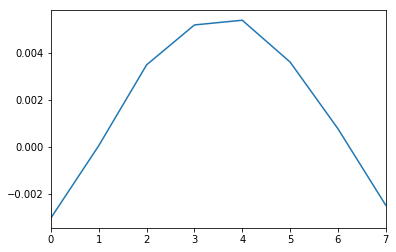

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.224x.dat


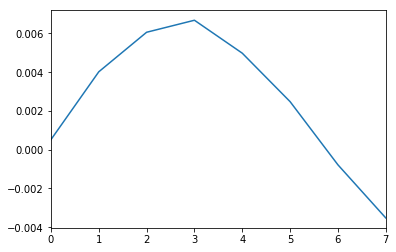

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.222x.dat


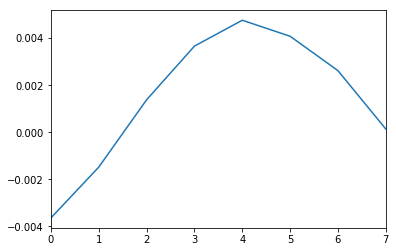

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -480_to_-60 BExternal 0.222x.dat


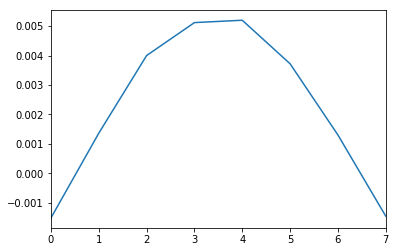

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.21x.dat


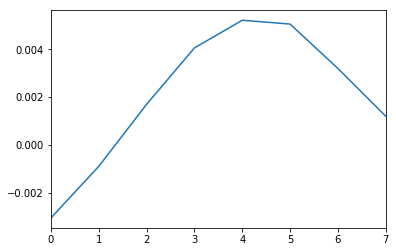

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -480_to_-60 BExternal 0.22x.dat


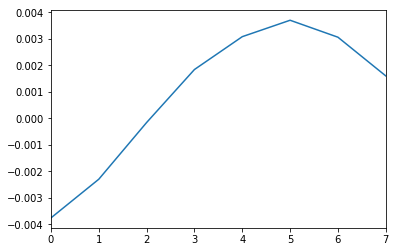

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -480_to_-60 BExternal 0.22x.dat


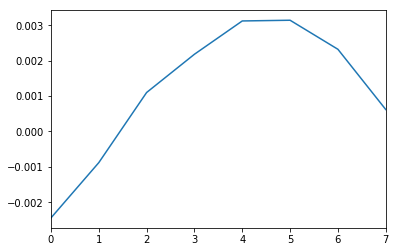

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -480_to_-60 BExternal 0.218x.dat


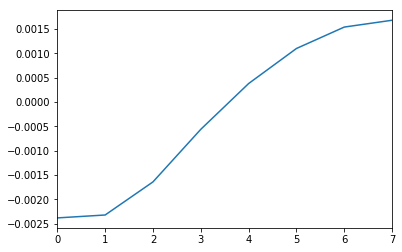

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_133_DelayTime -480_to_-60 BExternal 0.218x.dat


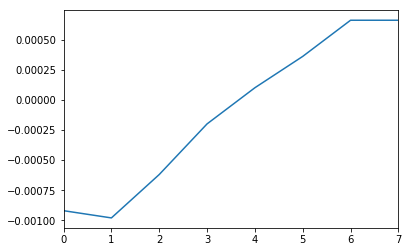

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_134_DelayTime -480_to_-60 BExternal 0.216x.dat


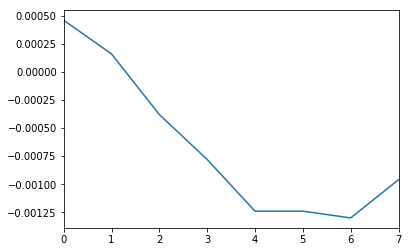

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_135_DelayTime -480_to_-60 BExternal 0.216x.dat


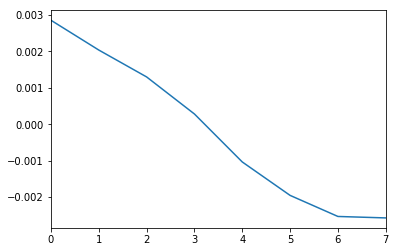

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_136_DelayTime -480_to_-60 BExternal 0.214x.dat


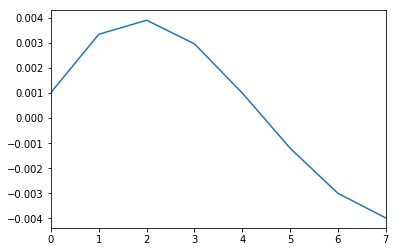

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_137_DelayTime -480_to_-60 BExternal 0.214x.dat


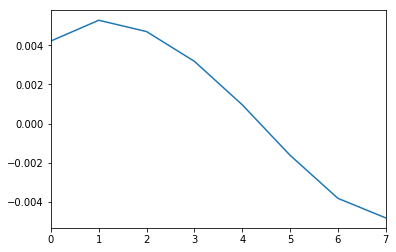

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_138_DelayTime -480_to_-60 BExternal 0.212x.dat


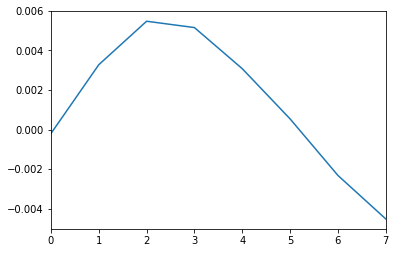

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_139_DelayTime -480_to_-60 BExternal 0.212x.dat


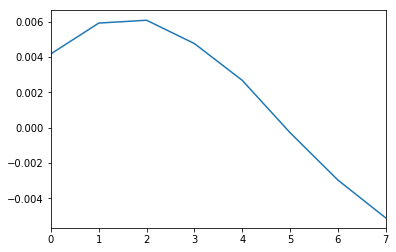

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.21x.dat


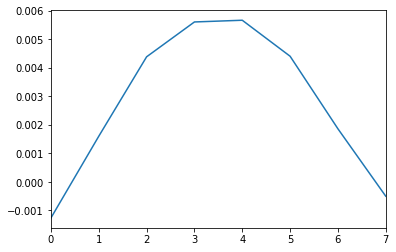

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_140_DelayTime -480_to_-60 BExternal 0.21x.dat


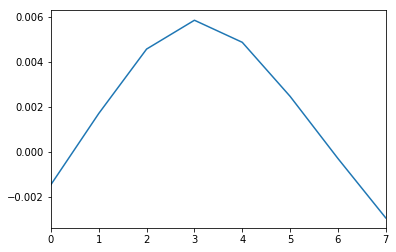

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_141_DelayTime -480_to_-60 BExternal 0.21x.dat


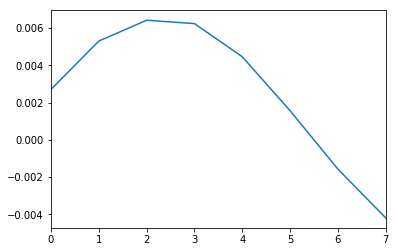

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_142_DelayTime -480_to_-60 BExternal 0.208x.dat


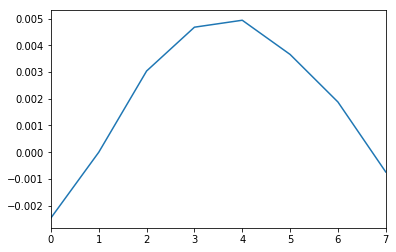

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_143_DelayTime -480_to_-60 BExternal 0.208x.dat


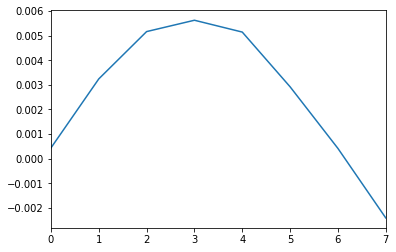

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_144_DelayTime -480_to_-60 BExternal 0.206x.dat


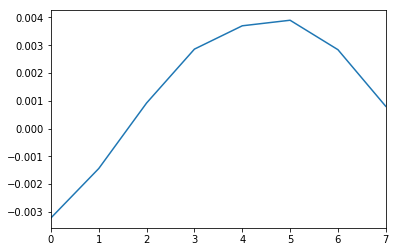

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_145_DelayTime -480_to_-60 BExternal 0.206x.dat


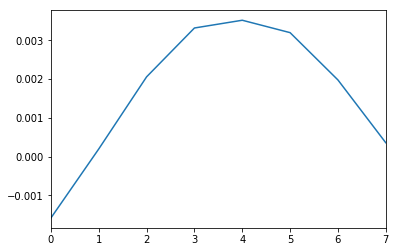

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_146_DelayTime -480_to_-60 BExternal 0.204x.dat


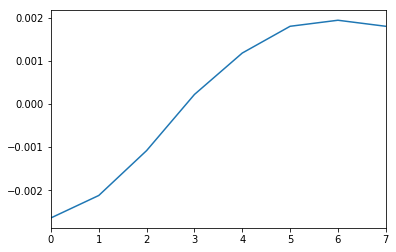

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_147_DelayTime -480_to_-60 BExternal 0.204x.dat


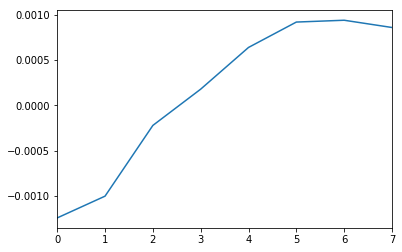

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_148_DelayTime -480_to_-60 BExternal 0.202x.dat


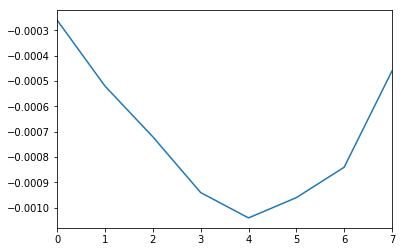

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_149_DelayTime -480_to_-60 BExternal 0.202x.dat


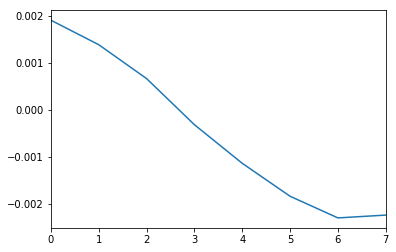

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.208x.dat


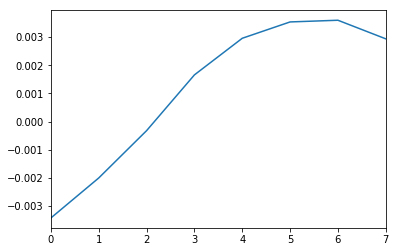

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_150_DelayTime -480_to_-60 BExternal 0.2x.dat


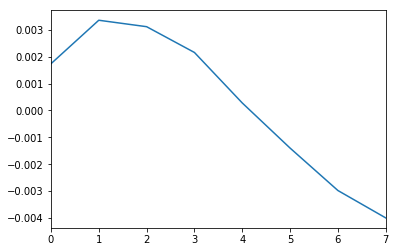

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_151_DelayTime -480_to_-60 BExternal 0.2x.dat


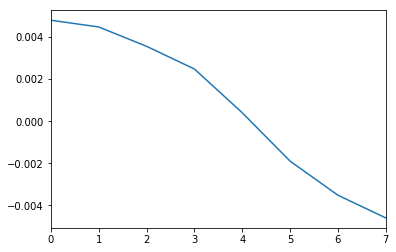

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_152_DelayTime -480_to_-60 BExternal 0.198x.dat


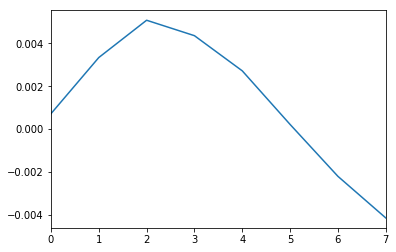

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_153_DelayTime -480_to_-60 BExternal 0.198x.dat


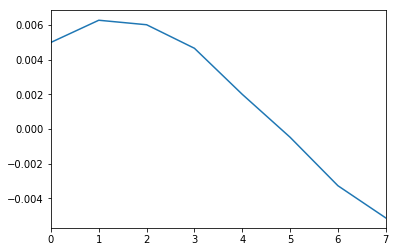

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_154_DelayTime -480_to_-60 BExternal 0.196x.dat


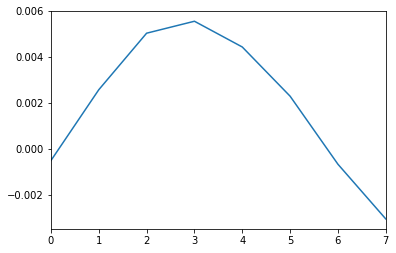

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_155_DelayTime -480_to_-60 BExternal 0.196x.dat


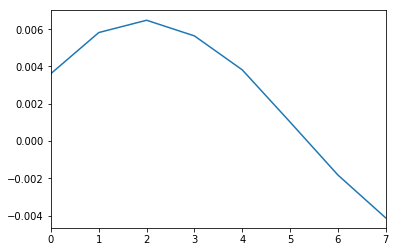

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_156_DelayTime -480_to_-60 BExternal 0.194x.dat


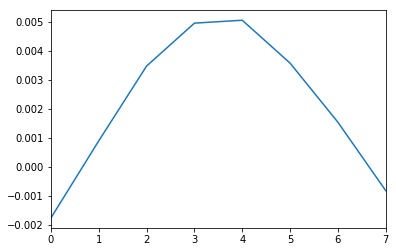

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_157_DelayTime -480_to_-60 BExternal 0.194x.dat


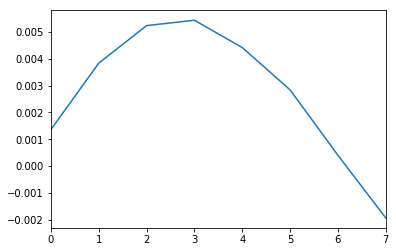

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_158_DelayTime -480_to_-60 BExternal 0.192x.dat


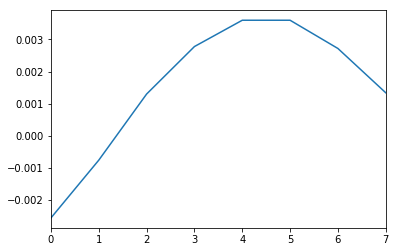

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_159_DelayTime -480_to_-60 BExternal 0.192x.dat


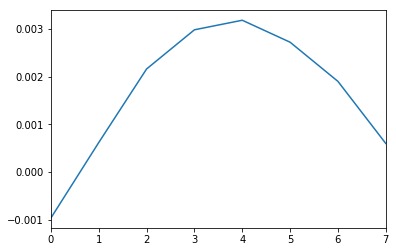

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.208x.dat


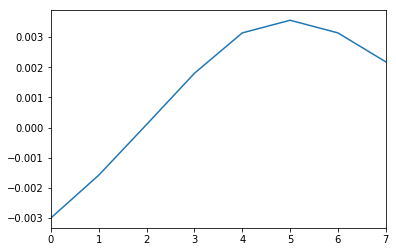

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_160_DelayTime -480_to_-60 BExternal 0.19x.dat


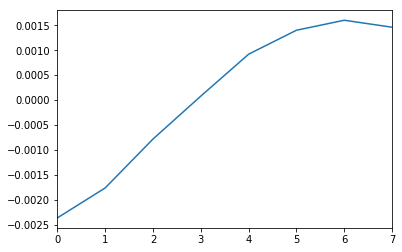

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_161_DelayTime -480_to_-60 BExternal 0.19x.dat


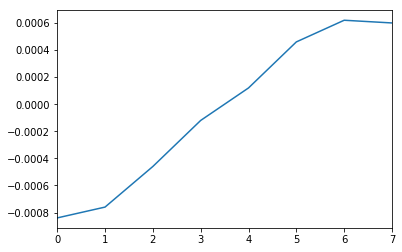

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_162_DelayTime -480_to_-60 BExternal 0.188x.dat


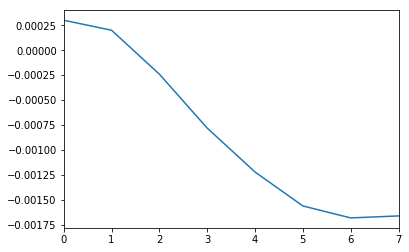

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_163_DelayTime -480_to_-60 BExternal 0.188x.dat


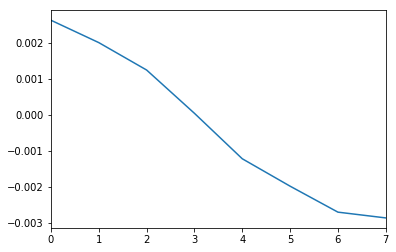

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_164_DelayTime -480_to_-60 BExternal 0.186x.dat


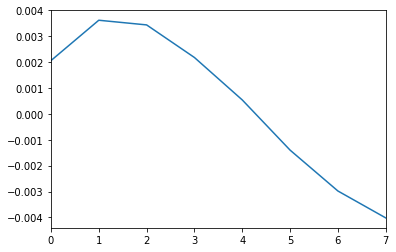

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_165_DelayTime -480_to_-60 BExternal 0.186x.dat


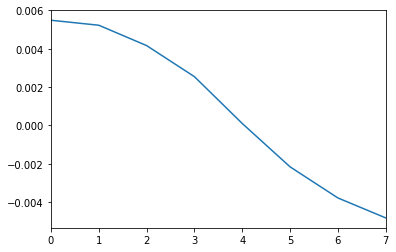

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_166_DelayTime -480_to_-60 BExternal 0.188x.dat


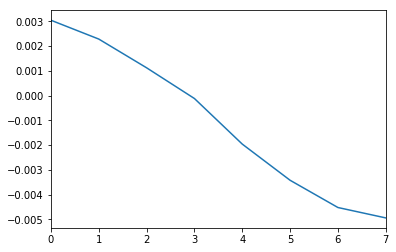

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_167_DelayTime -480_to_-60 BExternal 0.188x.dat


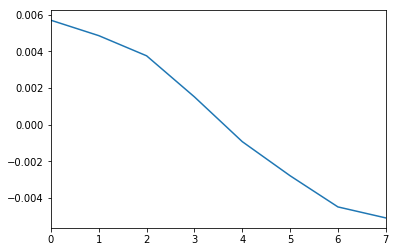

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_168_DelayTime -480_to_-60 BExternal 0.19x.dat


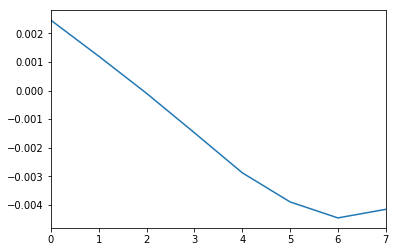

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_169_DelayTime -480_to_-60 BExternal 0.19x.dat


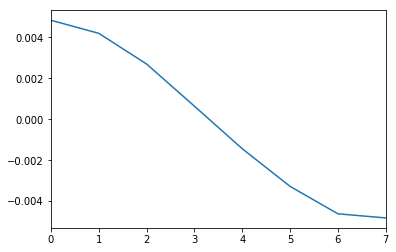

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.206x.dat


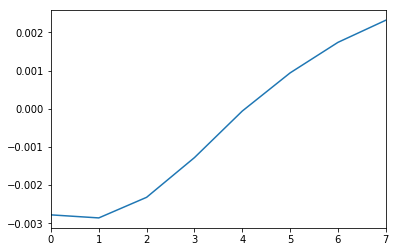

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_170_DelayTime -480_to_-60 BExternal 0.192x.dat


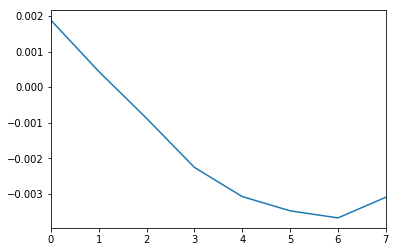

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_171_DelayTime -480_to_-60 BExternal 0.192x.dat


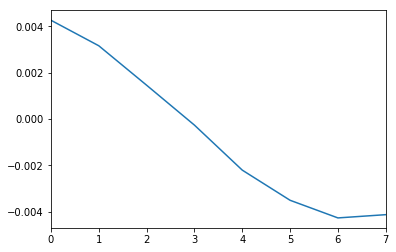

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_172_DelayTime -480_to_-60 BExternal 0.194x.dat


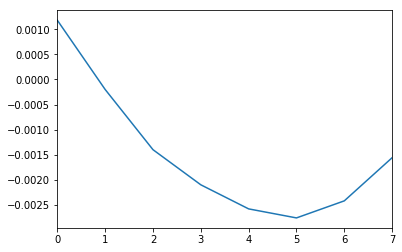

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_173_DelayTime -480_to_-60 BExternal 0.194x.dat


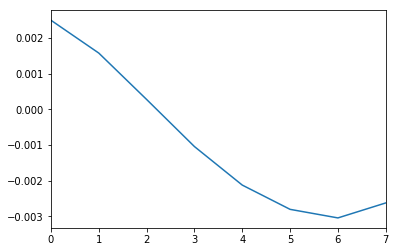

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_174_DelayTime -480_to_-60 BExternal 0.196x.dat


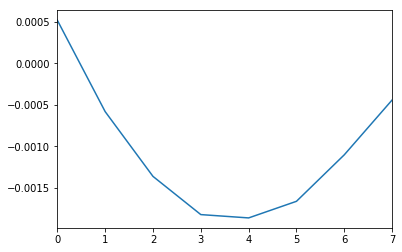

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_175_DelayTime -480_to_-60 BExternal 0.196x.dat


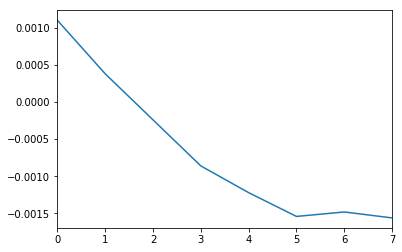

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_176_DelayTime -480_to_-60 BExternal 0.198x.dat


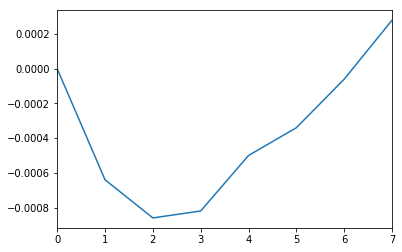

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_177_DelayTime -480_to_-60 BExternal 0.198x.dat


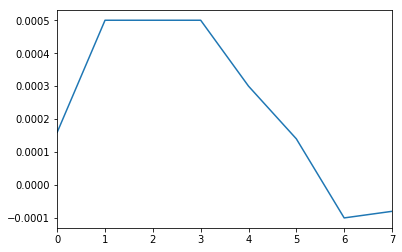

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_178_DelayTime -480_to_-60 BExternal 0.2x.dat


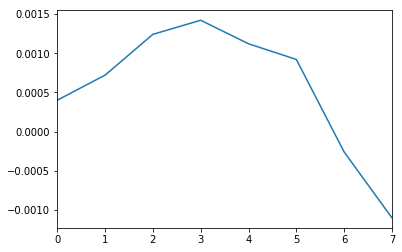

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_179_DelayTime -480_to_-60 BExternal 0.2x.dat


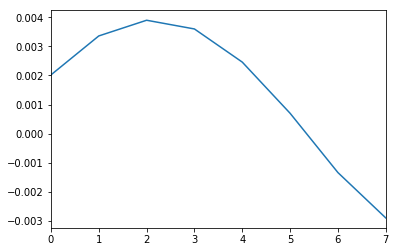

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.206x.dat


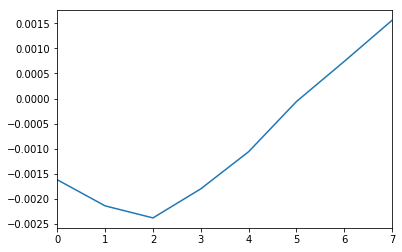

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_180_DelayTime -480_to_-60 BExternal 0.202x.dat


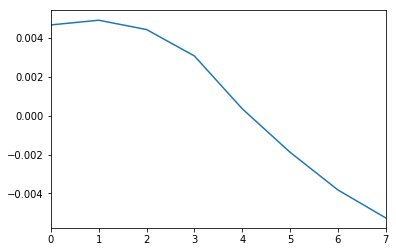

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_181_DelayTime -480_to_-60 BExternal 0.202x.dat


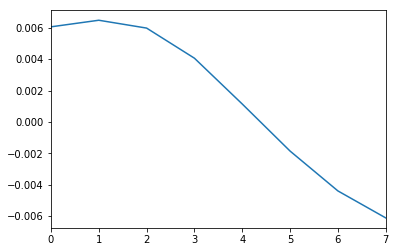

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_182_DelayTime -480_to_-60 BExternal 0.204x.dat


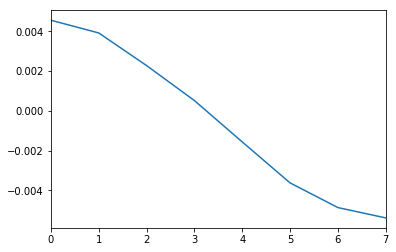

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_183_DelayTime -480_to_-60 BExternal 0.204x.dat


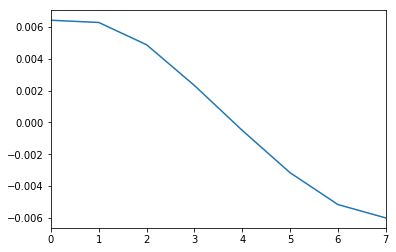

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_184_DelayTime -480_to_-60 BExternal 0.206x.dat


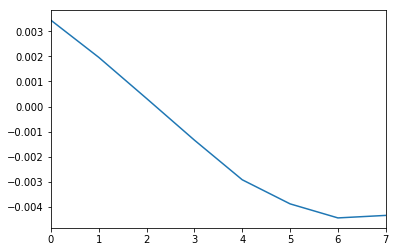

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_185_DelayTime -480_to_-60 BExternal 0.206x.dat


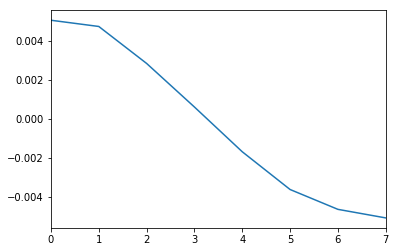

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_186_DelayTime -480_to_-60 BExternal 0.208x.dat


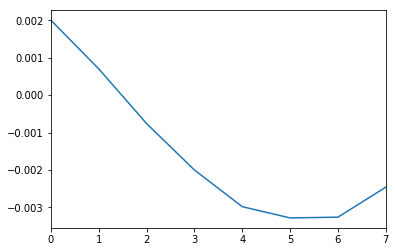

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_187_DelayTime -480_to_-60 BExternal 0.208x.dat


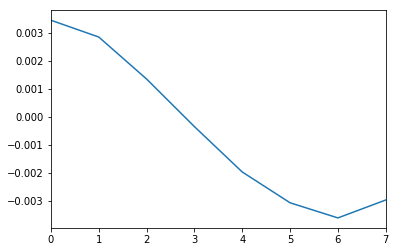

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_188_DelayTime -480_to_-60 BExternal 0.21x.dat


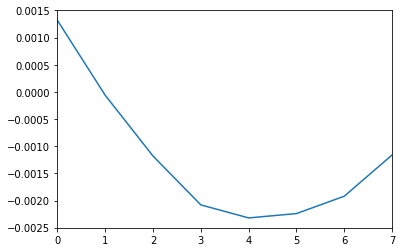

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_189_DelayTime -480_to_-60 BExternal 0.21x.dat


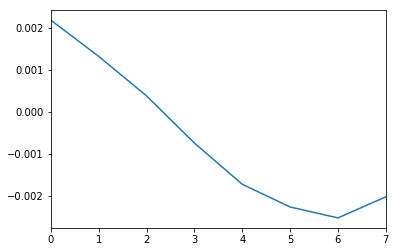

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.204x.dat


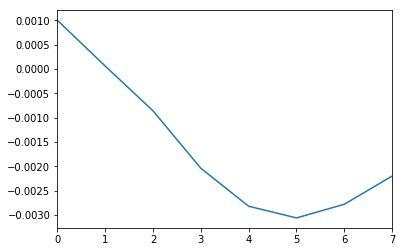

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_190_DelayTime -480_to_-60 BExternal 0.212x.dat


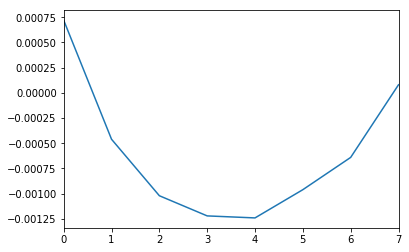

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_191_DelayTime -480_to_-60 BExternal 0.212x.dat


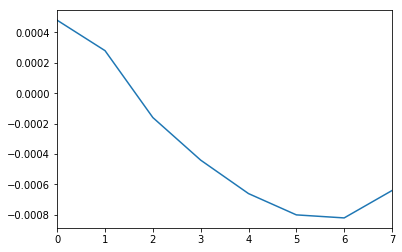

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_192_DelayTime -480_to_-60 BExternal 0.214x.dat


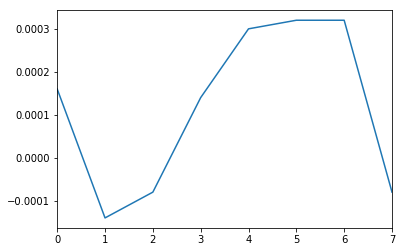

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_193_DelayTime -480_to_-60 BExternal 0.214x.dat


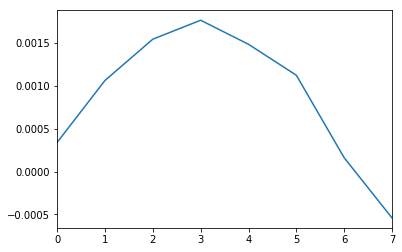

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_194_DelayTime -480_to_-60 BExternal 0.216x.dat


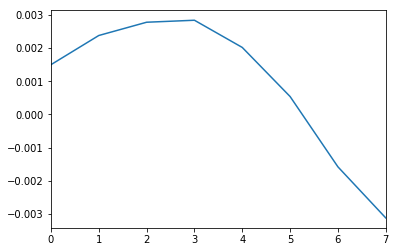

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_195_DelayTime -480_to_-60 BExternal 0.216x.dat


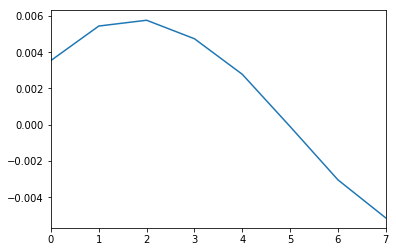

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_196_DelayTime -480_to_-60 BExternal 0.218x.dat


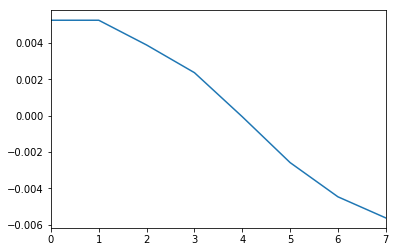

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_197_DelayTime -480_to_-60 BExternal 0.218x.dat


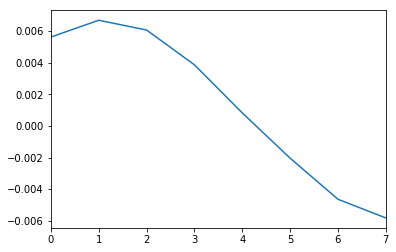

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.204x.dat


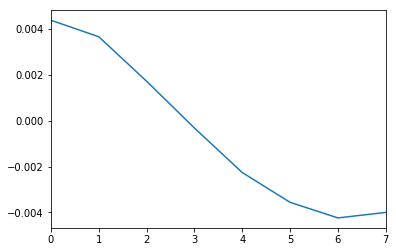

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


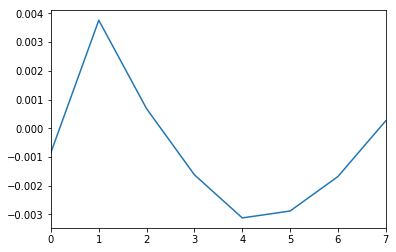

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.202x.dat


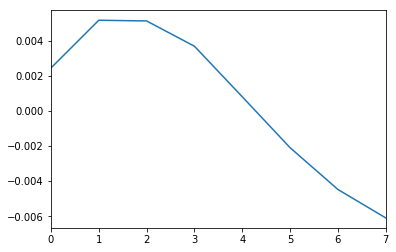

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.202x.dat


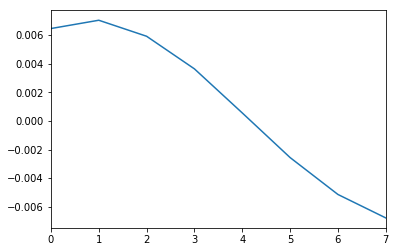

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.2x.dat


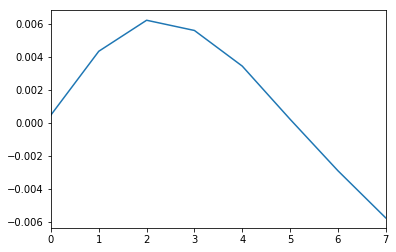

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.2x.dat


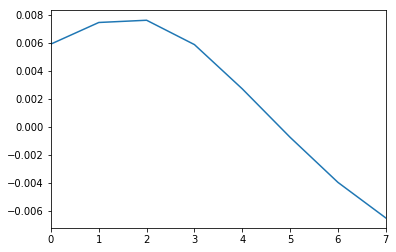

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.198x.dat


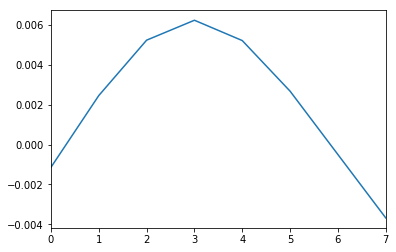

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.198x.dat


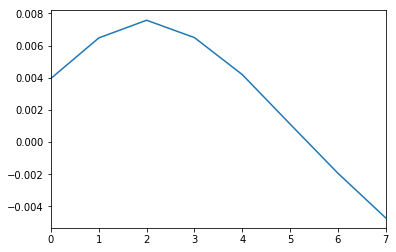

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.196x.dat


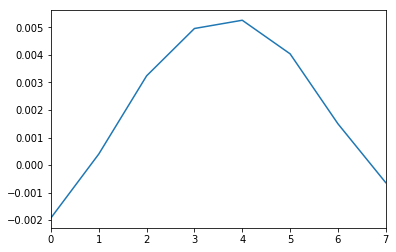

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.196x.dat


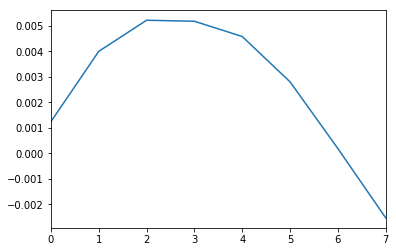

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.194x.dat


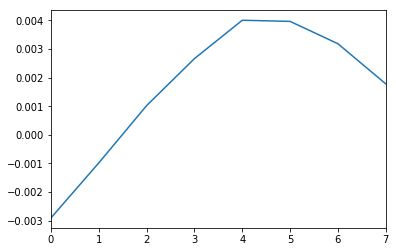

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.194x.dat


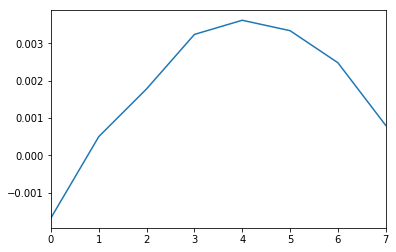

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal 0x.dat


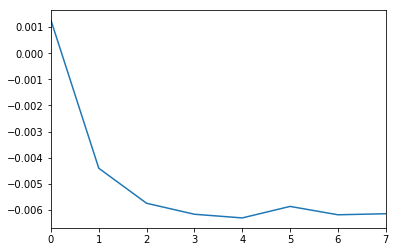

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.192x.dat


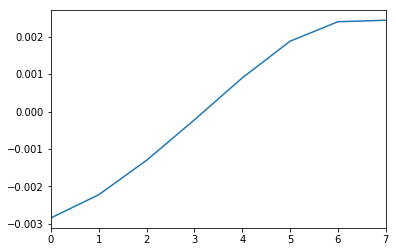

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.192x.dat


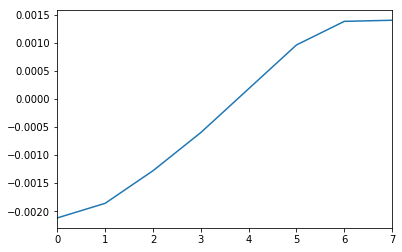

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.19x.dat


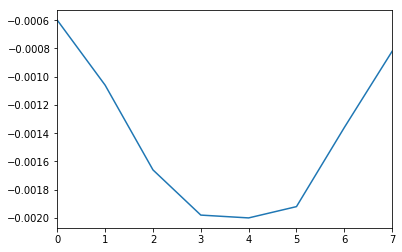

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.19x.dat


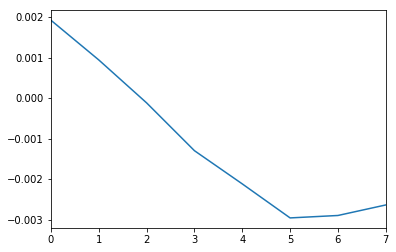

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.188x.dat


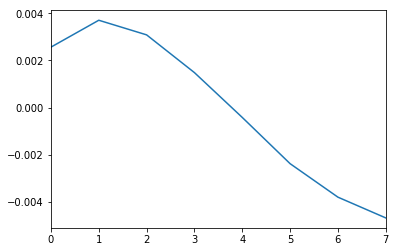

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.188x.dat


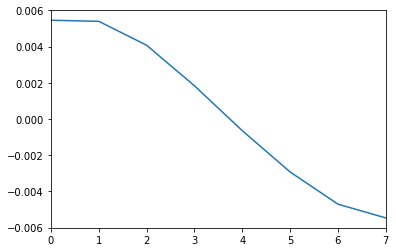

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.186x.dat


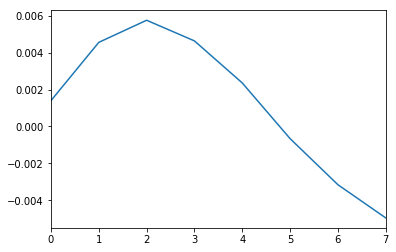

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.186x.dat


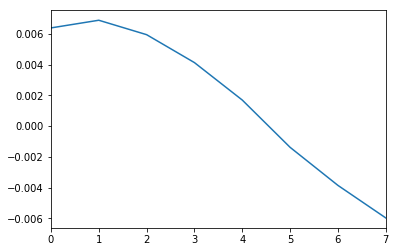

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.188x.dat


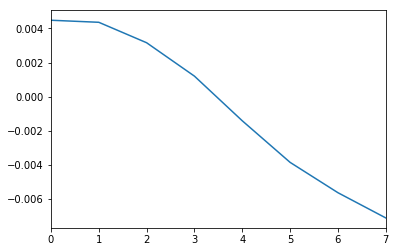

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.188x.dat


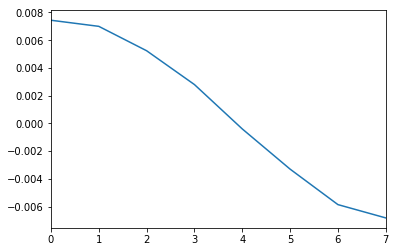

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0.3x.dat


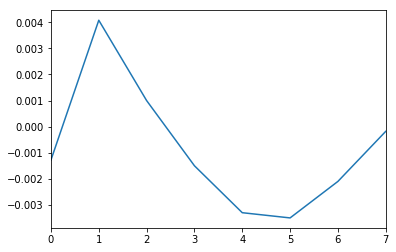

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.19x.dat


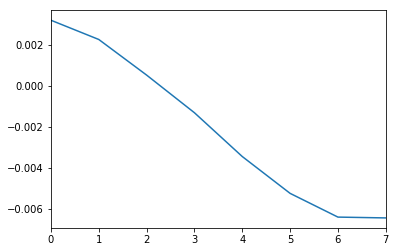

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.19x.dat


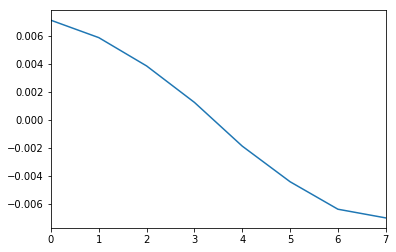

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.192x.dat


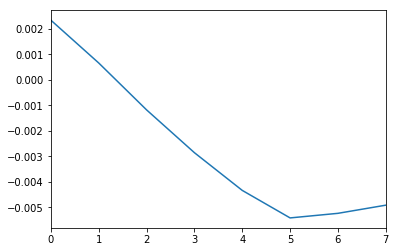

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.192x.dat


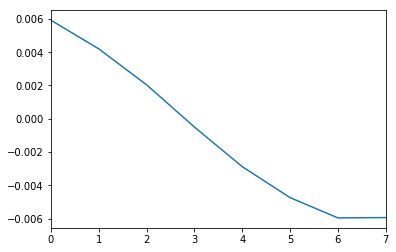

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.194x.dat


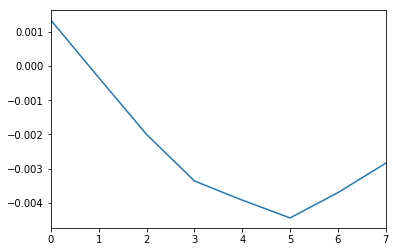

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.194x.dat


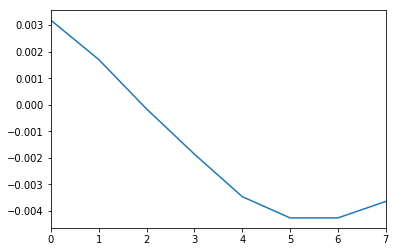

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.196x.dat


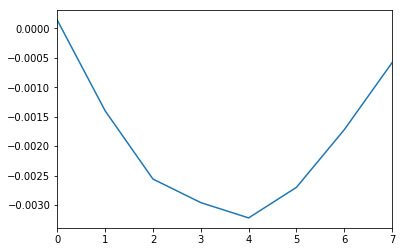

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.196x.dat


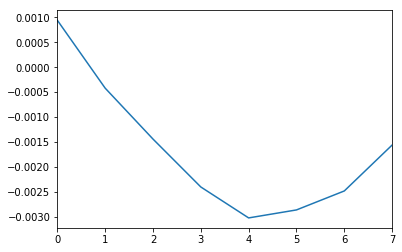

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.198x.dat


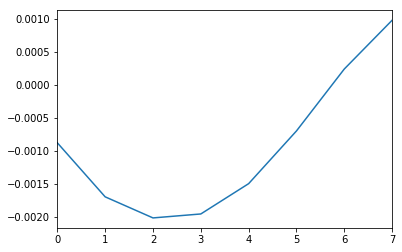

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.198x.dat


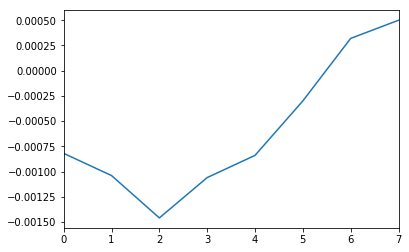

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0.218x.dat


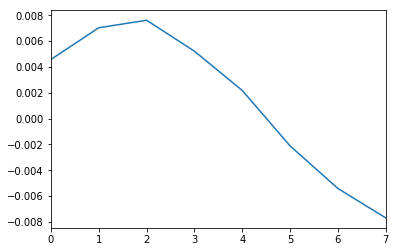

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.2x.dat


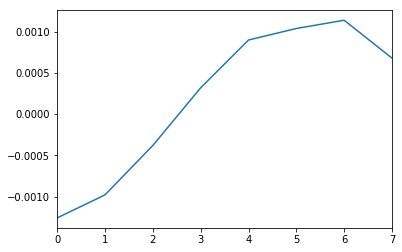

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.2x.dat


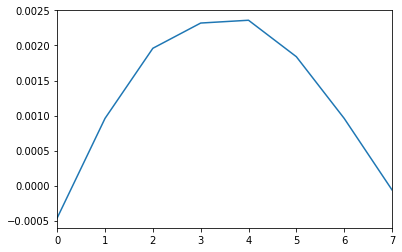

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.202x.dat


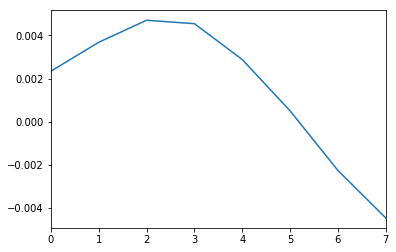

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.202x.dat


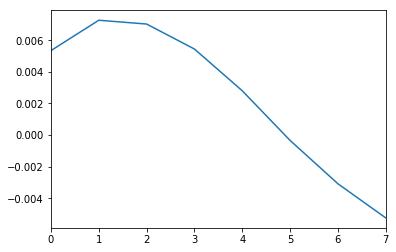

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.204x.dat


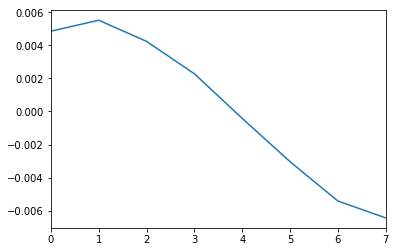

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.204x.dat


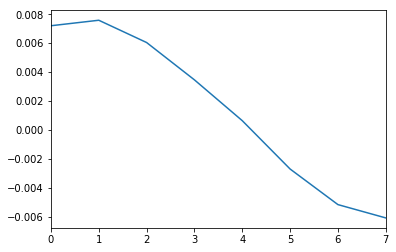

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.206x.dat


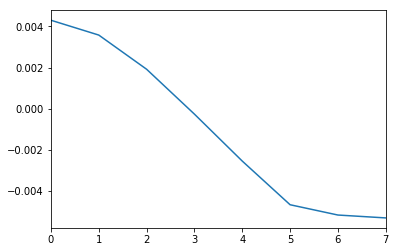

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.206x.dat


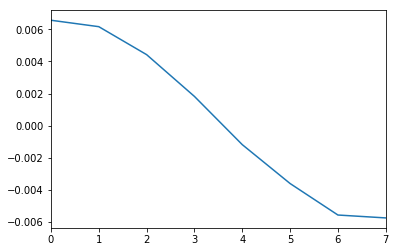

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.208x.dat


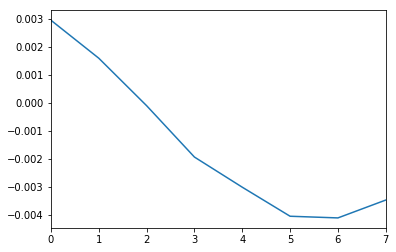

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.208x.dat


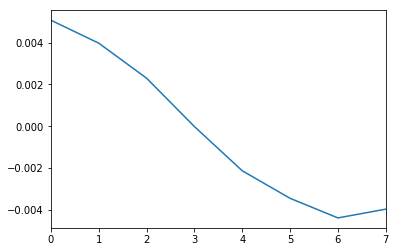

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.218x.dat


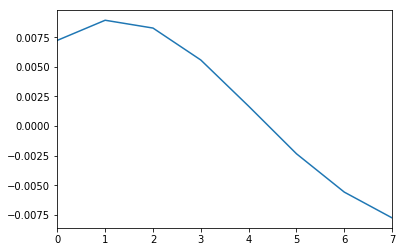

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.21x.dat


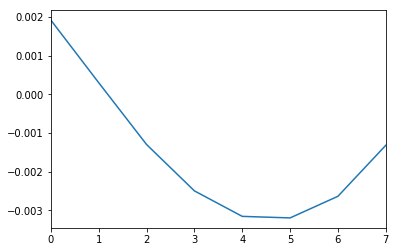

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.21x.dat


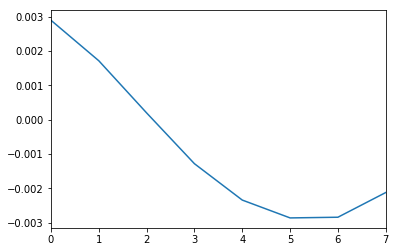

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.212x.dat


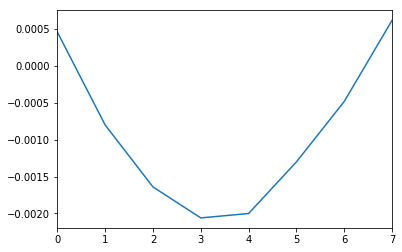

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.212x.dat


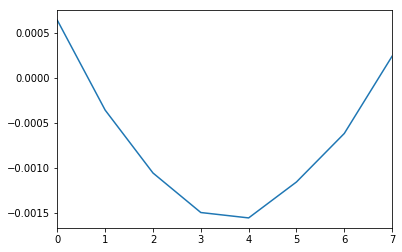

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.214x.dat


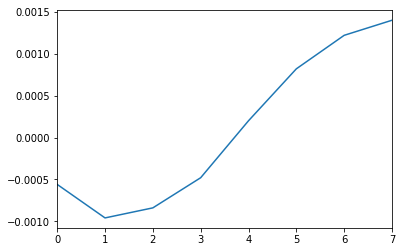

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.214x.dat


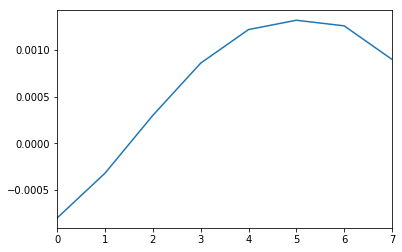

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.216x.dat


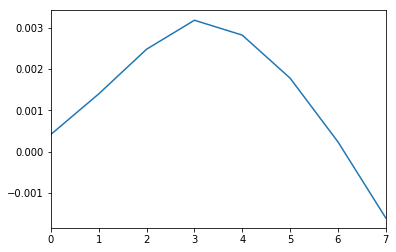

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.216x.dat


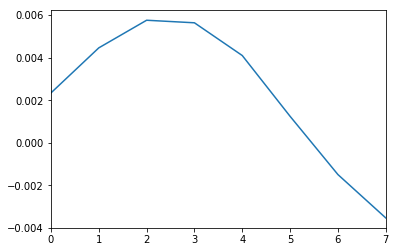

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.218x.dat


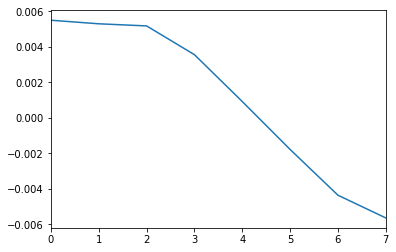

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.218x.dat


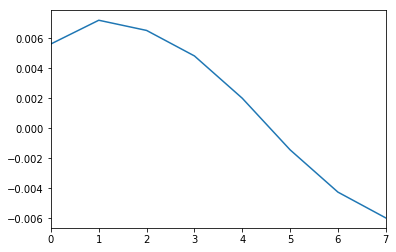

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.216x.dat


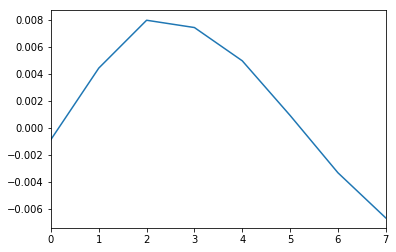

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.22x.dat


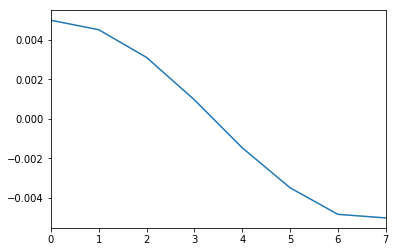

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.22x.dat


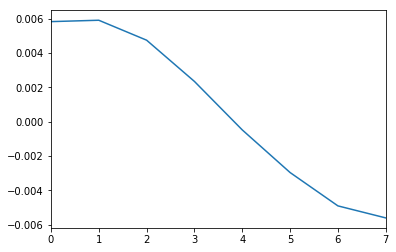

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.222x.dat


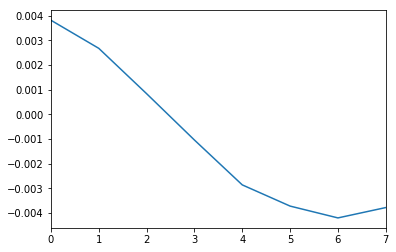

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.222x.dat


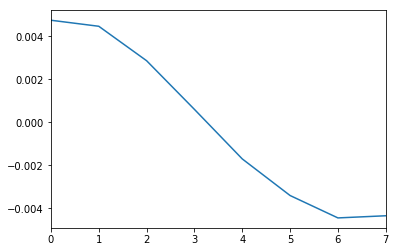

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.224x.dat


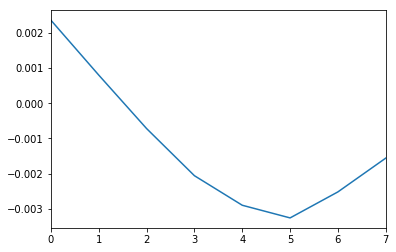

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.224x.dat


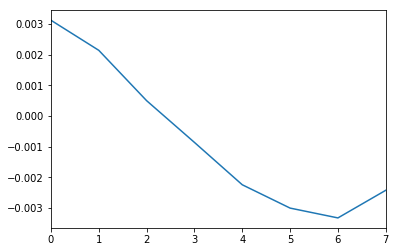

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.226x.dat


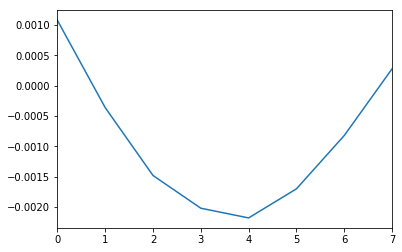

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.226x.dat


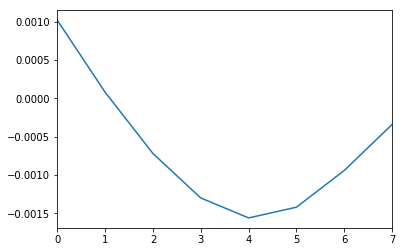

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.228x.dat


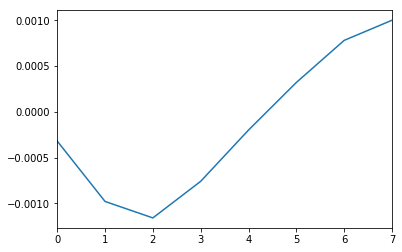

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


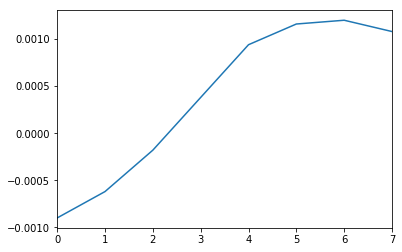

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.216x.dat


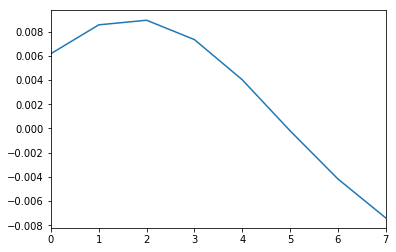

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.23x.dat


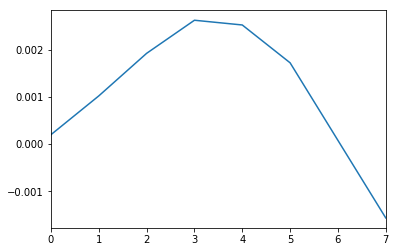

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.23x.dat


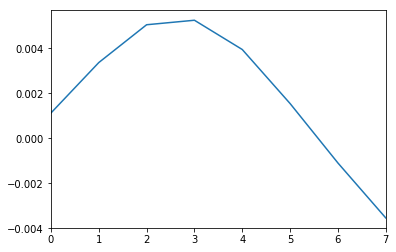

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.232x.dat


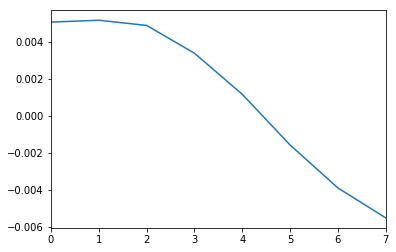

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.232x.dat


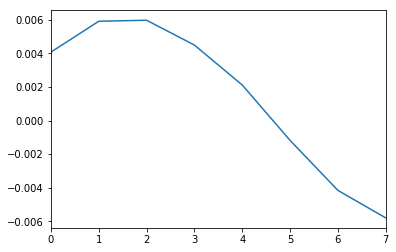

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.234x.dat


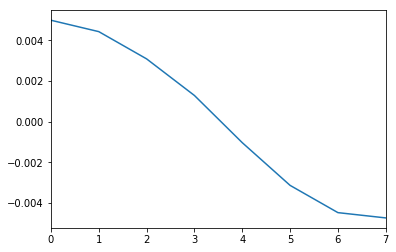

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.234x.dat


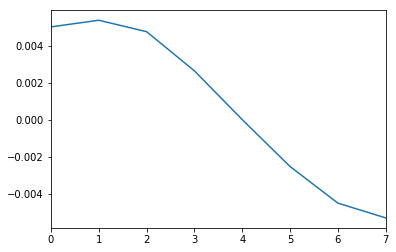

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.236x.dat


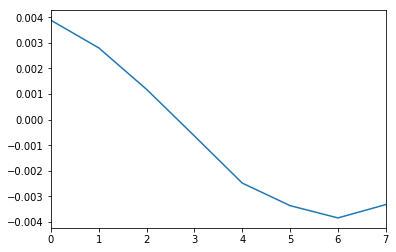

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.236x.dat


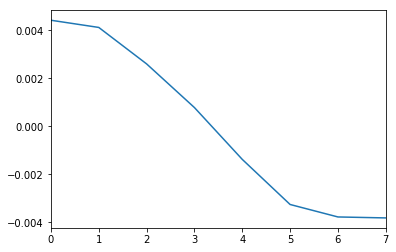

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.238x.dat


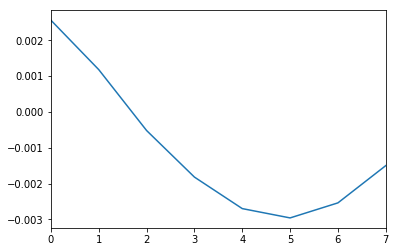

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.238x.dat


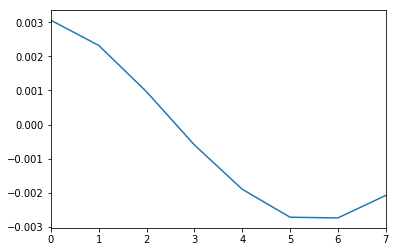

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.214x.dat


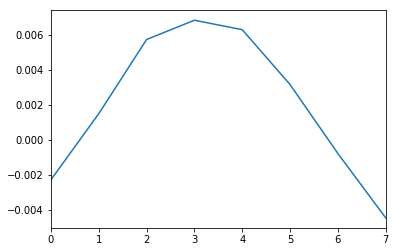

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.24x.dat


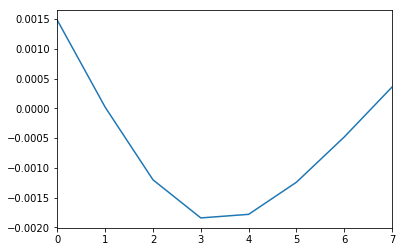

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.24x.dat


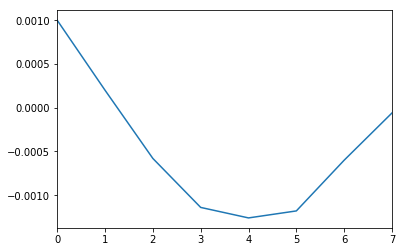

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.242x.dat


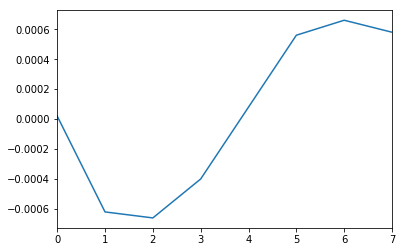

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.242x.dat


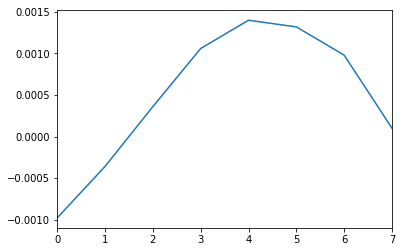

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.244x.dat


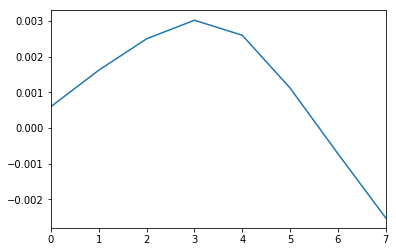

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.244x.dat


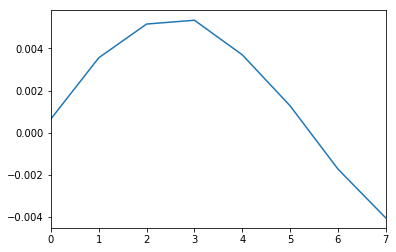

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.246x.dat


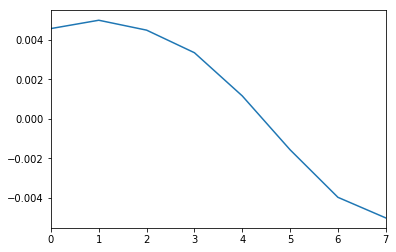

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.246x.dat


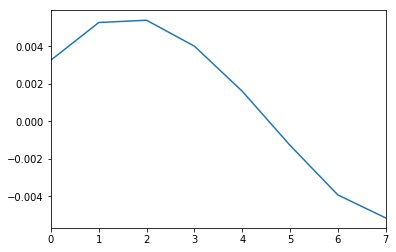

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.248x.dat


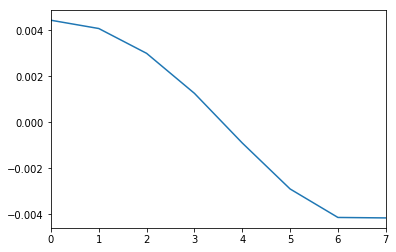

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.248x.dat


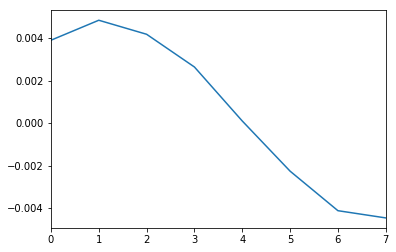

C:\Data\apr2017\170409\TestPhaseShift2_0590uWpump_TRKR_wide_2repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.214x.dat


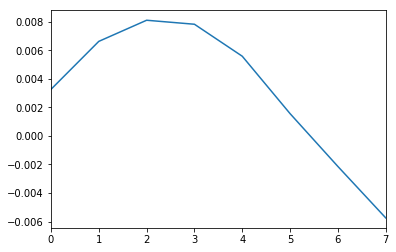

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


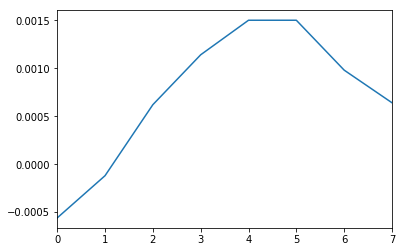

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


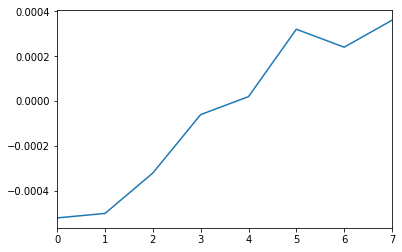

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


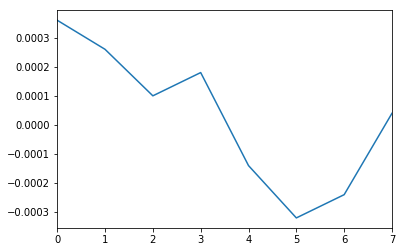

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


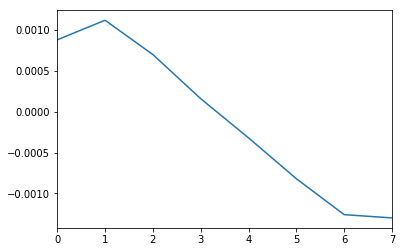

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


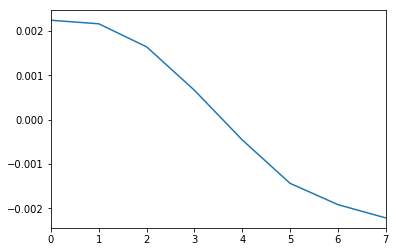

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


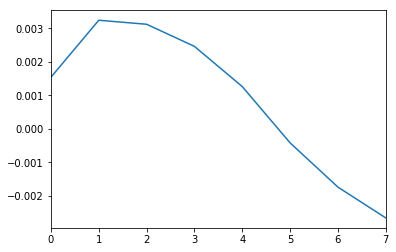

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


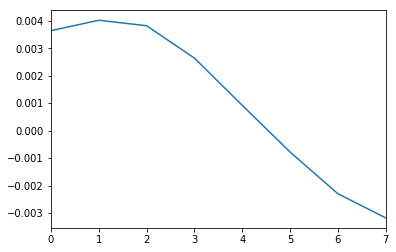

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


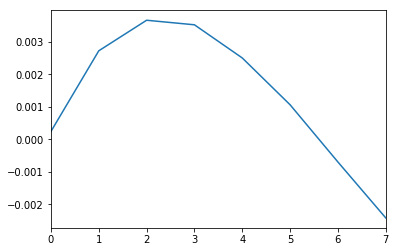

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


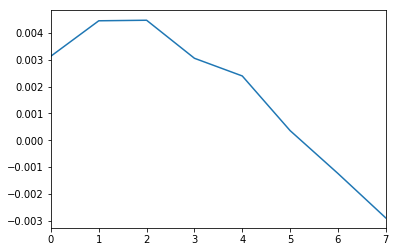

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


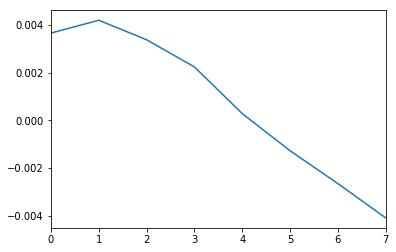

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


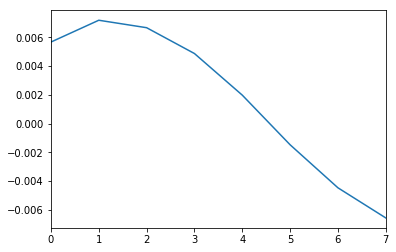

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


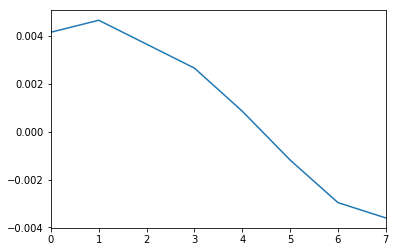

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


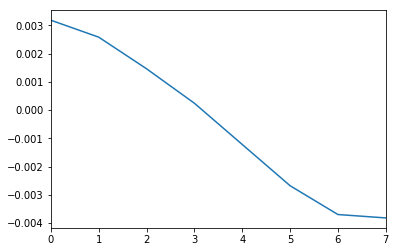

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


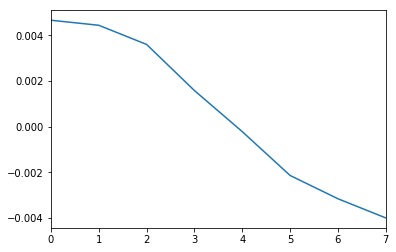

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


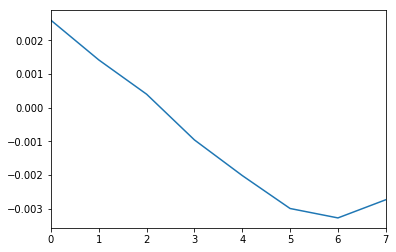

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


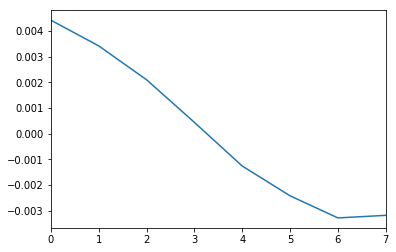

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


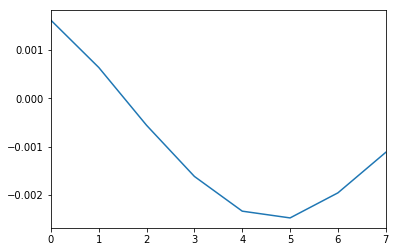

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


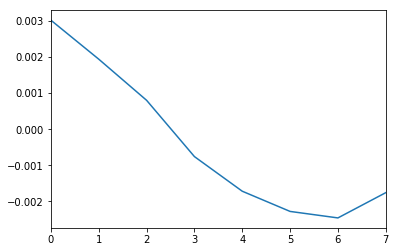

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


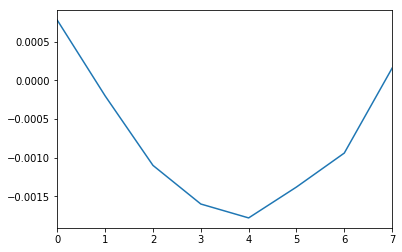

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


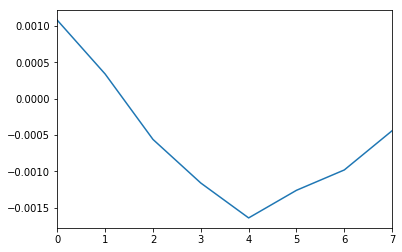

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


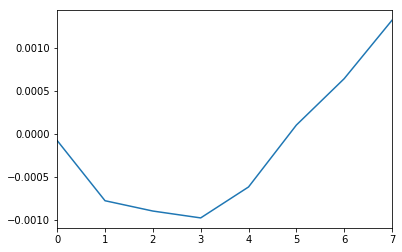

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


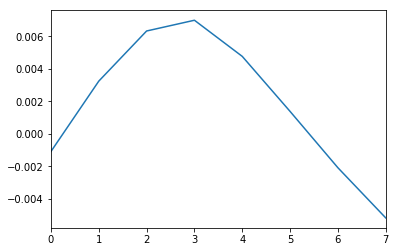

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


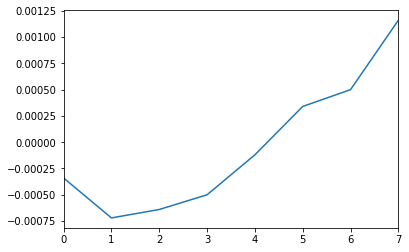

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


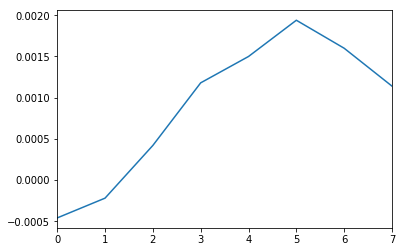

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


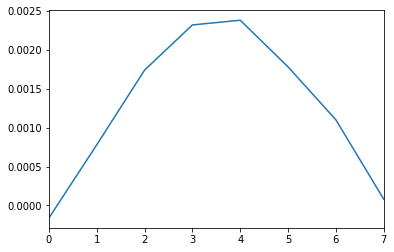

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


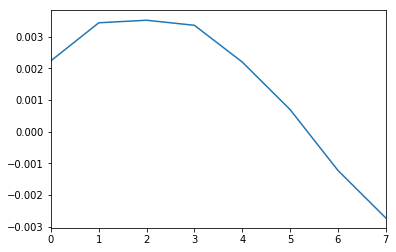

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


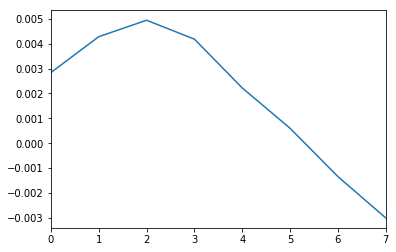

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


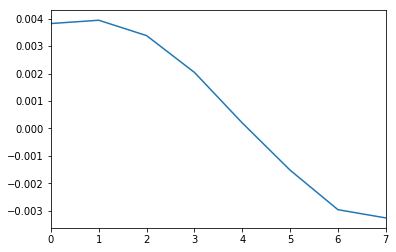

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


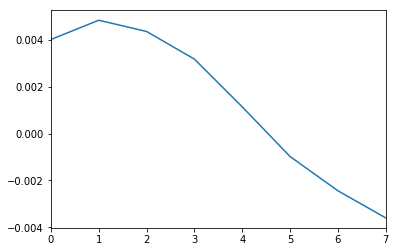

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


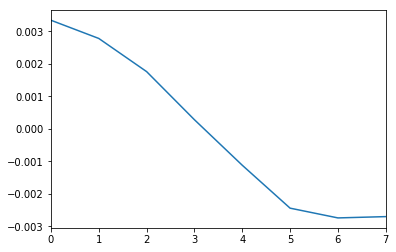

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


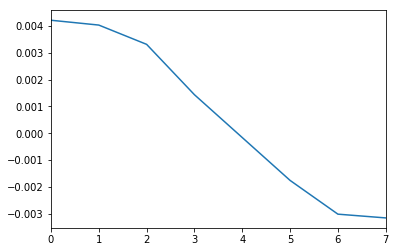

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


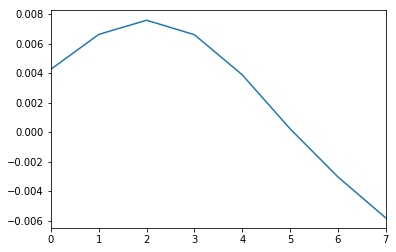

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


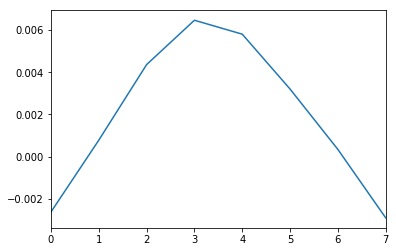

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


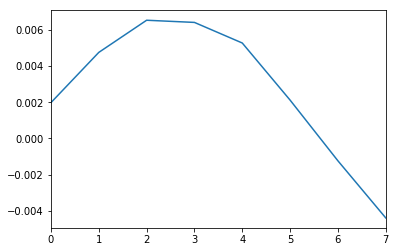

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


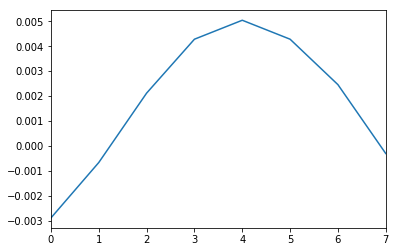

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


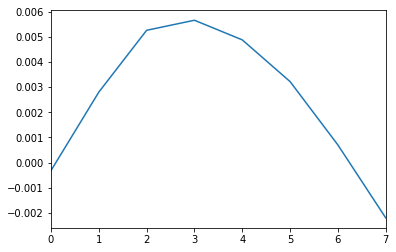

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


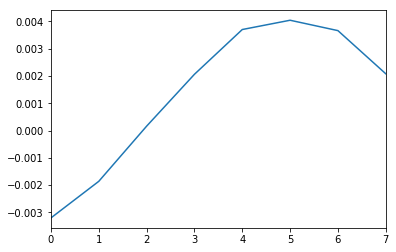

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


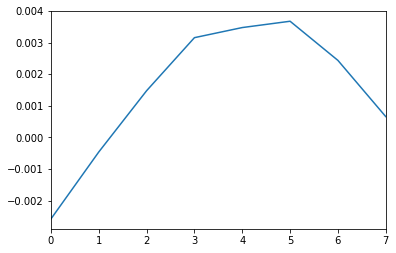

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


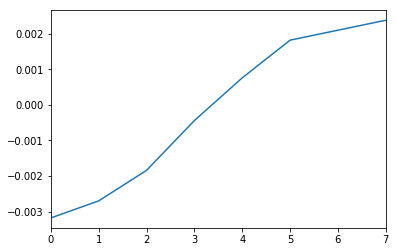

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


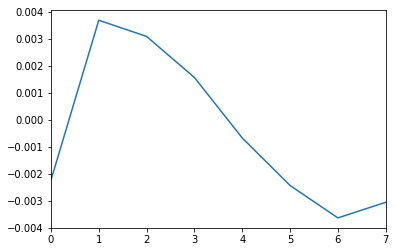

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


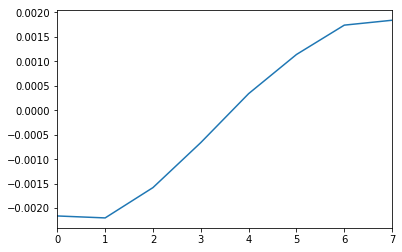

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


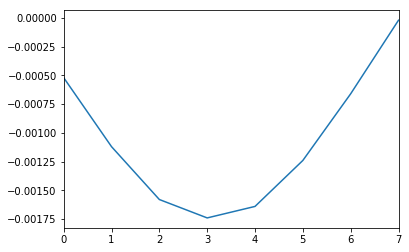

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


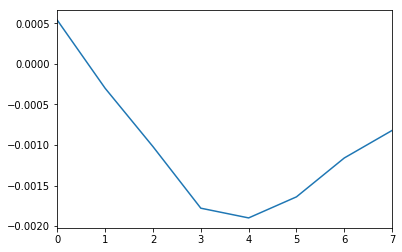

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


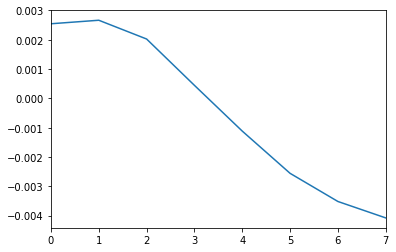

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


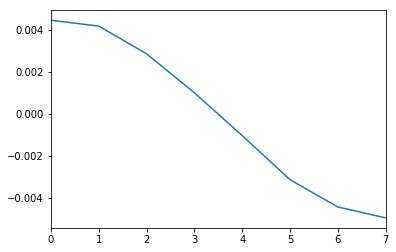

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


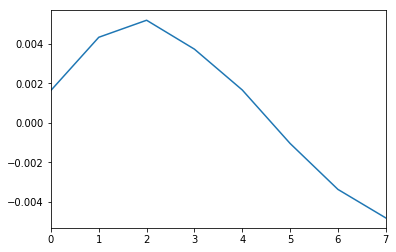

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


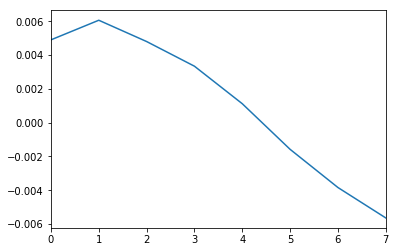

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


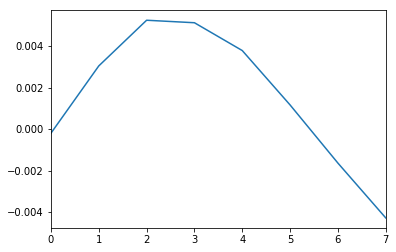

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


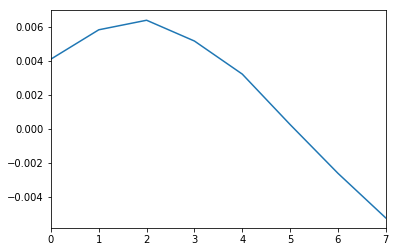

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


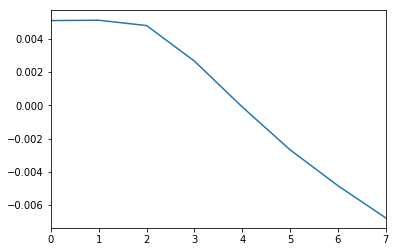

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


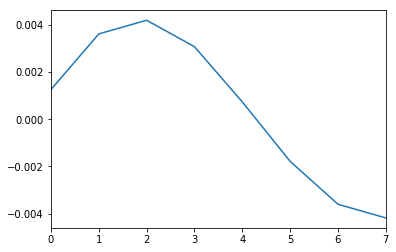

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


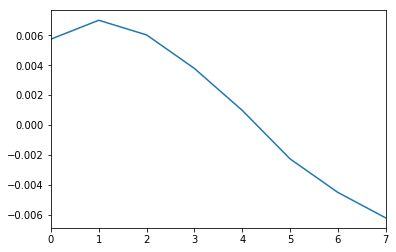

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


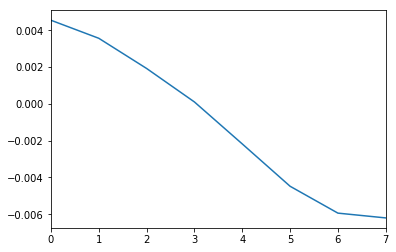

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


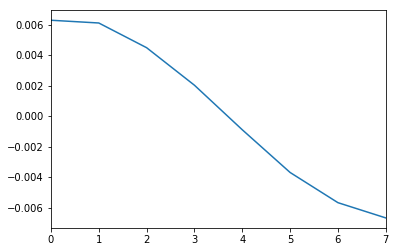

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


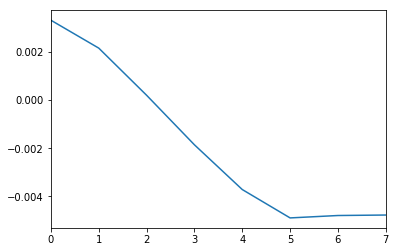

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


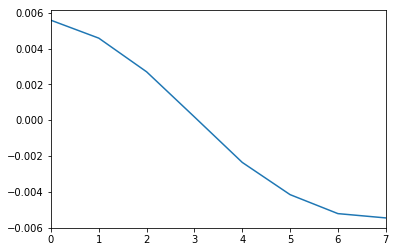

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


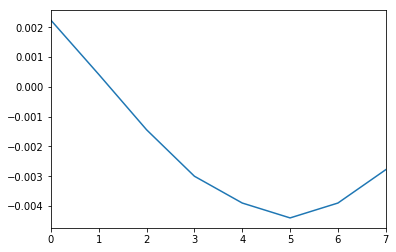

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


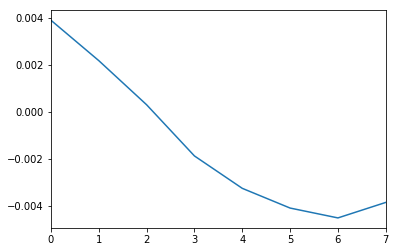

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


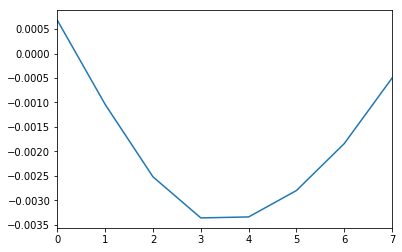

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


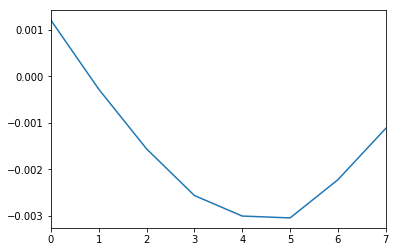

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


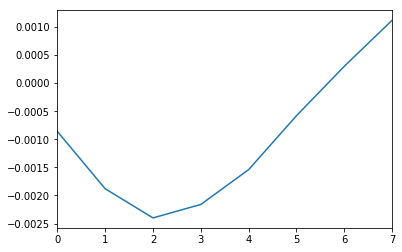

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


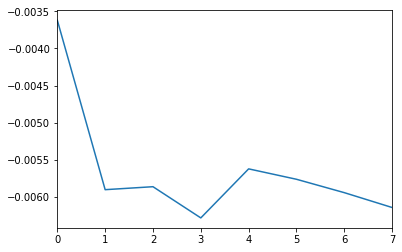

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


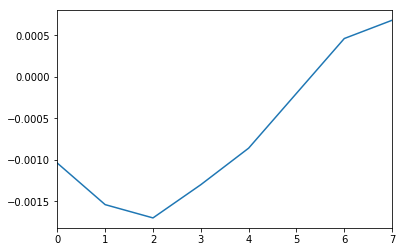

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


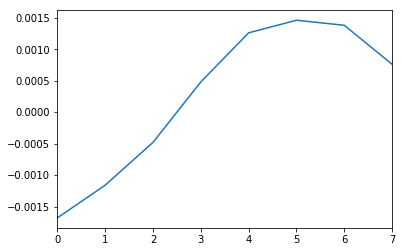

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


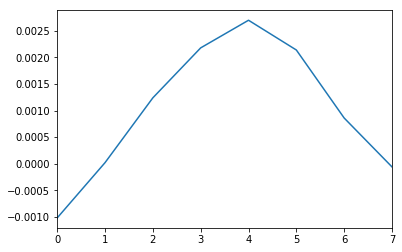

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


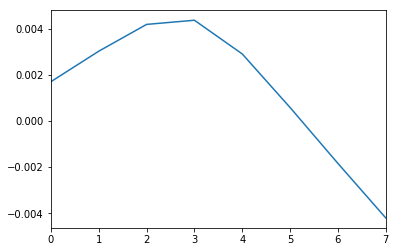

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


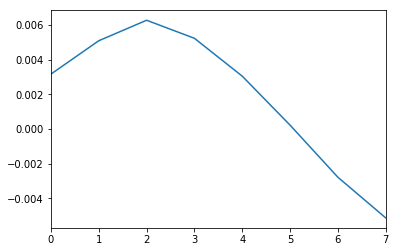

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


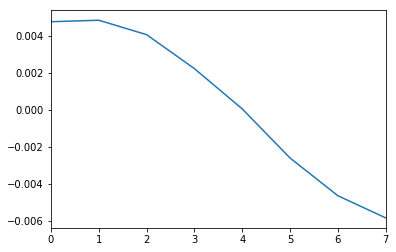

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


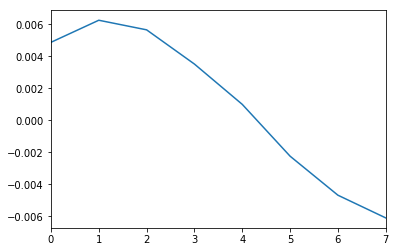

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


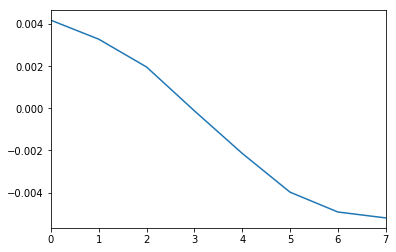

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


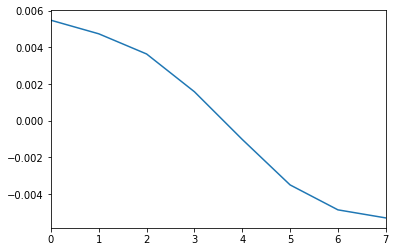

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


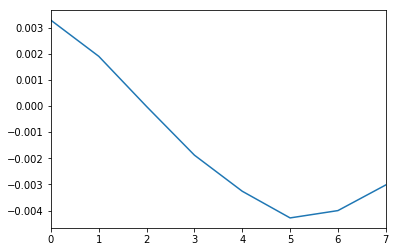

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


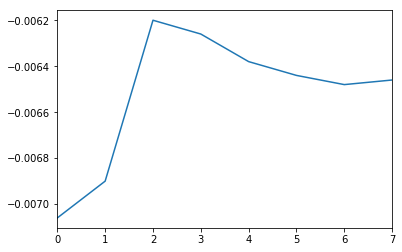

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


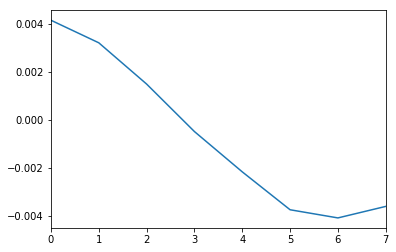

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


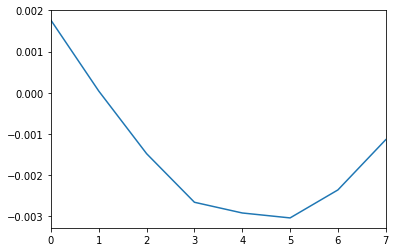

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


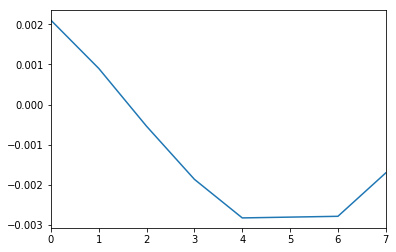

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


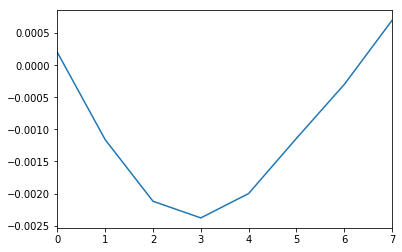

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


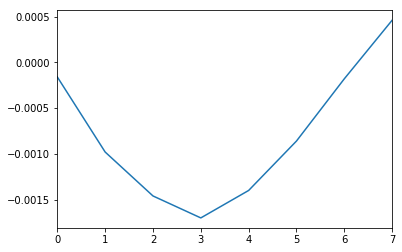

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


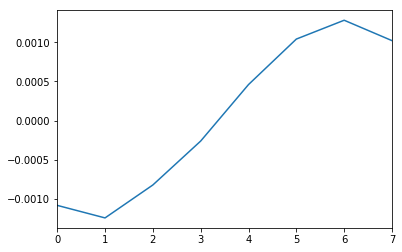

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


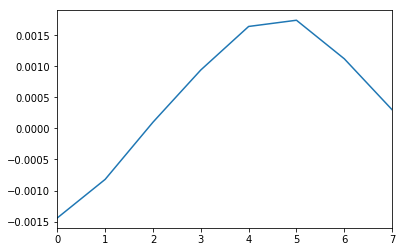

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


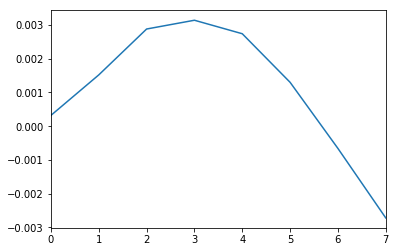

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


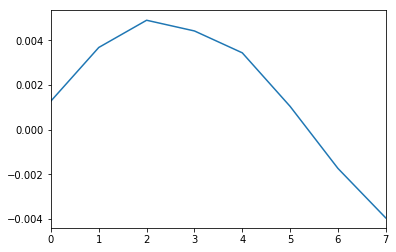

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


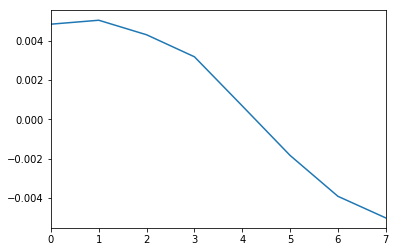

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


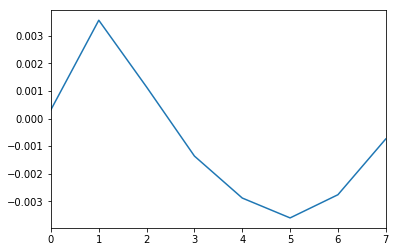

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


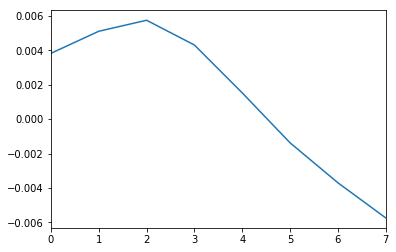

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


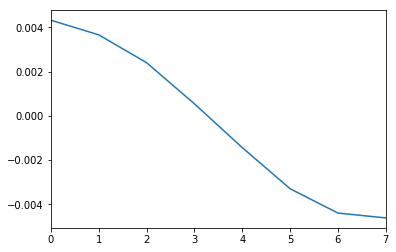

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


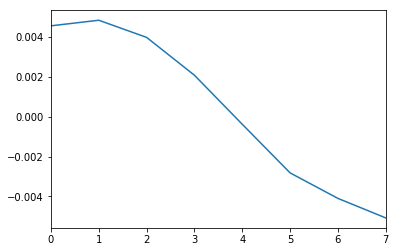

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


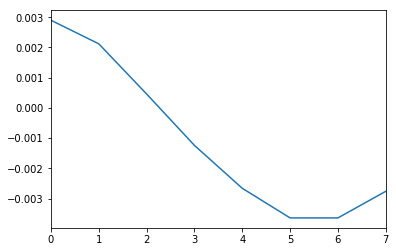

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


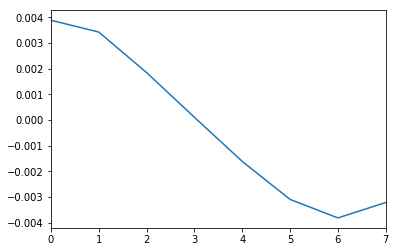

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


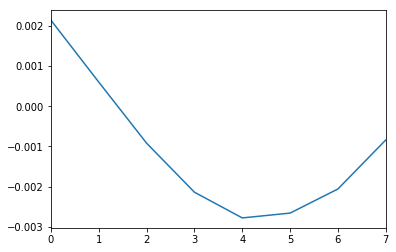

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


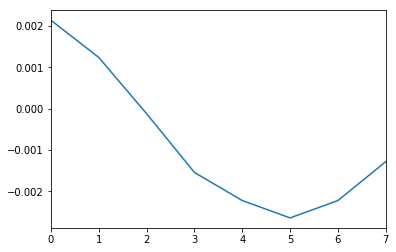

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


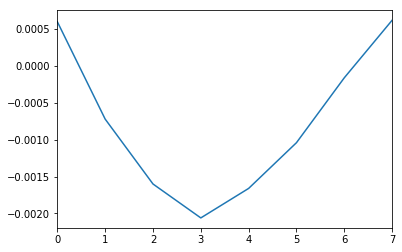

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


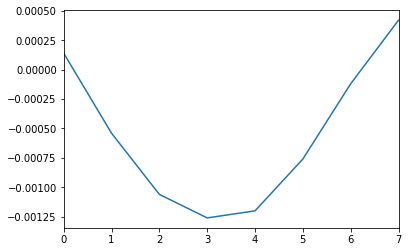

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


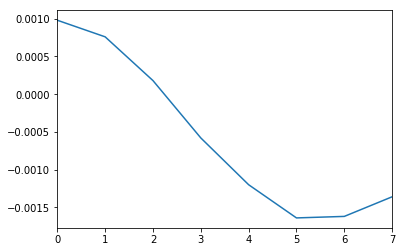

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


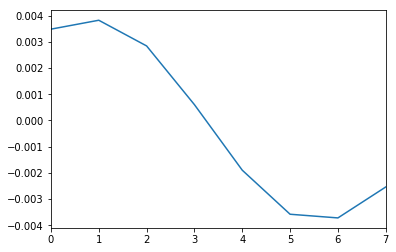

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


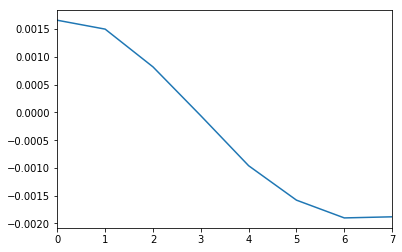

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


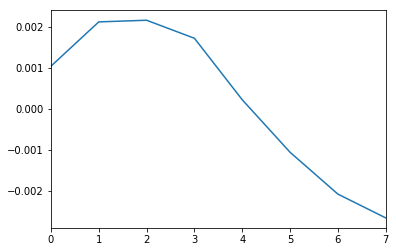

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


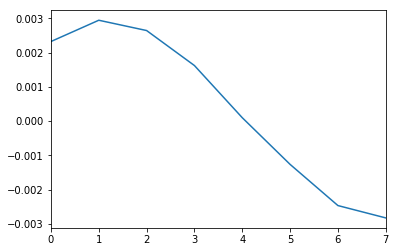

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


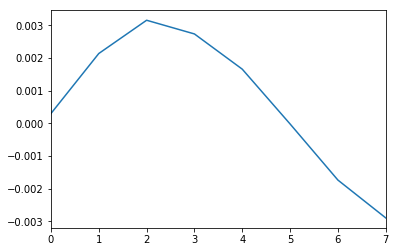

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


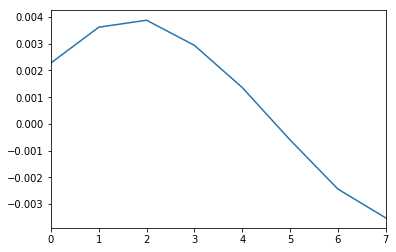

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


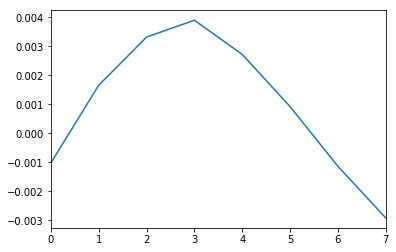

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


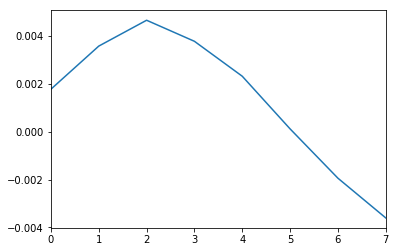

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


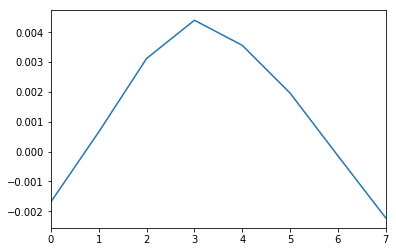

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


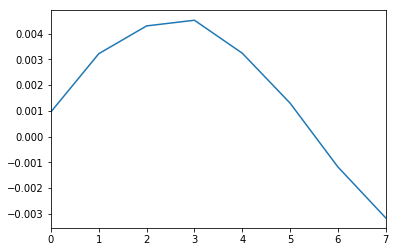

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


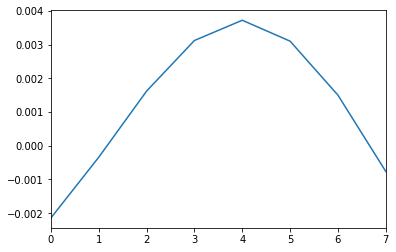

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


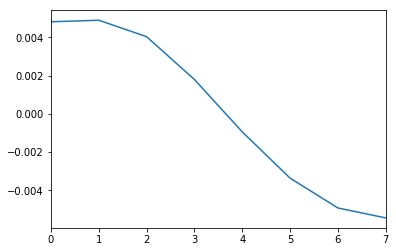

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


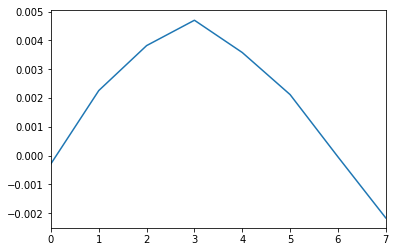

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


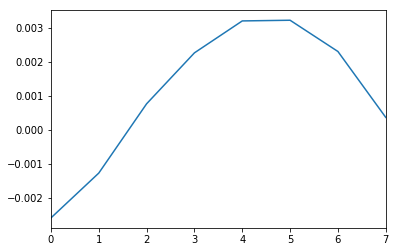

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


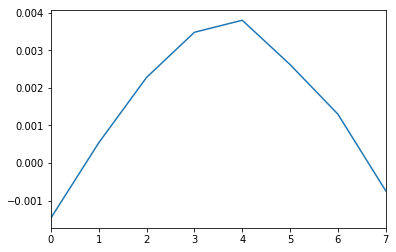

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


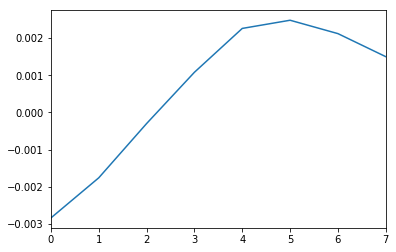

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


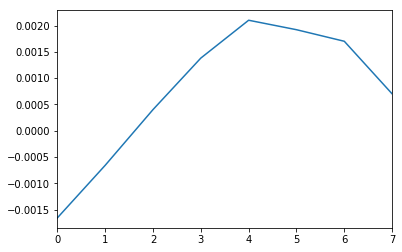

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


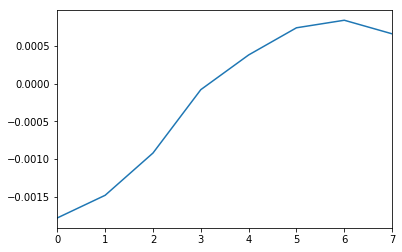

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


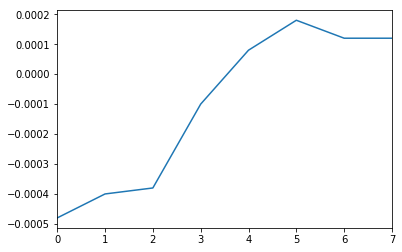

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


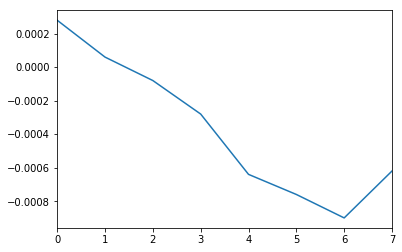

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


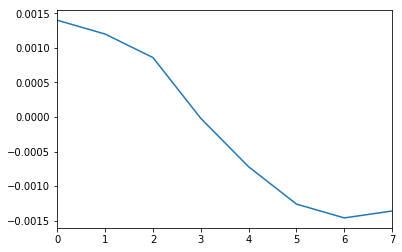

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


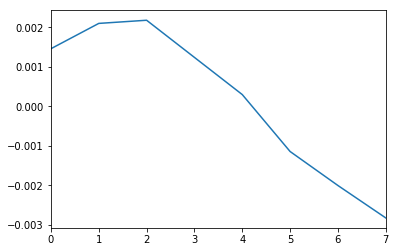

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


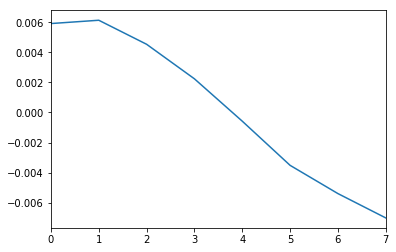

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


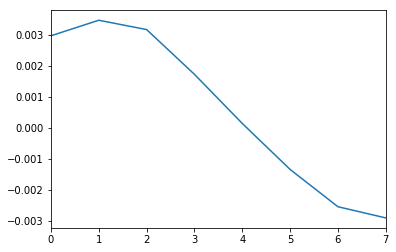

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


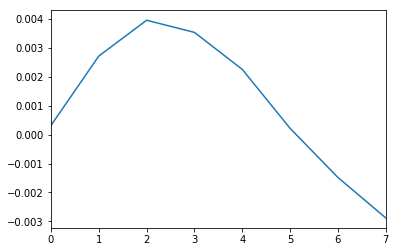

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


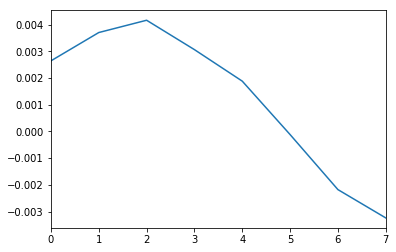

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


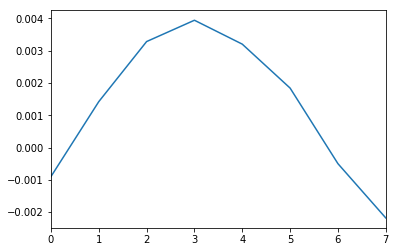

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


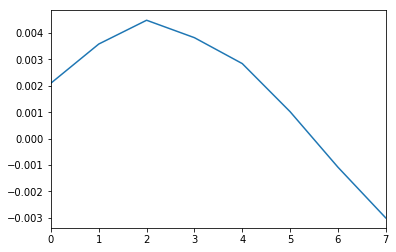

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


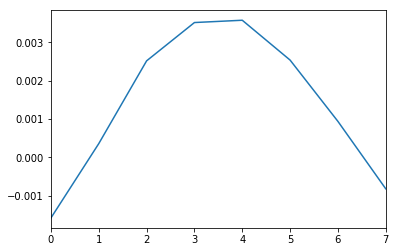

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


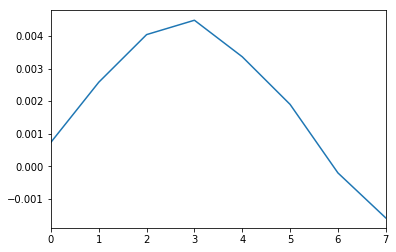

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


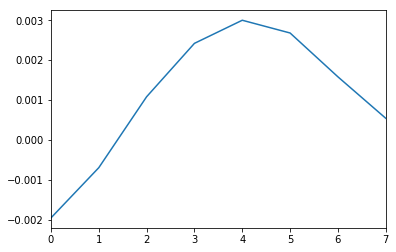

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


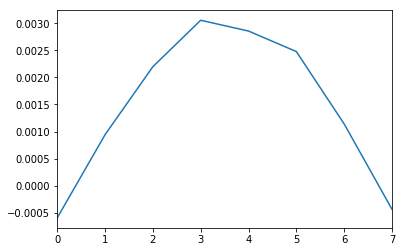

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


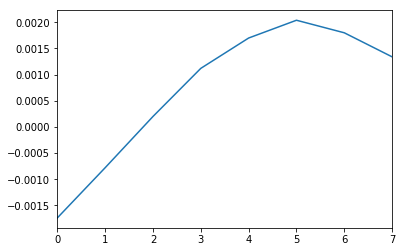

C:\Data\apr2017\170409\TestPhaseShift2_0780uWpump_TRKR___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


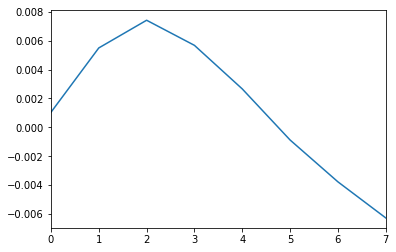

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


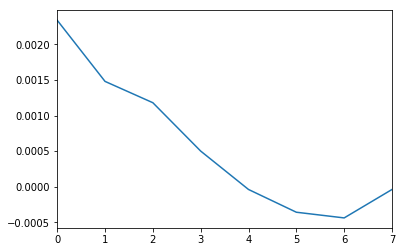

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


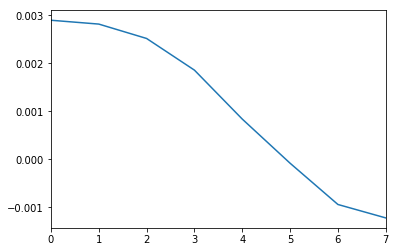

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


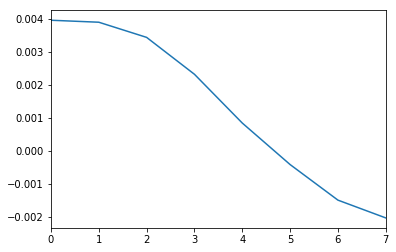

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


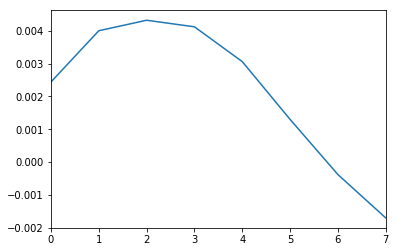

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


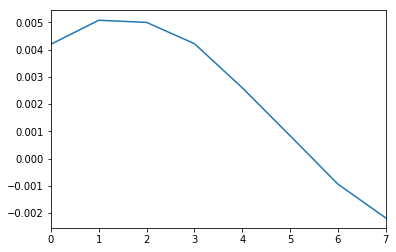

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


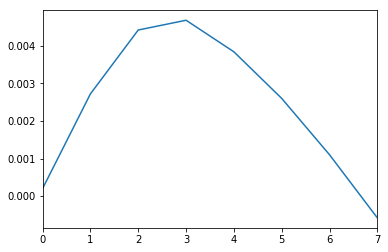

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


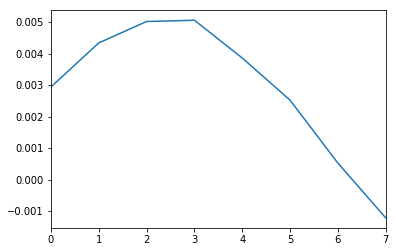

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


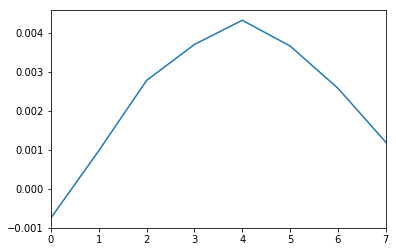

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


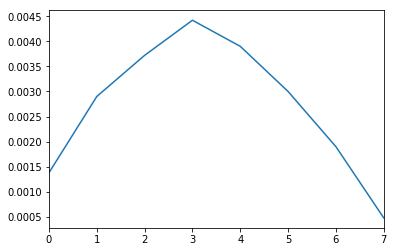

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


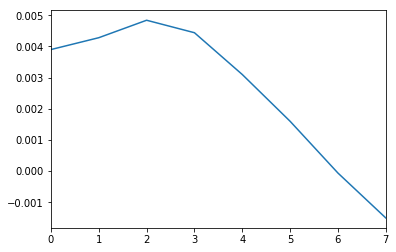

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


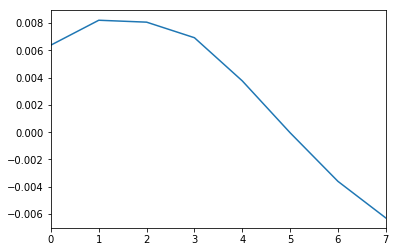

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


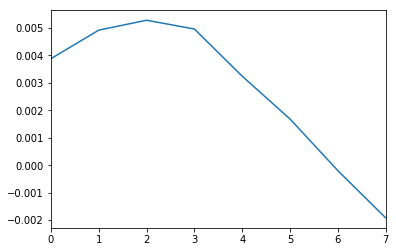

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


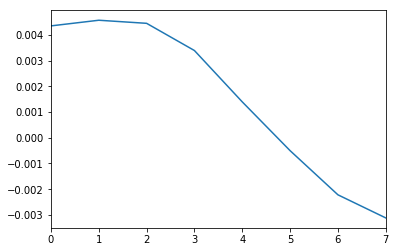

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


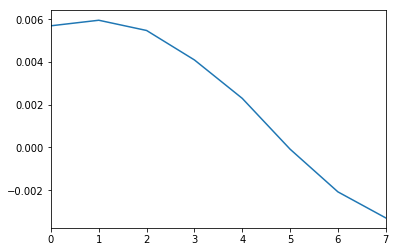

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


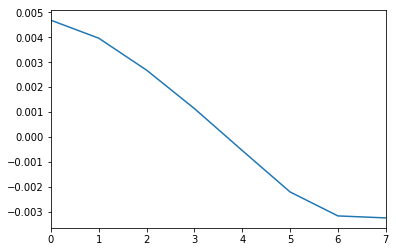

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


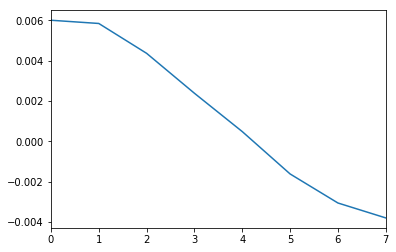

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


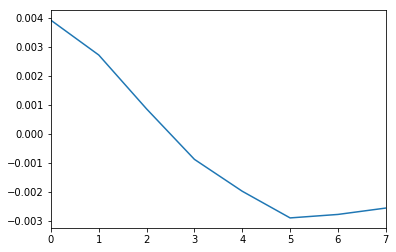

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


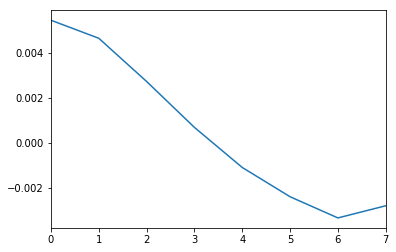

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


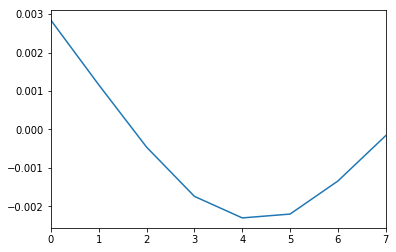

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


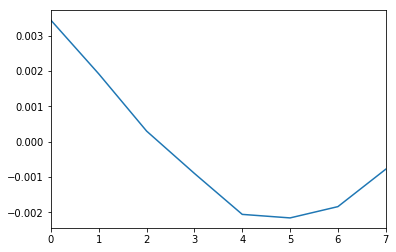

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


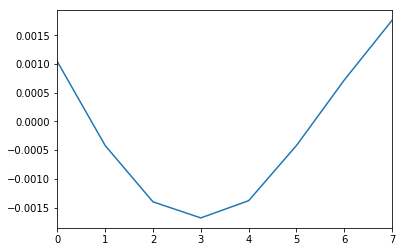

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


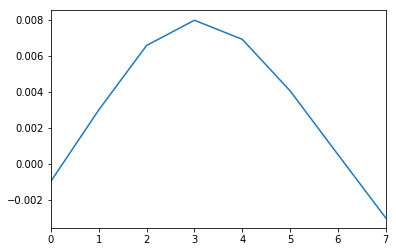

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


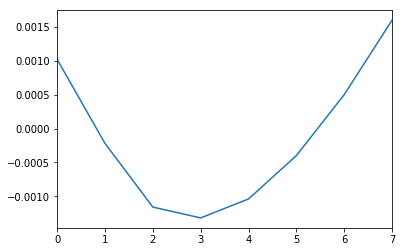

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


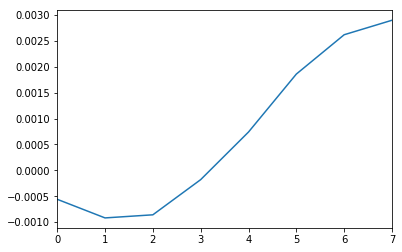

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


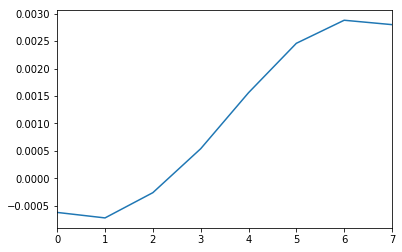

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


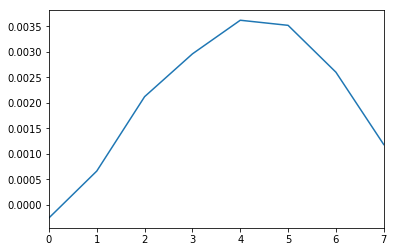

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


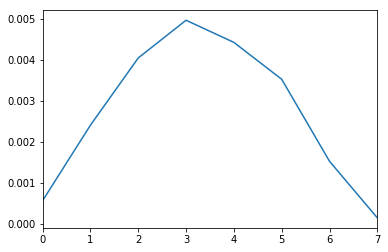

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


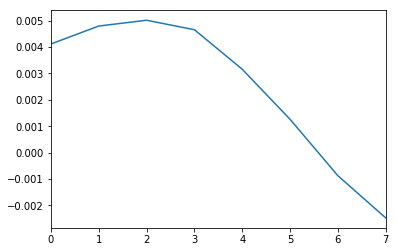

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


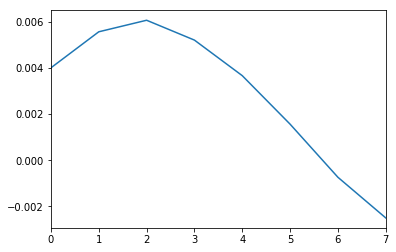

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


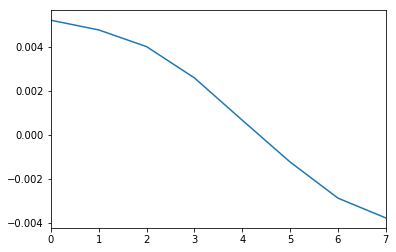

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


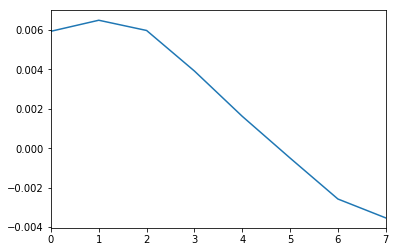

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


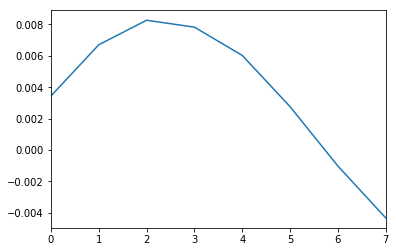

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


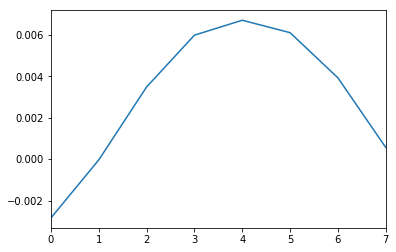

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


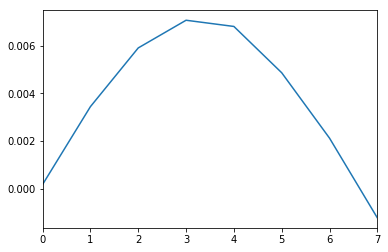

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


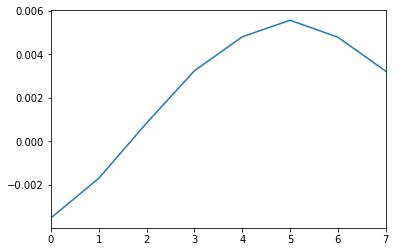

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


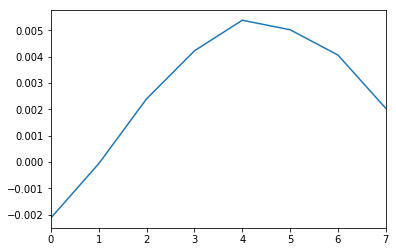

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


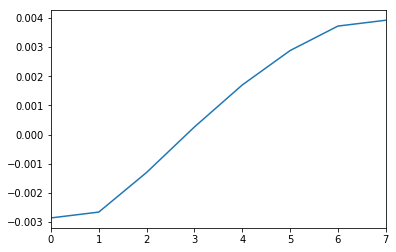

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


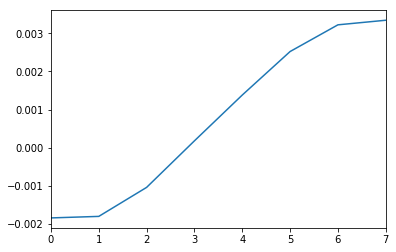

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


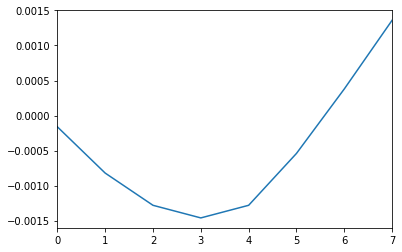

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


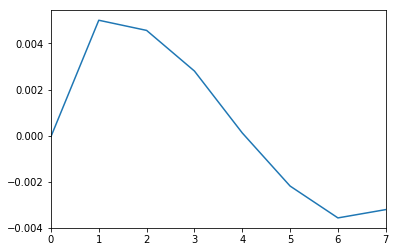

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


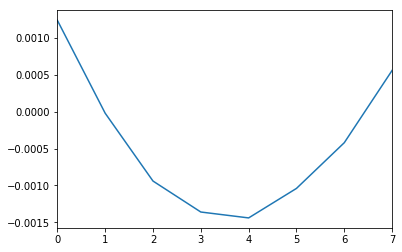

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


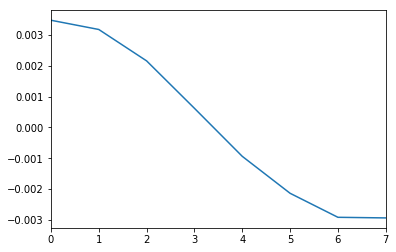

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


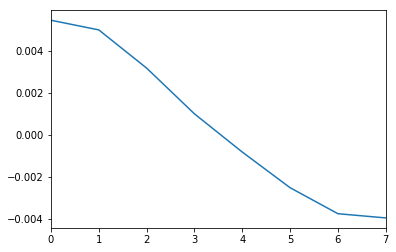

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


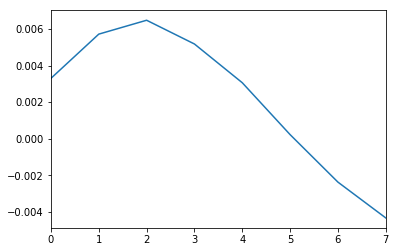

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


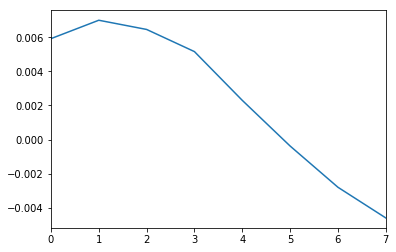

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


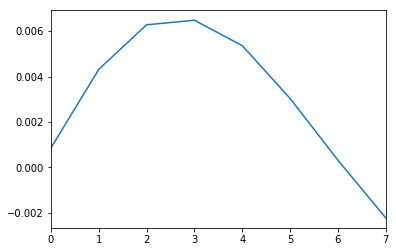

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


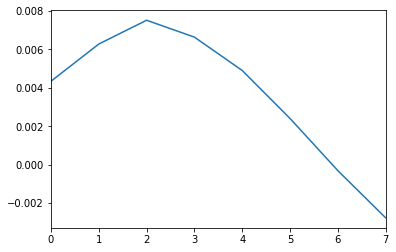

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


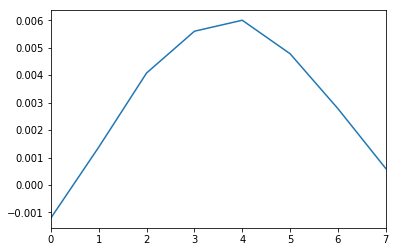

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


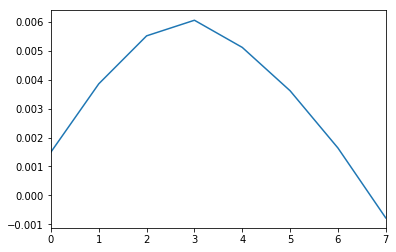

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


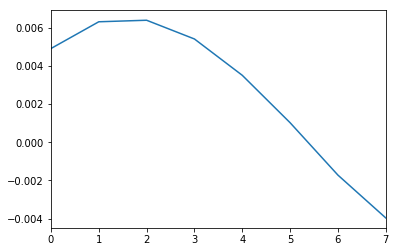

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


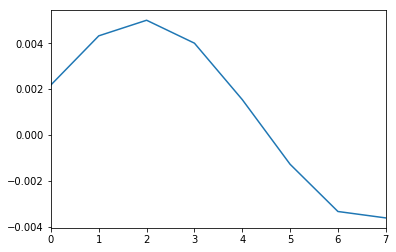

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


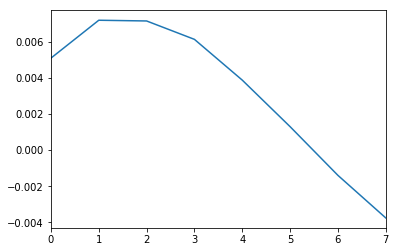

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


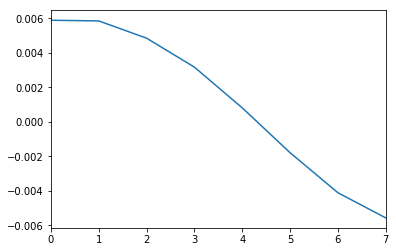

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


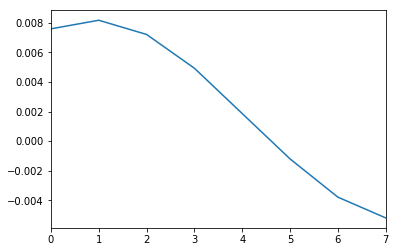

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


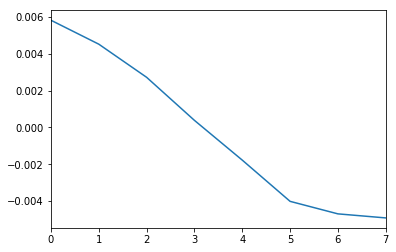

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


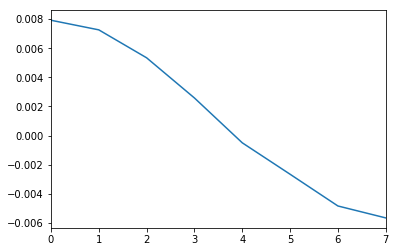

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


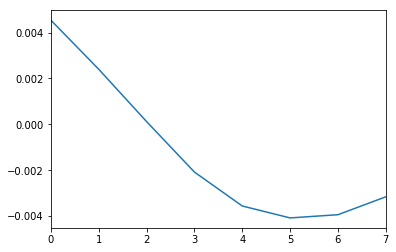

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


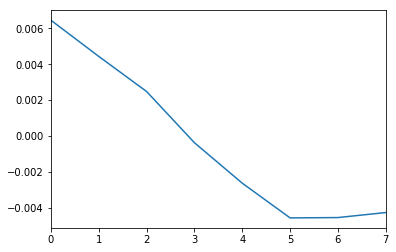

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


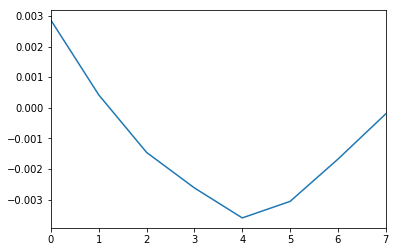

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


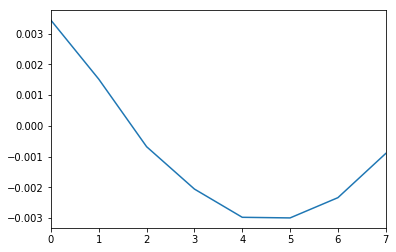

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


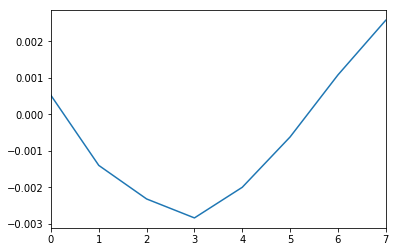

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


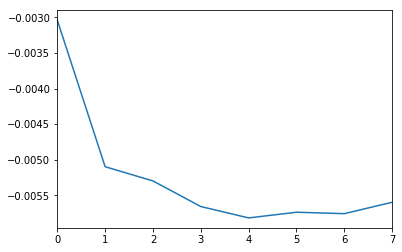

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


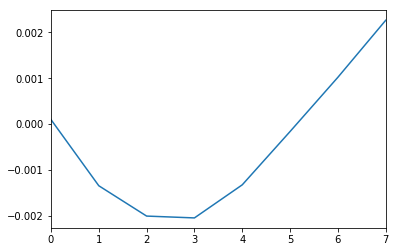

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


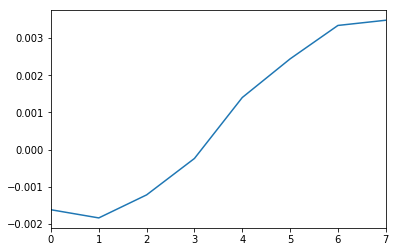

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


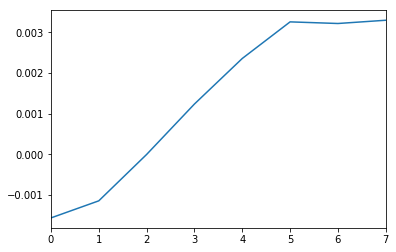

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


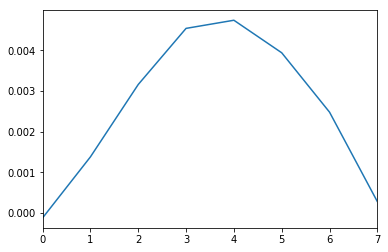

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


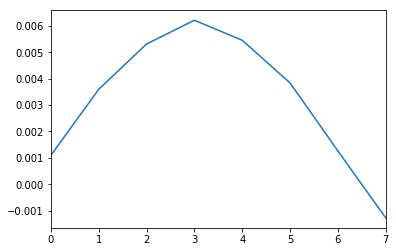

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


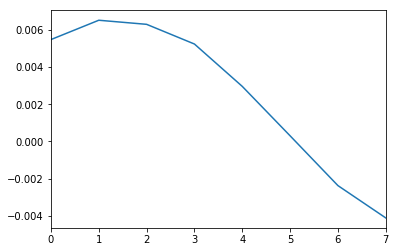

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


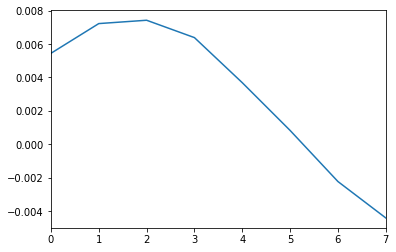

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


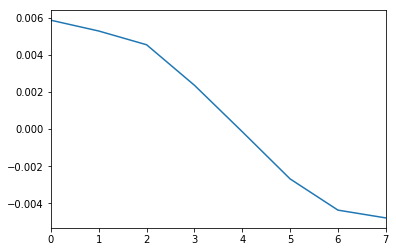

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


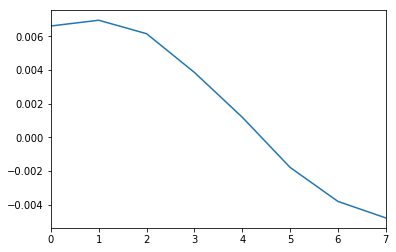

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


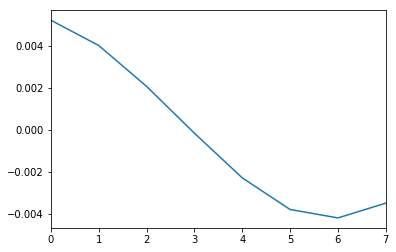

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


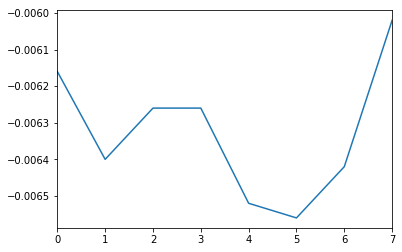

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


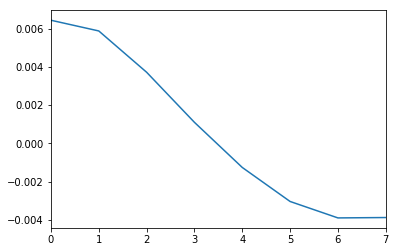

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


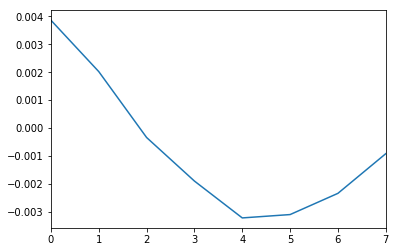

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


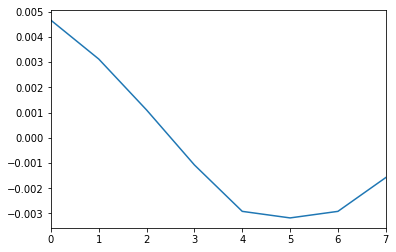

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


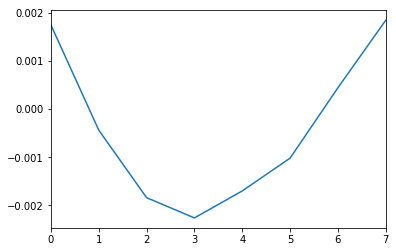

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


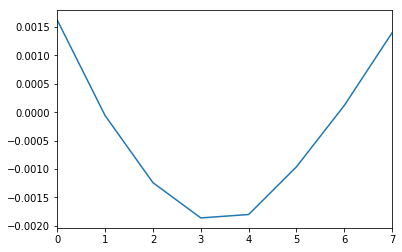

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


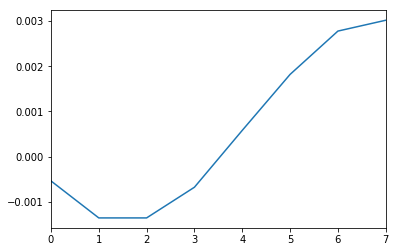

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


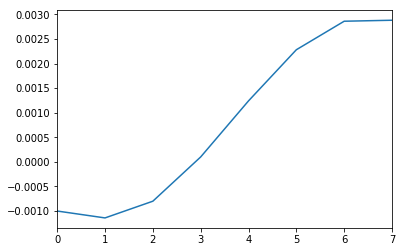

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


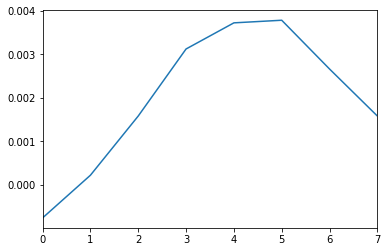

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


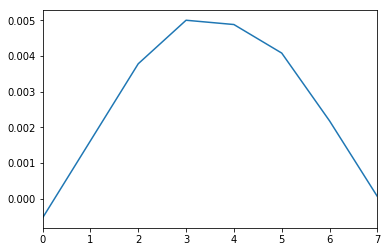

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


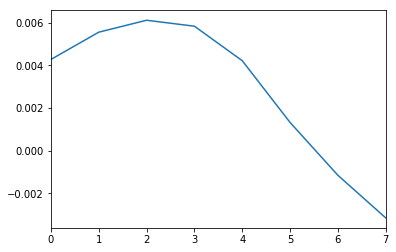

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


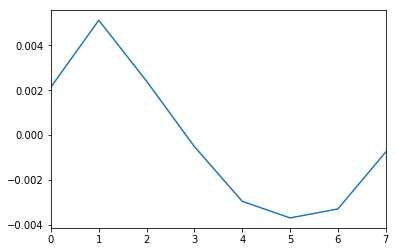

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


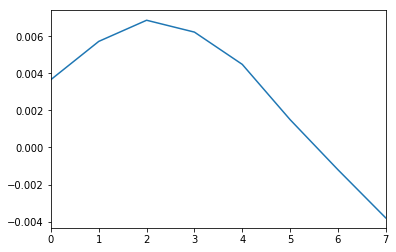

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


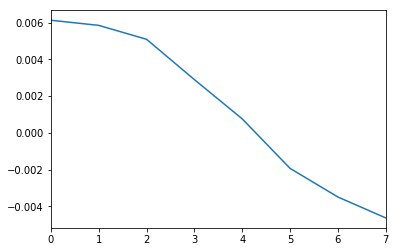

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


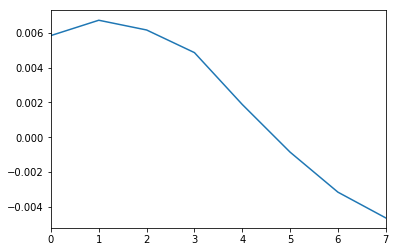

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


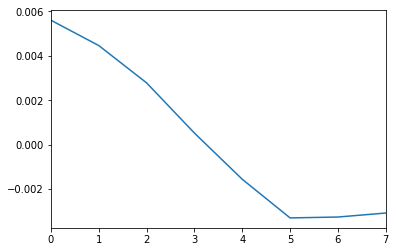

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


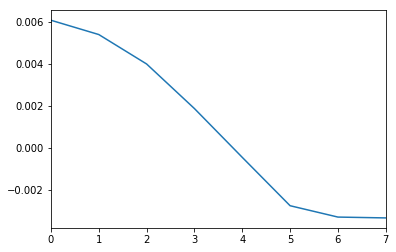

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


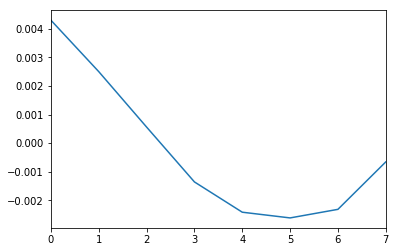

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


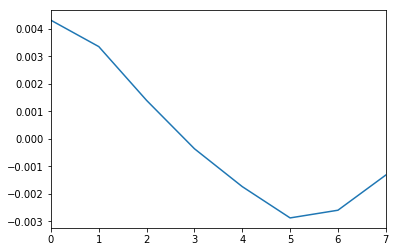

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


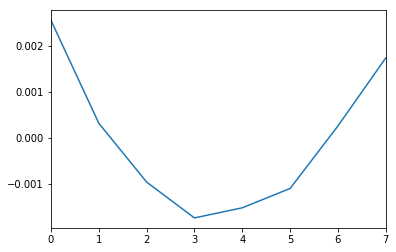

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


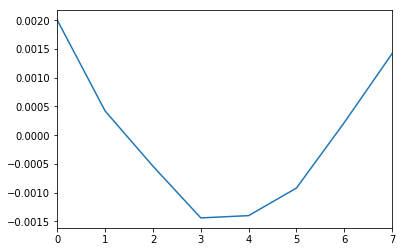

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


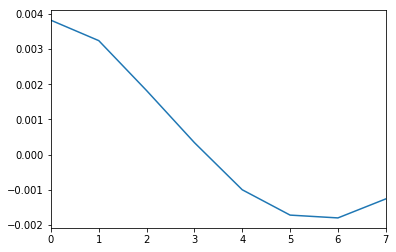

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


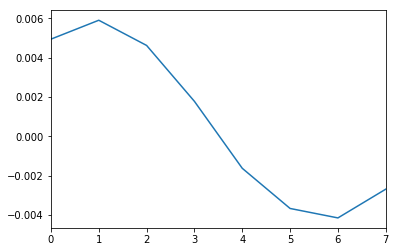

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


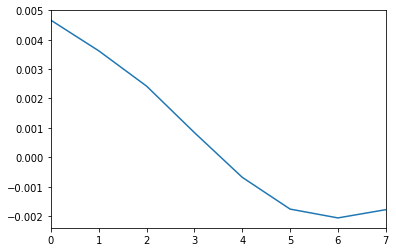

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


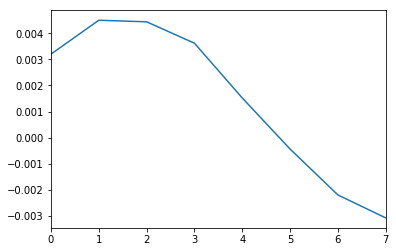

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


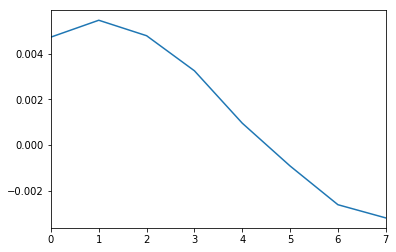

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


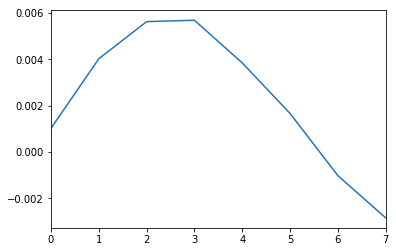

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


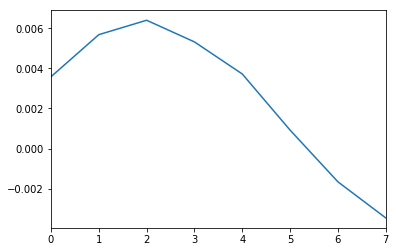

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


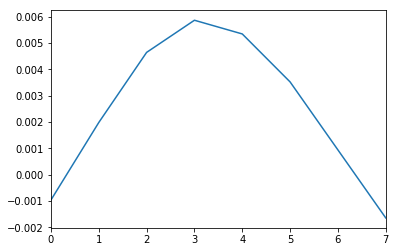

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


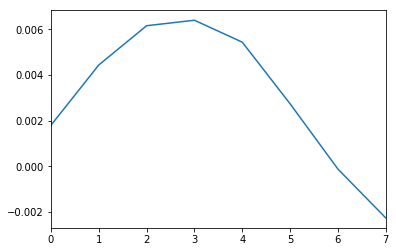

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


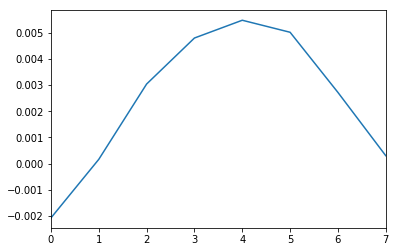

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


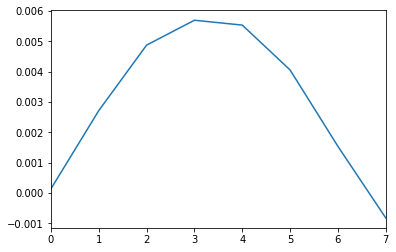

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


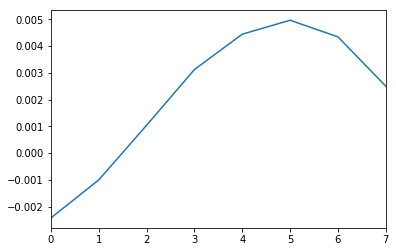

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


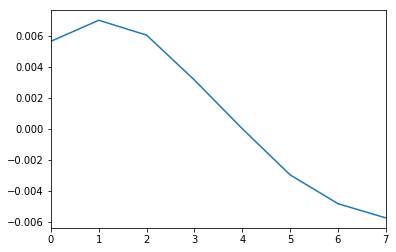

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


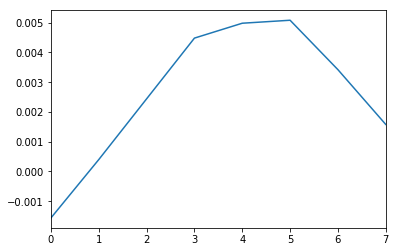

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


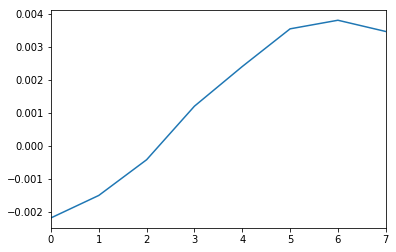

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


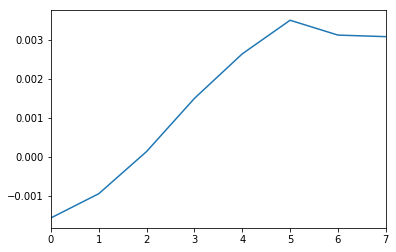

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


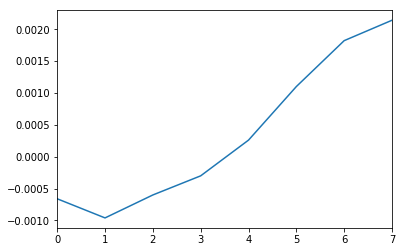

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


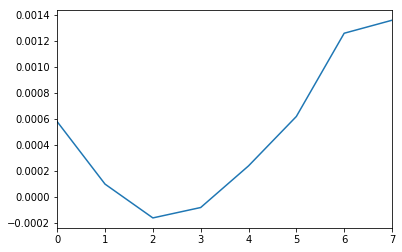

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


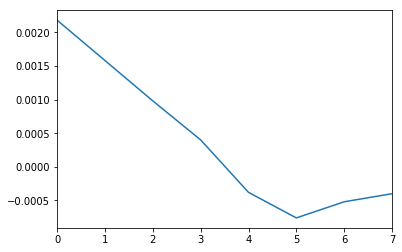

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


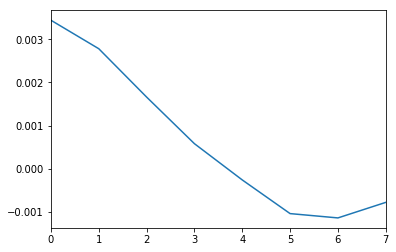

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


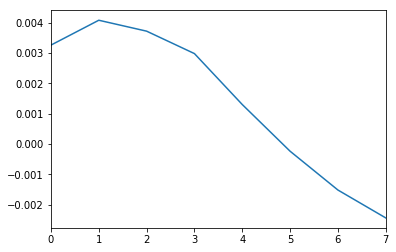

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


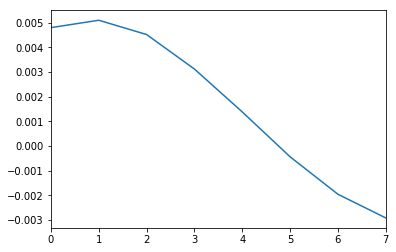

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


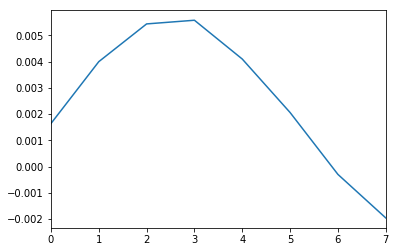

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


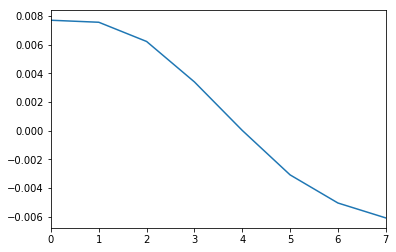

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


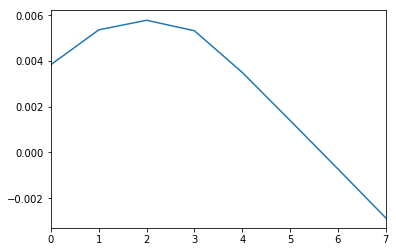

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


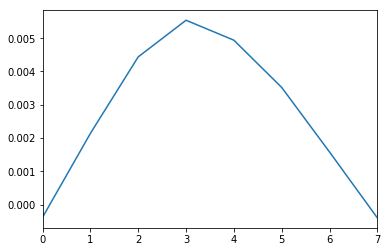

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


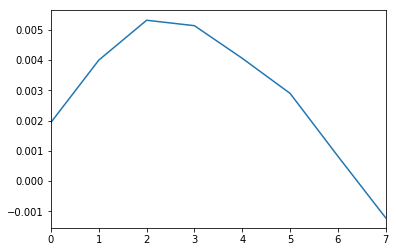

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


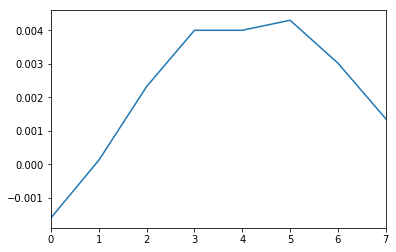

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


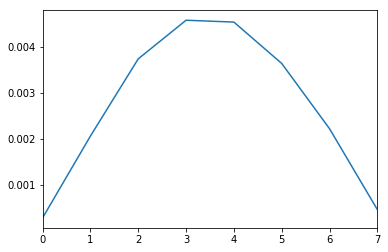

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


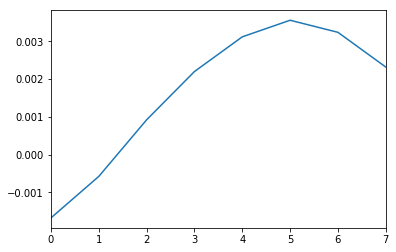

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


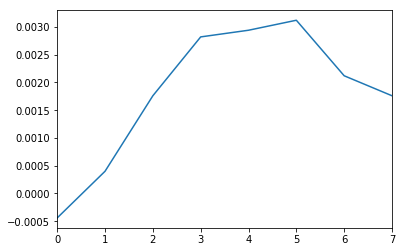

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


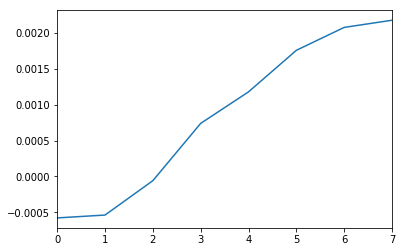

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


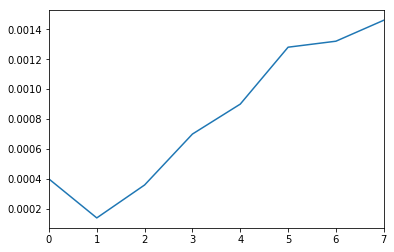

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


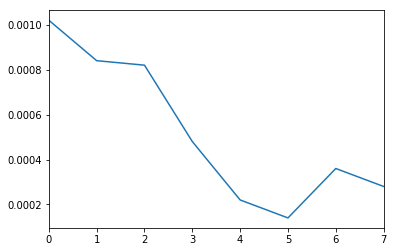

C:\Data\apr2017\170409\TestPhaseShift2_1430uWpump_TRKR___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


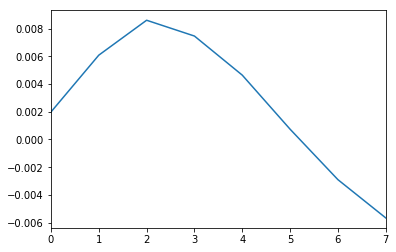

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


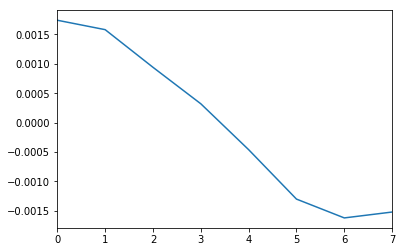

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


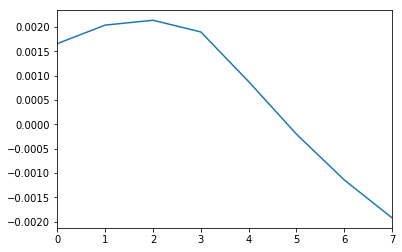

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


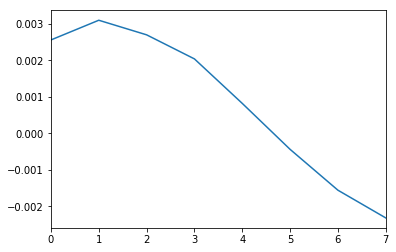

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


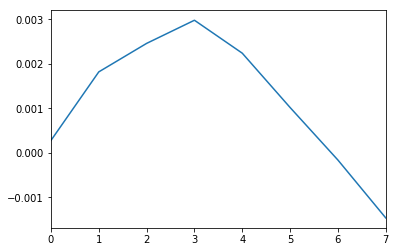

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


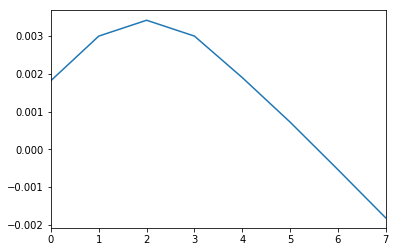

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


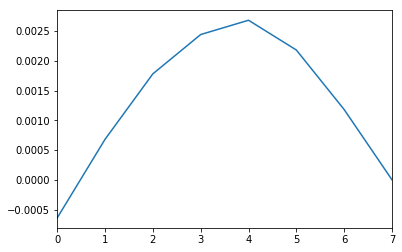

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


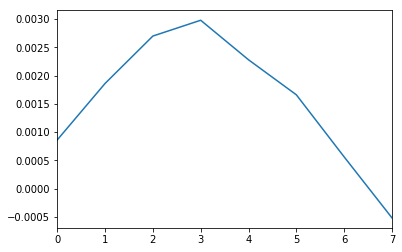

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


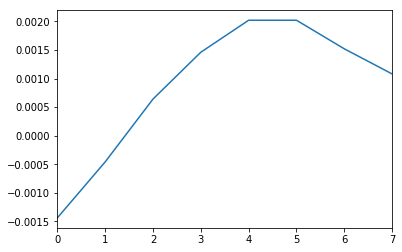

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


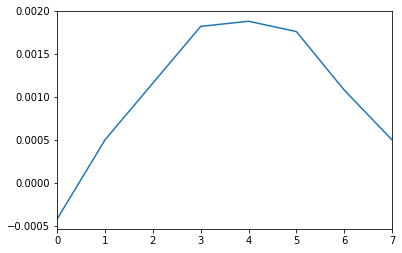

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


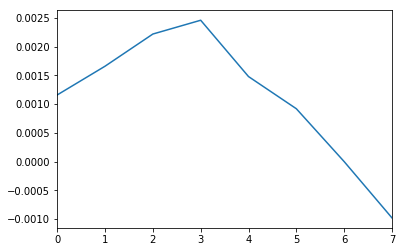

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


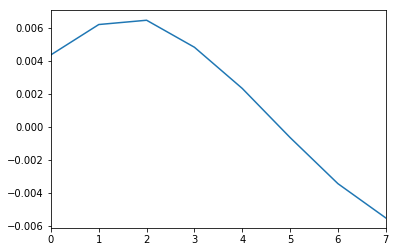

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


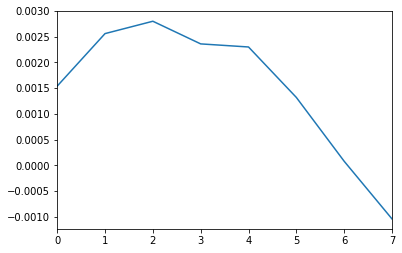

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


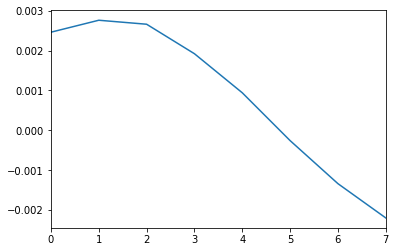

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


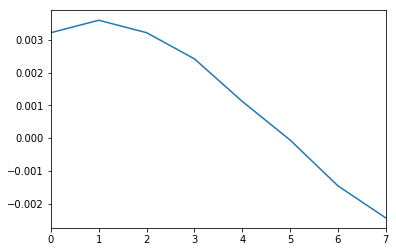

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


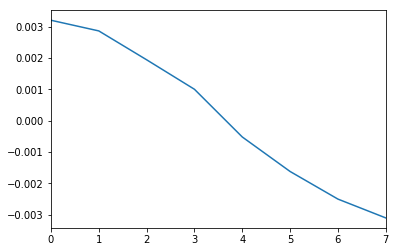

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


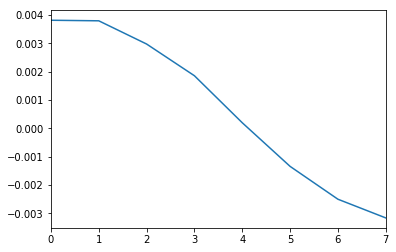

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


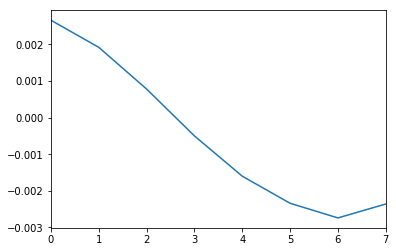

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


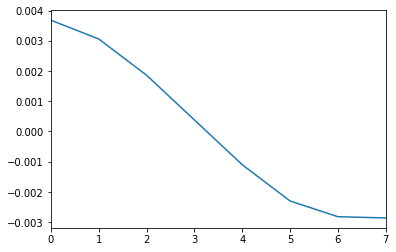

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


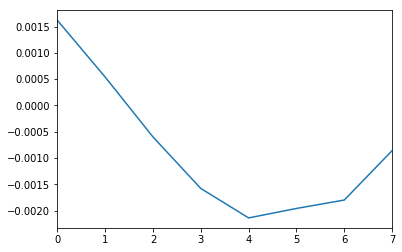

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


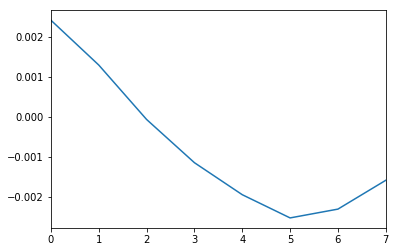

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


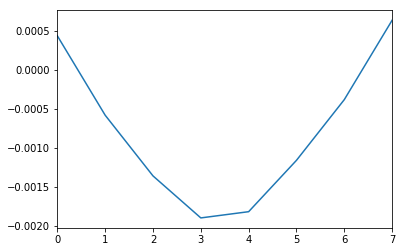

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


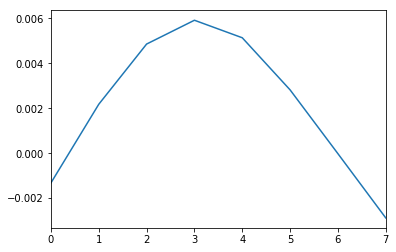

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


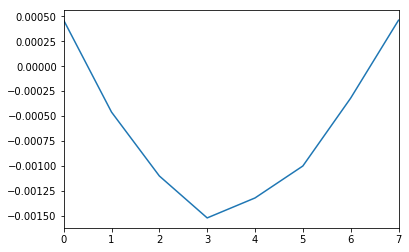

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


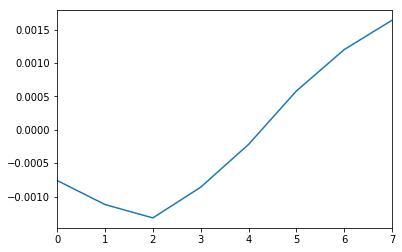

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


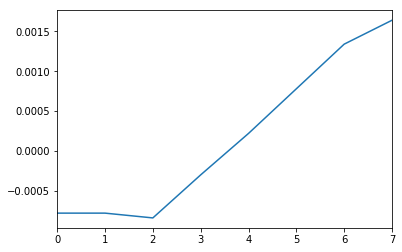

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


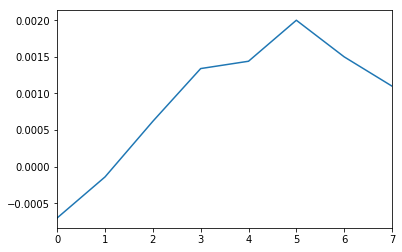

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


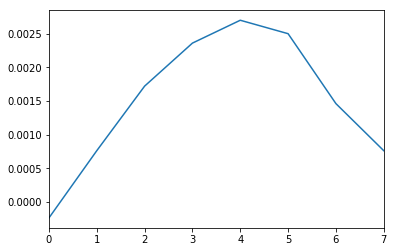

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


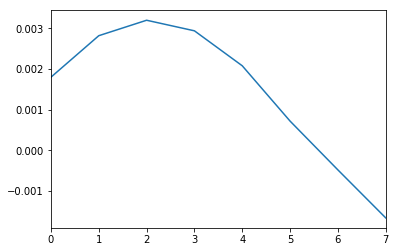

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


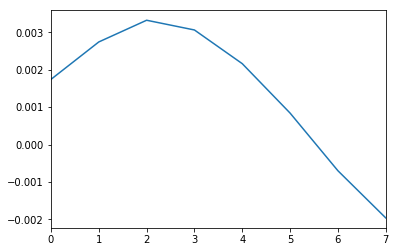

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


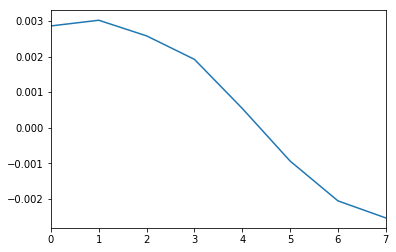

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


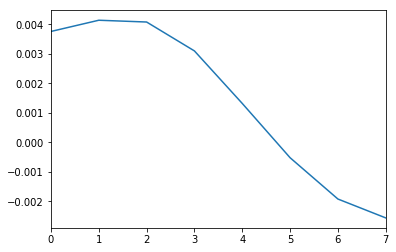

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


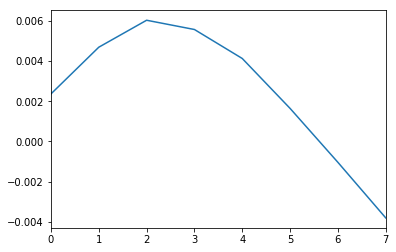

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


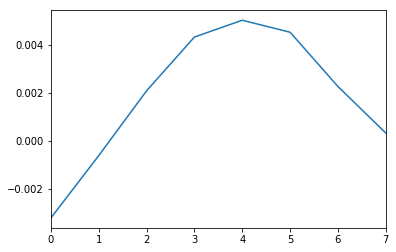

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


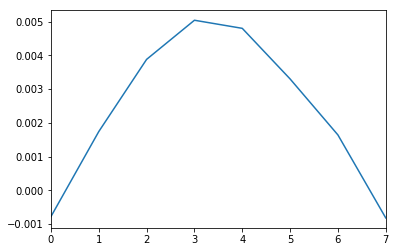

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


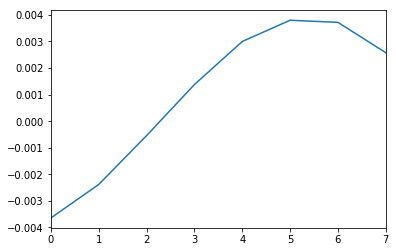

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


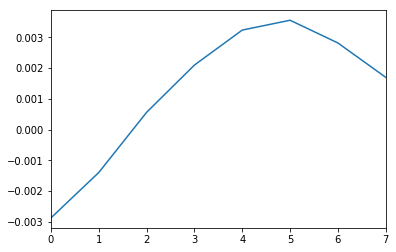

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


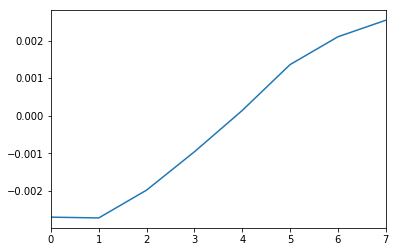

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


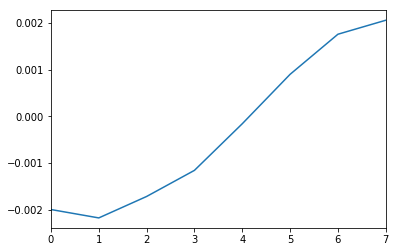

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


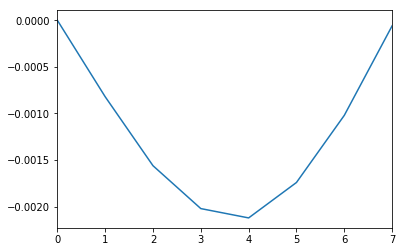

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


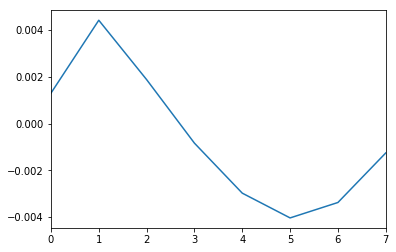

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


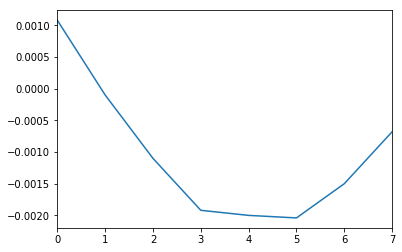

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


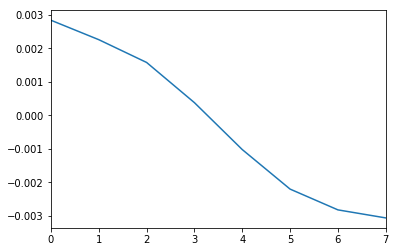

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


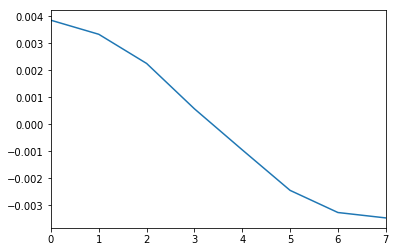

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


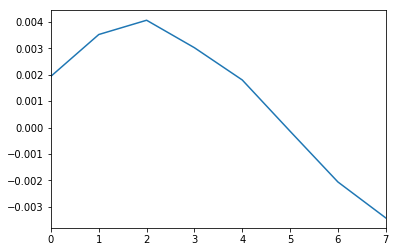

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


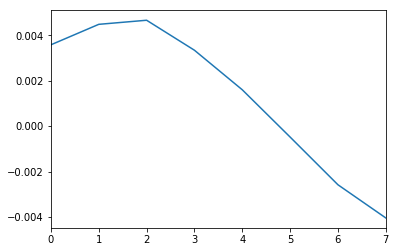

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


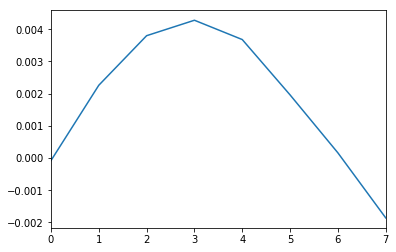

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


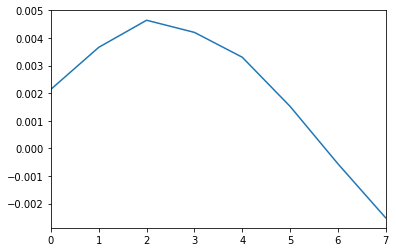

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


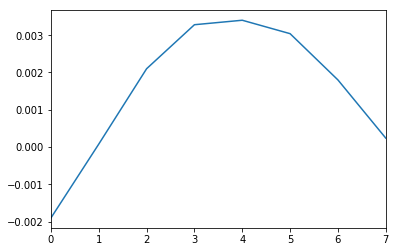

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


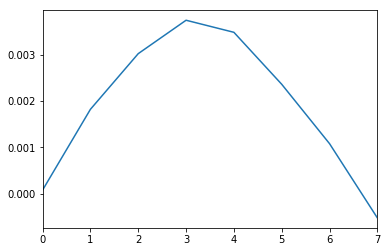

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


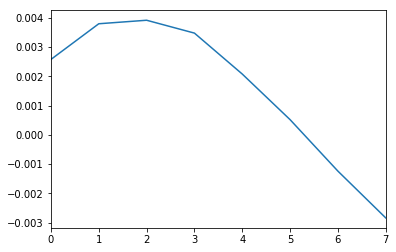

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


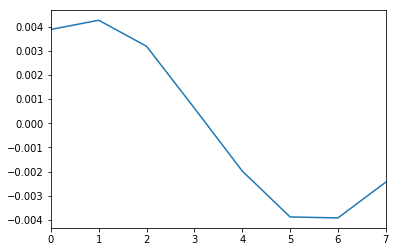

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


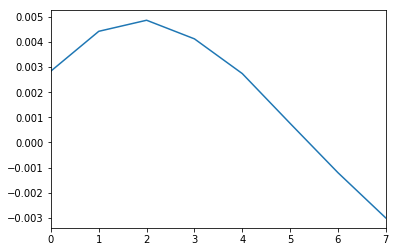

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


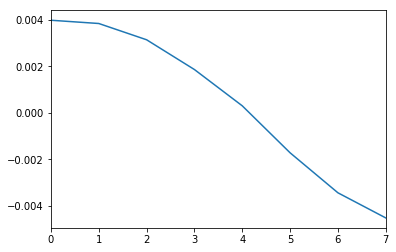

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


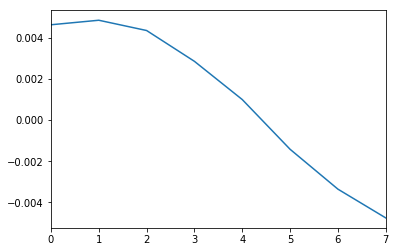

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


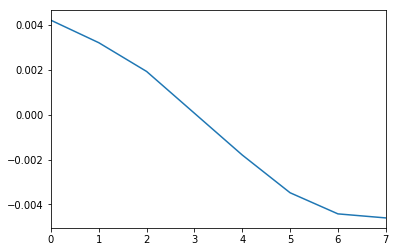

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


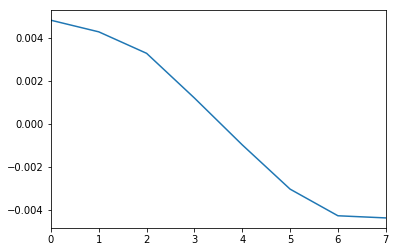

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


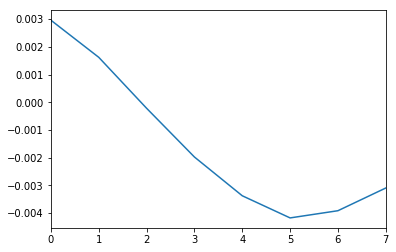

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


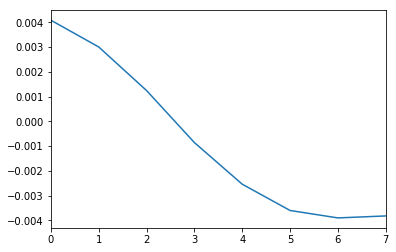

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


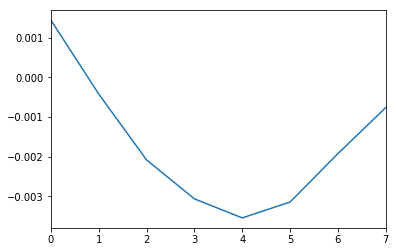

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


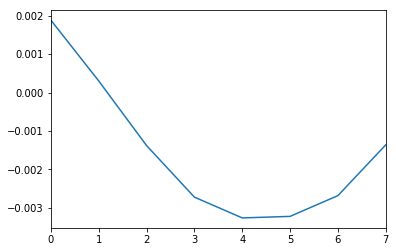

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


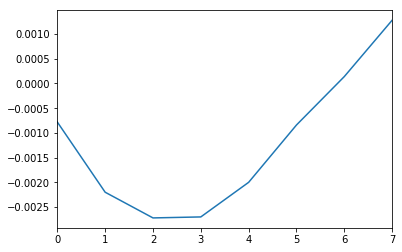

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


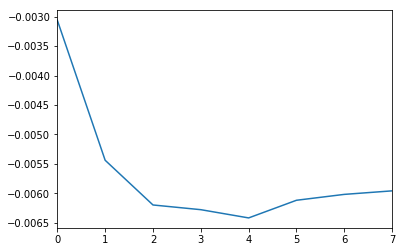

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


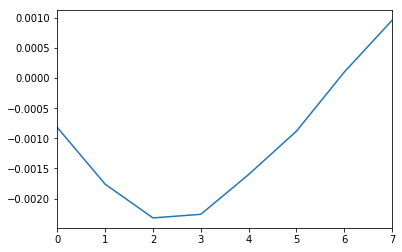

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


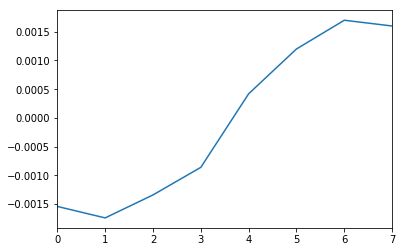

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


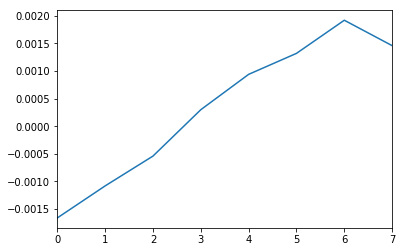

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


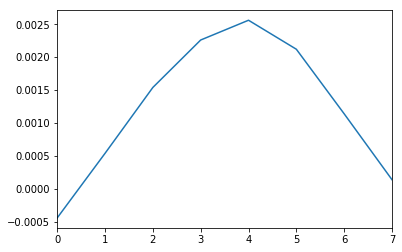

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


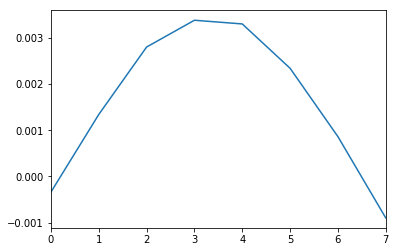

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


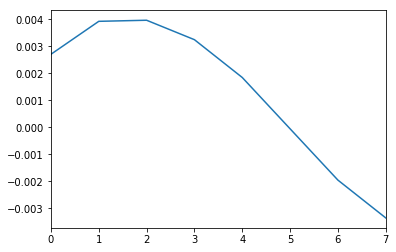

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


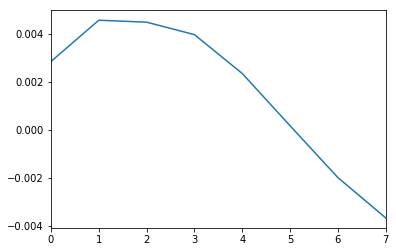

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


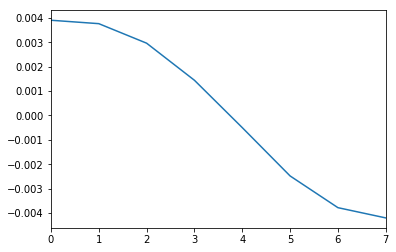

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


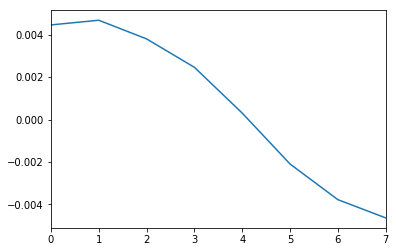

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


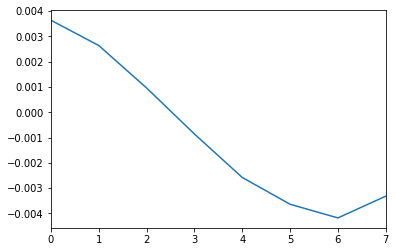

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


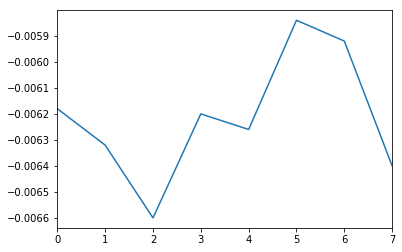

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


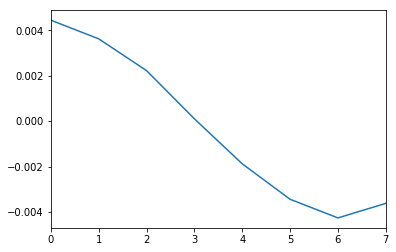

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


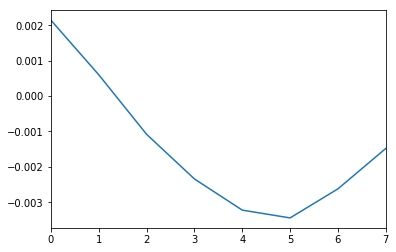

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


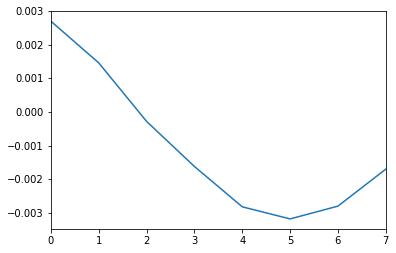

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


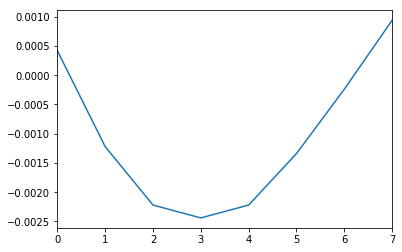

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


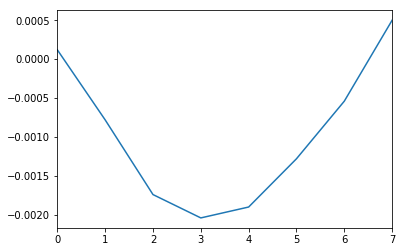

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


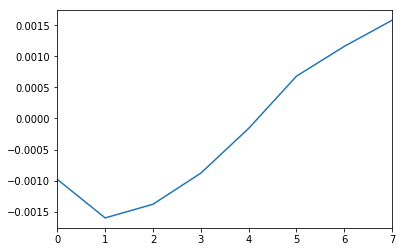

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


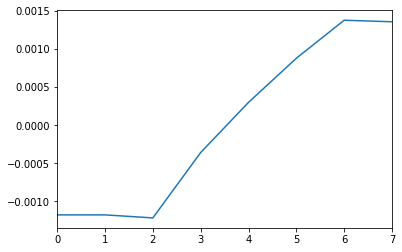

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


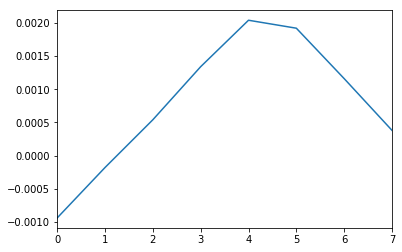

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


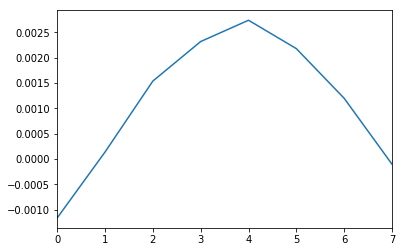

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


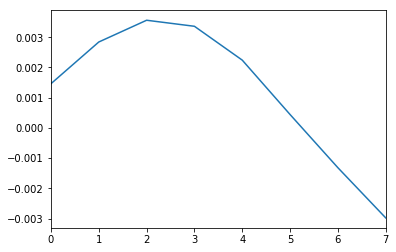

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


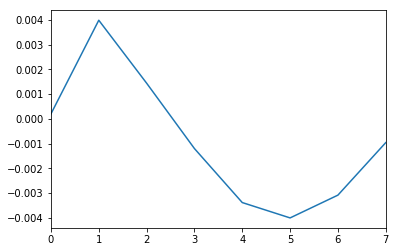

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


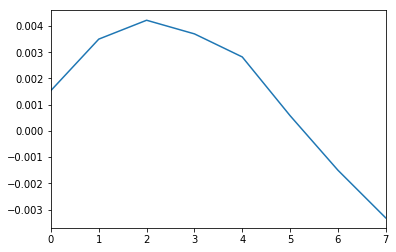

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


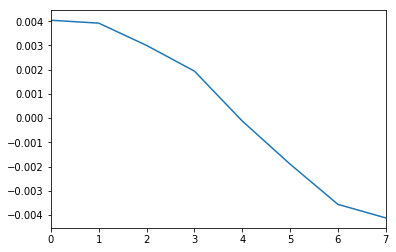

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


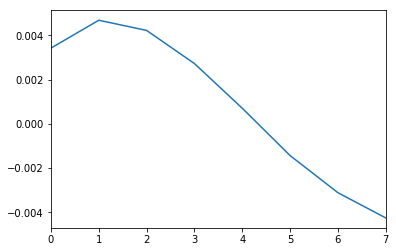

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


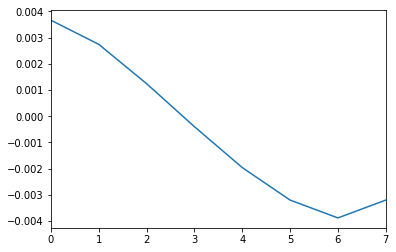

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


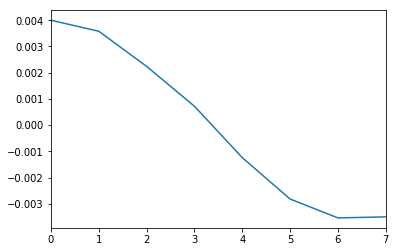

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


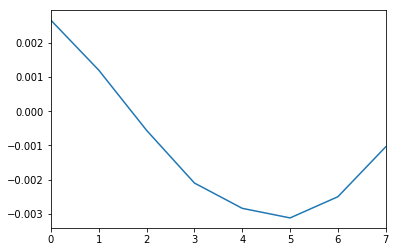

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


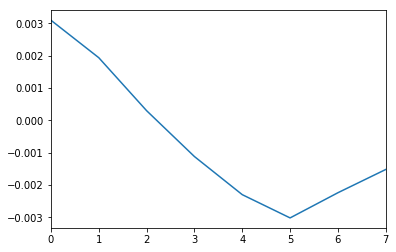

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


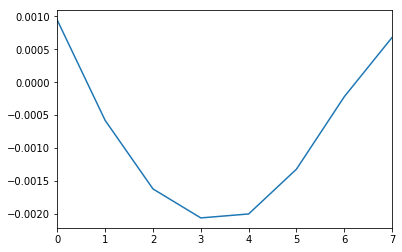

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


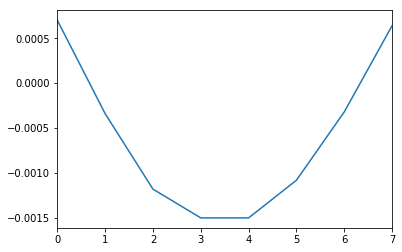

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


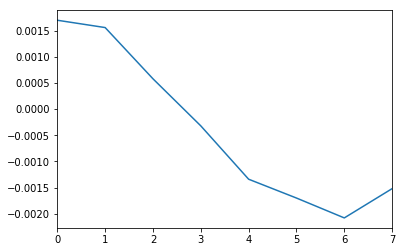

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


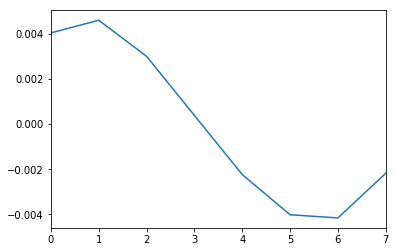

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


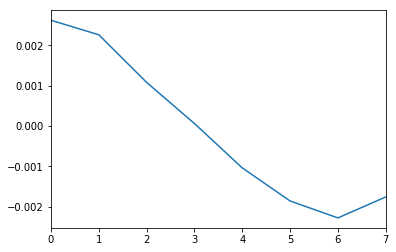

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


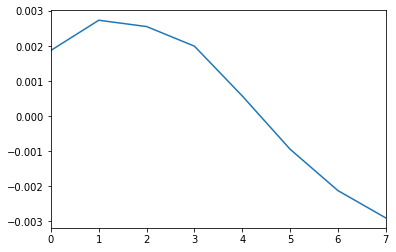

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


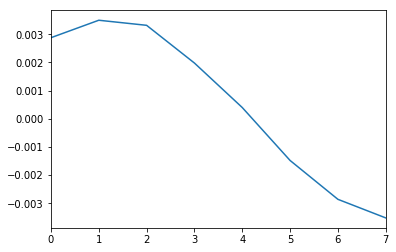

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


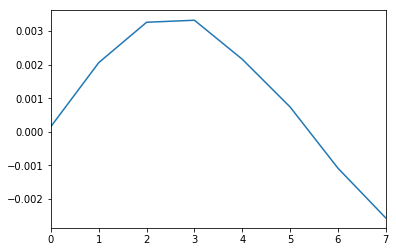

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


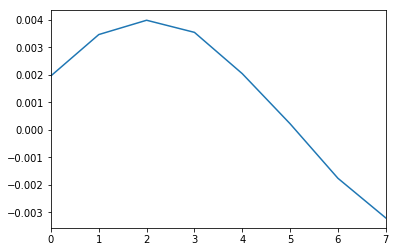

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


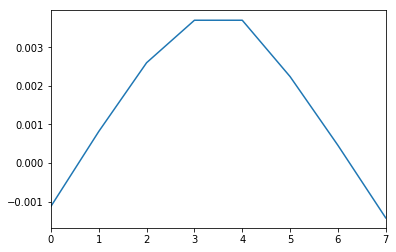

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


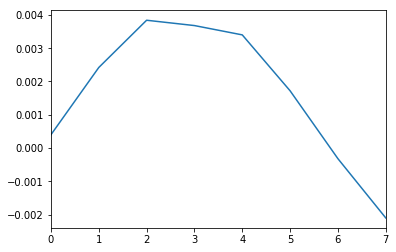

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


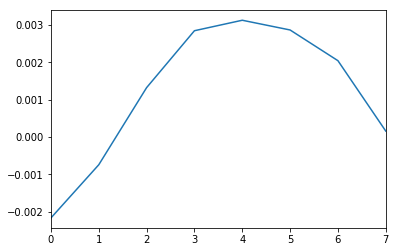

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


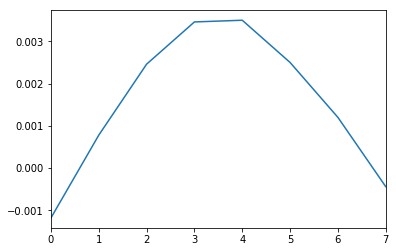

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


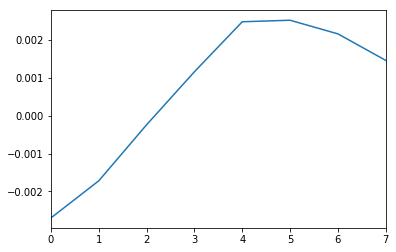

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


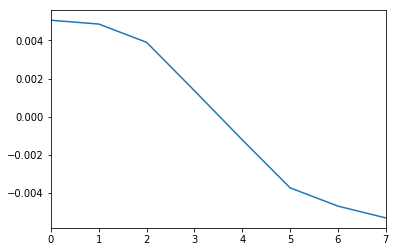

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


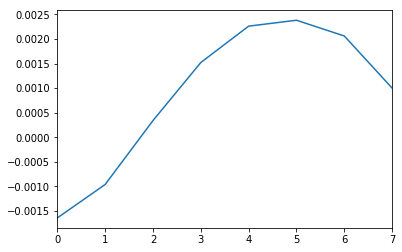

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


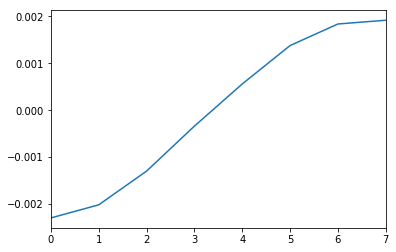

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


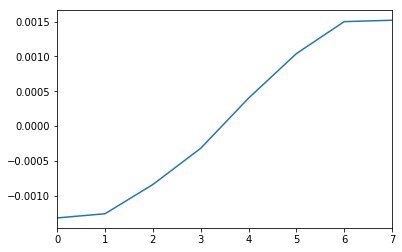

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


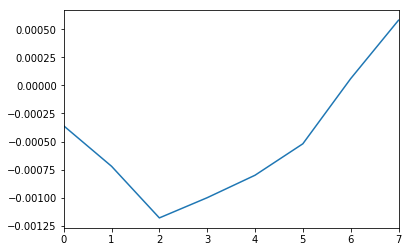

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


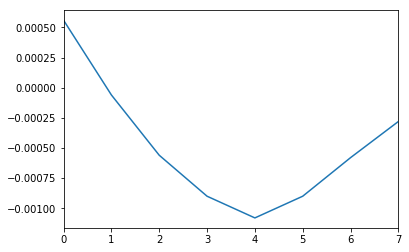

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


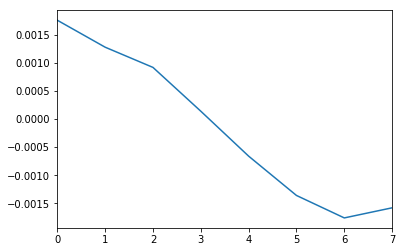

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


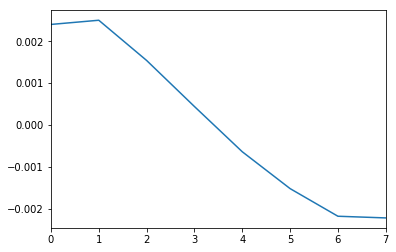

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


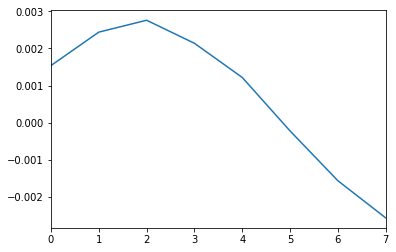

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


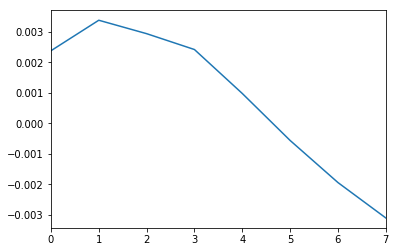

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


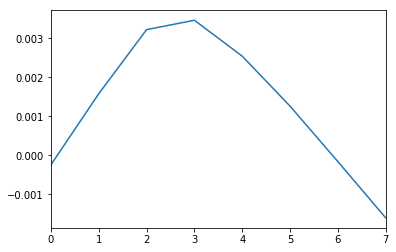

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


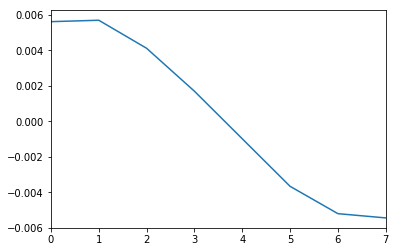

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


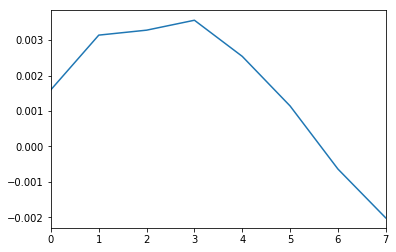

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


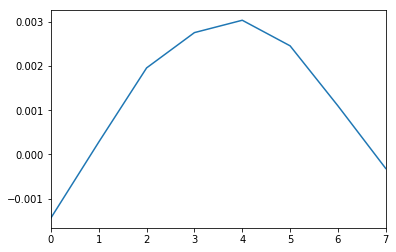

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


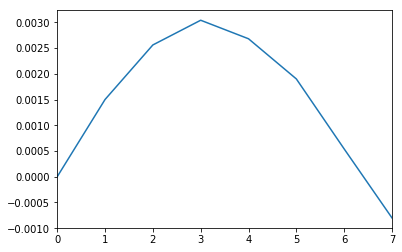

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


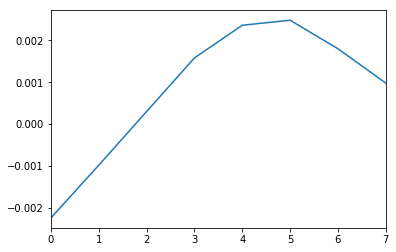

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


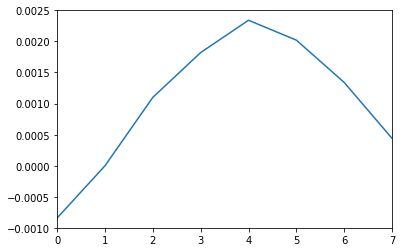

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


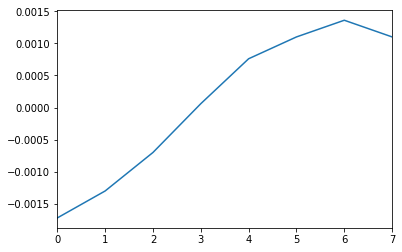

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


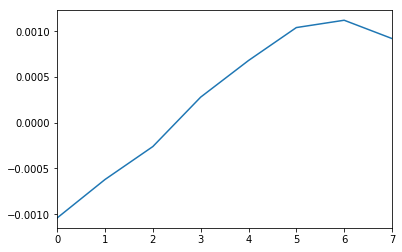

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


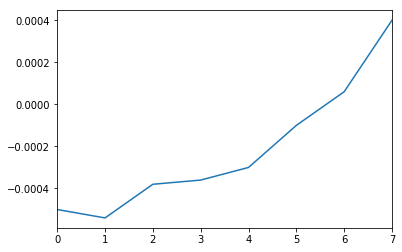

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


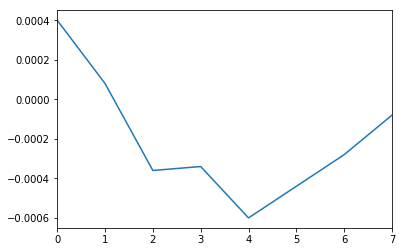

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


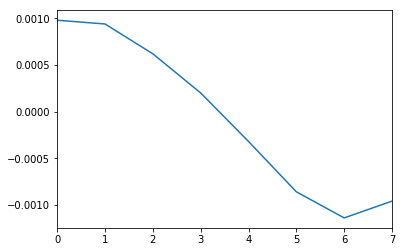

C:\Data\apr2017\170409\TestPhaseShift2_1830uWpump_TRKR___818.51nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


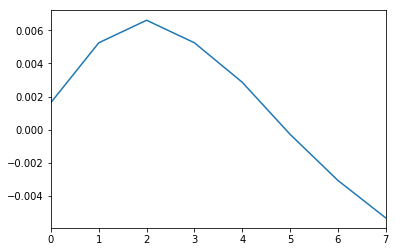

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.218x.dat


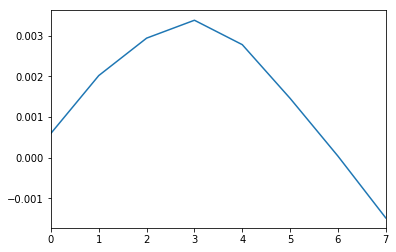

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.206x.dat


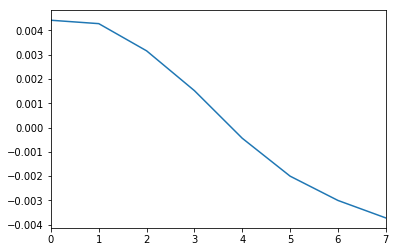

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.204x.dat


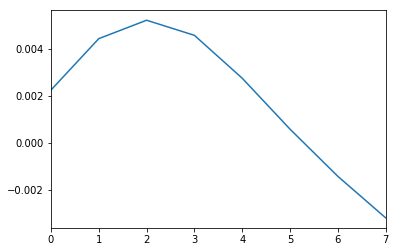

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.202x.dat


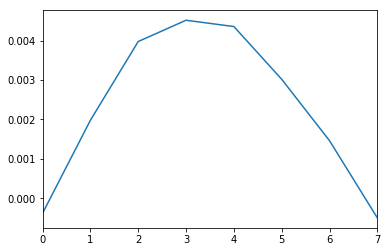

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.2x.dat


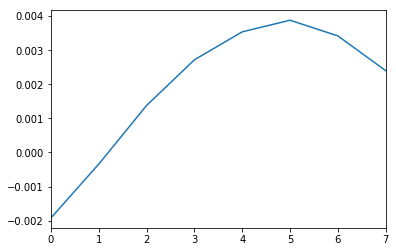

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.198x.dat


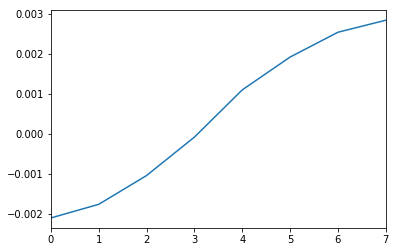

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.196x.dat


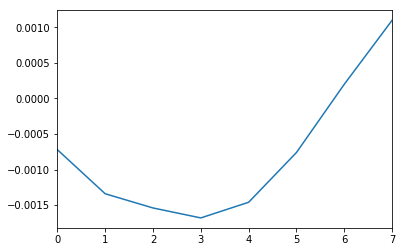

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.194x.dat


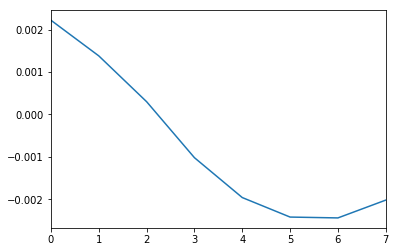

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.192x.dat


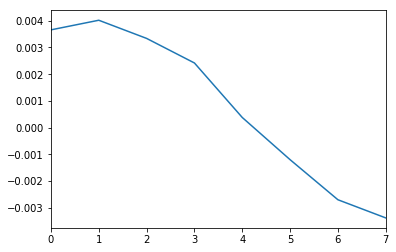

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.19x.dat


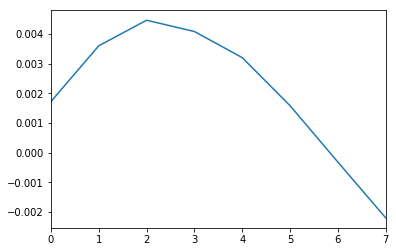

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.188x.dat


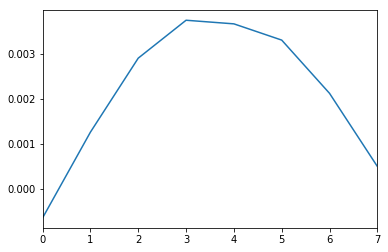

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


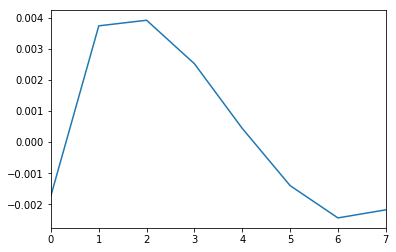

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.186x.dat


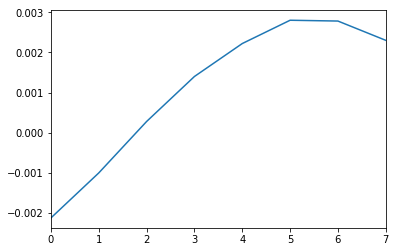

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.188x.dat


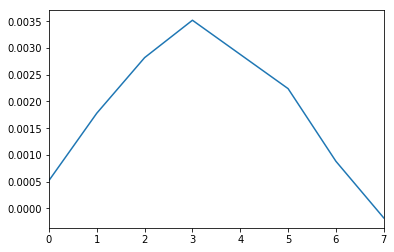

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.19x.dat


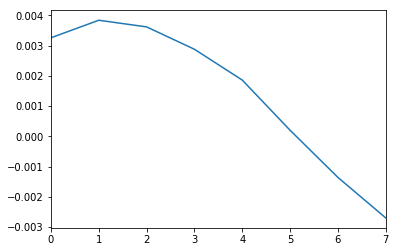

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.192x.dat


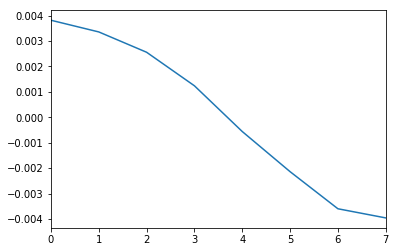

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.194x.dat


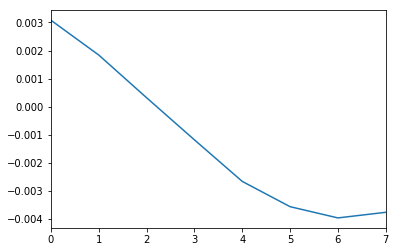

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.196x.dat


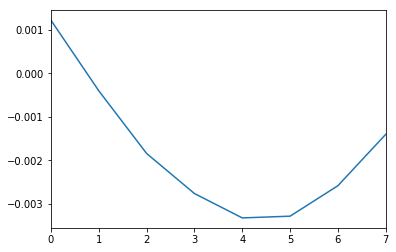

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.198x.dat


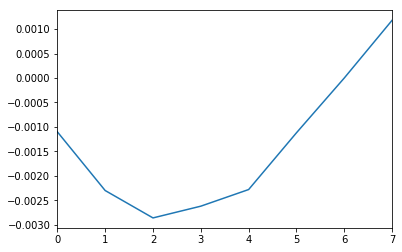

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


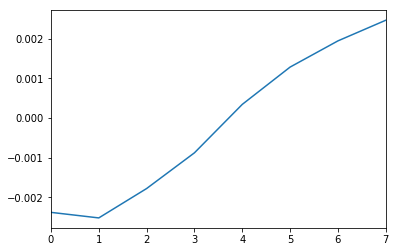

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.202x.dat


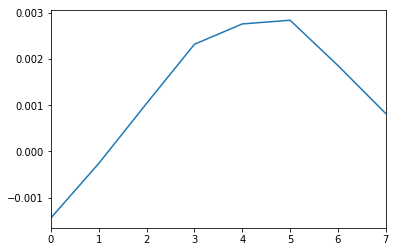

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.204x.dat


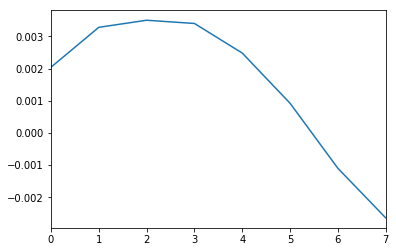

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal 0x.dat


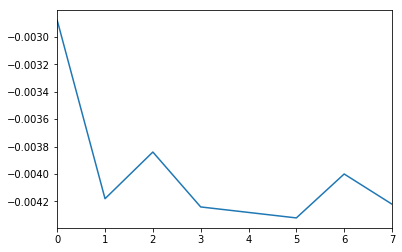

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.206x.dat


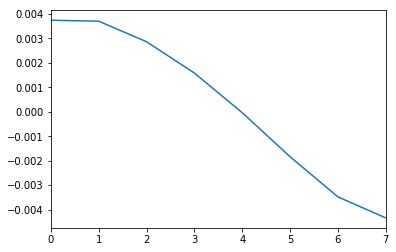

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.208x.dat


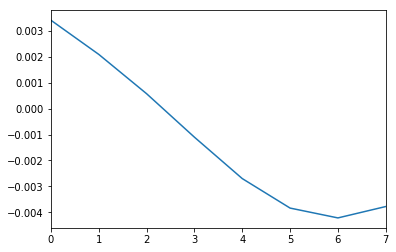

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.21x.dat


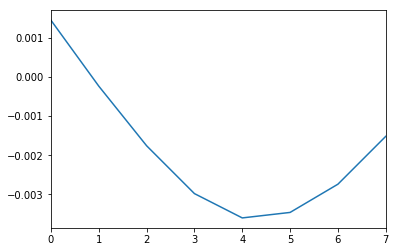

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.212x.dat


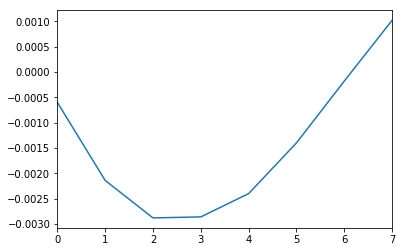

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.214x.dat


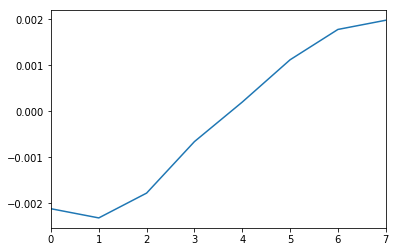

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.216x.dat


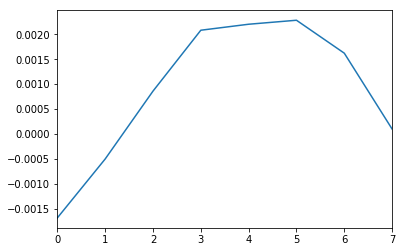

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.218x.dat


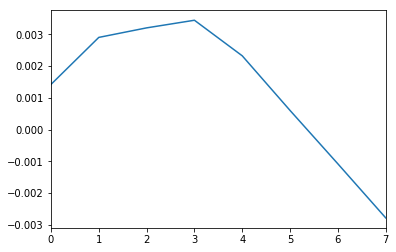

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.22x.dat


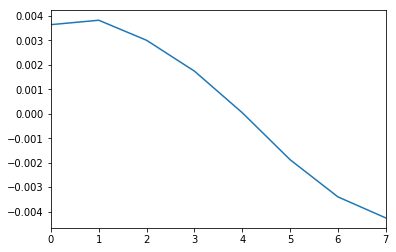

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.222x.dat


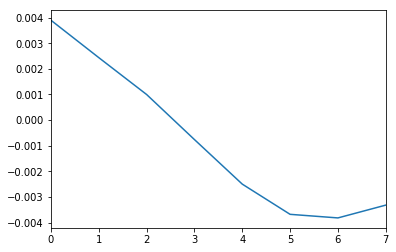

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.224x.dat


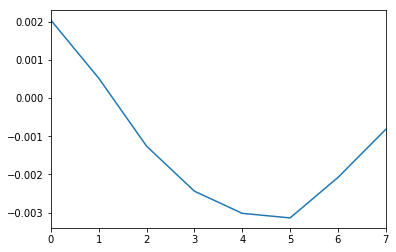

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0.3x.dat


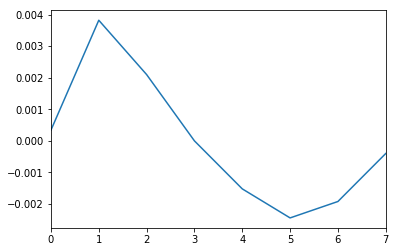

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.226x.dat


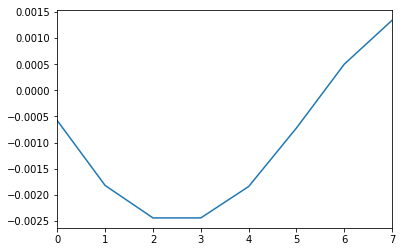

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.228x.dat


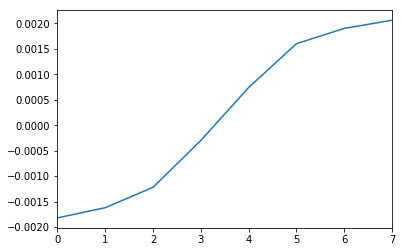

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.23x.dat


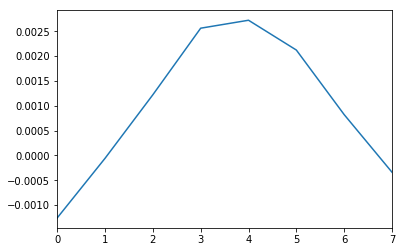

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.232x.dat


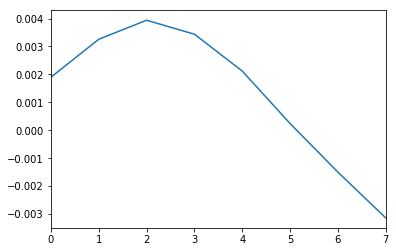

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.234x.dat


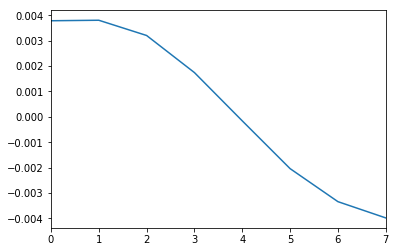

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.236x.dat


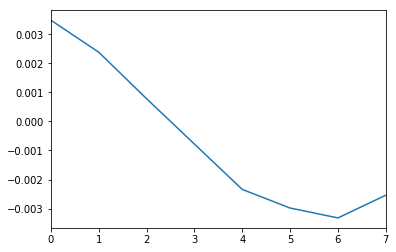

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.238x.dat


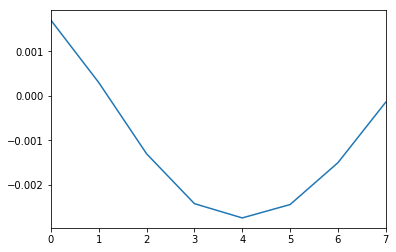

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.24x.dat


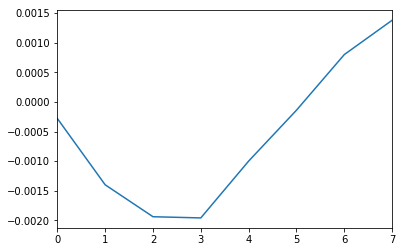

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.242x.dat


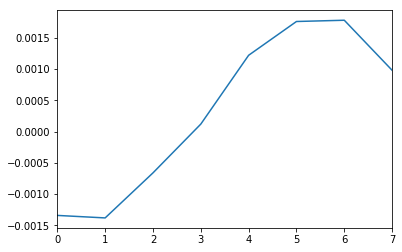

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.244x.dat


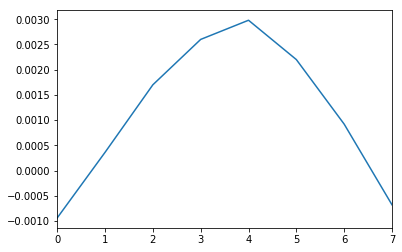

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0.218x.dat


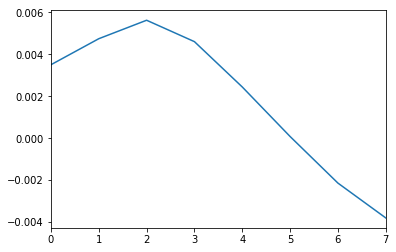

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.246x.dat


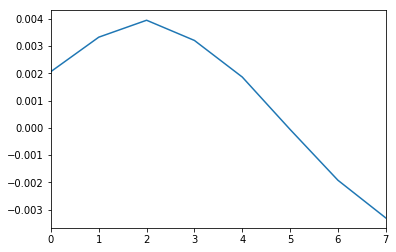

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.248x.dat


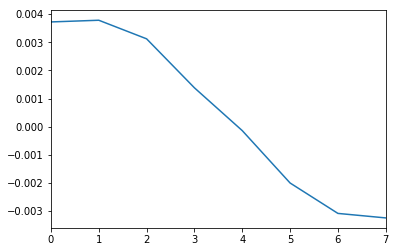

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.25x.dat


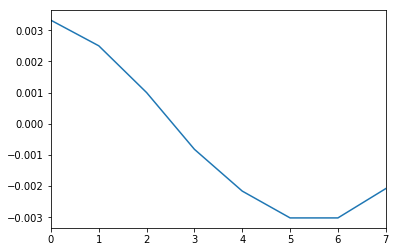

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.248x.dat


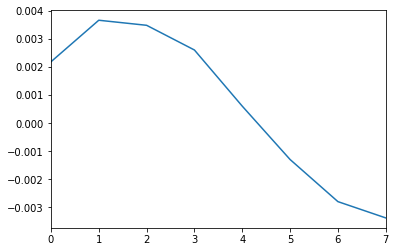

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.246x.dat


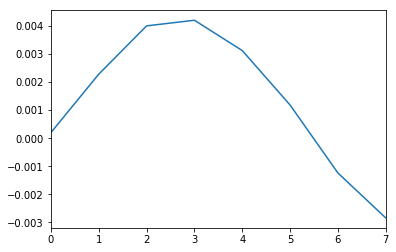

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.244x.dat


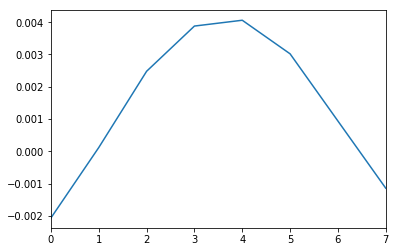

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.242x.dat


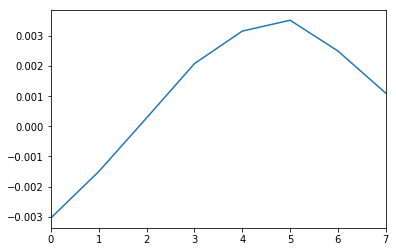

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.24x.dat


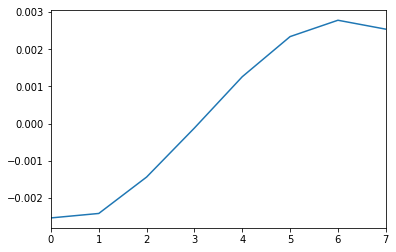

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.238x.dat


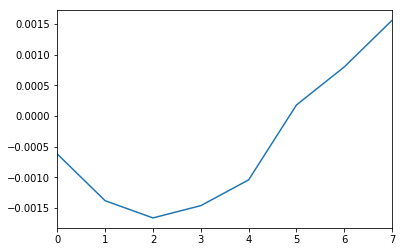

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.236x.dat


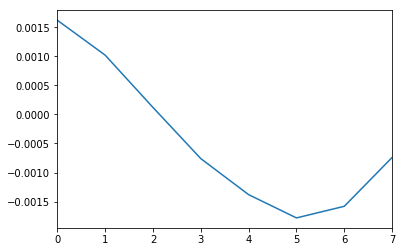

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.216x.dat


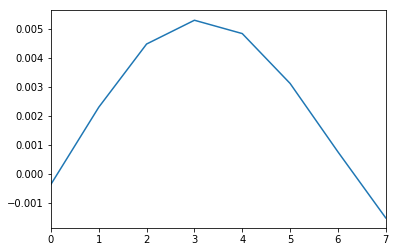

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.234x.dat


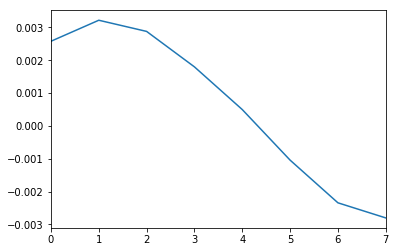

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.232x.dat


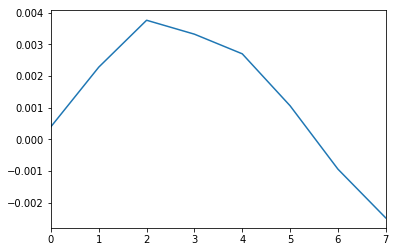

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.23x.dat


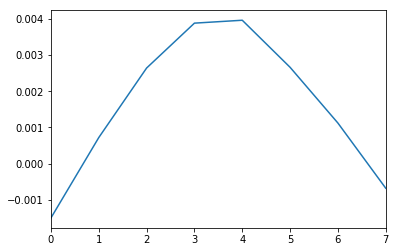

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.228x.dat


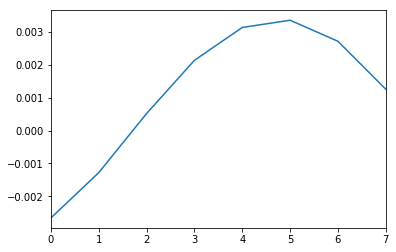

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.226x.dat


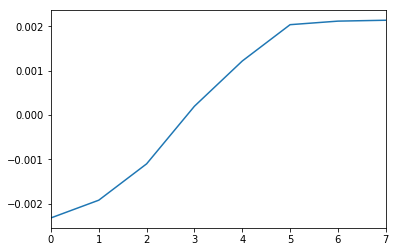

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.224x.dat


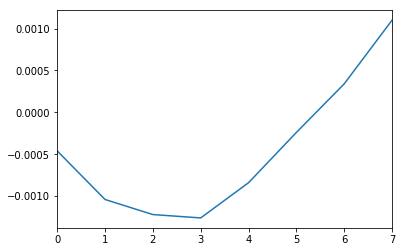

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.222x.dat


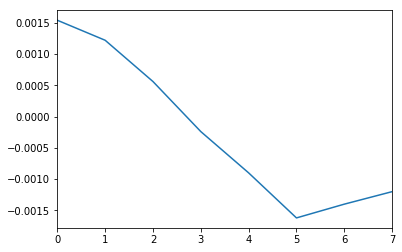

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.22x.dat


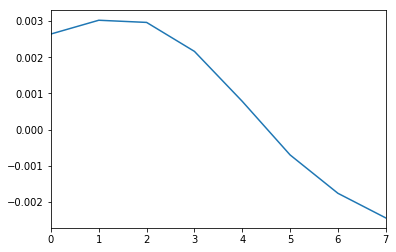

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.218x.dat


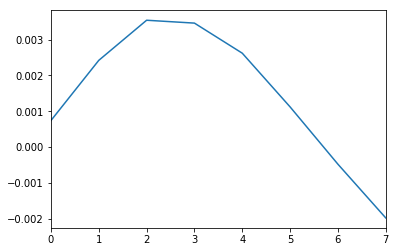

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.216x.dat


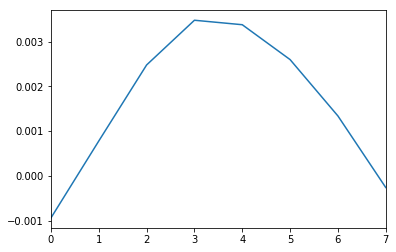

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.214x.dat


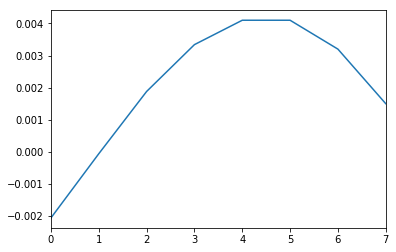

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.214x.dat


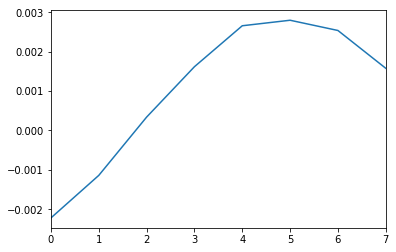

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.212x.dat


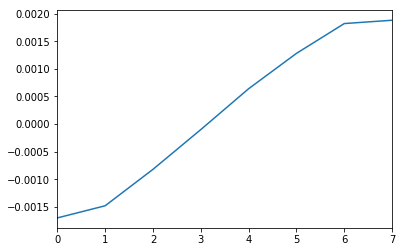

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.21x.dat


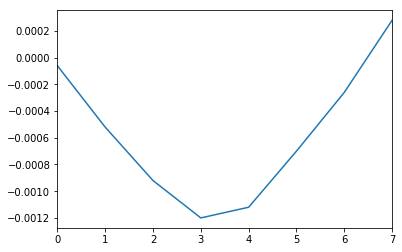

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.208x.dat


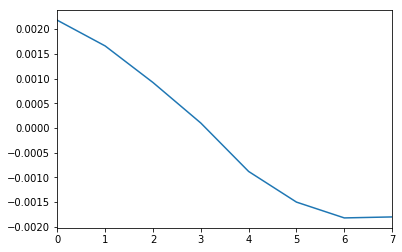

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.206x.dat


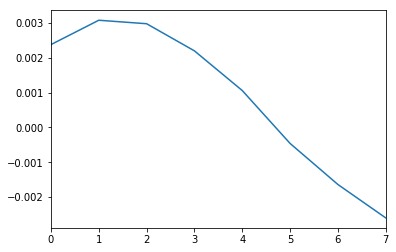

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.204x.dat


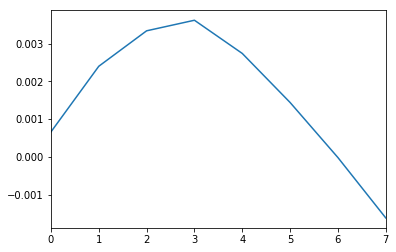

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.202x.dat


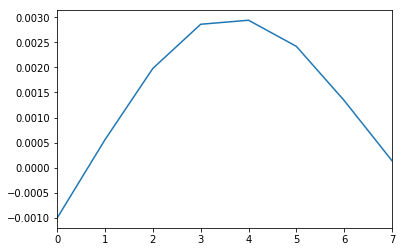

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.2x.dat


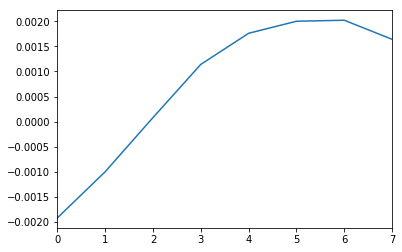

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.198x.dat


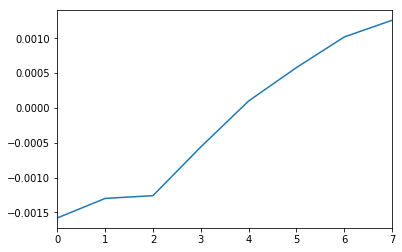

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.196x.dat


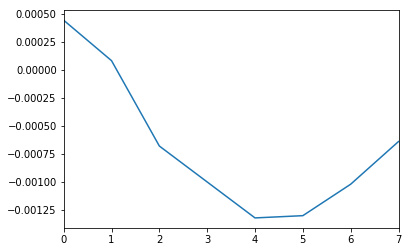

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.212x.dat


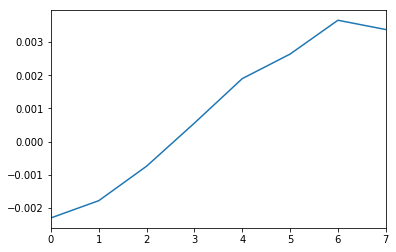

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.194x.dat


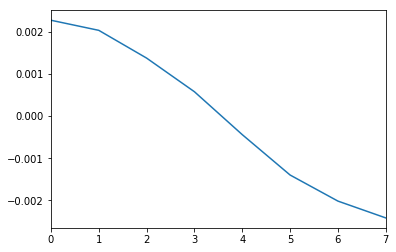

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.192x.dat


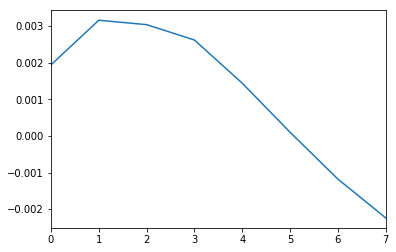

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.19x.dat


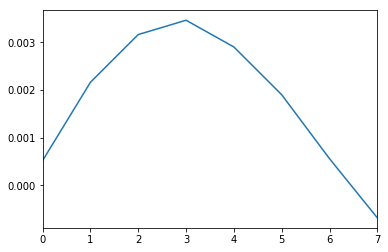

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.188x.dat


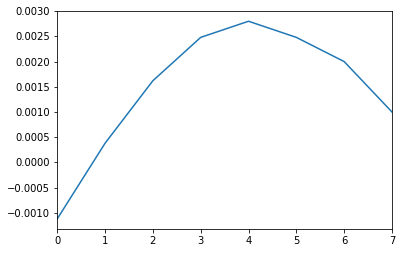

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.186x.dat


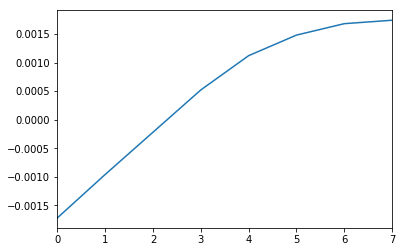

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.188x.dat


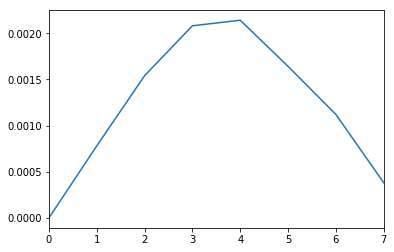

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.19x.dat


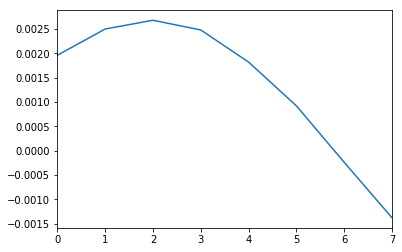

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.192x.dat


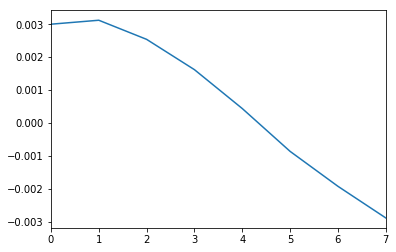

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.194x.dat


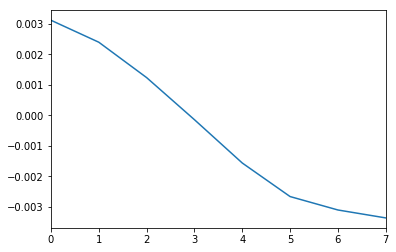

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.196x.dat


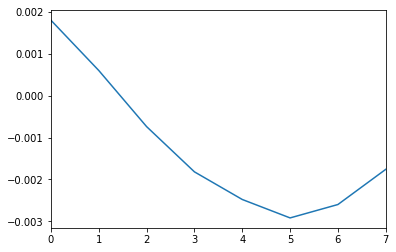

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.21x.dat


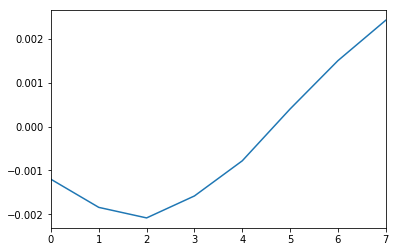

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.198x.dat


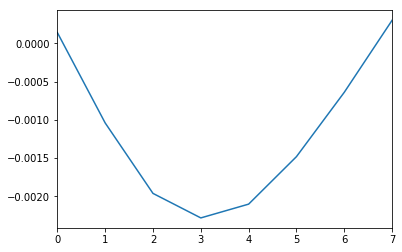

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.2x.dat


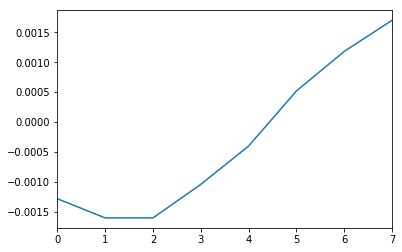

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.202x.dat


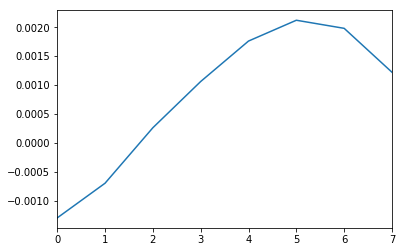

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.204x.dat


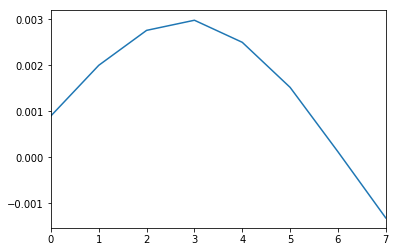

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.206x.dat


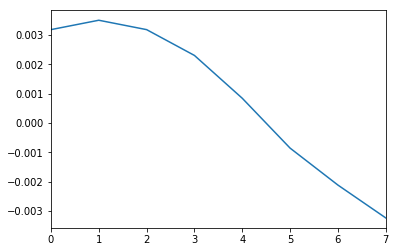

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.208x.dat


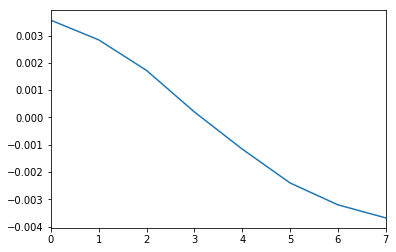

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.21x.dat


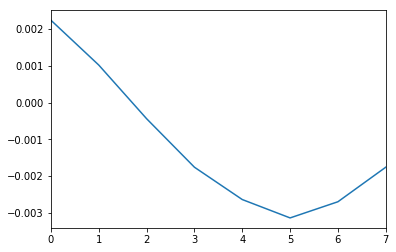

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.212x.dat


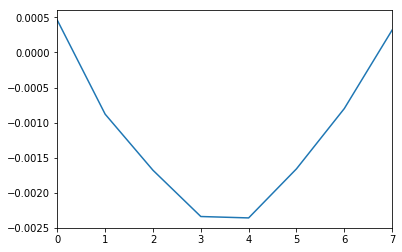

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.214x.dat


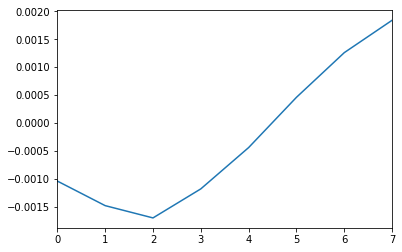

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.216x.dat


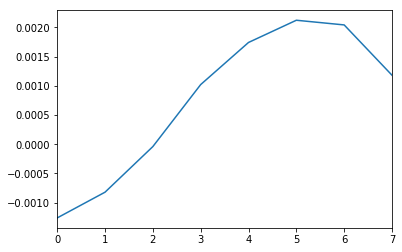

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_1repeats___818.56nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.208x.dat


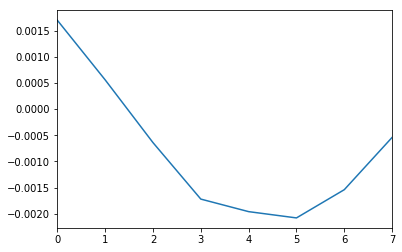

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.25x.dat


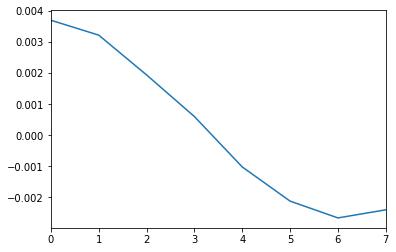

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.25x.dat


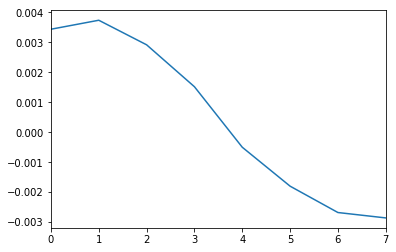

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.248x.dat


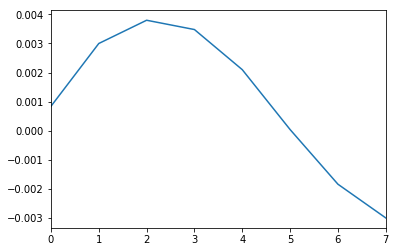

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.248x.dat


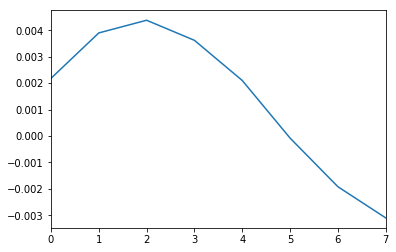

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.246x.dat


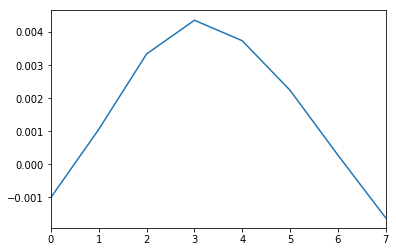

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.246x.dat


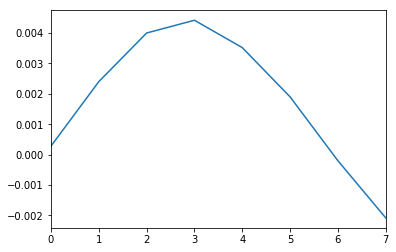

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.244x.dat


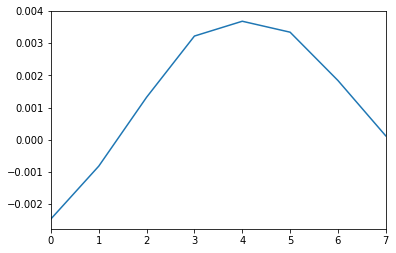

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.244x.dat


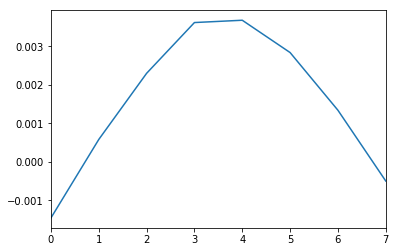

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.242x.dat


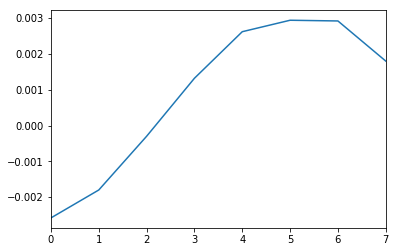

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.242x.dat


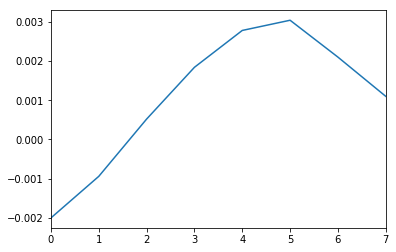

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.212x.dat


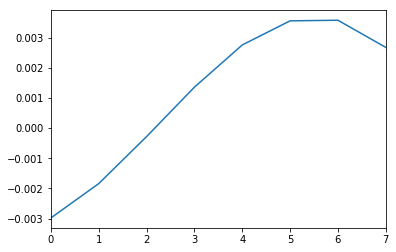

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.24x.dat


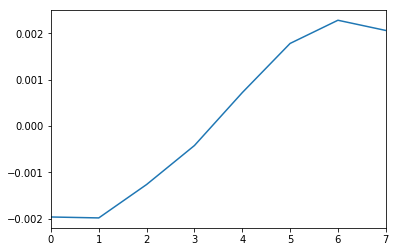

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.24x.dat


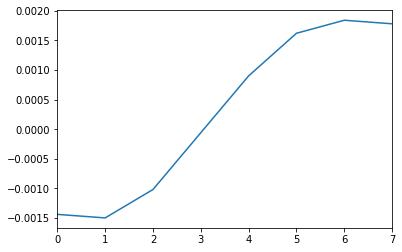

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.238x.dat


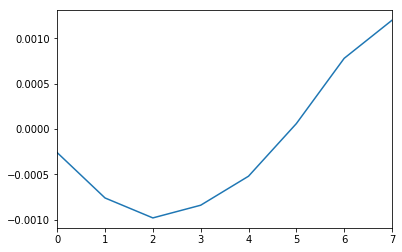

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.238x.dat


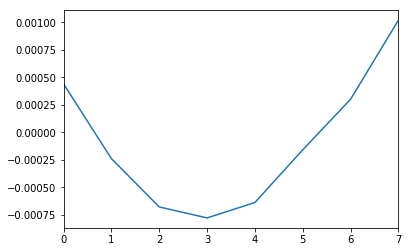

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.236x.dat


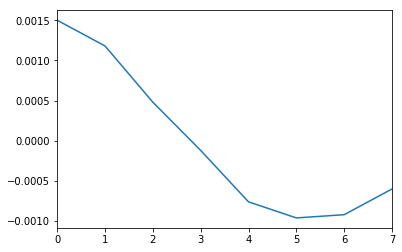

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.236x.dat


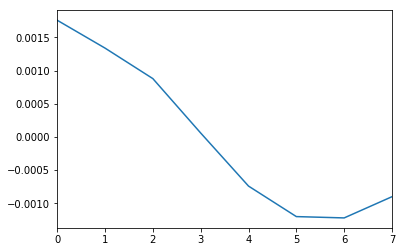

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.234x.dat


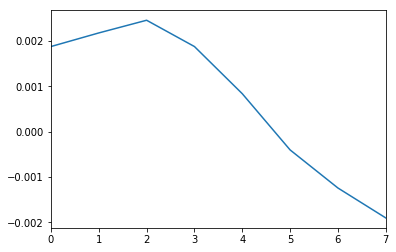

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.234x.dat


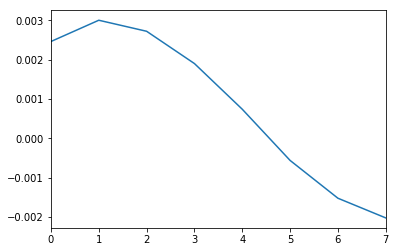

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.232x.dat


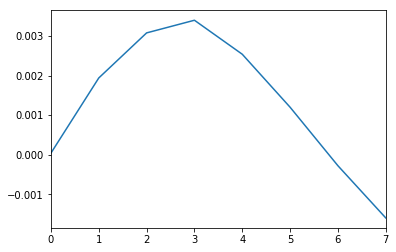

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.232x.dat


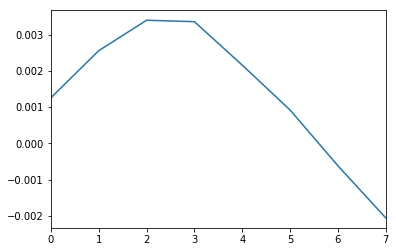

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.212x.dat


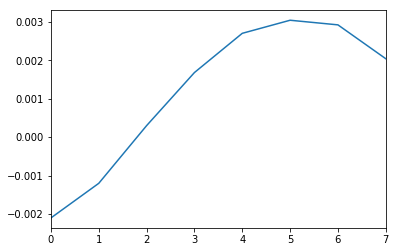

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.23x.dat


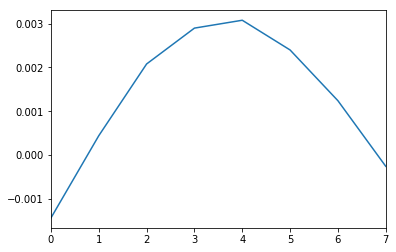

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.23x.dat


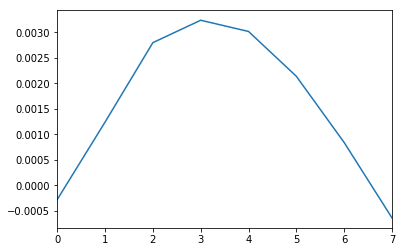

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.228x.dat


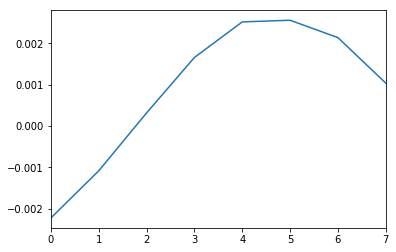

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.228x.dat


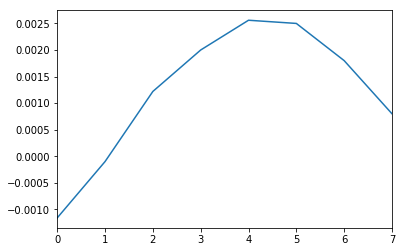

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.226x.dat


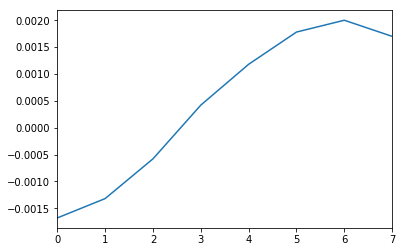

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.226x.dat


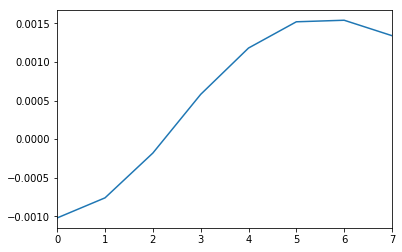

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.224x.dat


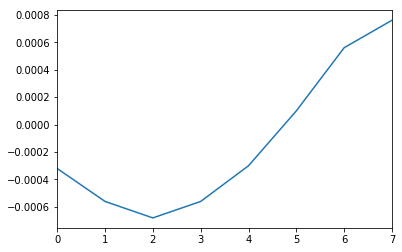

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.224x.dat


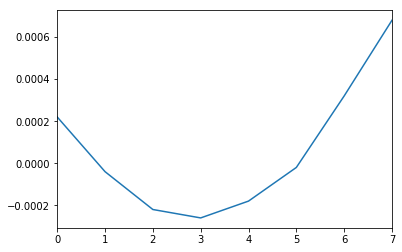

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.222x.dat


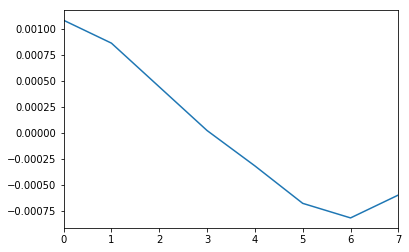

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -480_to_-60 BExternal 0.222x.dat


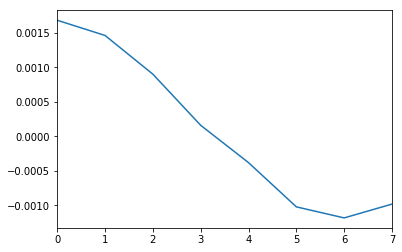

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.21x.dat


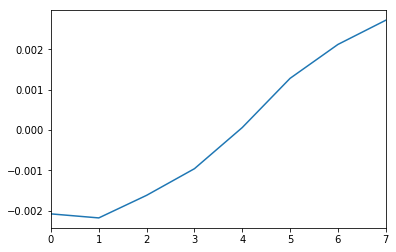

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -480_to_-60 BExternal 0.22x.dat


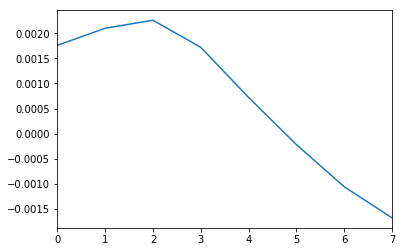

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -480_to_-60 BExternal 0.22x.dat


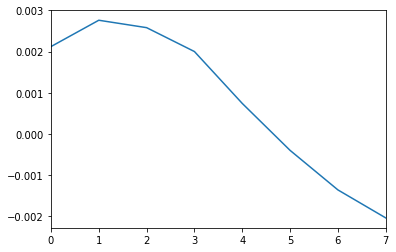

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -480_to_-60 BExternal 0.218x.dat


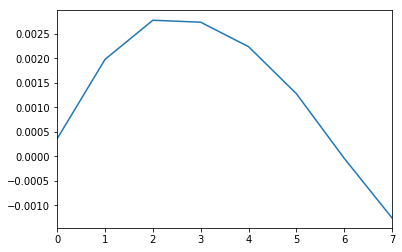

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_133_DelayTime -480_to_-60 BExternal 0.218x.dat


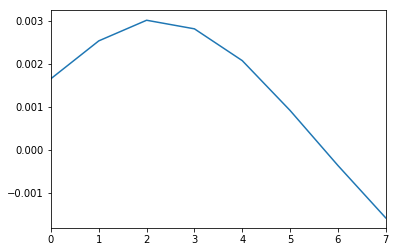

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_134_DelayTime -480_to_-60 BExternal 0.216x.dat


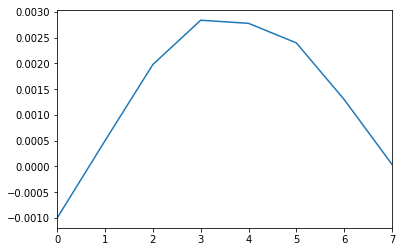

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_135_DelayTime -480_to_-60 BExternal 0.216x.dat


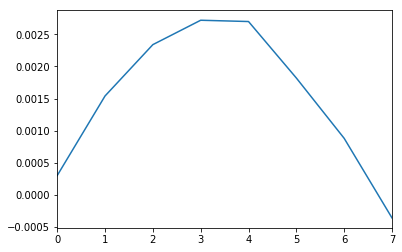

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_136_DelayTime -480_to_-60 BExternal 0.214x.dat


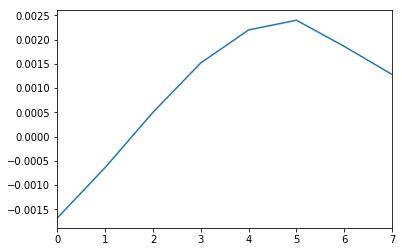

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_137_DelayTime -480_to_-60 BExternal 0.214x.dat


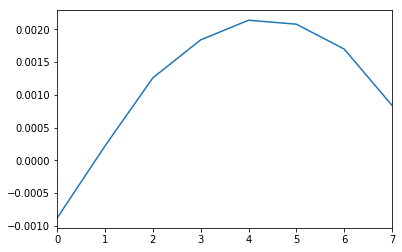

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_138_DelayTime -480_to_-60 BExternal 0.212x.dat


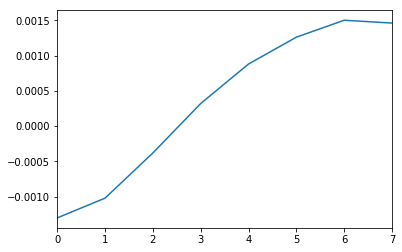

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_139_DelayTime -480_to_-60 BExternal 0.212x.dat


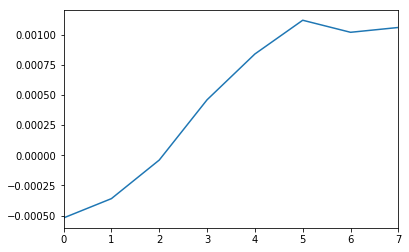

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.21x.dat


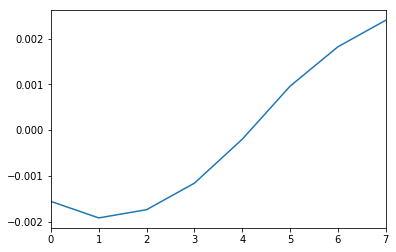

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_140_DelayTime -480_to_-60 BExternal 0.21x.dat


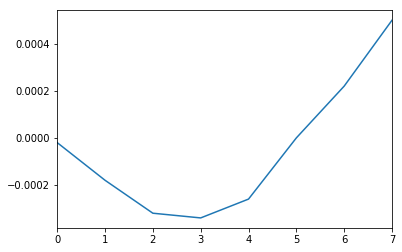

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_141_DelayTime -480_to_-60 BExternal 0.21x.dat


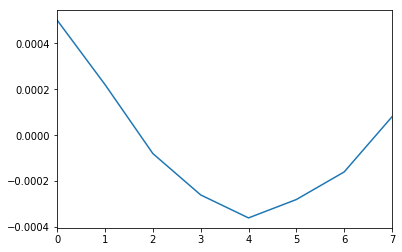

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_142_DelayTime -480_to_-60 BExternal 0.208x.dat


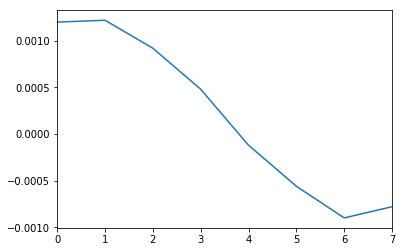

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_143_DelayTime -480_to_-60 BExternal 0.208x.dat


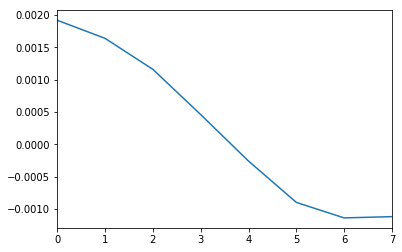

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_144_DelayTime -480_to_-60 BExternal 0.206x.dat


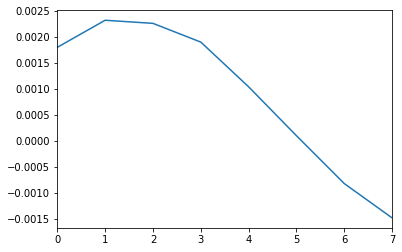

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_145_DelayTime -480_to_-60 BExternal 0.206x.dat


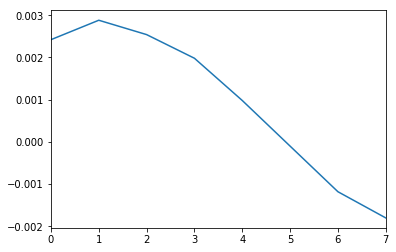

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_146_DelayTime -480_to_-60 BExternal 0.204x.dat


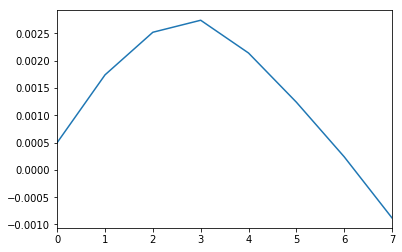

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_147_DelayTime -480_to_-60 BExternal 0.204x.dat


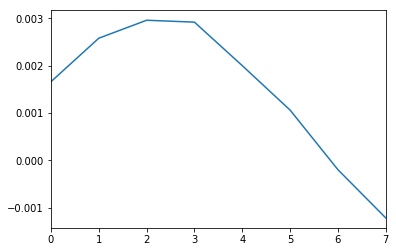

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_148_DelayTime -480_to_-60 BExternal 0.202x.dat


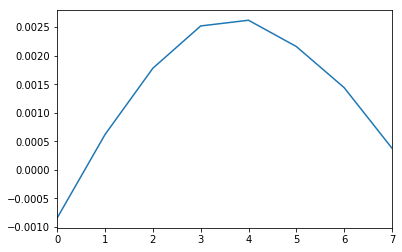

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_149_DelayTime -480_to_-60 BExternal 0.202x.dat


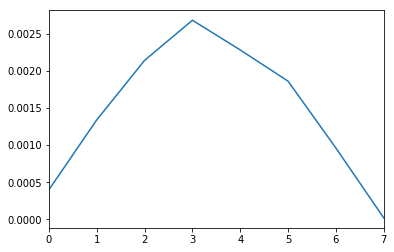

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.208x.dat


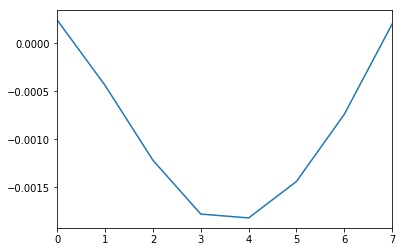

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_150_DelayTime -480_to_-60 BExternal 0.2x.dat


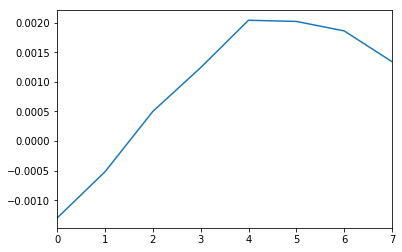

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_151_DelayTime -480_to_-60 BExternal 0.2x.dat


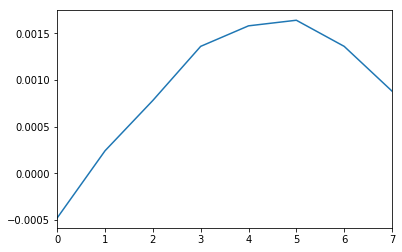

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_152_DelayTime -480_to_-60 BExternal 0.198x.dat


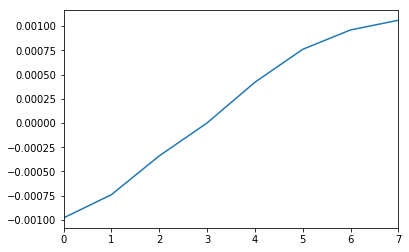

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_153_DelayTime -480_to_-60 BExternal 0.198x.dat


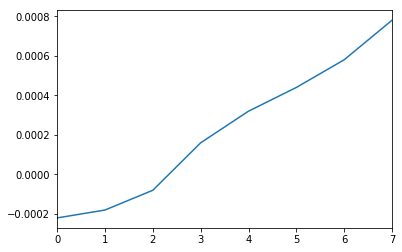

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_154_DelayTime -480_to_-60 BExternal 0.196x.dat


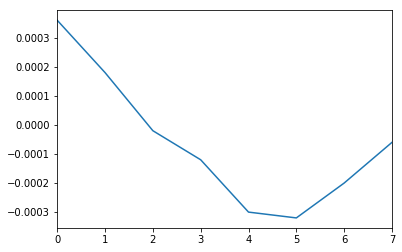

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_155_DelayTime -480_to_-60 BExternal 0.196x.dat


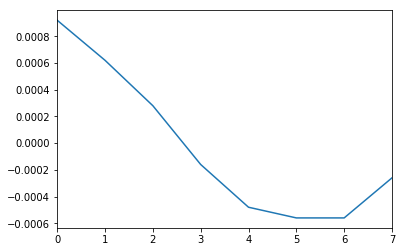

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_156_DelayTime -480_to_-60 BExternal 0.194x.dat


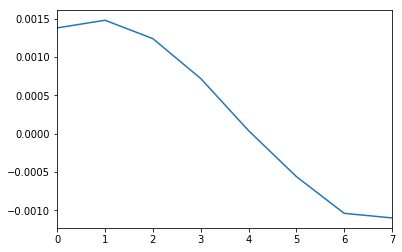

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_157_DelayTime -480_to_-60 BExternal 0.194x.dat


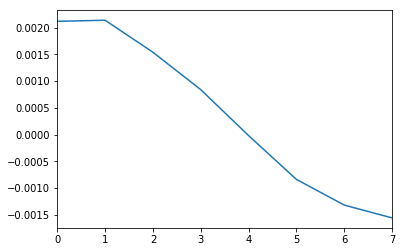

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_158_DelayTime -480_to_-60 BExternal 0.192x.dat


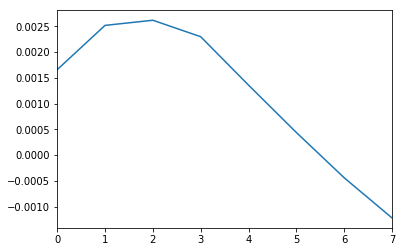

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_159_DelayTime -480_to_-60 BExternal 0.192x.dat


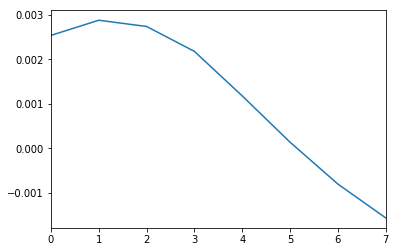

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.208x.dat


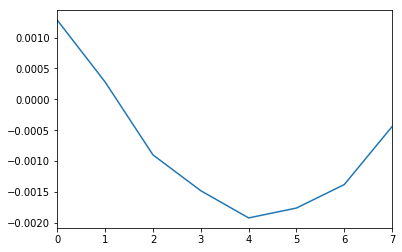

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_160_DelayTime -480_to_-60 BExternal 0.19x.dat


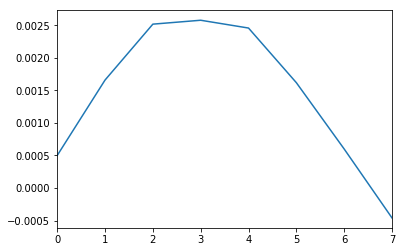

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_161_DelayTime -480_to_-60 BExternal 0.19x.dat


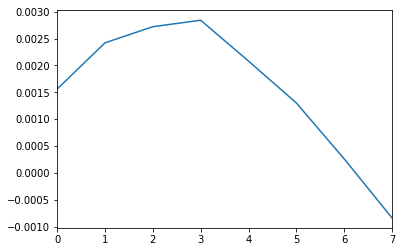

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_162_DelayTime -480_to_-60 BExternal 0.188x.dat


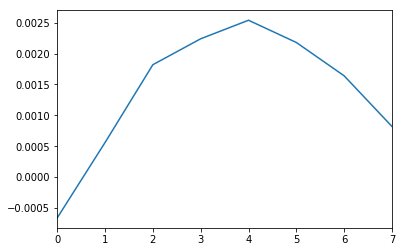

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_163_DelayTime -480_to_-60 BExternal 0.188x.dat


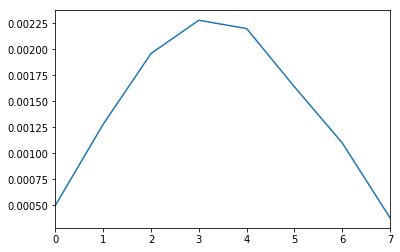

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_164_DelayTime -480_to_-60 BExternal 0.186x.dat


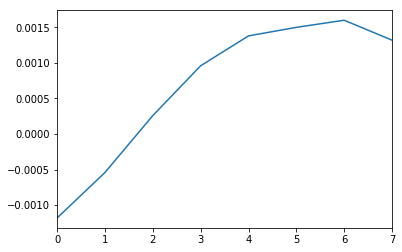

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_165_DelayTime -480_to_-60 BExternal 0.186x.dat


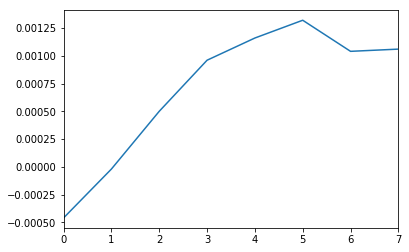

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_166_DelayTime -480_to_-60 BExternal 0.188x.dat


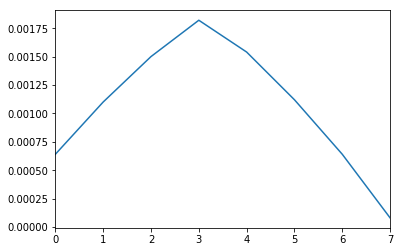

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_167_DelayTime -480_to_-60 BExternal 0.188x.dat


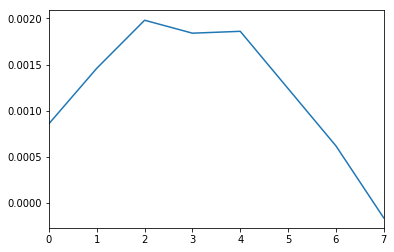

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_168_DelayTime -480_to_-60 BExternal 0.19x.dat


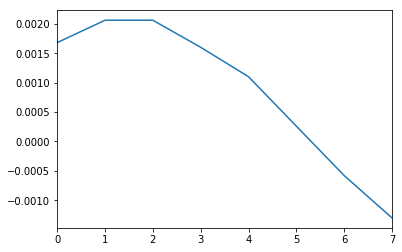

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_169_DelayTime -480_to_-60 BExternal 0.19x.dat


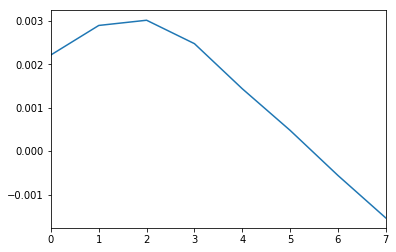

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.206x.dat


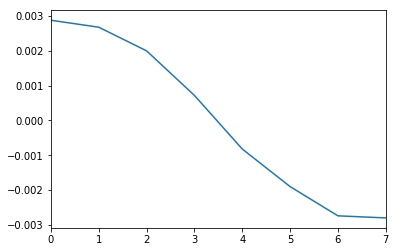

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_170_DelayTime -480_to_-60 BExternal 0.192x.dat


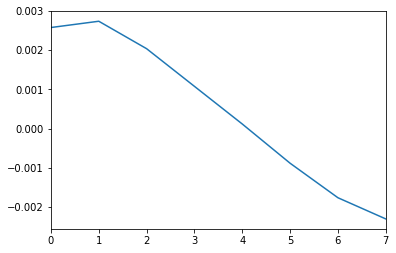

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_171_DelayTime -480_to_-60 BExternal 0.192x.dat


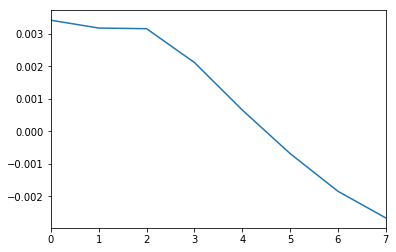

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_172_DelayTime -480_to_-60 BExternal 0.194x.dat


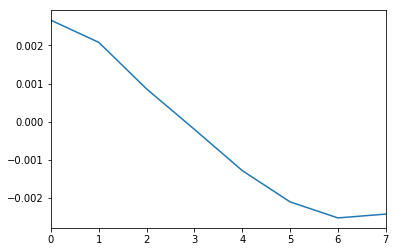

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_173_DelayTime -480_to_-60 BExternal 0.194x.dat


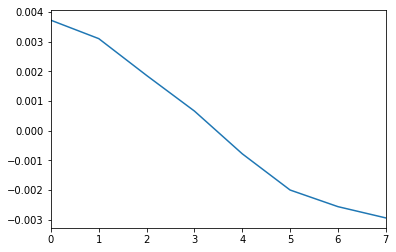

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_174_DelayTime -480_to_-60 BExternal 0.196x.dat


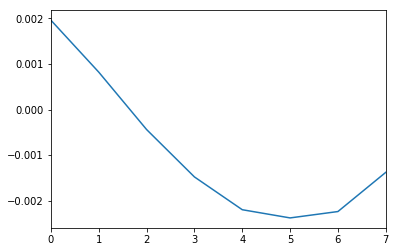

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_175_DelayTime -480_to_-60 BExternal 0.196x.dat


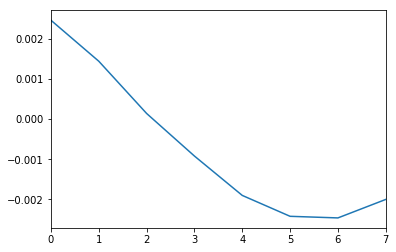

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_176_DelayTime -480_to_-60 BExternal 0.198x.dat


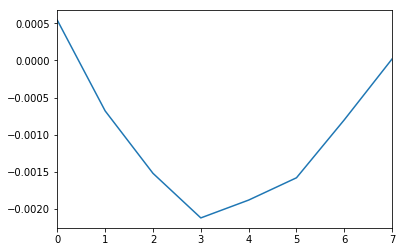

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_177_DelayTime -480_to_-60 BExternal 0.198x.dat


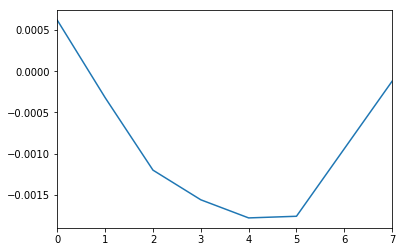

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_178_DelayTime -480_to_-60 BExternal 0.2x.dat


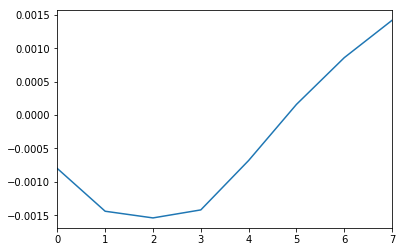

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_179_DelayTime -480_to_-60 BExternal 0.2x.dat


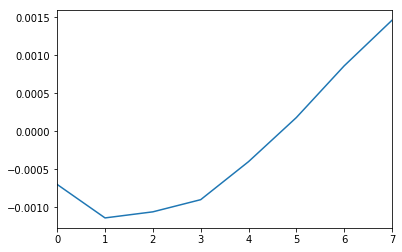

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.206x.dat


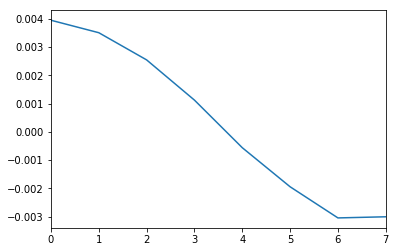

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_180_DelayTime -480_to_-60 BExternal 0.202x.dat


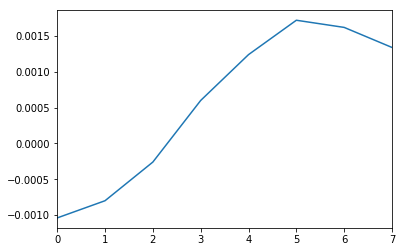

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_181_DelayTime -480_to_-60 BExternal 0.202x.dat


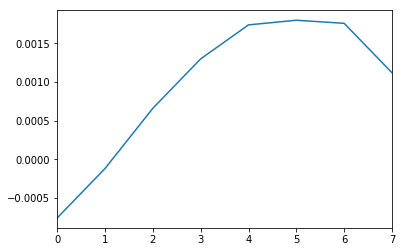

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_182_DelayTime -480_to_-60 BExternal 0.204x.dat


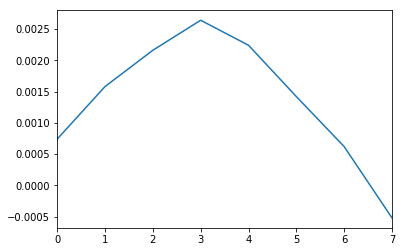

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_183_DelayTime -480_to_-60 BExternal 0.204x.dat


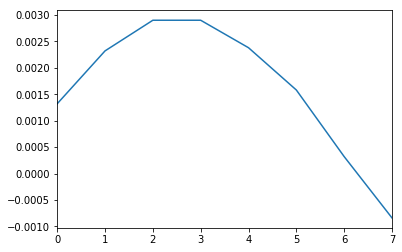

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_184_DelayTime -480_to_-60 BExternal 0.206x.dat


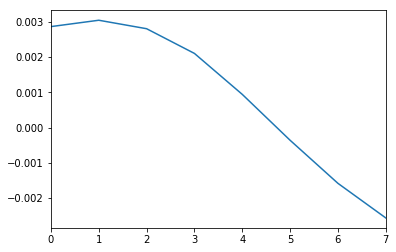

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_185_DelayTime -480_to_-60 BExternal 0.206x.dat


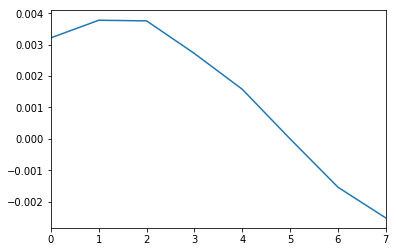

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_186_DelayTime -480_to_-60 BExternal 0.208x.dat


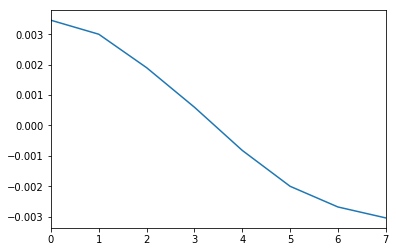

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_187_DelayTime -480_to_-60 BExternal 0.208x.dat


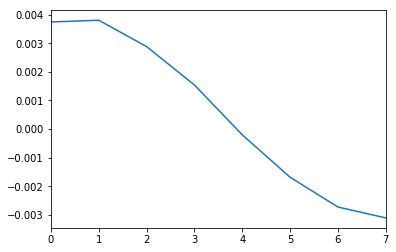

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_188_DelayTime -480_to_-60 BExternal 0.21x.dat


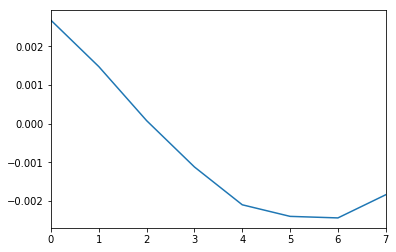

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_189_DelayTime -480_to_-60 BExternal 0.21x.dat


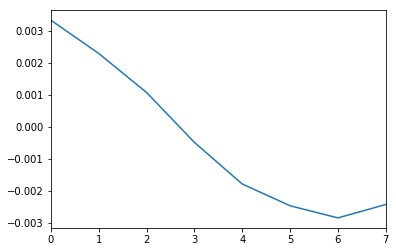

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.204x.dat


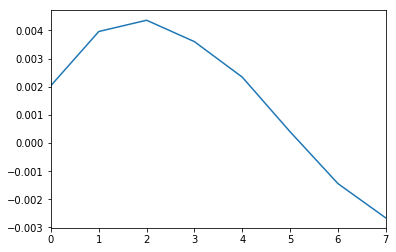

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_190_DelayTime -480_to_-60 BExternal 0.212x.dat


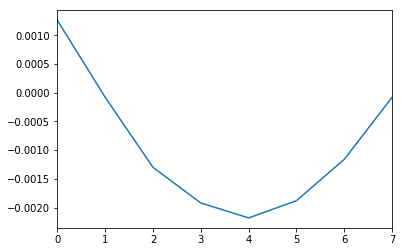

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_191_DelayTime -480_to_-60 BExternal 0.212x.dat


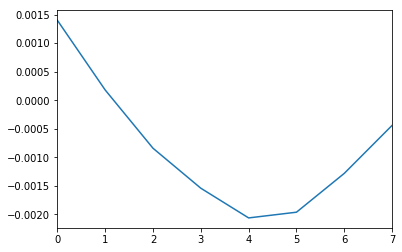

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_192_DelayTime -480_to_-60 BExternal 0.214x.dat


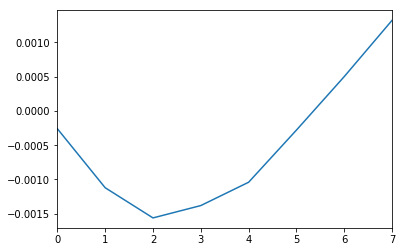

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_193_DelayTime -480_to_-60 BExternal 0.214x.dat


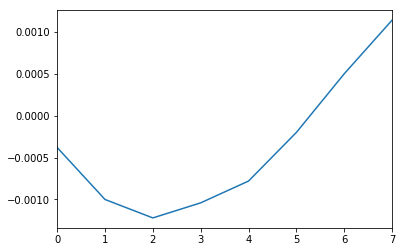

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_194_DelayTime -480_to_-60 BExternal 0.216x.dat


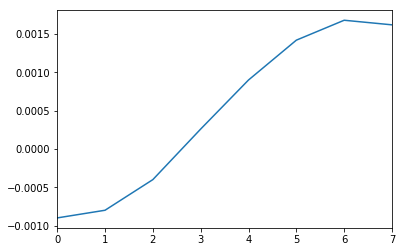

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_195_DelayTime -480_to_-60 BExternal 0.216x.dat


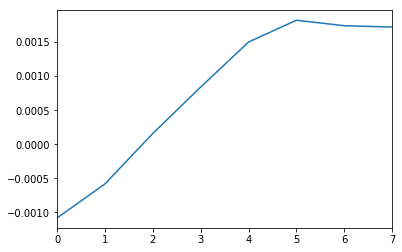

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_196_DelayTime -480_to_-60 BExternal 0.218x.dat


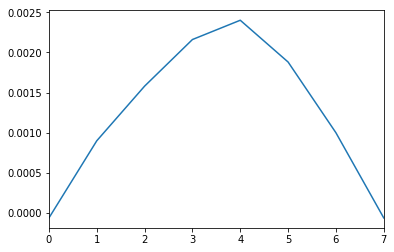

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_197_DelayTime -480_to_-60 BExternal 0.218x.dat


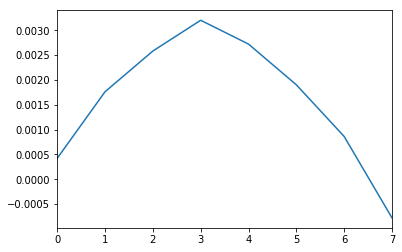

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.204x.dat


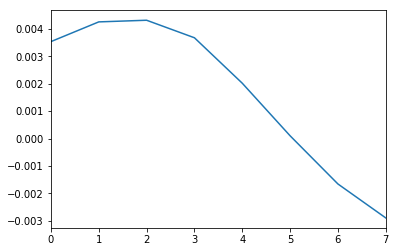

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


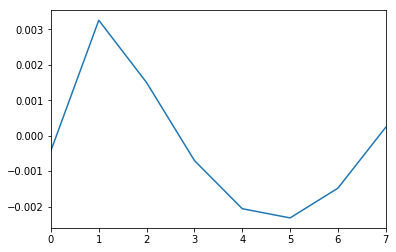

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.202x.dat


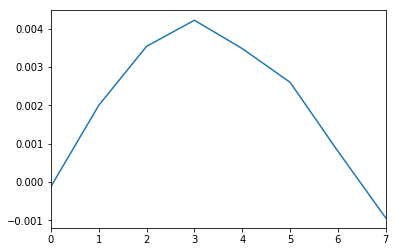

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.202x.dat


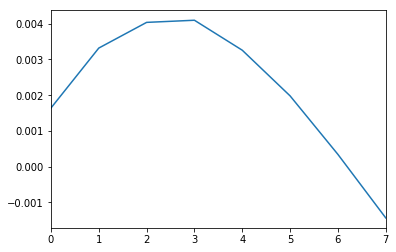

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.2x.dat


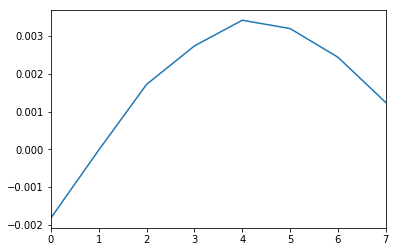

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.2x.dat


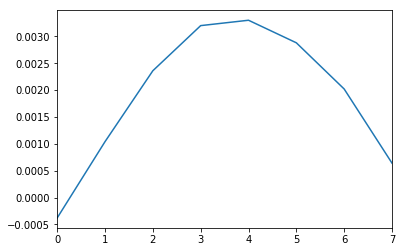

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.198x.dat


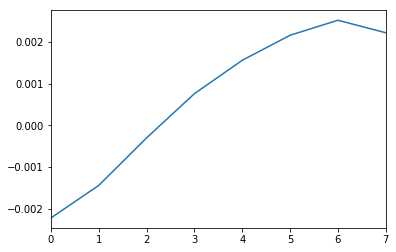

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.198x.dat


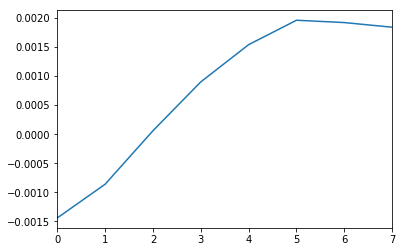

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.196x.dat


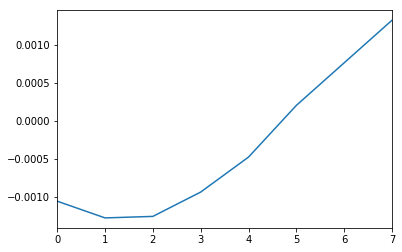

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.196x.dat


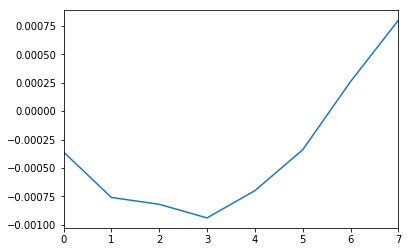

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.194x.dat


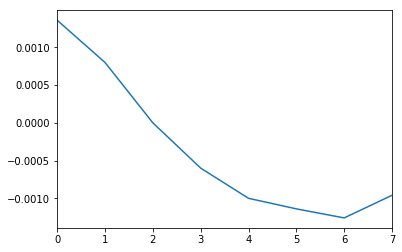

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.194x.dat


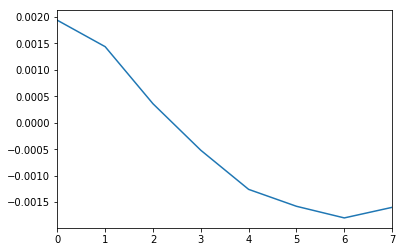

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal 0x.dat


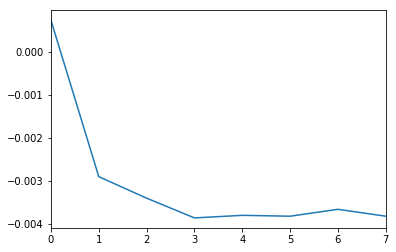

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.192x.dat


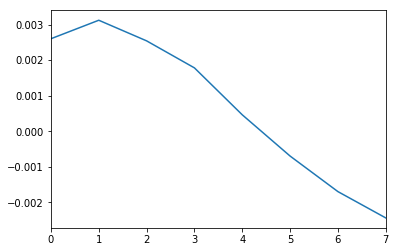

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.192x.dat


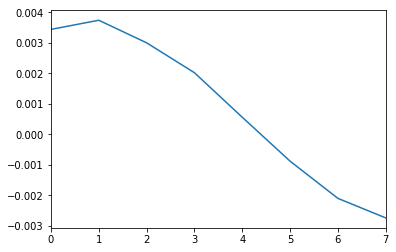

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.19x.dat


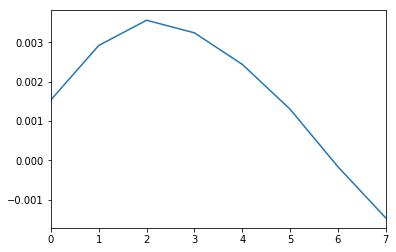

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.19x.dat


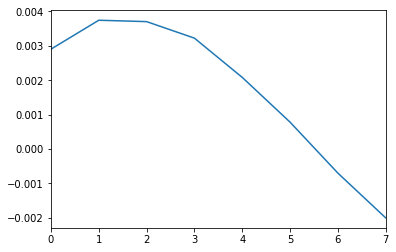

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.188x.dat


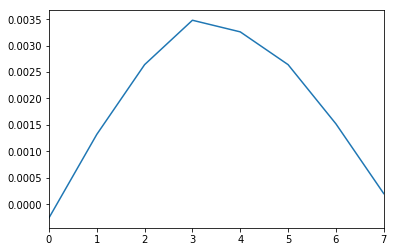

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.188x.dat


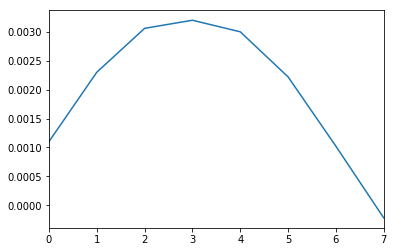

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.186x.dat


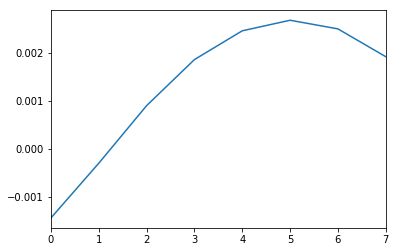

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.186x.dat


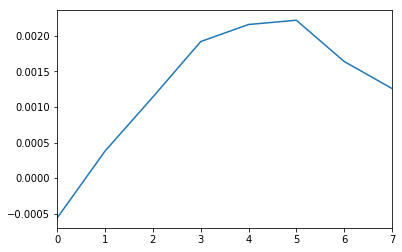

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.188x.dat


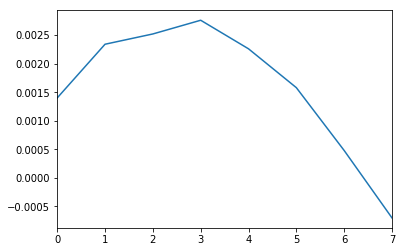

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.188x.dat


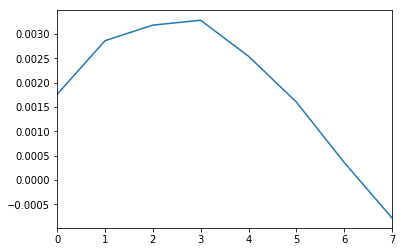

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0.3x.dat


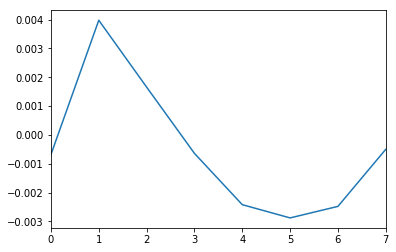

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.19x.dat


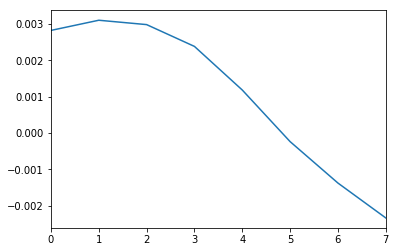

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.19x.dat


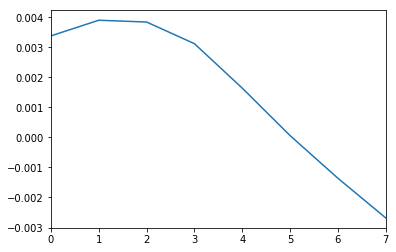

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.192x.dat


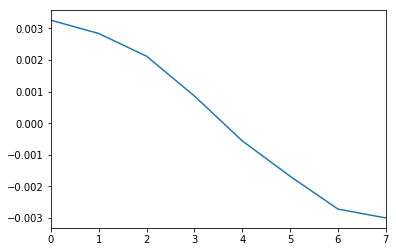

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.192x.dat


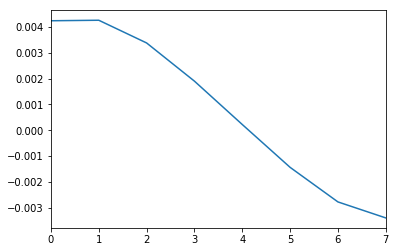

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.194x.dat


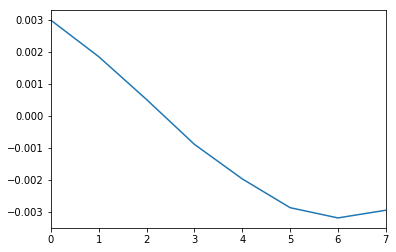

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.194x.dat


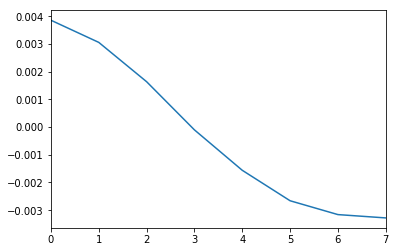

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.196x.dat


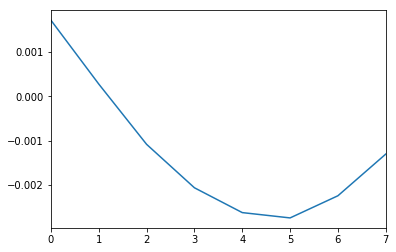

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.196x.dat


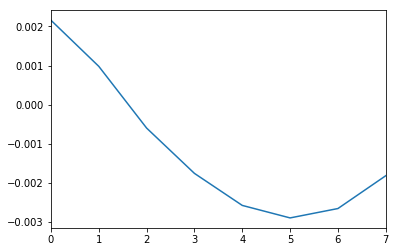

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.198x.dat


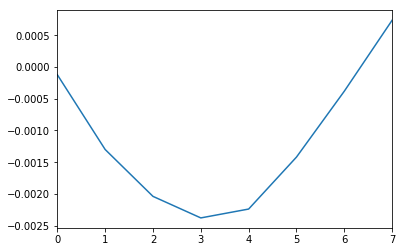

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.198x.dat


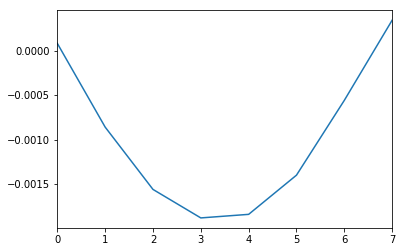

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0.218x.dat


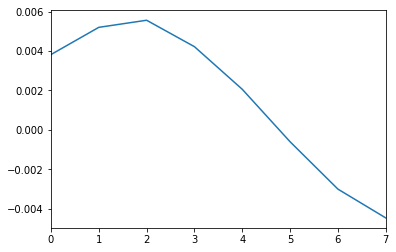

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.2x.dat


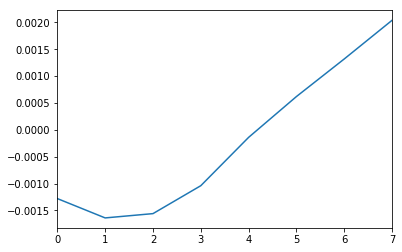

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.2x.dat


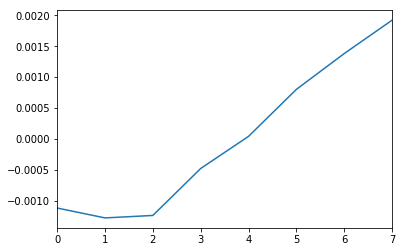

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.202x.dat


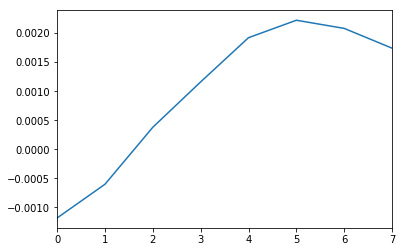

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.202x.dat


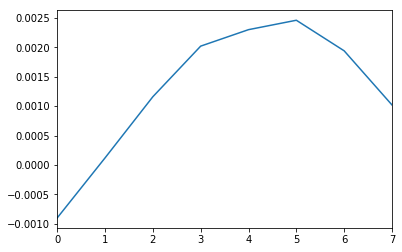

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.204x.dat


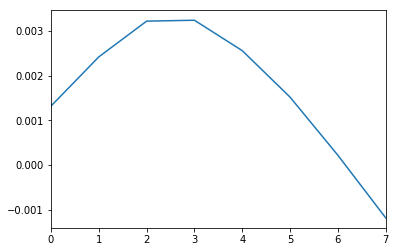

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.204x.dat


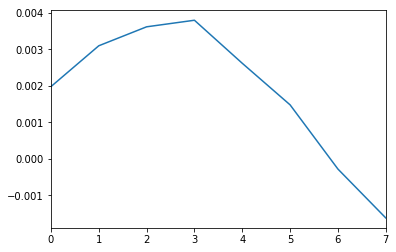

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.206x.dat


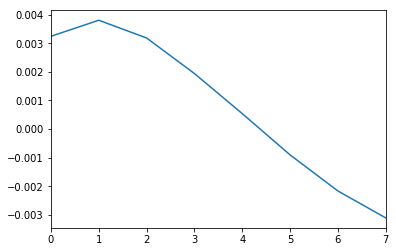

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.206x.dat


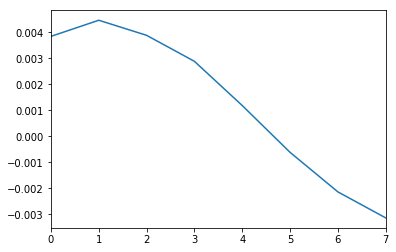

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.208x.dat


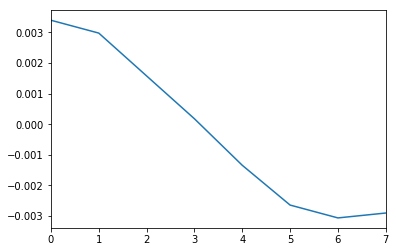

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.208x.dat


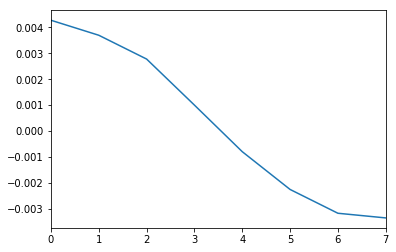

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.218x.dat


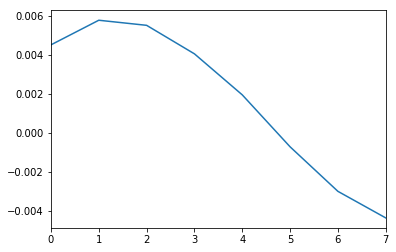

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.21x.dat


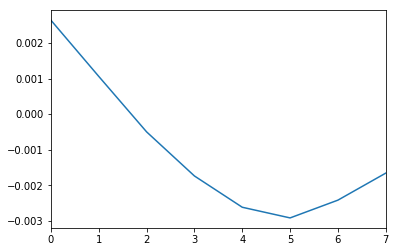

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.21x.dat


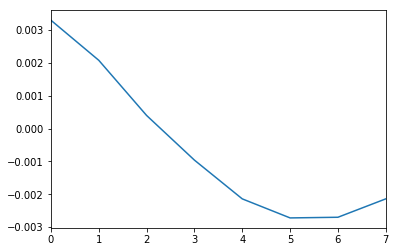

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.212x.dat


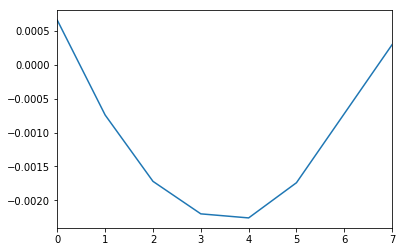

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.212x.dat


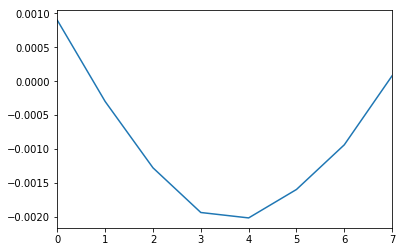

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.214x.dat


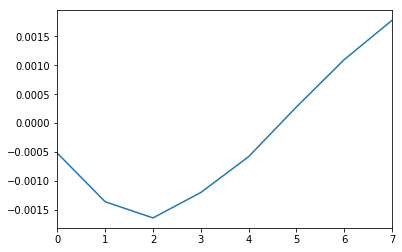

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.214x.dat


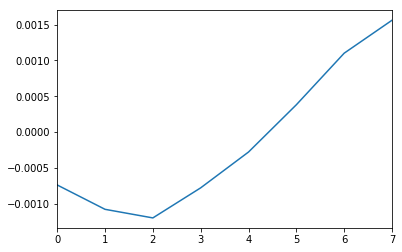

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.216x.dat


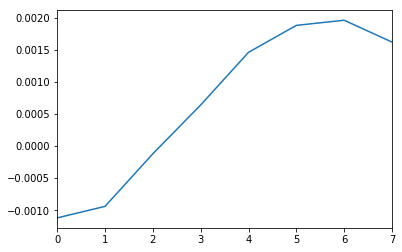

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.216x.dat


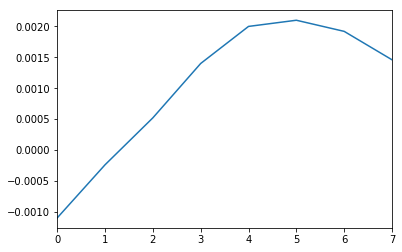

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.218x.dat


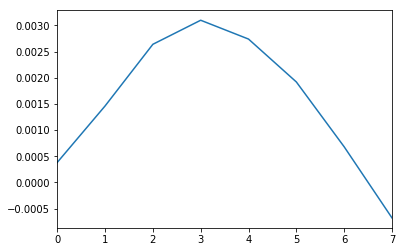

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.218x.dat


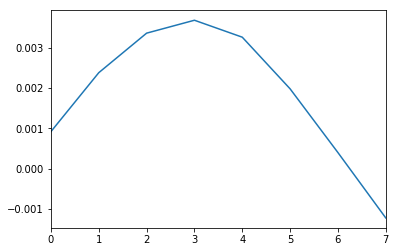

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.216x.dat


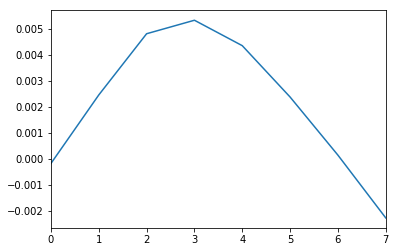

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.22x.dat


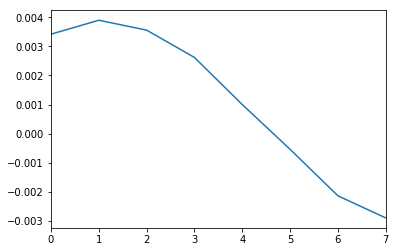

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.22x.dat


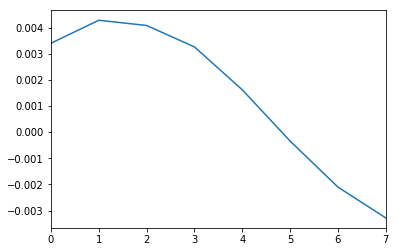

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.222x.dat


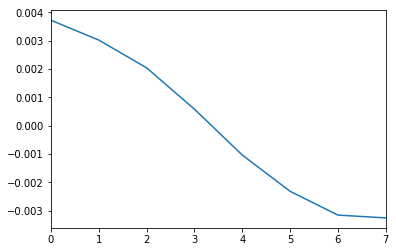

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.222x.dat


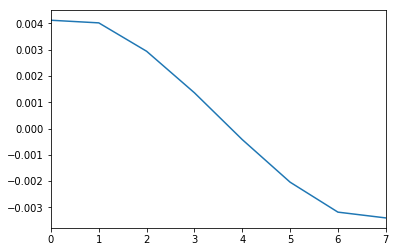

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.224x.dat


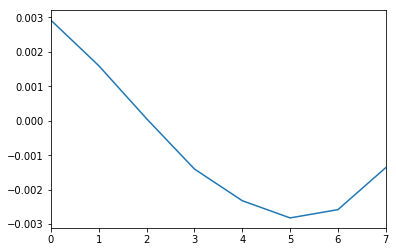

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.224x.dat


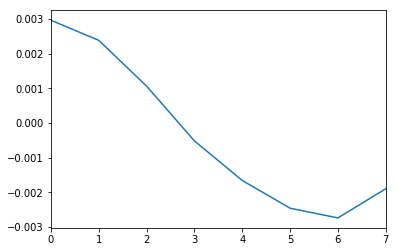

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.226x.dat


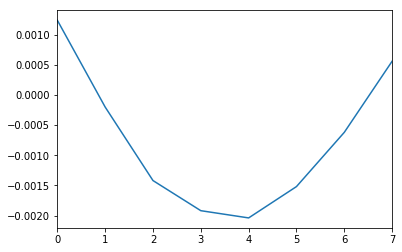

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.226x.dat


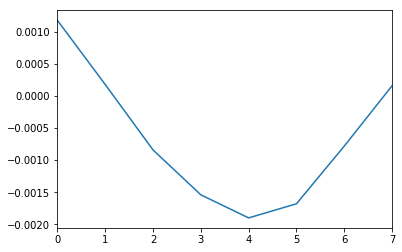

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.228x.dat


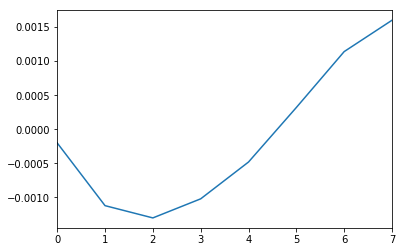

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


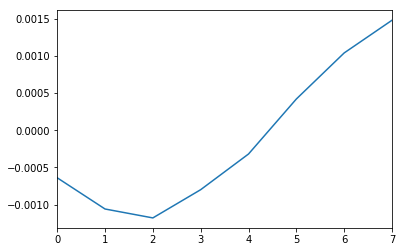

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.216x.dat


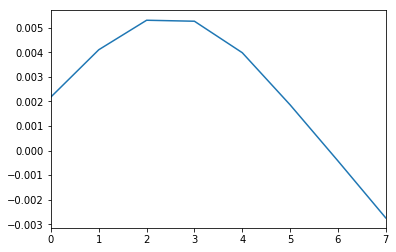

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.23x.dat


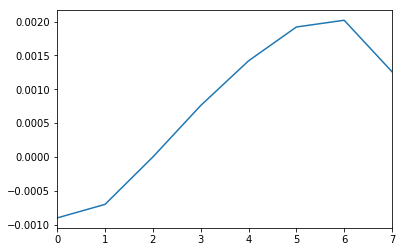

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.23x.dat


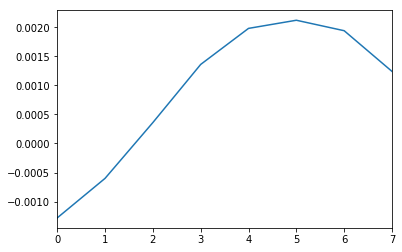

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.232x.dat


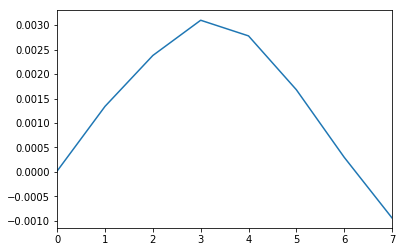

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.232x.dat


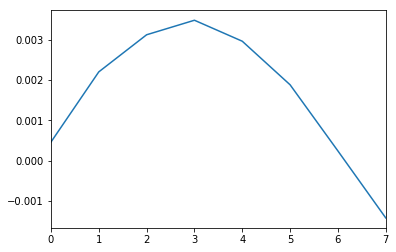

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.234x.dat


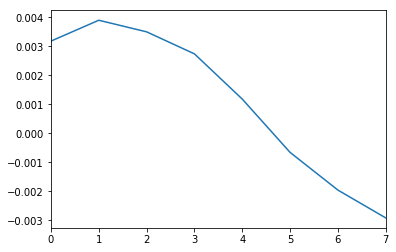

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.234x.dat


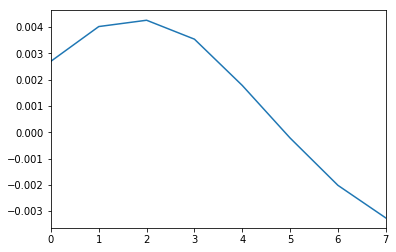

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.236x.dat


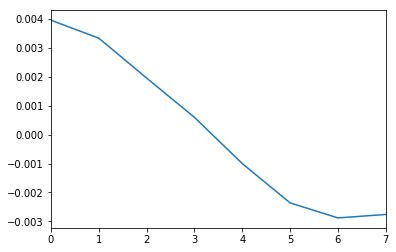

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.236x.dat


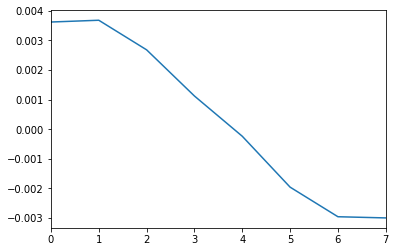

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.238x.dat


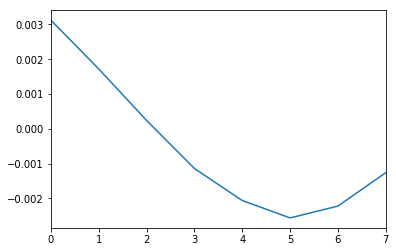

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.238x.dat


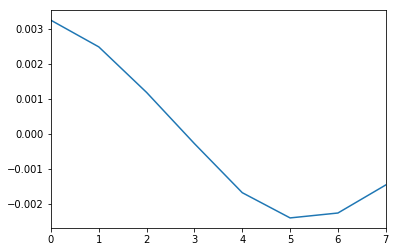

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.214x.dat


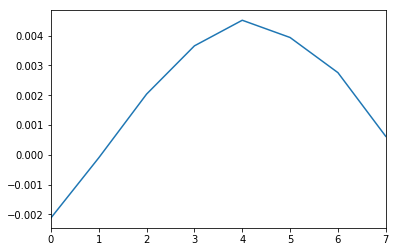

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.24x.dat


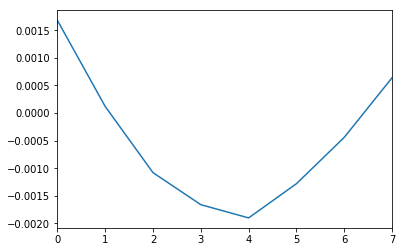

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.24x.dat


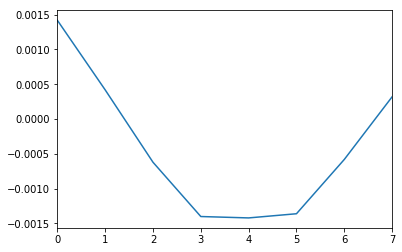

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.242x.dat


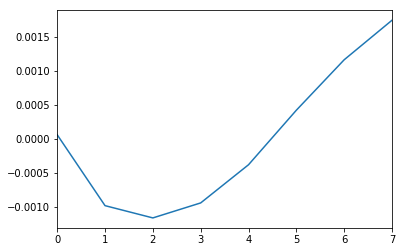

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.242x.dat


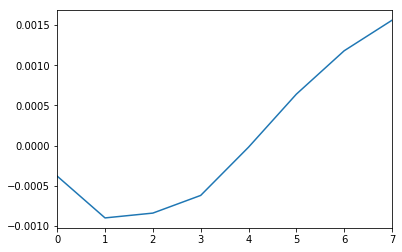

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.244x.dat


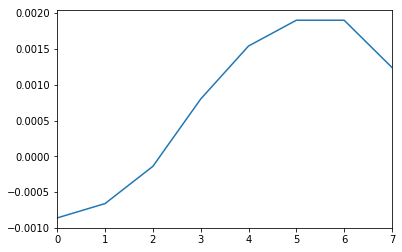

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.244x.dat


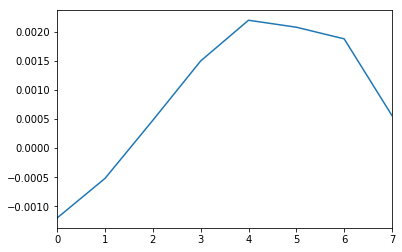

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.246x.dat


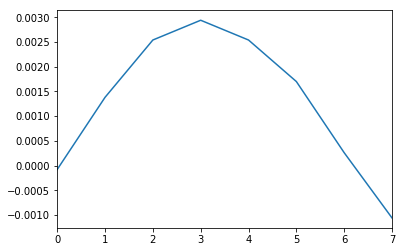

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.246x.dat


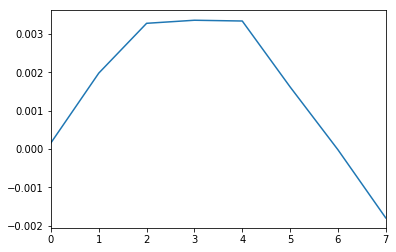

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.248x.dat


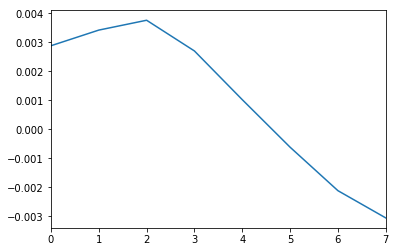

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.248x.dat


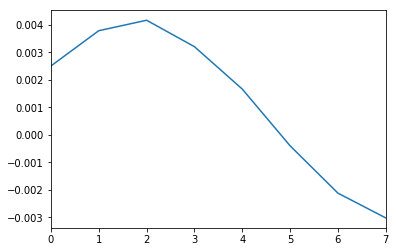

C:\Data\apr2017\170409\TestPhaseShift2_2600uWpump_TRKR_wide_2repeats___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.214x.dat


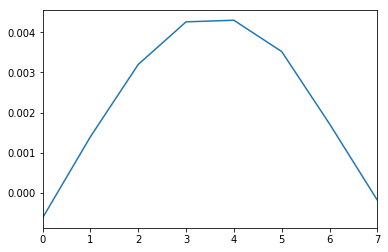

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


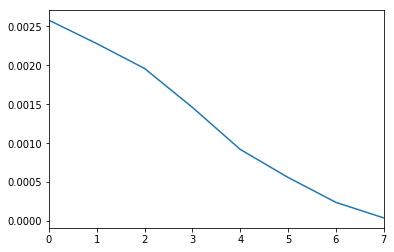

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


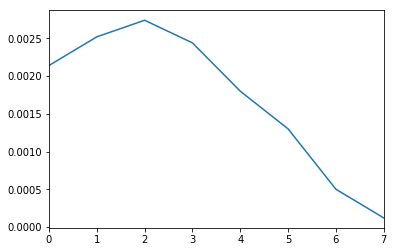

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


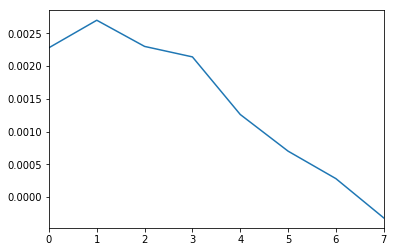

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


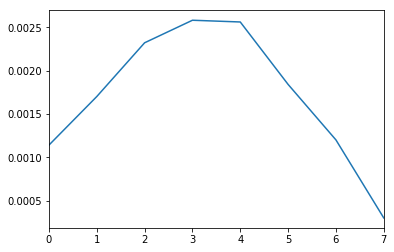

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


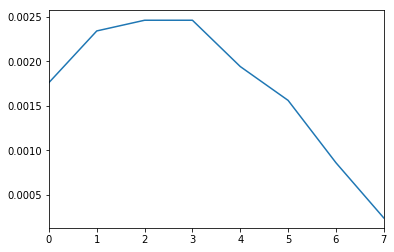

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


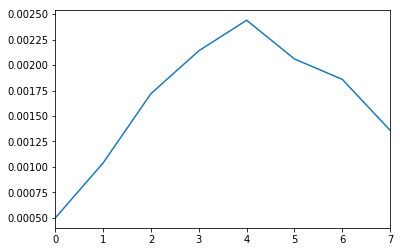

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


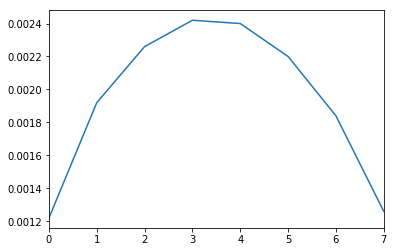

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


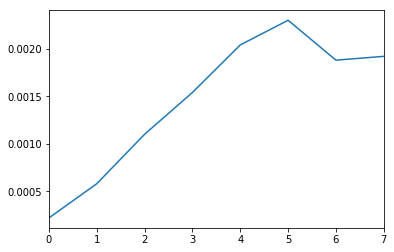

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


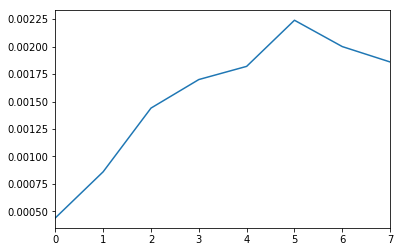

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


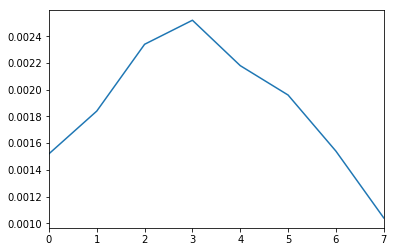

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


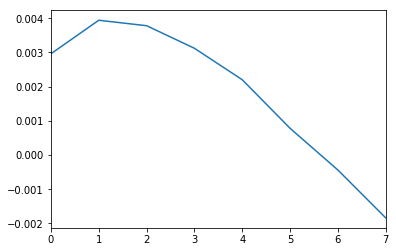

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


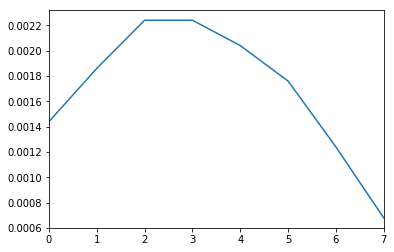

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


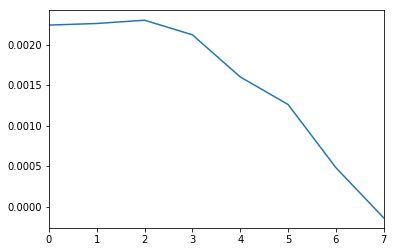

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


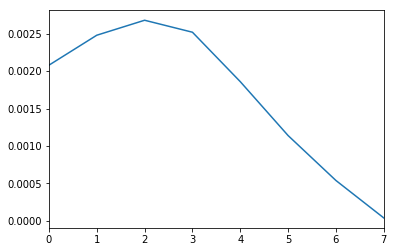

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


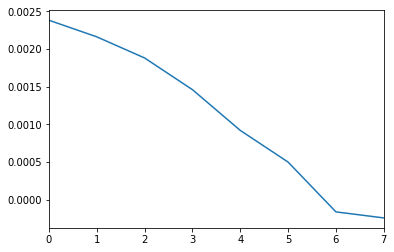

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


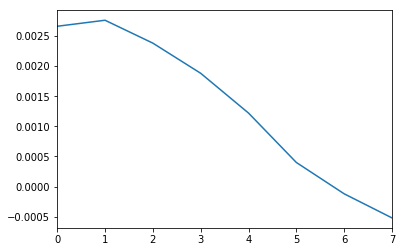

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


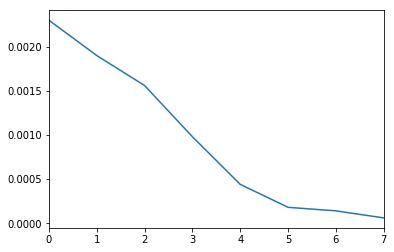

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


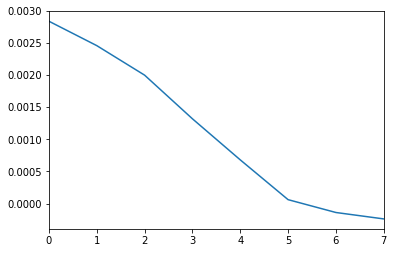

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


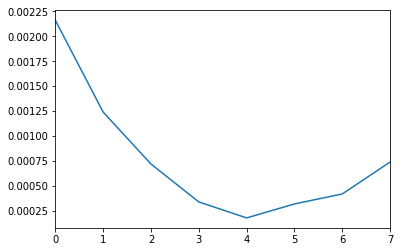

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


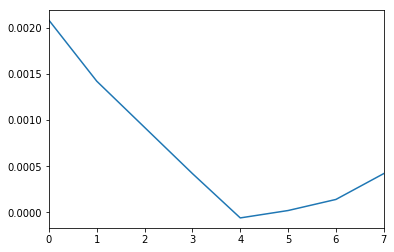

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


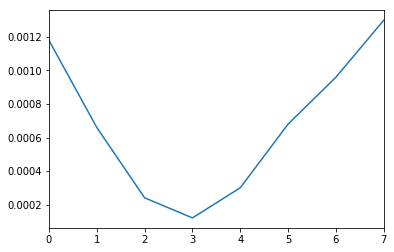

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


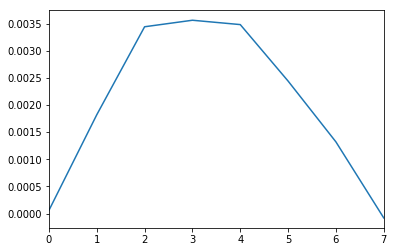

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


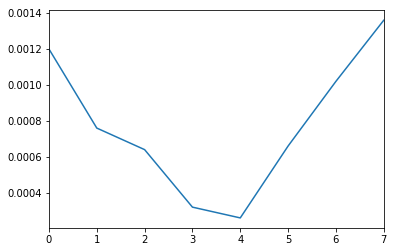

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


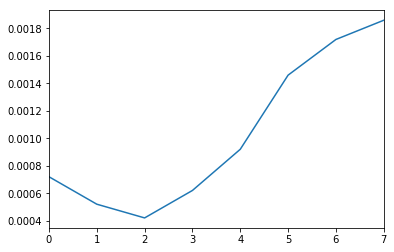

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


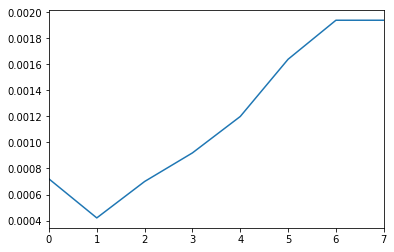

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


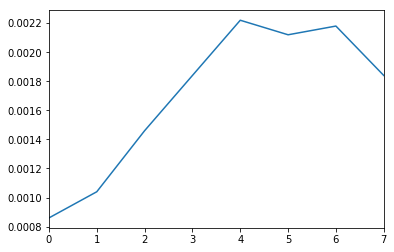

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


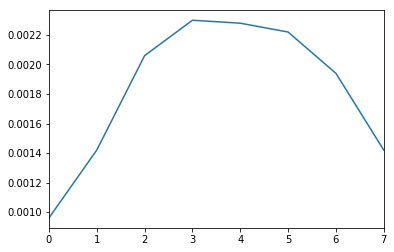

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


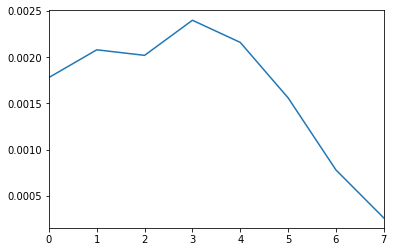

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


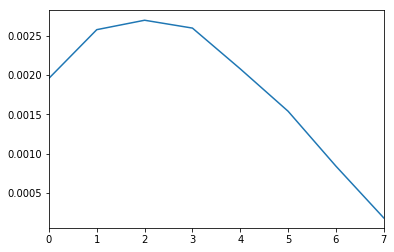

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


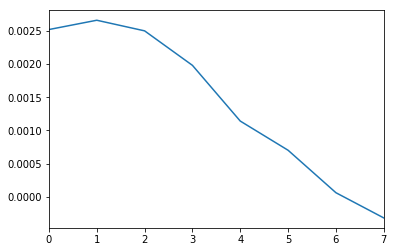

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


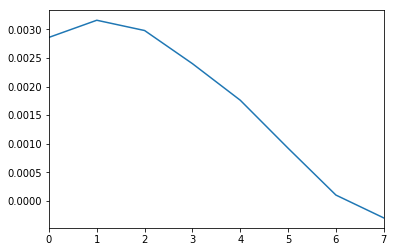

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


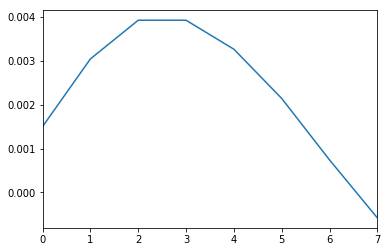

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


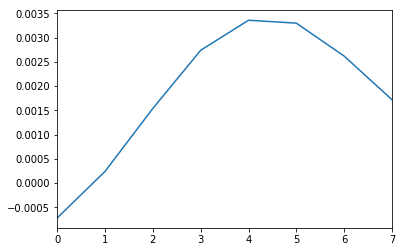

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


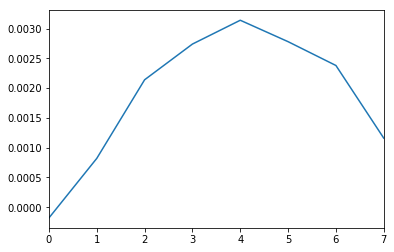

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


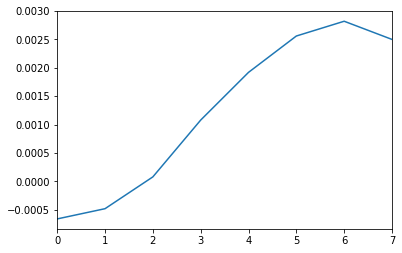

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


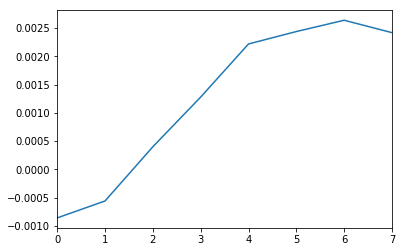

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


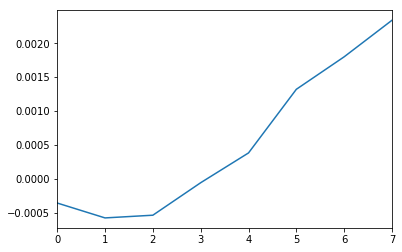

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


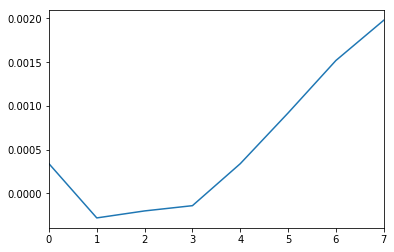

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


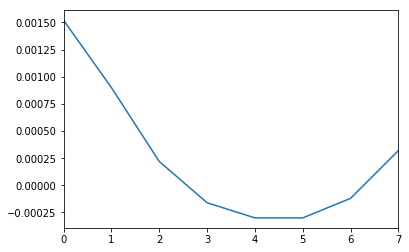

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


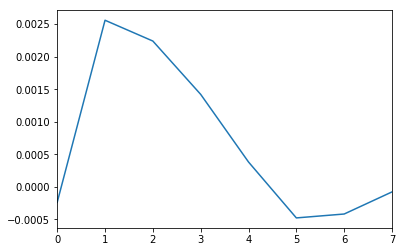

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


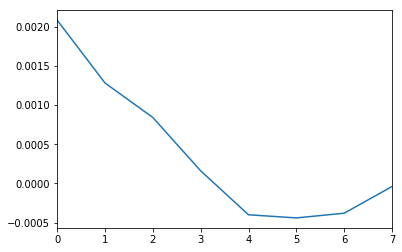

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


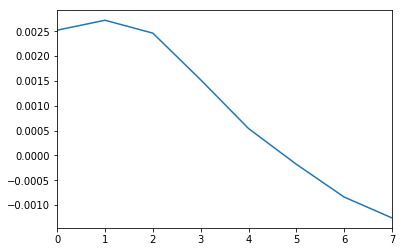

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


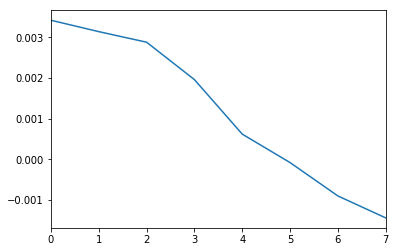

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


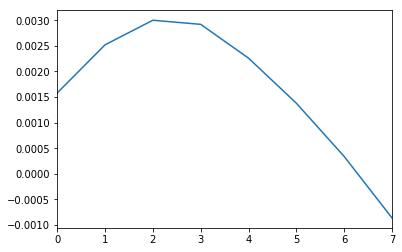

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


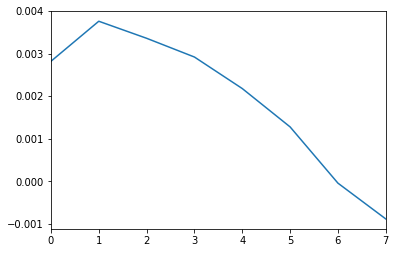

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


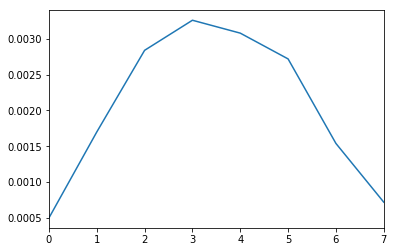

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


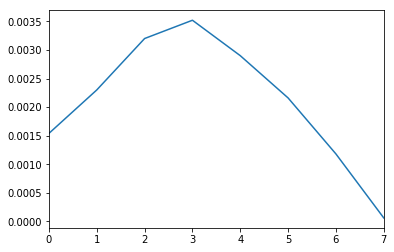

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


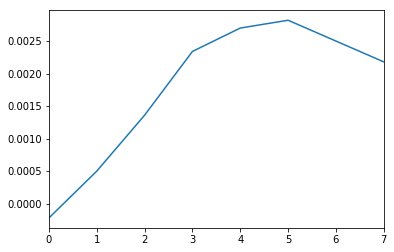

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


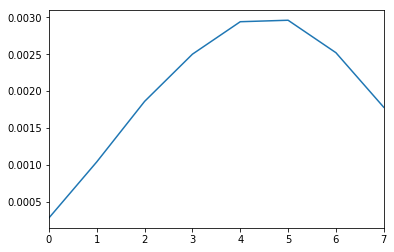

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


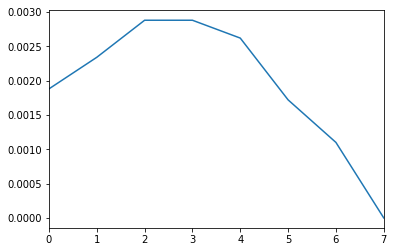

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


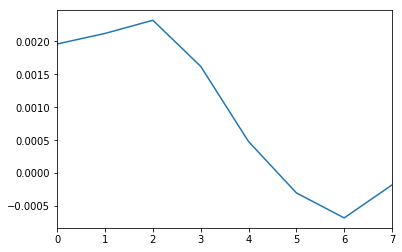

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


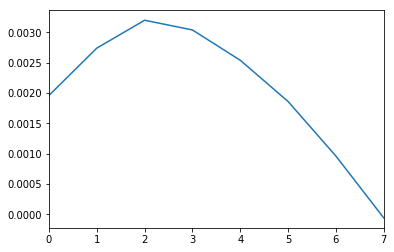

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


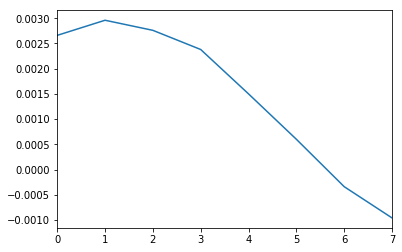

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


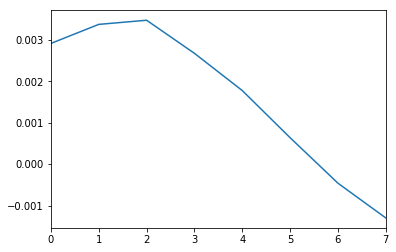

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


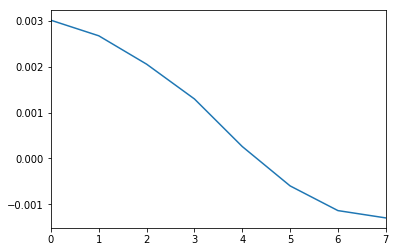

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


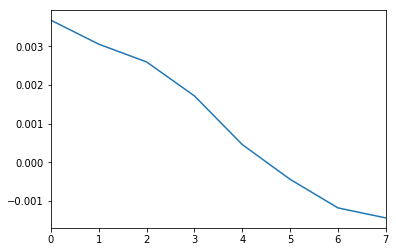

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


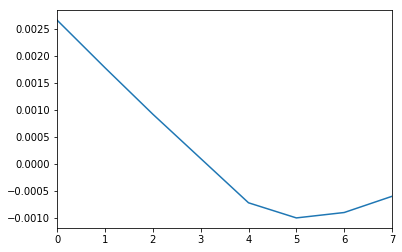

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


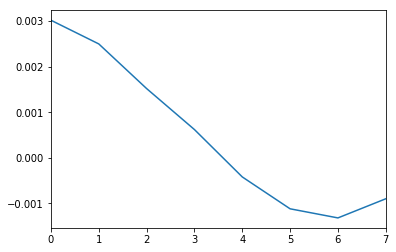

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


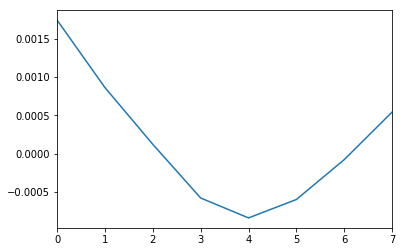

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


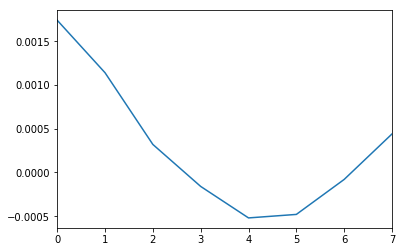

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


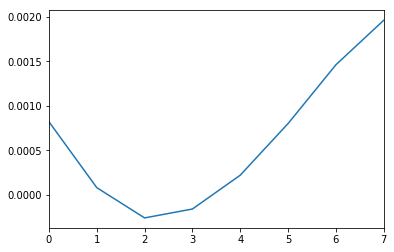

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


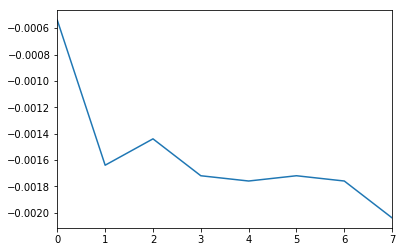

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


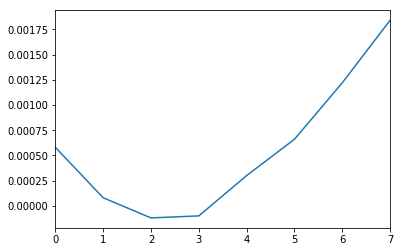

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


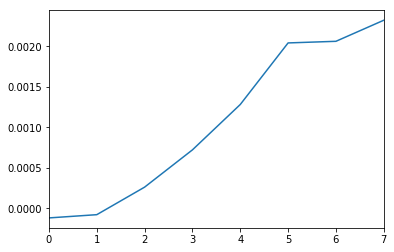

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


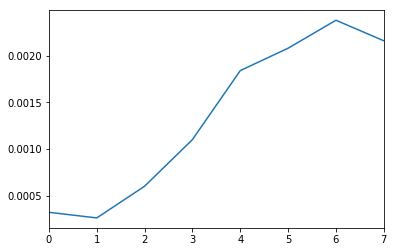

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


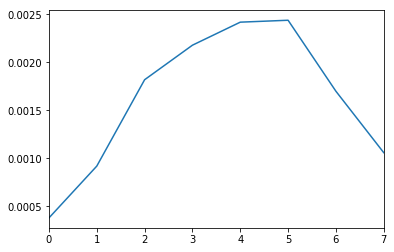

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


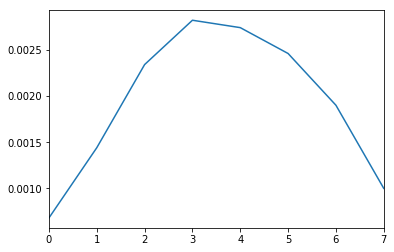

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


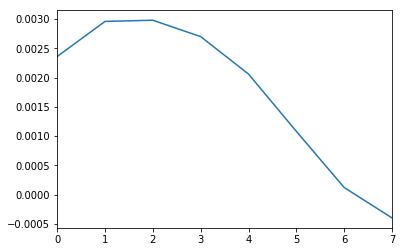

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


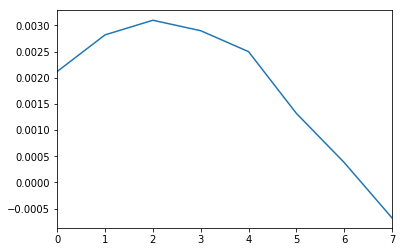

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


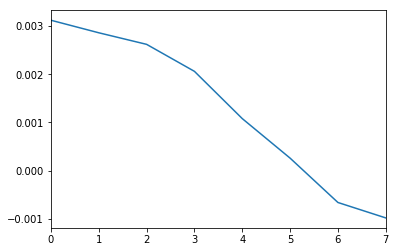

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


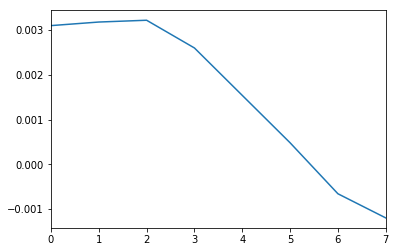

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


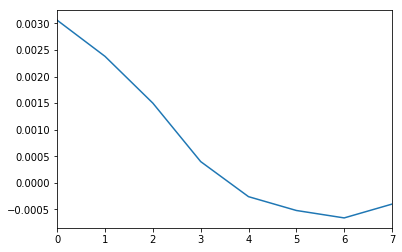

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


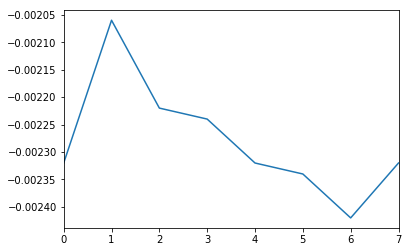

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


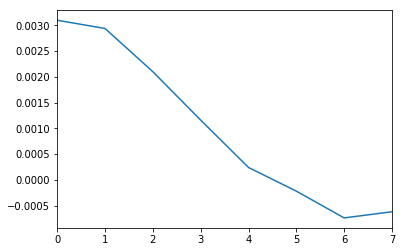

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


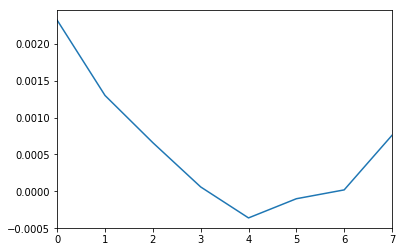

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


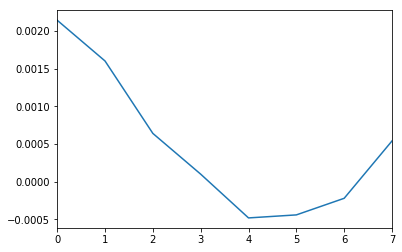

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


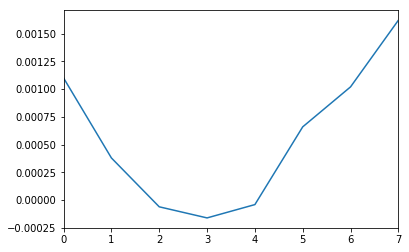

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


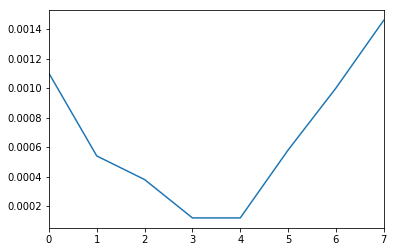

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


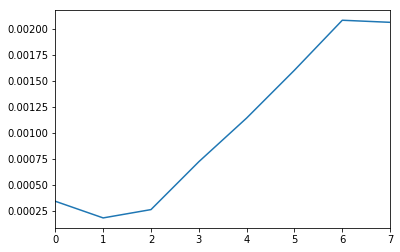

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


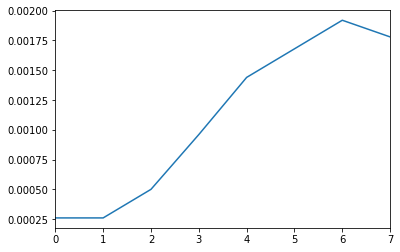

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


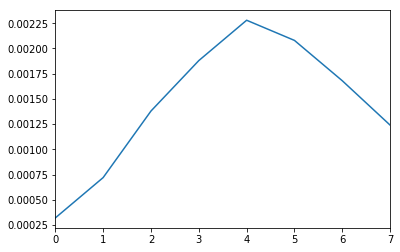

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


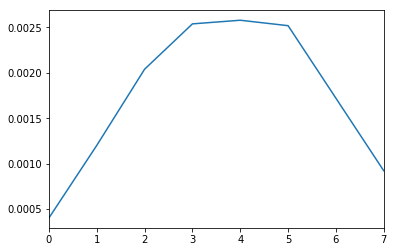

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


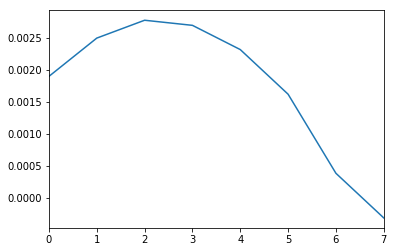

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


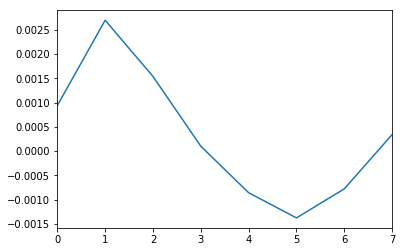

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


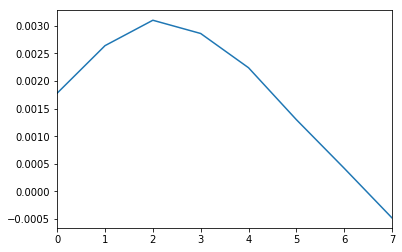

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


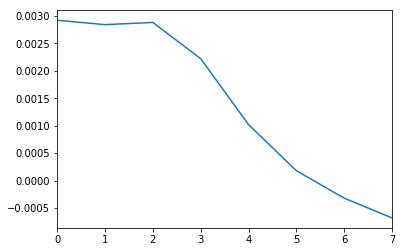

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


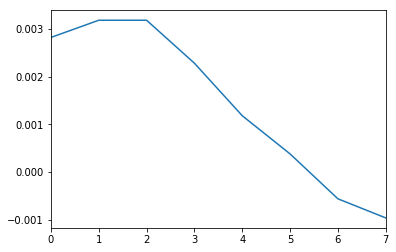

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


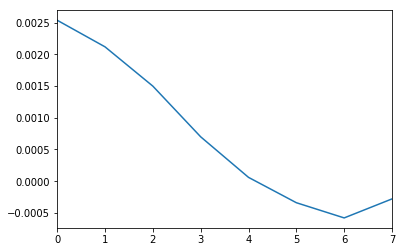

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


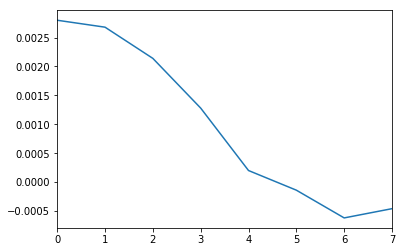

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


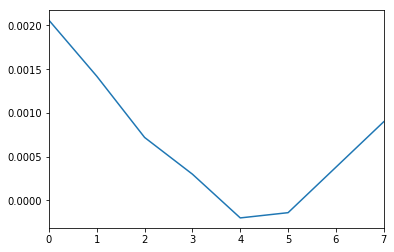

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


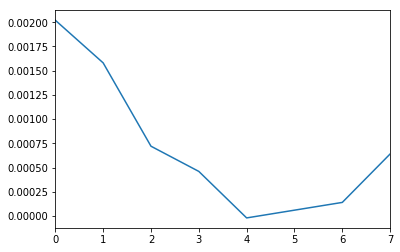

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


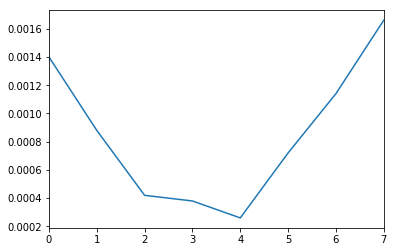

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


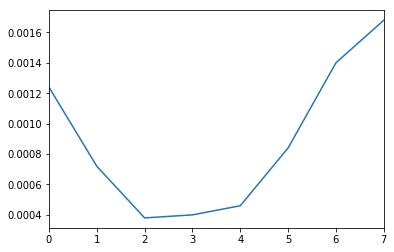

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


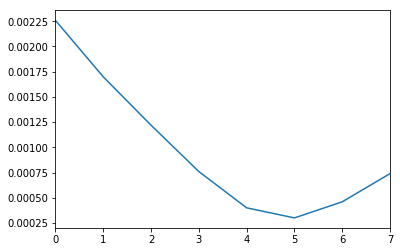

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


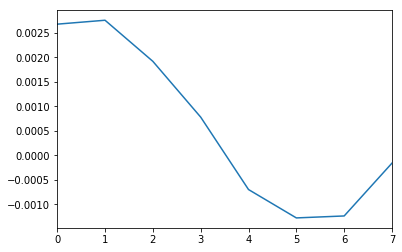

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


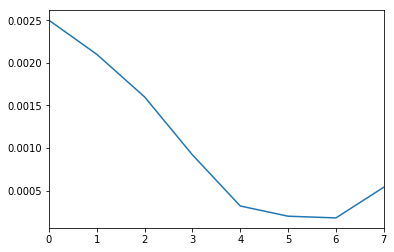

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


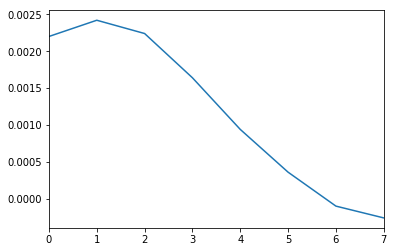

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


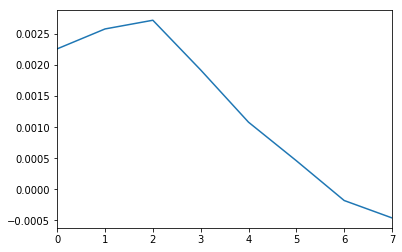

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


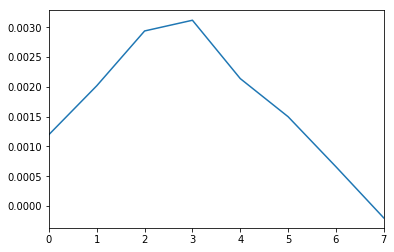

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


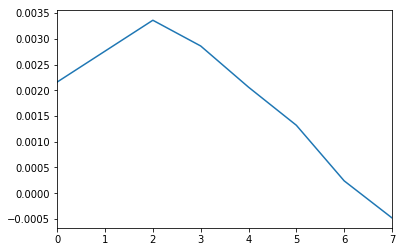

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


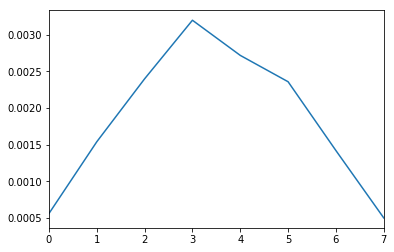

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


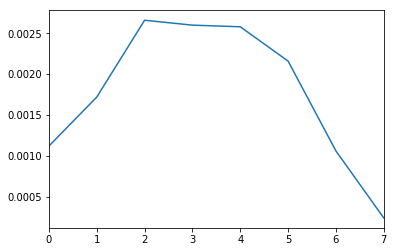

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


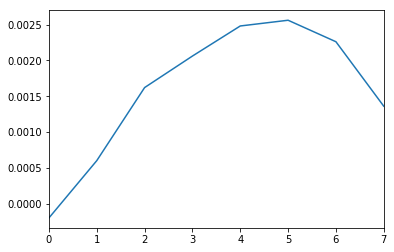

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


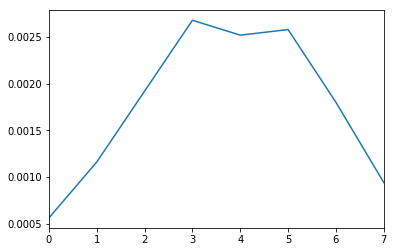

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


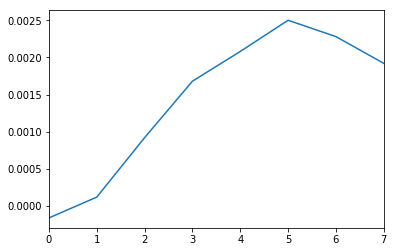

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


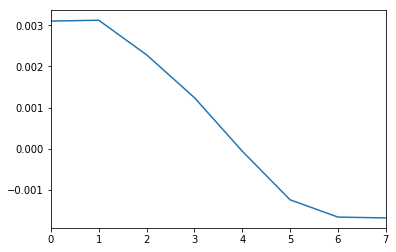

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


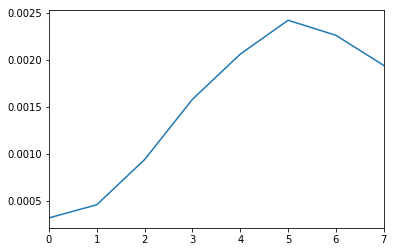

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


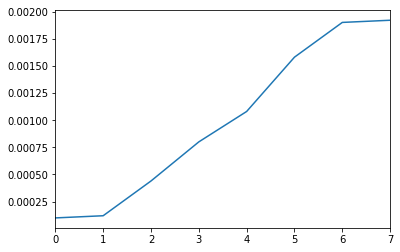

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


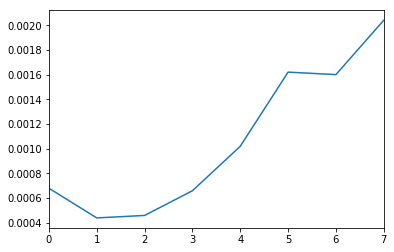

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


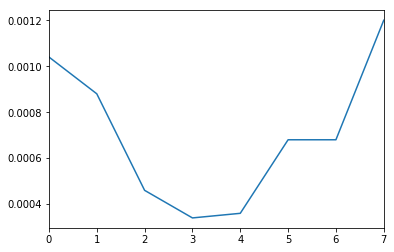

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


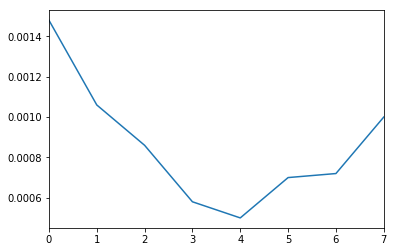

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


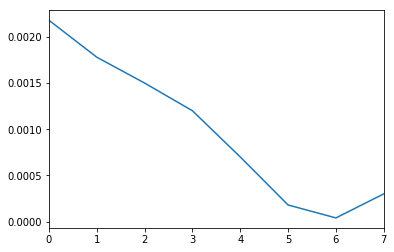

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


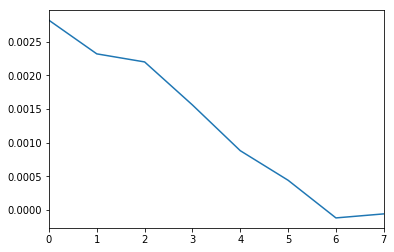

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


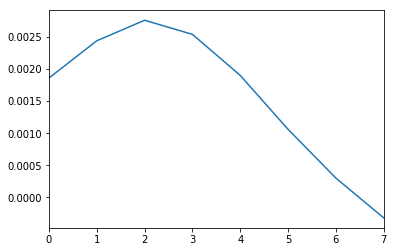

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


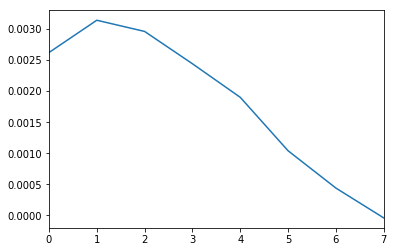

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


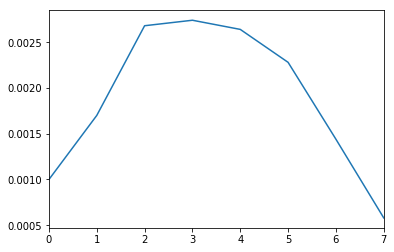

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


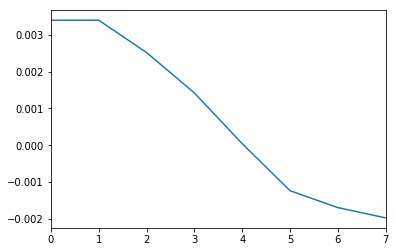

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


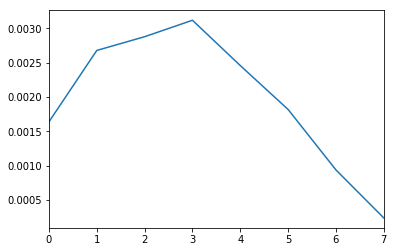

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


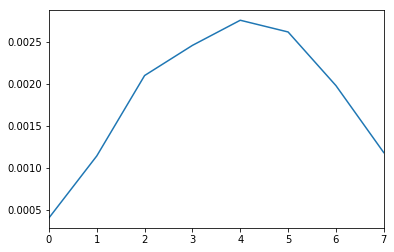

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


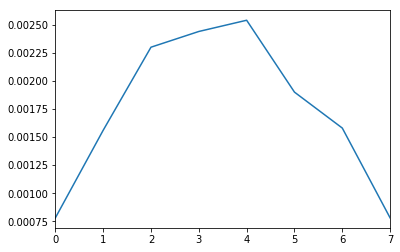

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


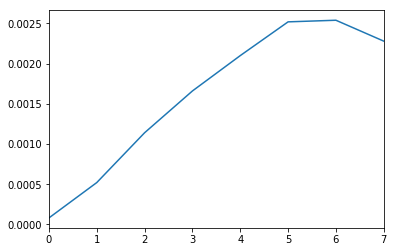

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


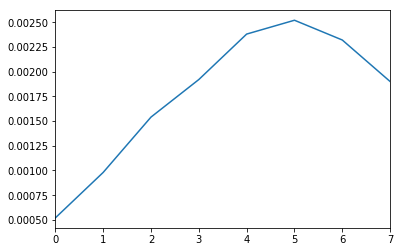

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


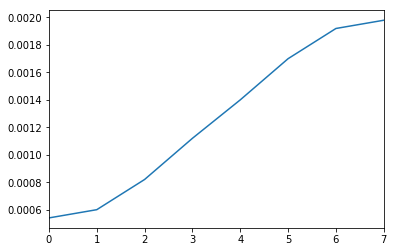

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


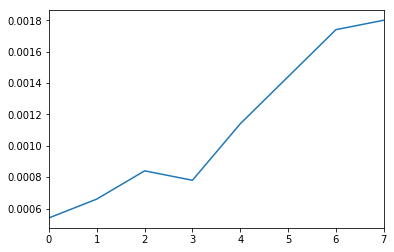

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


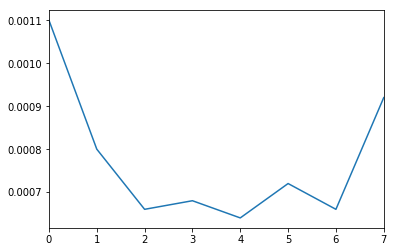

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


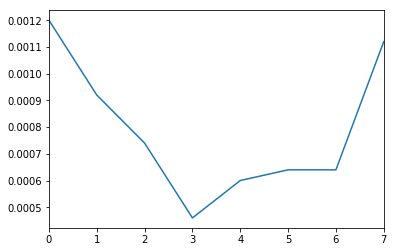

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


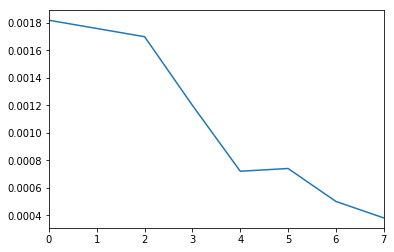

C:\Data\apr2017\170409\TestPhaseShift2_3100uWpump_TRKR___818.58nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


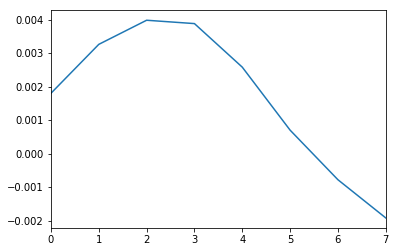

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -480_to_-60 BExternal 0.208x.dat


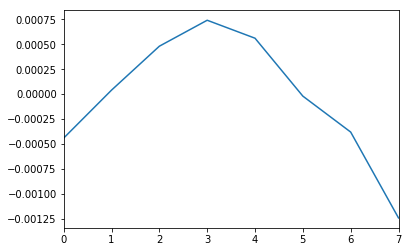

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -480_to_-60 BExternal 0.206x.dat


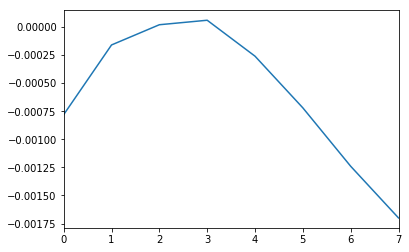

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -480_to_-60 BExternal 0.206x.dat


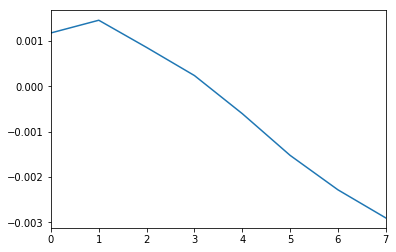

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -480_to_-60 BExternal 0.204x.dat


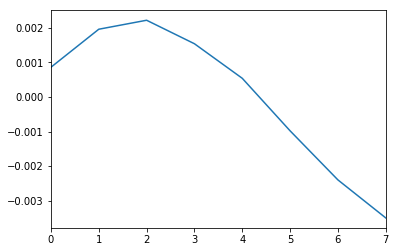

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -480_to_-60 BExternal 0.204x.dat


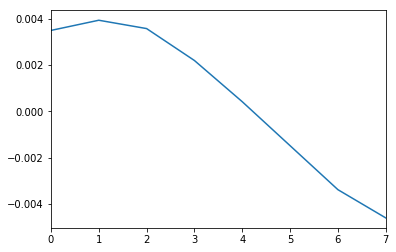

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -480_to_-60 BExternal 0.202x.dat


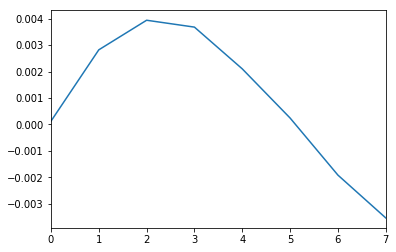

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -480_to_-60 BExternal 0.202x.dat


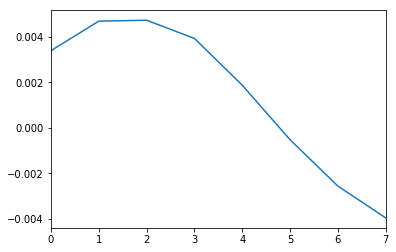

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -480_to_-60 BExternal 0.2x.dat


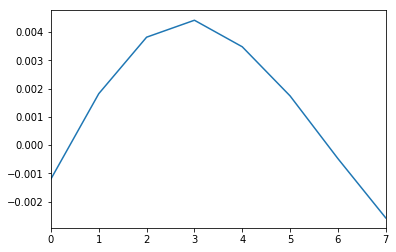

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -480_to_-60 BExternal 0.2x.dat


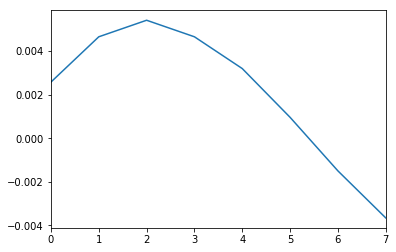

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -480_to_-60 BExternal 0.202x.dat


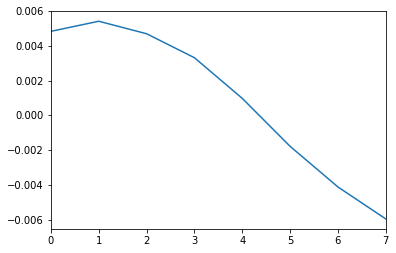

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -480_to_-60 BExternal 0.218x.dat


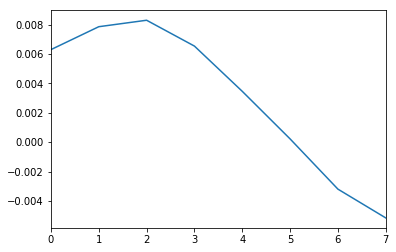

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -480_to_-60 BExternal 0.202x.dat


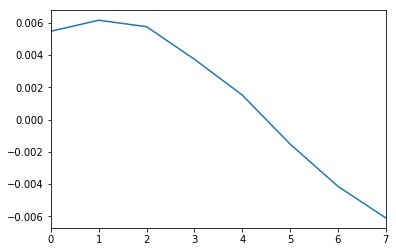

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -480_to_-60 BExternal 0.204x.dat


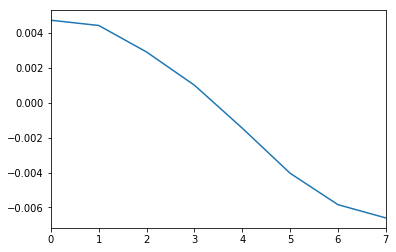

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -480_to_-60 BExternal 0.204x.dat


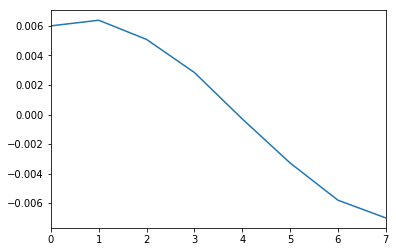

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -480_to_-60 BExternal 0.206x.dat


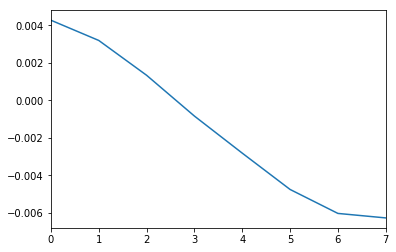

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -480_to_-60 BExternal 0.206x.dat


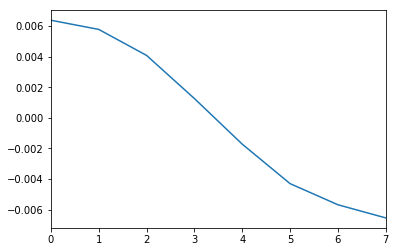

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -480_to_-60 BExternal 0.208x.dat


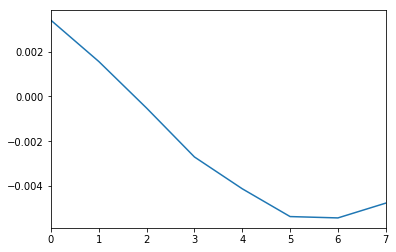

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -480_to_-60 BExternal 0.208x.dat


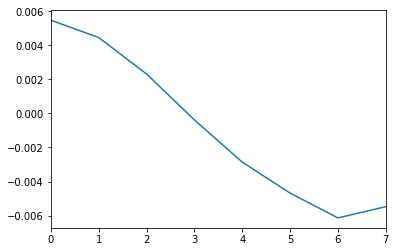

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -480_to_-60 BExternal 0.21x.dat


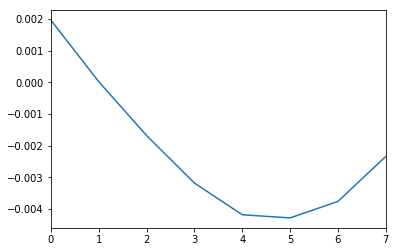

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -480_to_-60 BExternal 0.21x.dat


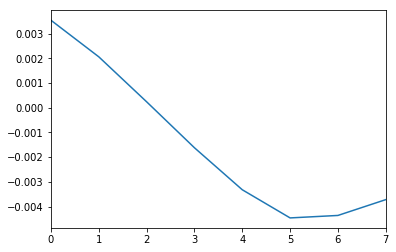

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -480_to_-60 BExternal 0.212x.dat


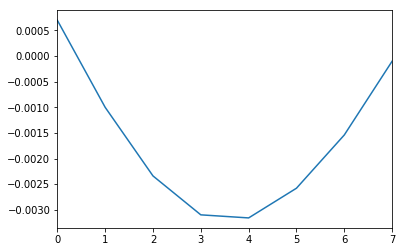

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -480_to_-60 BExternal 0.216x.dat


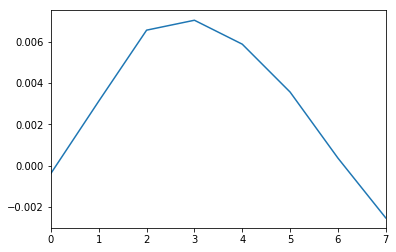

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -480_to_-60 BExternal 0.212x.dat


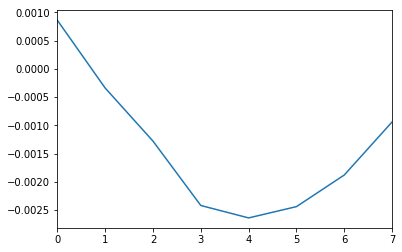

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -480_to_-60 BExternal 0.214x.dat


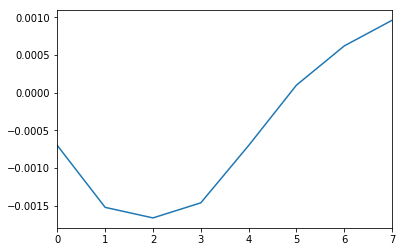

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -480_to_-60 BExternal 0.214x.dat


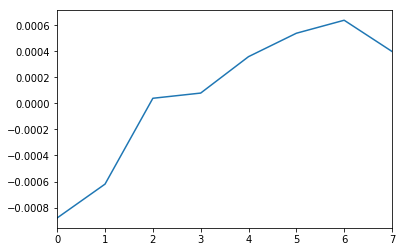

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -480_to_-60 BExternal 0.216x.dat


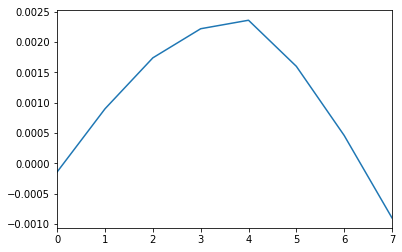

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -480_to_-60 BExternal 0.216x.dat


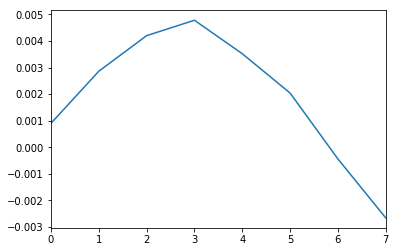

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -480_to_-60 BExternal 0.218x.dat


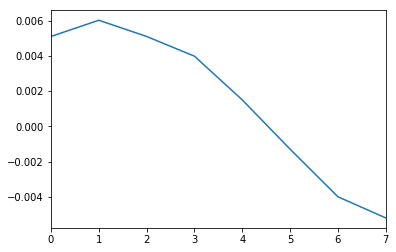

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -480_to_-60 BExternal 0.218x.dat


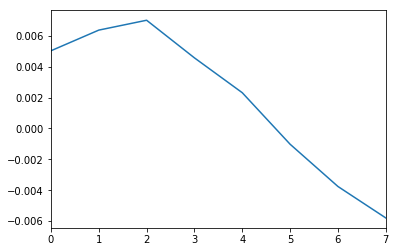

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -480_to_-60 BExternal 0.22x.dat


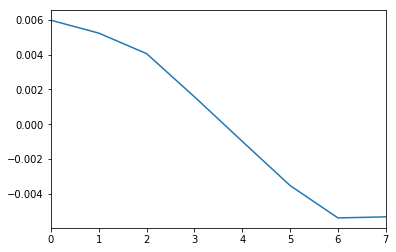

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -480_to_-60 BExternal 0.22x.dat


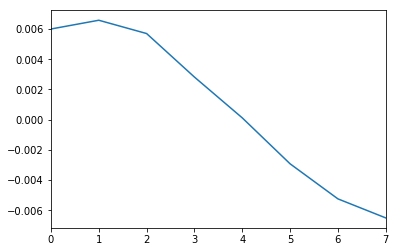

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -480_to_-60 BExternal 0.216x.dat


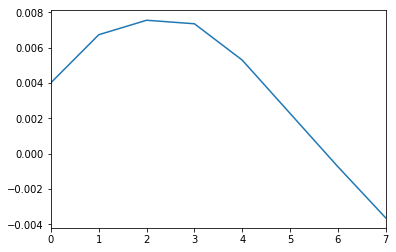

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -480_to_-60 BExternal 0.214x.dat


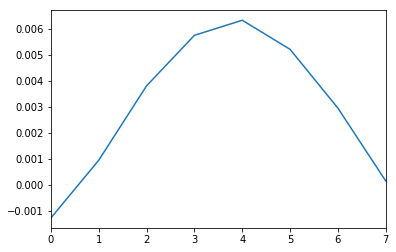

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -480_to_-60 BExternal 0.214x.dat


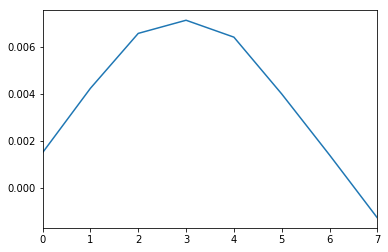

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -480_to_-60 BExternal 0.212x.dat


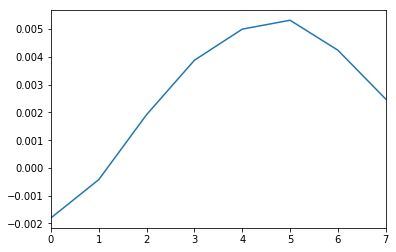

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -480_to_-60 BExternal 0.212x.dat


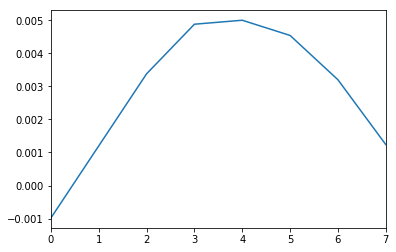

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -480_to_-60 BExternal 0.21x.dat


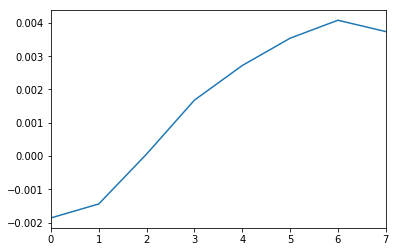

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -480_to_-60 BExternal 0.21x.dat


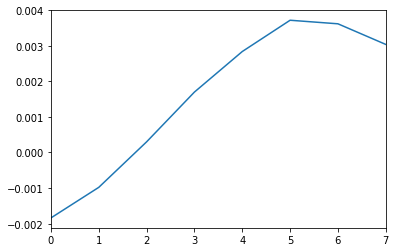

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -480_to_-60 BExternal 0.208x.dat


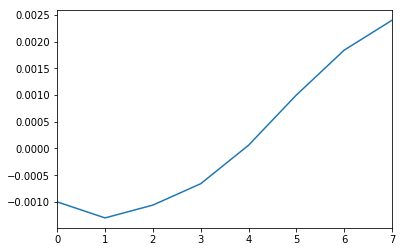

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -480_to_-60 BExternal -0.3x.dat


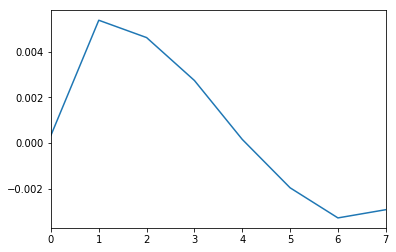

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -480_to_-60 BExternal 0.208x.dat


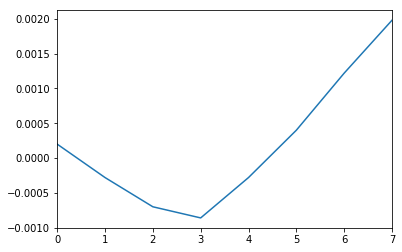

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -480_to_-60 BExternal 0.206x.dat


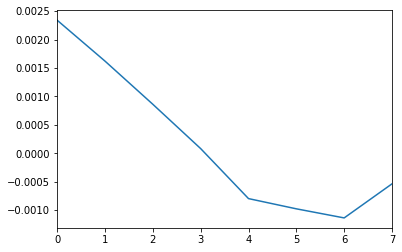

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -480_to_-60 BExternal 0.206x.dat


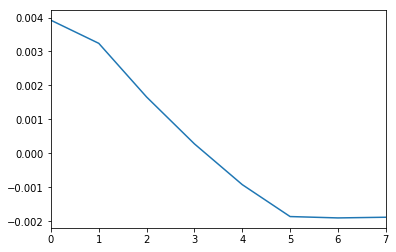

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -480_to_-60 BExternal 0.204x.dat


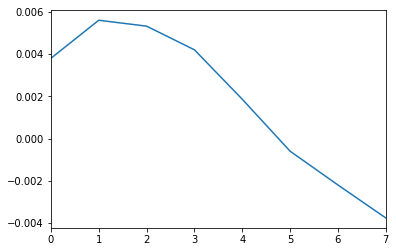

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -480_to_-60 BExternal 0.204x.dat


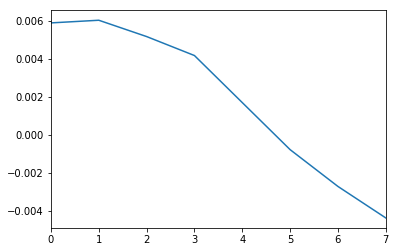

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -480_to_-60 BExternal 0.202x.dat


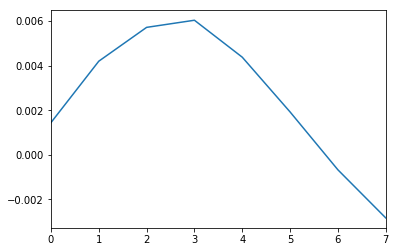

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -480_to_-60 BExternal 0.202x.dat


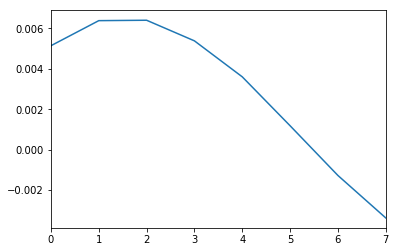

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -480_to_-60 BExternal 0.2x.dat


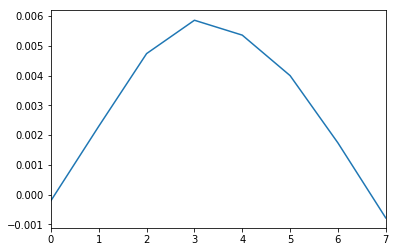

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -480_to_-60 BExternal 0.2x.dat


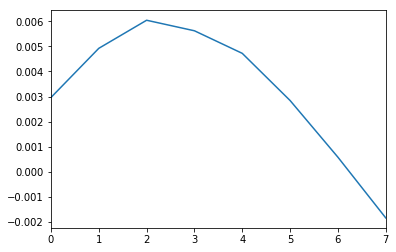

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -480_to_-60 BExternal 0.202x.dat


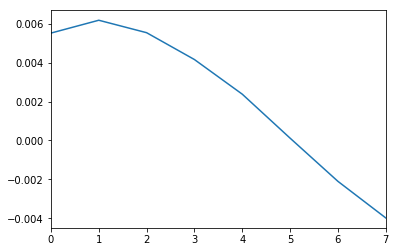

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -480_to_-60 BExternal -0.3x.dat


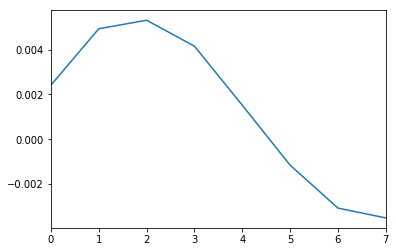

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -480_to_-60 BExternal 0.202x.dat


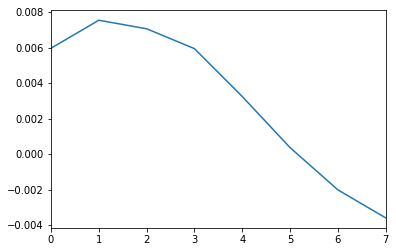

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -480_to_-60 BExternal 0.204x.dat


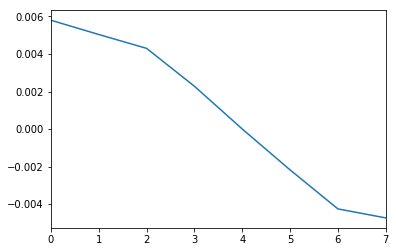

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -480_to_-60 BExternal 0.204x.dat


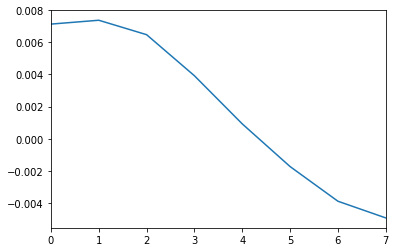

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -480_to_-60 BExternal 0.206x.dat


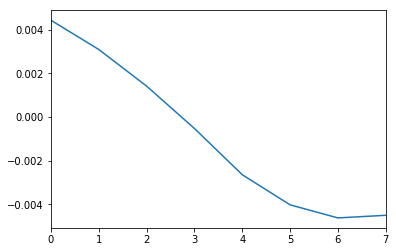

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -480_to_-60 BExternal 0.206x.dat


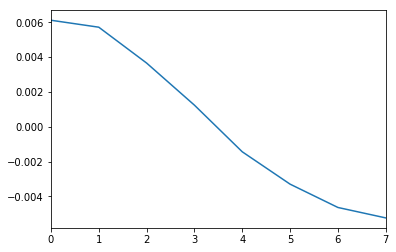

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -480_to_-60 BExternal 0.208x.dat


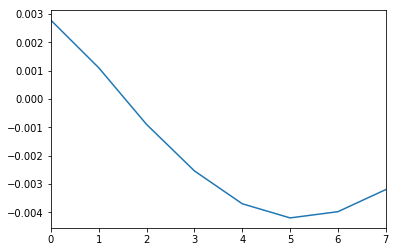

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -480_to_-60 BExternal 0.208x.dat


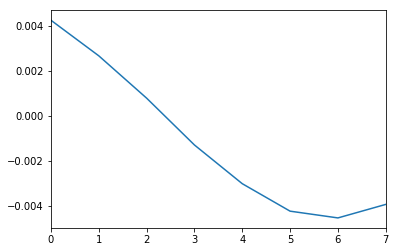

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -480_to_-60 BExternal 0.21x.dat


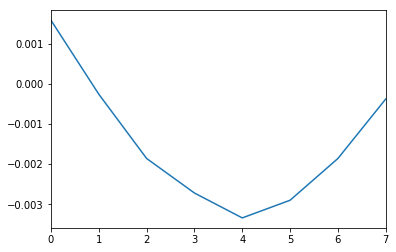

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -480_to_-60 BExternal 0.21x.dat


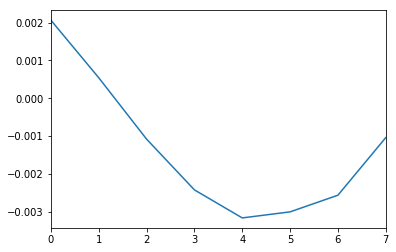

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -480_to_-60 BExternal 0.212x.dat


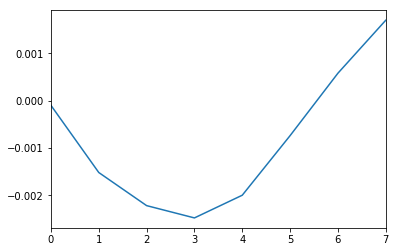

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -480_to_-60 BExternal 0x.dat


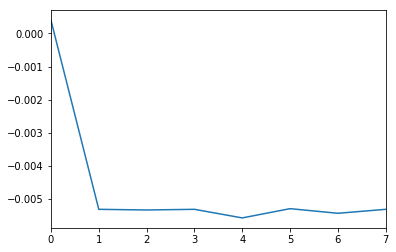

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -480_to_-60 BExternal 0.212x.dat


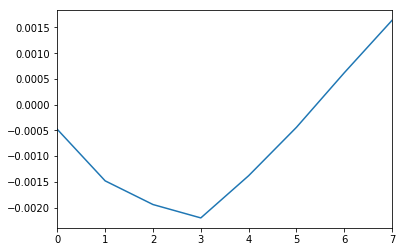

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -480_to_-60 BExternal 0.214x.dat


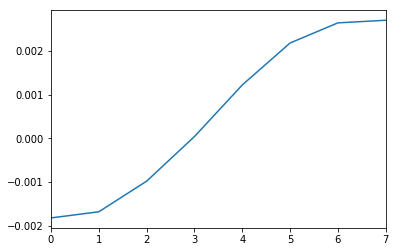

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -480_to_-60 BExternal 0.214x.dat


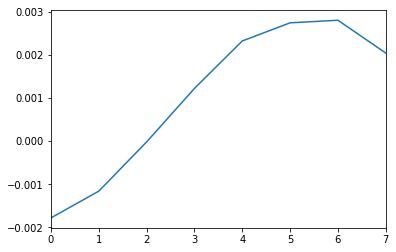

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -480_to_-60 BExternal 0.216x.dat


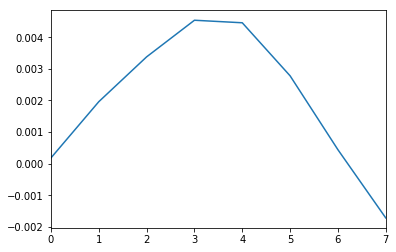

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -480_to_-60 BExternal 0.216x.dat


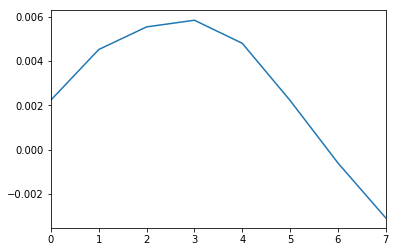

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -480_to_-60 BExternal 0.218x.dat


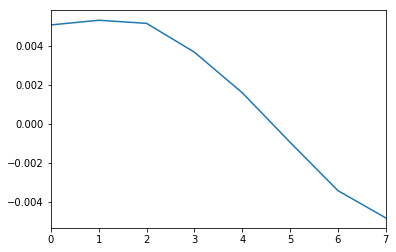

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -480_to_-60 BExternal 0.218x.dat


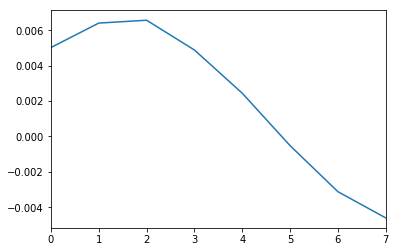

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -480_to_-60 BExternal 0.22x.dat


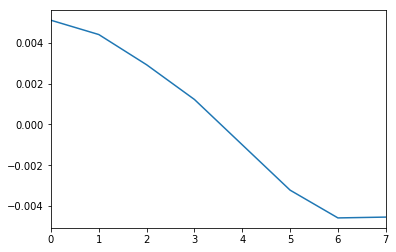

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -480_to_-60 BExternal 0.22x.dat


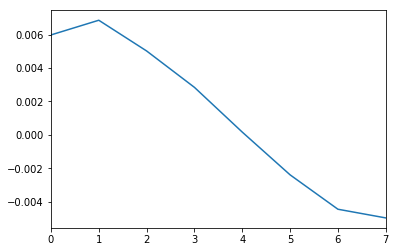

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -480_to_-60 BExternal 0.222x.dat


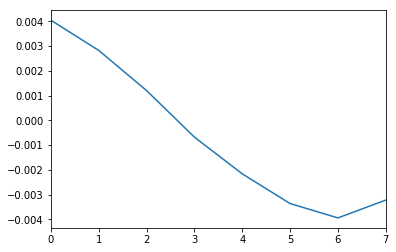

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -480_to_-60 BExternal 0x.dat


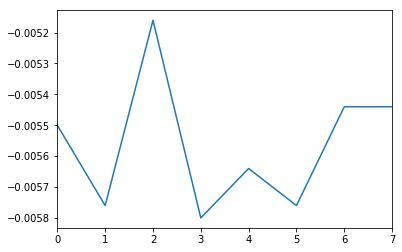

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -480_to_-60 BExternal 0.222x.dat


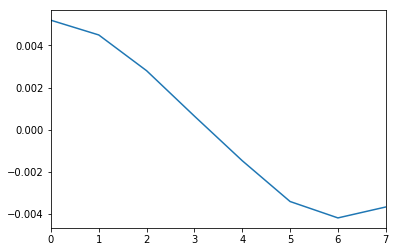

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -480_to_-60 BExternal 0.224x.dat


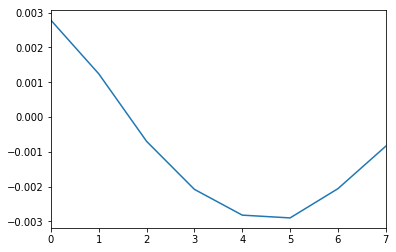

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -480_to_-60 BExternal 0.224x.dat


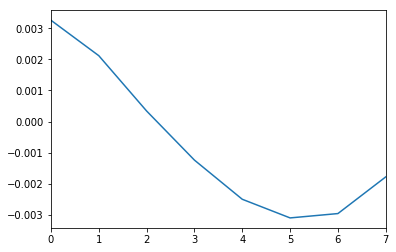

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -480_to_-60 BExternal 0.226x.dat


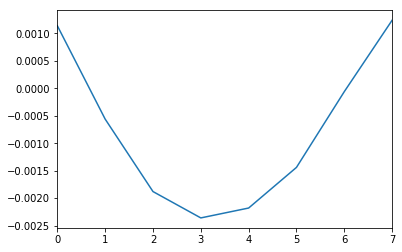

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -480_to_-60 BExternal 0.226x.dat


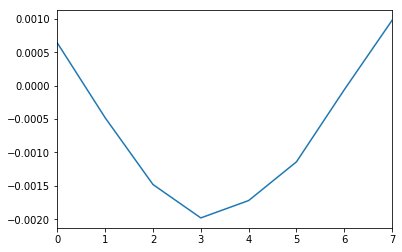

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -480_to_-60 BExternal 0.228x.dat


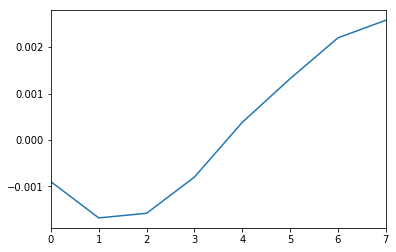

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -480_to_-60 BExternal 0.228x.dat


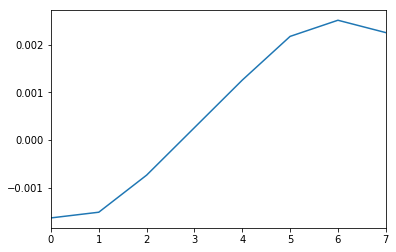

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -480_to_-60 BExternal 0.23x.dat


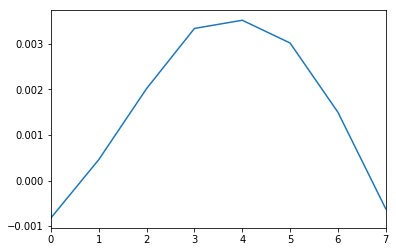

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -480_to_-60 BExternal 0.23x.dat


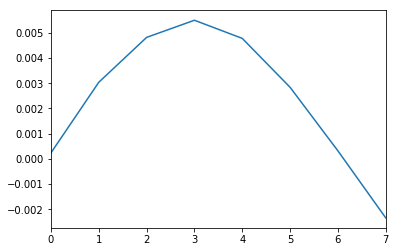

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -480_to_-60 BExternal 0.232x.dat


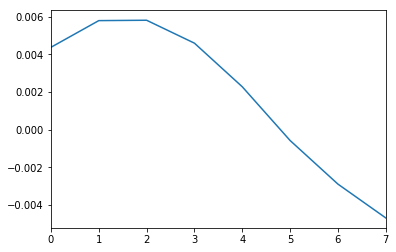

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -480_to_-60 BExternal 0.3x.dat


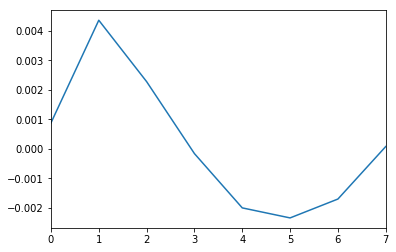

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -480_to_-60 BExternal 0.232x.dat


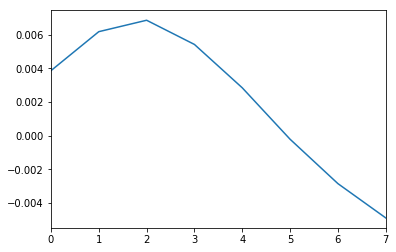

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -480_to_-60 BExternal 0.234x.dat


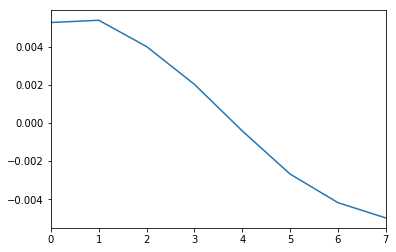

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -480_to_-60 BExternal 0.234x.dat


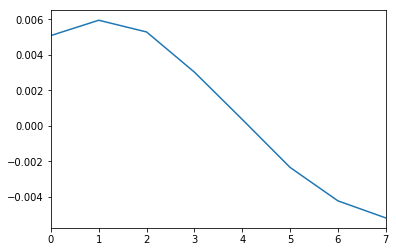

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -480_to_-60 BExternal 0.236x.dat


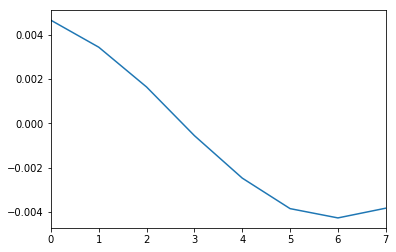

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -480_to_-60 BExternal 0.236x.dat


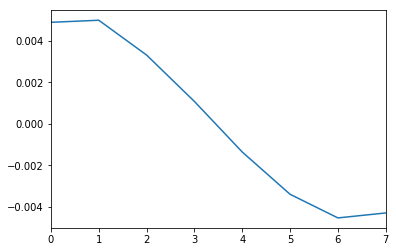

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -480_to_-60 BExternal 0.238x.dat


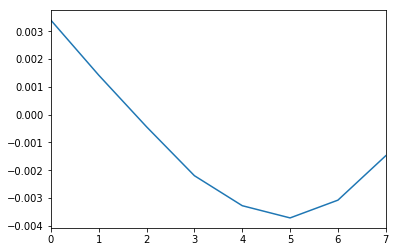

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -480_to_-60 BExternal 0.238x.dat


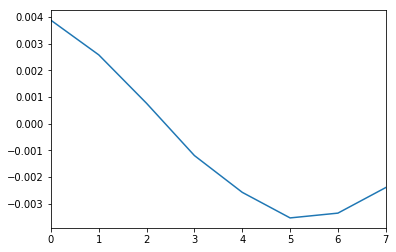

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -480_to_-60 BExternal 0.24x.dat


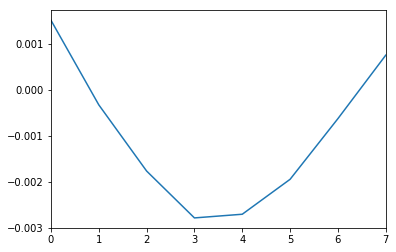

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -480_to_-60 BExternal 0.24x.dat


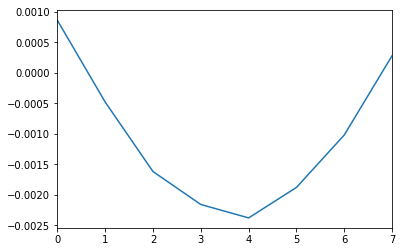

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -480_to_-60 BExternal 0.238x.dat


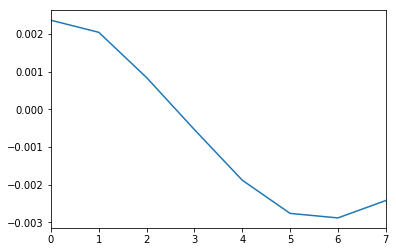

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -480_to_-60 BExternal 0.3x.dat


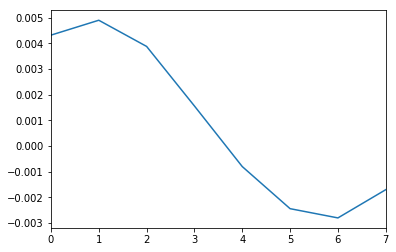

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -480_to_-60 BExternal 0.238x.dat


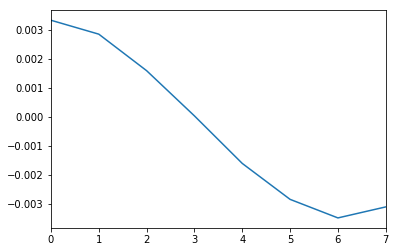

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -480_to_-60 BExternal 0.236x.dat


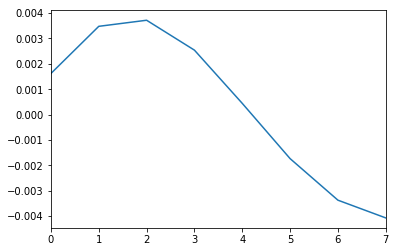

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -480_to_-60 BExternal 0.236x.dat


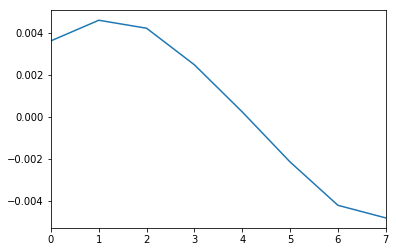

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -480_to_-60 BExternal 0.234x.dat


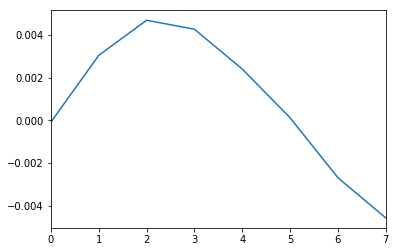

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -480_to_-60 BExternal 0.234x.dat


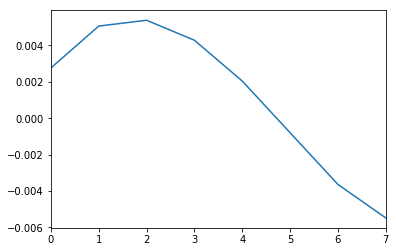

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -480_to_-60 BExternal 0.232x.dat


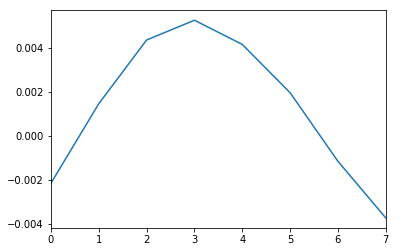

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -480_to_-60 BExternal 0.232x.dat


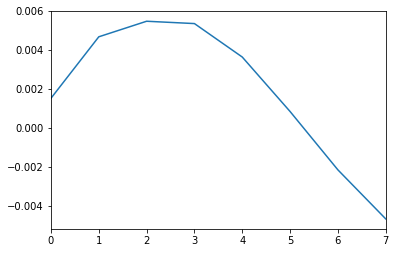

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -480_to_-60 BExternal 0.23x.dat


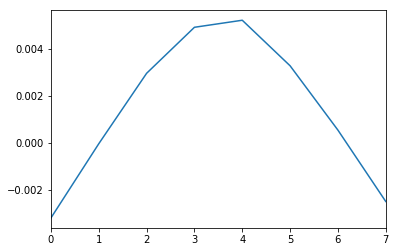

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -480_to_-60 BExternal 0.23x.dat


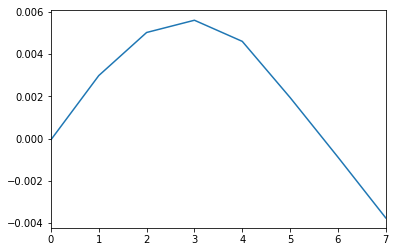

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -480_to_-60 BExternal 0.228x.dat


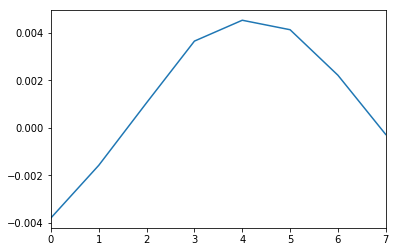

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -480_to_-60 BExternal 0.22x.dat


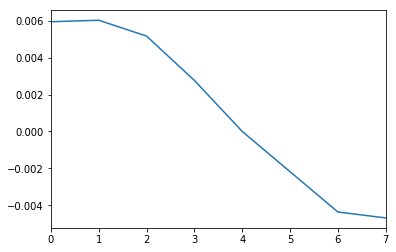

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -480_to_-60 BExternal 0.228x.dat


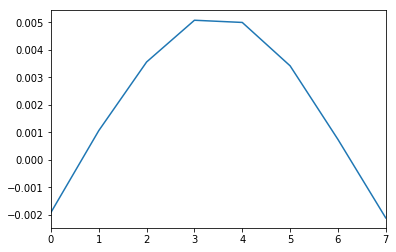

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -480_to_-60 BExternal 0.226x.dat


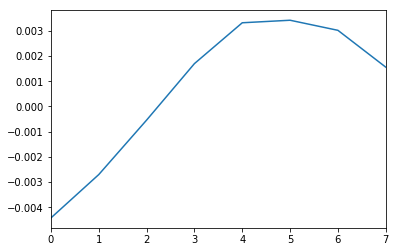

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -480_to_-60 BExternal 0.226x.dat


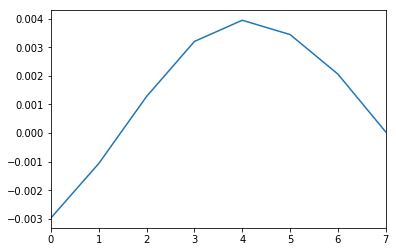

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -480_to_-60 BExternal 0.224x.dat


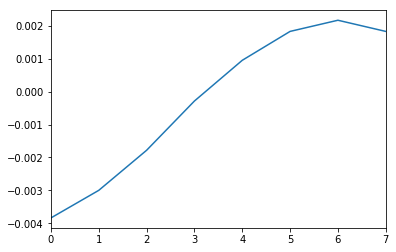

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -480_to_-60 BExternal 0.224x.dat


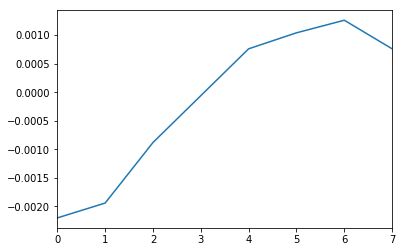

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -480_to_-60 BExternal 0.222x.dat


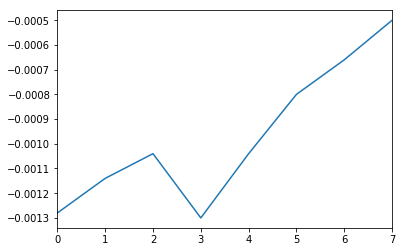

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -480_to_-60 BExternal 0.222x.dat


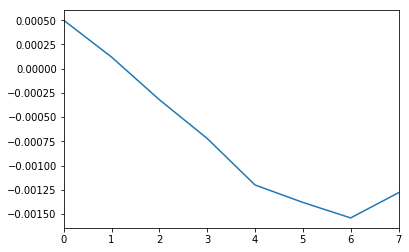

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -480_to_-60 BExternal 0.22x.dat


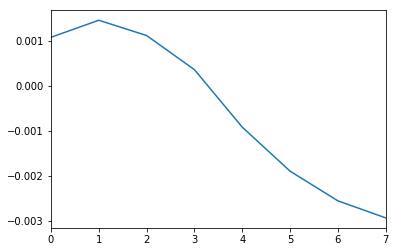

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -480_to_-60 BExternal 0.22x.dat


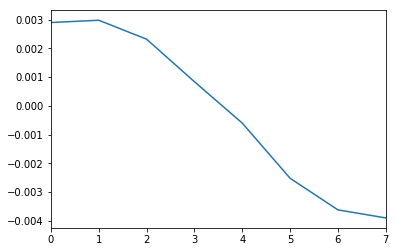

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -480_to_-60 BExternal 0.218x.dat


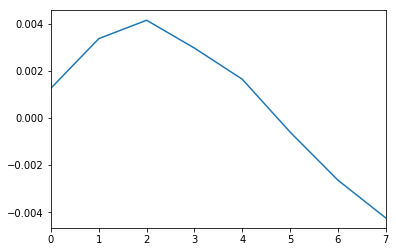

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -480_to_-60 BExternal 0.22x.dat


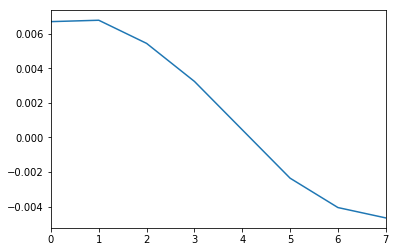

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -480_to_-60 BExternal 0.218x.dat


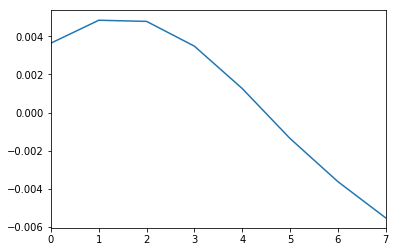

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -480_to_-60 BExternal 0.216x.dat


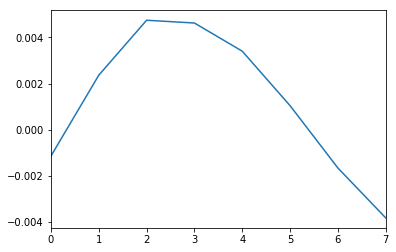

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -480_to_-60 BExternal 0.216x.dat


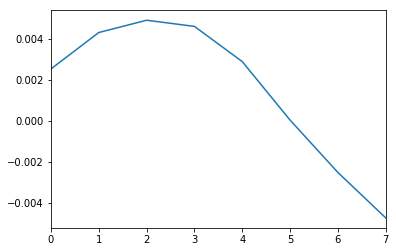

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -480_to_-60 BExternal 0.214x.dat


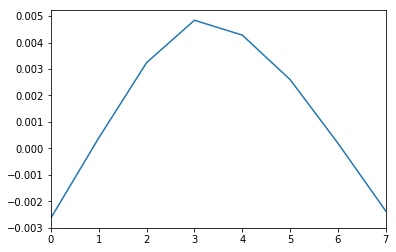

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -480_to_-60 BExternal 0.214x.dat


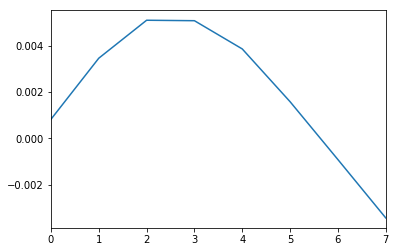

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -480_to_-60 BExternal 0.212x.dat


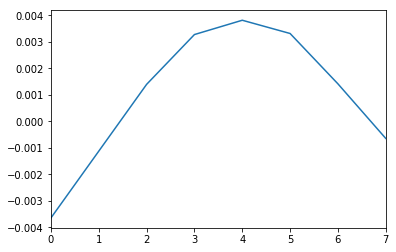

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -480_to_-60 BExternal 0.212x.dat


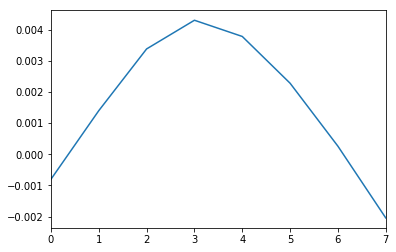

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -480_to_-60 BExternal 0.21x.dat


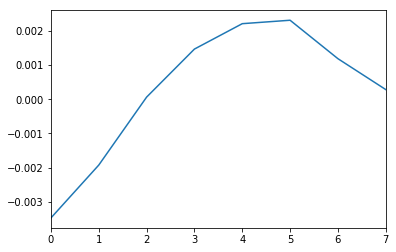

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -480_to_-60 BExternal 0.21x.dat


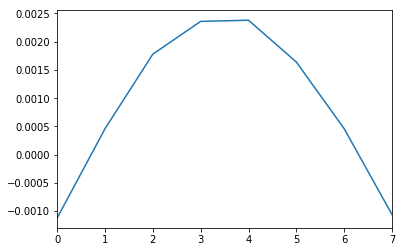

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -480_to_-60 BExternal 0.208x.dat


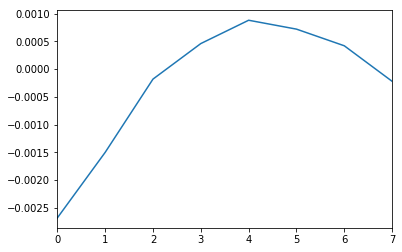

C:\Data\apr2017\170409\TestPhaseShift2_driftedto818.48_1040uWpump_TRKR___818.57nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -480_to_-60 BExternal 0.218x.dat


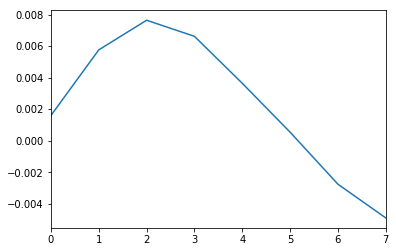

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal 0.236x.dat


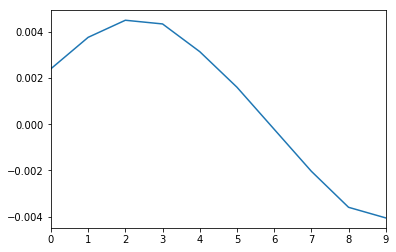

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal 0.2375x.dat


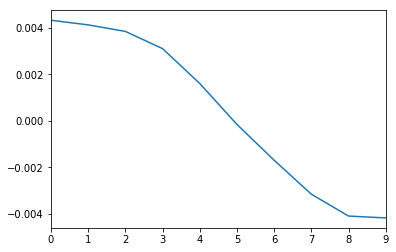

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal 0.2375x.dat


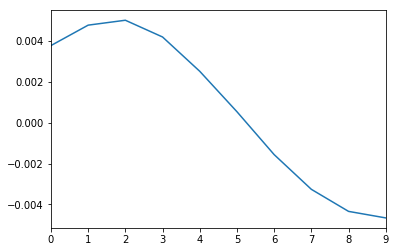

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal 0.2375x.dat


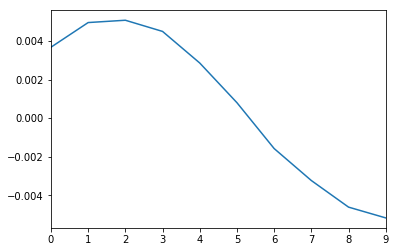

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal 0.2375x.dat


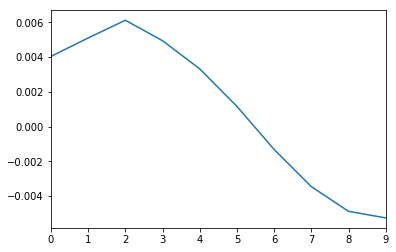

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal 0.239x.dat


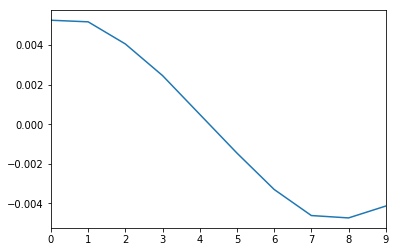

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal 0.239x.dat


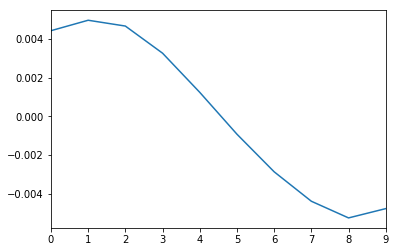

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal 0.239x.dat


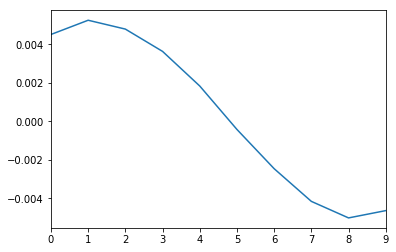

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal 0.239x.dat


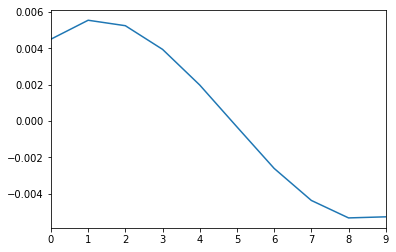

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal 0.2405x.dat


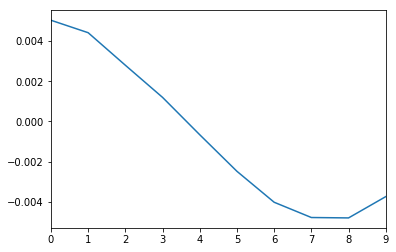

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.203x.dat


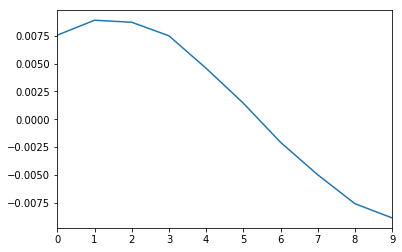

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal 0.2405x.dat


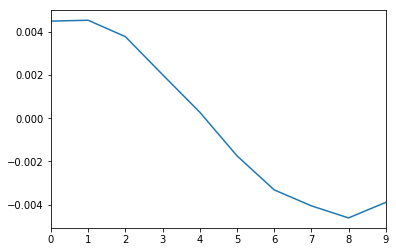

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal 0.2405x.dat


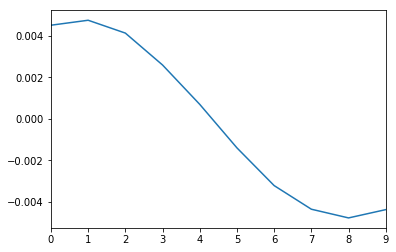

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -500_to_-50 BExternal 0.2405x.dat


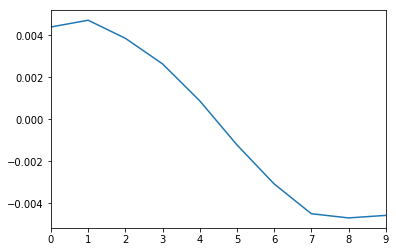

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -500_to_-50 BExternal 0.242x.dat


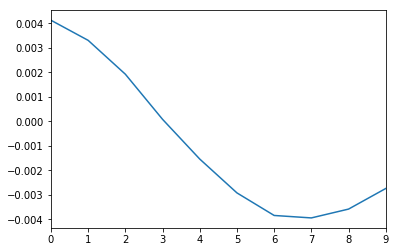

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -500_to_-50 BExternal 0.242x.dat


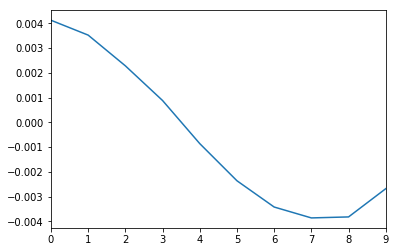

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -500_to_-50 BExternal 0.242x.dat


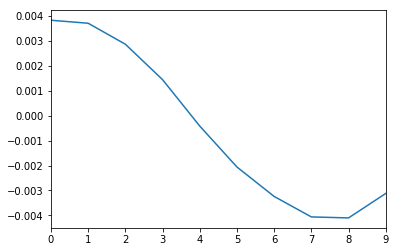

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -500_to_-50 BExternal 0.242x.dat


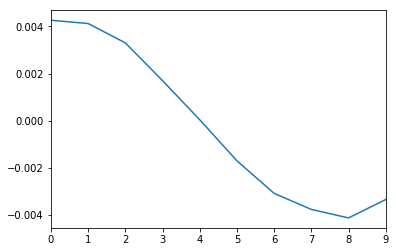

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -500_to_-50 BExternal 0.2435x.dat


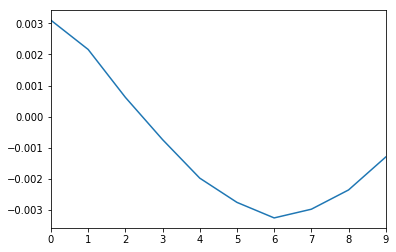

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -500_to_-50 BExternal 0.2435x.dat


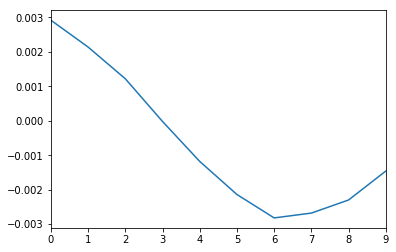

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -500_to_-50 BExternal 0.2435x.dat


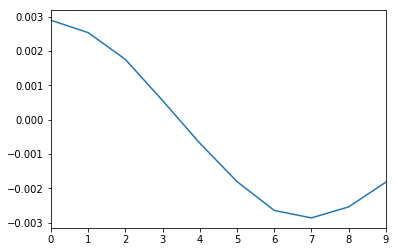

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.203x.dat


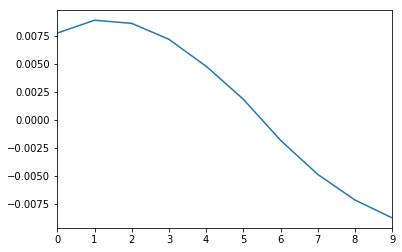

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -500_to_-50 BExternal 0.2435x.dat


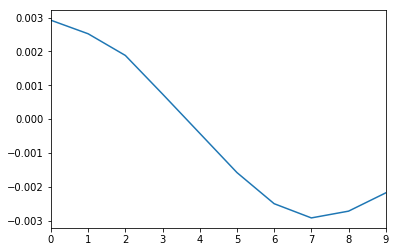

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -500_to_-50 BExternal 0.245x.dat


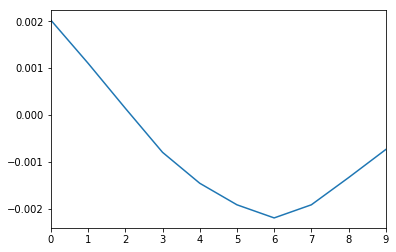

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -500_to_-50 BExternal 0.245x.dat


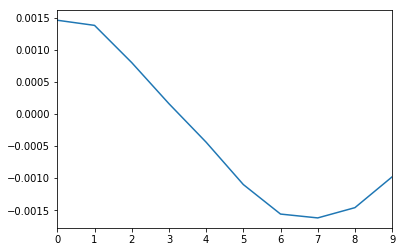

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -500_to_-50 BExternal 0.245x.dat


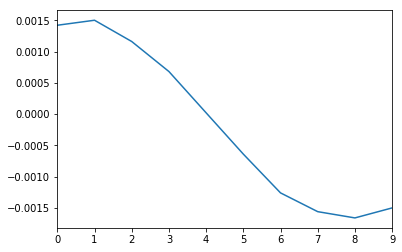

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -500_to_-50 BExternal 0.245x.dat


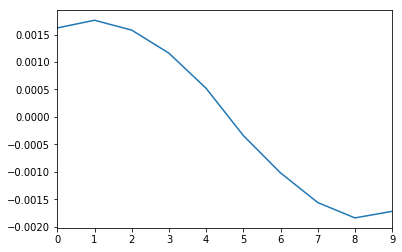

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -500_to_-50 BExternal 0.2465x.dat


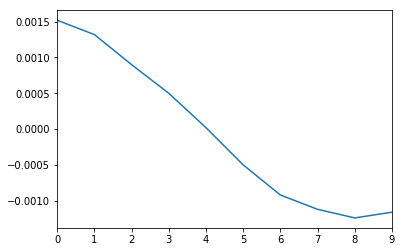

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -500_to_-50 BExternal 0.2465x.dat


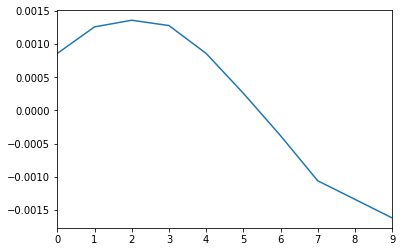

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -500_to_-50 BExternal 0.2465x.dat


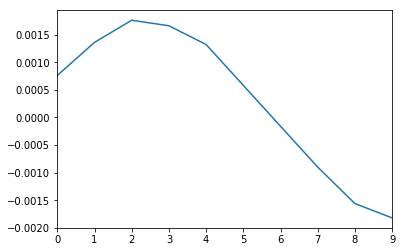

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -500_to_-50 BExternal 0.2465x.dat


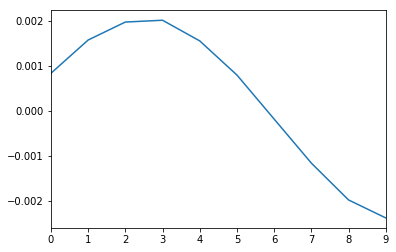

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -500_to_-50 BExternal 0.248x.dat


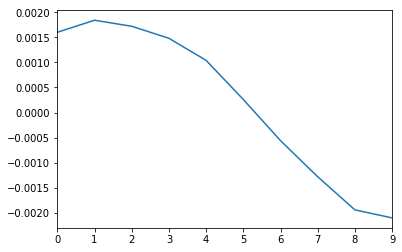

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.203x.dat


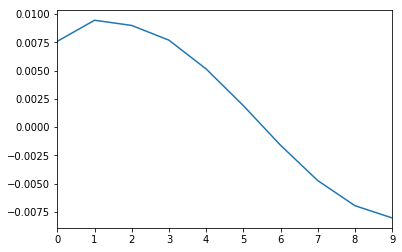

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -500_to_-50 BExternal 0.248x.dat


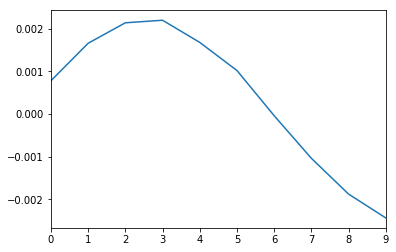

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -500_to_-50 BExternal 0.248x.dat


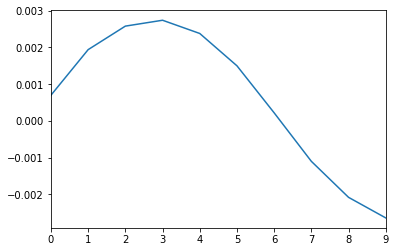

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -500_to_-50 BExternal 0.248x.dat


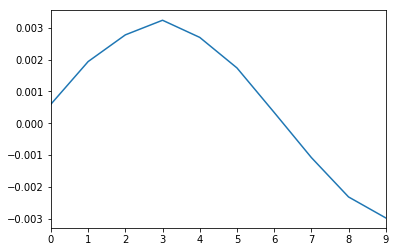

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_133_DelayTime -500_to_-50 BExternal 0.2465x.dat


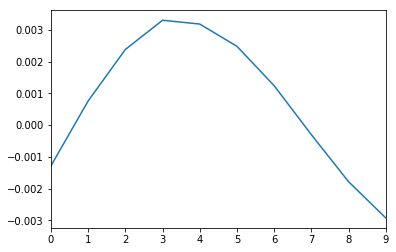

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_134_DelayTime -500_to_-50 BExternal 0.2465x.dat


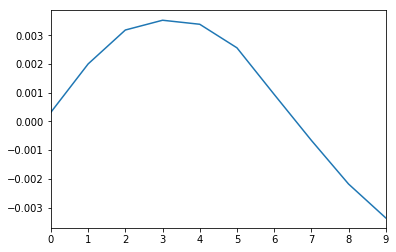

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_135_DelayTime -500_to_-50 BExternal 0.2465x.dat


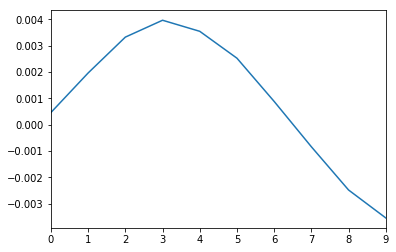

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_136_DelayTime -500_to_-50 BExternal 0.2465x.dat


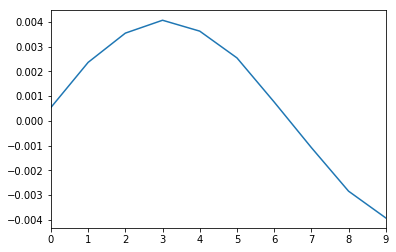

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_137_DelayTime -500_to_-50 BExternal 0.245x.dat


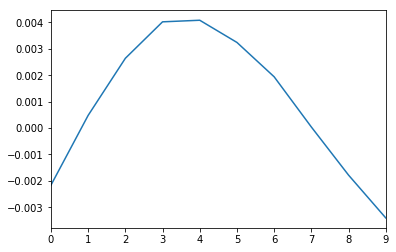

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_138_DelayTime -500_to_-50 BExternal 0.245x.dat


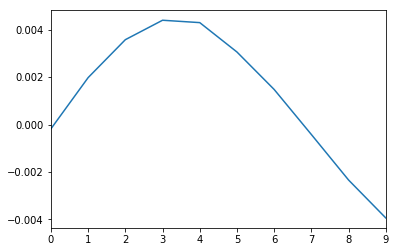

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_139_DelayTime -500_to_-50 BExternal 0.245x.dat


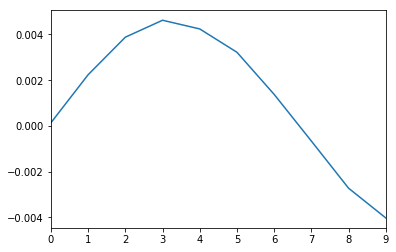

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.2045x.dat


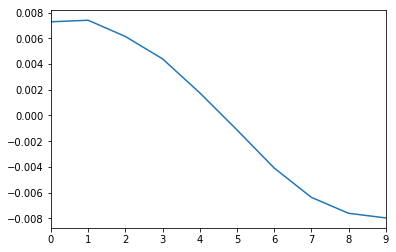

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_140_DelayTime -500_to_-50 BExternal 0.245x.dat


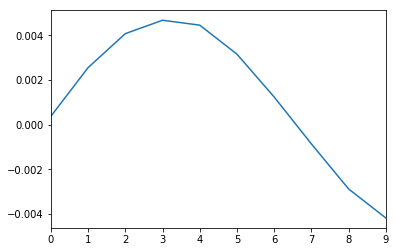

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_141_DelayTime -500_to_-50 BExternal 0.2435x.dat


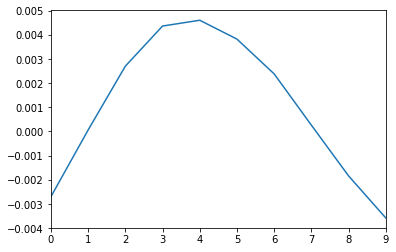

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_142_DelayTime -500_to_-50 BExternal 0.2435x.dat


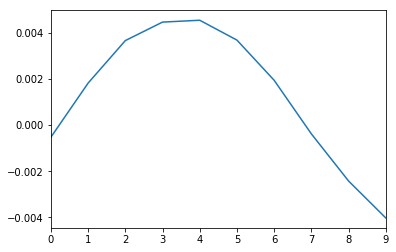

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_143_DelayTime -500_to_-50 BExternal 0.2435x.dat


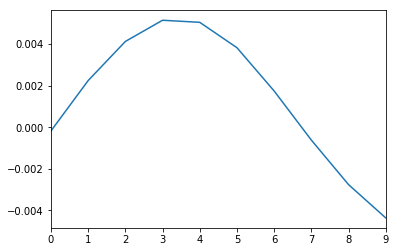

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_144_DelayTime -500_to_-50 BExternal 0.2435x.dat


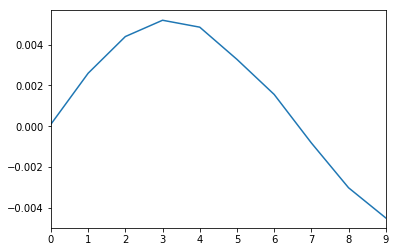

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_145_DelayTime -500_to_-50 BExternal 0.242x.dat


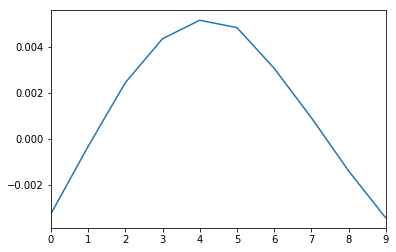

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_146_DelayTime -500_to_-50 BExternal 0.242x.dat


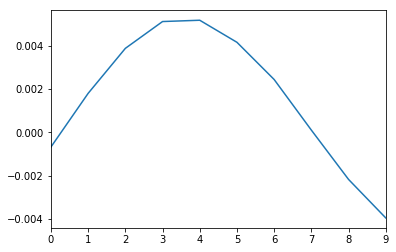

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_147_DelayTime -500_to_-50 BExternal 0.242x.dat


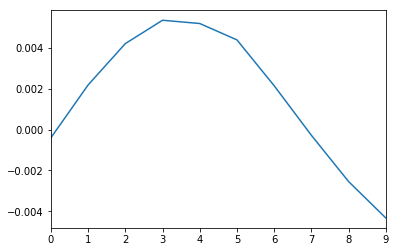

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_148_DelayTime -500_to_-50 BExternal 0.242x.dat


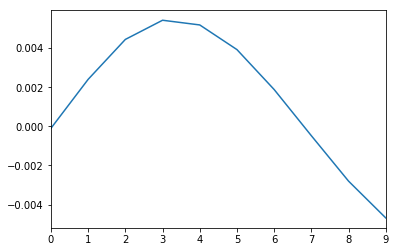

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_149_DelayTime -500_to_-50 BExternal 0.2405x.dat


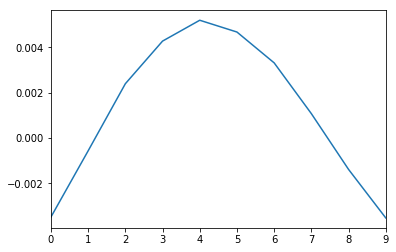

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.2045x.dat


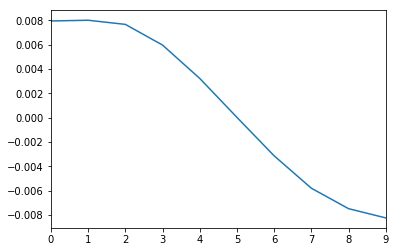

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_150_DelayTime -500_to_-50 BExternal 0.2405x.dat


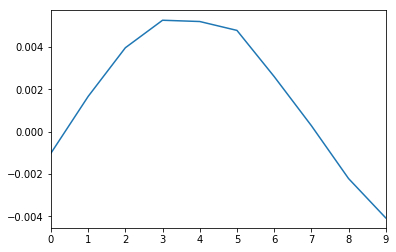

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_151_DelayTime -500_to_-50 BExternal 0.2405x.dat


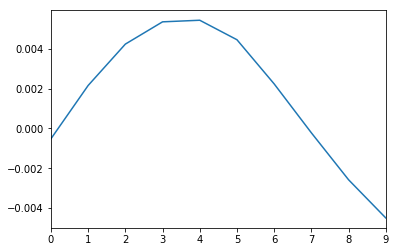

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_152_DelayTime -500_to_-50 BExternal 0.2405x.dat


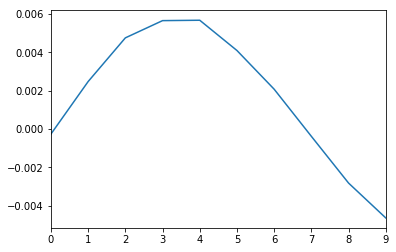

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_153_DelayTime -500_to_-50 BExternal 0.239x.dat


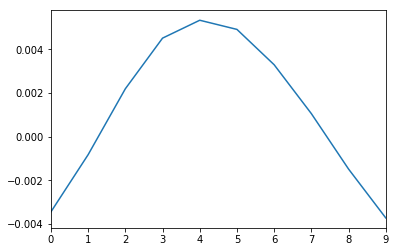

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_154_DelayTime -500_to_-50 BExternal 0.239x.dat


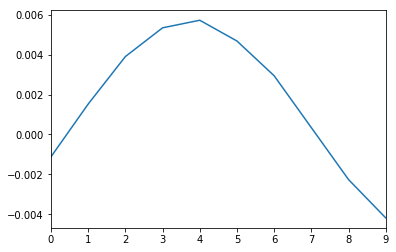

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_155_DelayTime -500_to_-50 BExternal 0.239x.dat


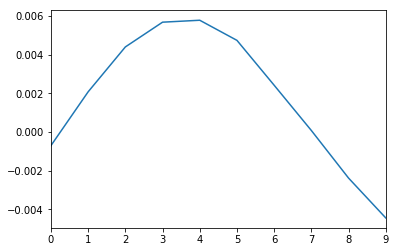

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_156_DelayTime -500_to_-50 BExternal 0.239x.dat


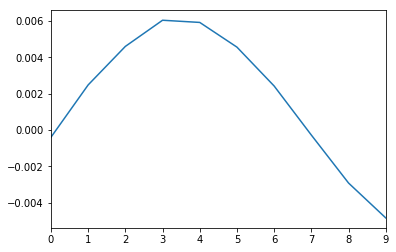

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_157_DelayTime -500_to_-50 BExternal 0.2375x.dat


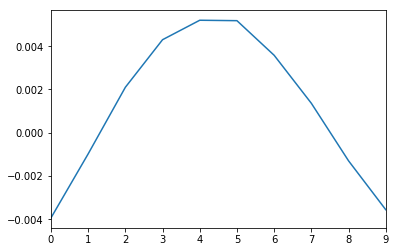

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_158_DelayTime -500_to_-50 BExternal 0.2375x.dat


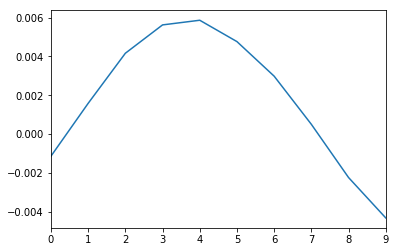

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_159_DelayTime -500_to_-50 BExternal 0.2375x.dat


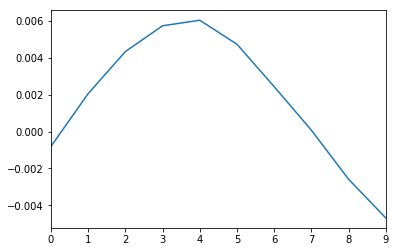

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.2045x.dat


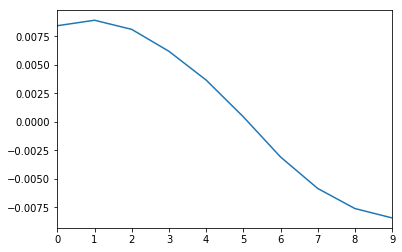

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_160_DelayTime -500_to_-50 BExternal 0.2375x.dat


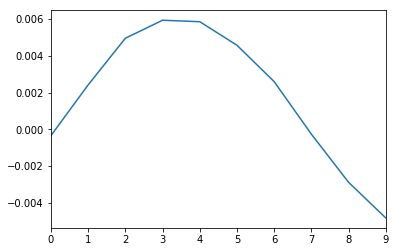

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_161_DelayTime -500_to_-50 BExternal 0.236x.dat


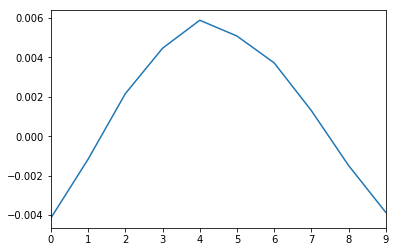

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_162_DelayTime -500_to_-50 BExternal 0.236x.dat


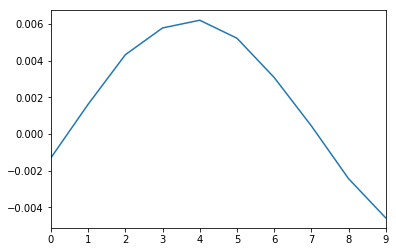

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_163_DelayTime -500_to_-50 BExternal 0.236x.dat


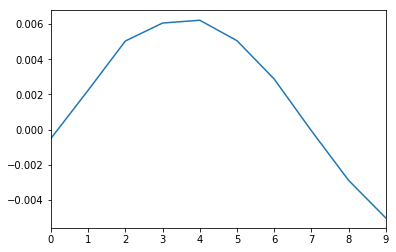

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_164_DelayTime -500_to_-50 BExternal 0.236x.dat


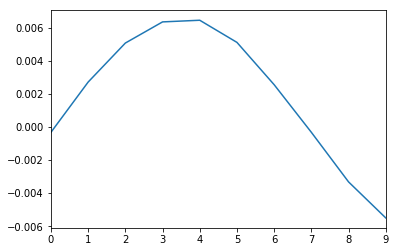

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_165_DelayTime -500_to_-50 BExternal 0.2345x.dat


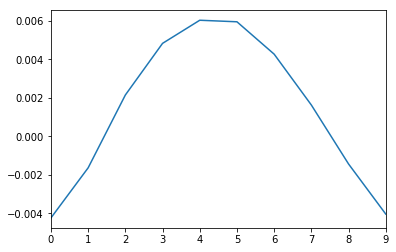

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_166_DelayTime -500_to_-50 BExternal 0.2345x.dat


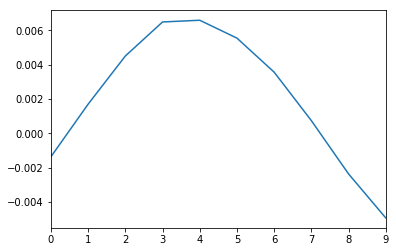

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_167_DelayTime -500_to_-50 BExternal 0.2345x.dat


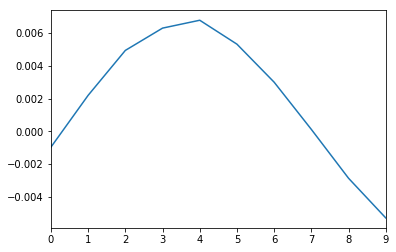

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_168_DelayTime -500_to_-50 BExternal 0.2345x.dat


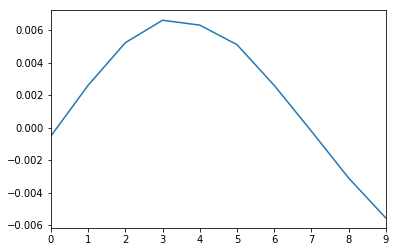

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_169_DelayTime -500_to_-50 BExternal 0.233x.dat


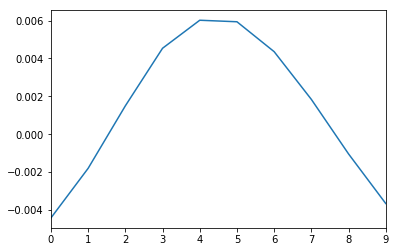

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.2045x.dat


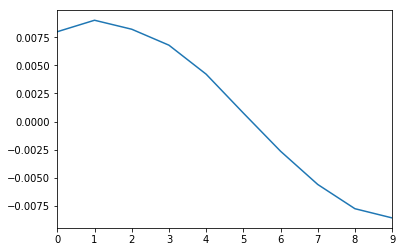

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_170_DelayTime -500_to_-50 BExternal 0.233x.dat


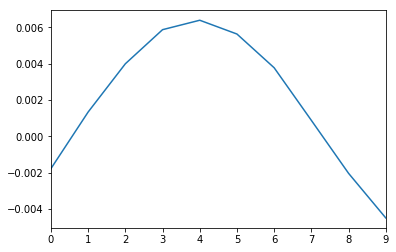

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_171_DelayTime -500_to_-50 BExternal 0.233x.dat


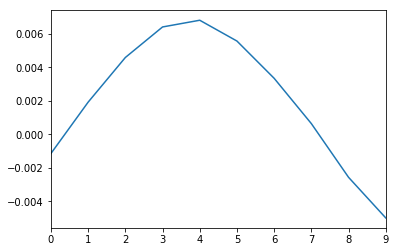

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_172_DelayTime -500_to_-50 BExternal 0.233x.dat


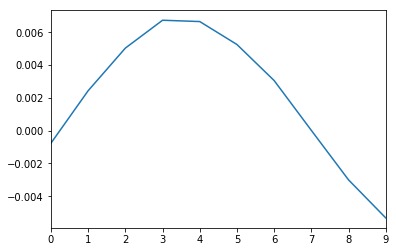

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_173_DelayTime -500_to_-50 BExternal 0.2315x.dat


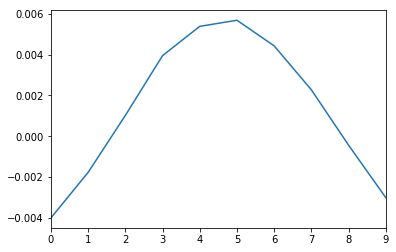

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_174_DelayTime -500_to_-50 BExternal 0.2315x.dat


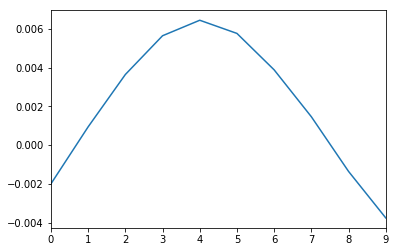

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_175_DelayTime -500_to_-50 BExternal 0.2315x.dat


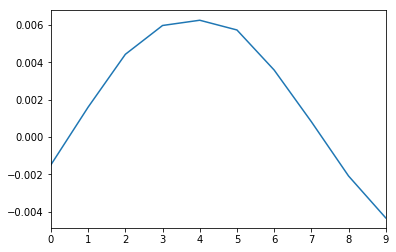

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_176_DelayTime -500_to_-50 BExternal 0.2315x.dat


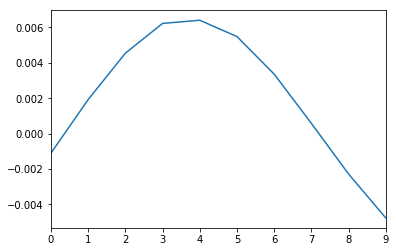

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_177_DelayTime -500_to_-50 BExternal 0.23x.dat


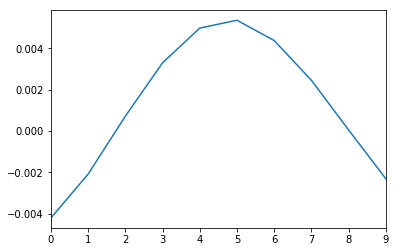

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_178_DelayTime -500_to_-50 BExternal 0.23x.dat


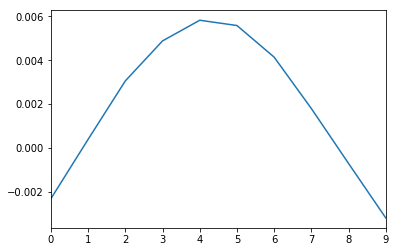

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_179_DelayTime -500_to_-50 BExternal 0.23x.dat


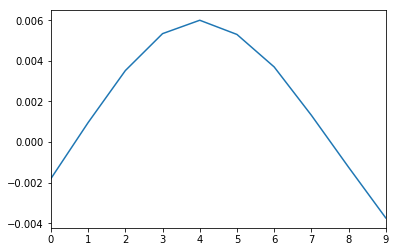

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.206x.dat


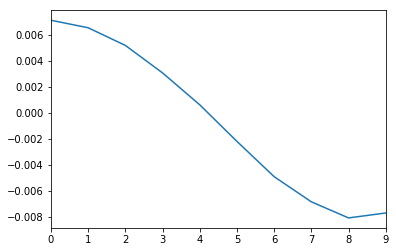

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_180_DelayTime -500_to_-50 BExternal 0.23x.dat


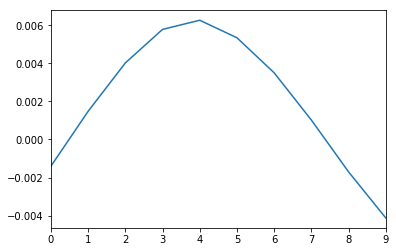

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_181_DelayTime -500_to_-50 BExternal 0.2285x.dat


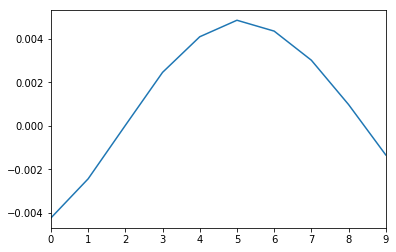

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_182_DelayTime -500_to_-50 BExternal 0.2285x.dat


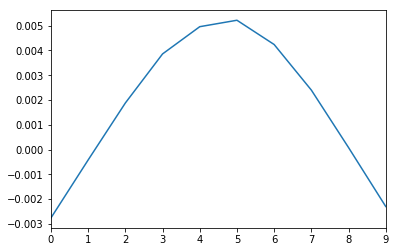

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_183_DelayTime -500_to_-50 BExternal 0.2285x.dat


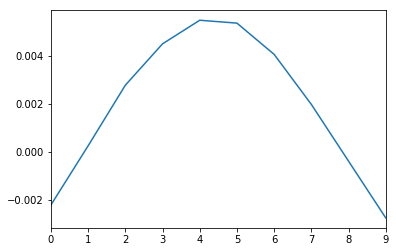

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_184_DelayTime -500_to_-50 BExternal 0.2285x.dat


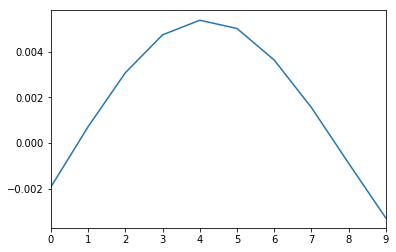

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_185_DelayTime -500_to_-50 BExternal 0.227x.dat


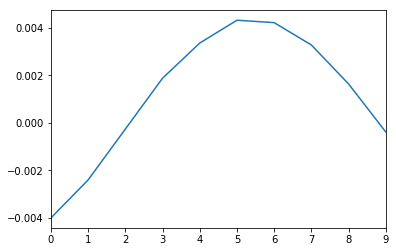

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_186_DelayTime -500_to_-50 BExternal 0.227x.dat


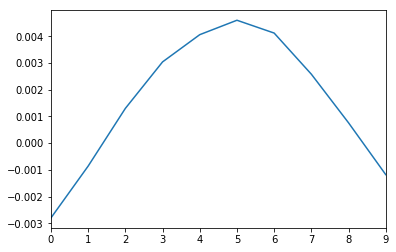

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_187_DelayTime -500_to_-50 BExternal 0.227x.dat


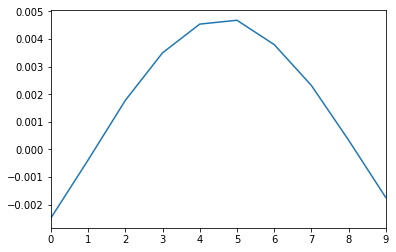

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_188_DelayTime -500_to_-50 BExternal 0.227x.dat


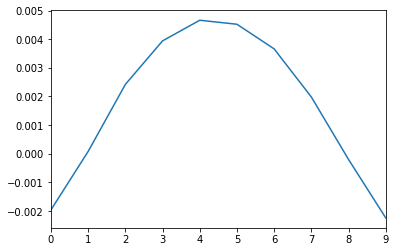

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_189_DelayTime -500_to_-50 BExternal 0.2255x.dat


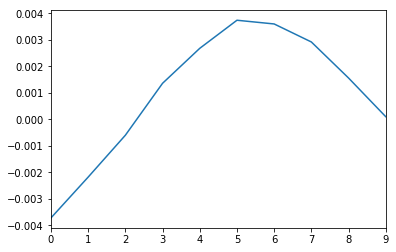

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.206x.dat


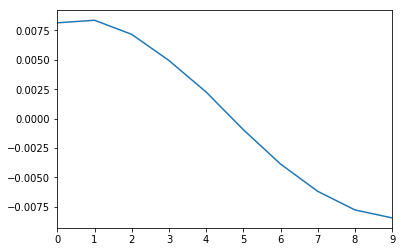

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_190_DelayTime -500_to_-50 BExternal 0.2255x.dat


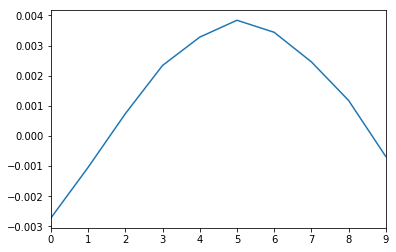

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_191_DelayTime -500_to_-50 BExternal 0.2255x.dat


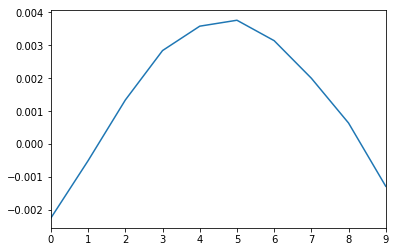

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_192_DelayTime -500_to_-50 BExternal 0.2255x.dat


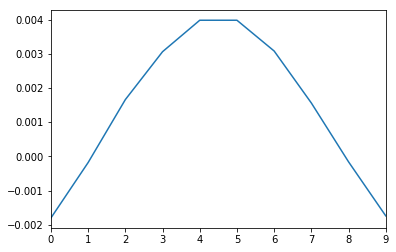

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_193_DelayTime -500_to_-50 BExternal 0.224x.dat


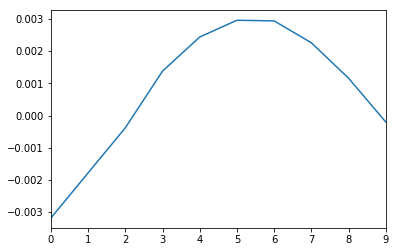

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_194_DelayTime -500_to_-50 BExternal 0.224x.dat


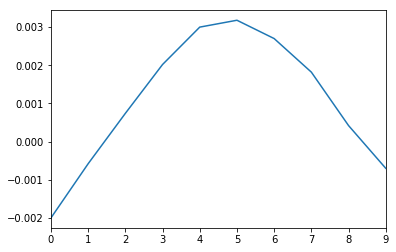

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_195_DelayTime -500_to_-50 BExternal 0.224x.dat


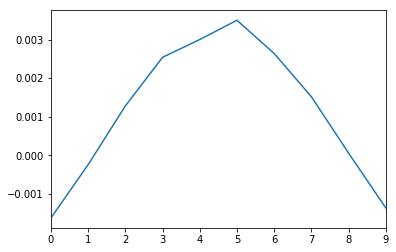

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_196_DelayTime -500_to_-50 BExternal 0.224x.dat


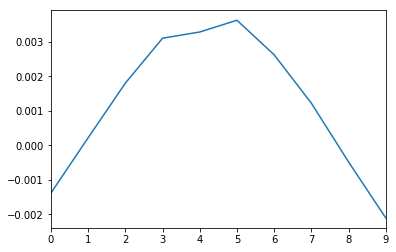

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_197_DelayTime -500_to_-50 BExternal 0.2225x.dat


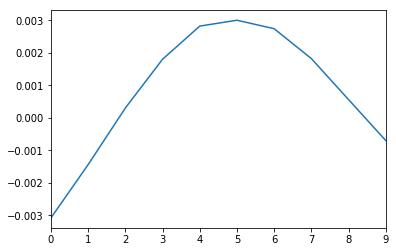

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_198_DelayTime -500_to_-50 BExternal 0.2225x.dat


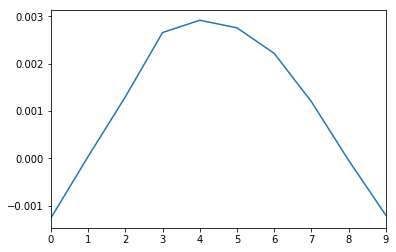

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_199_DelayTime -500_to_-50 BExternal 0.2225x.dat


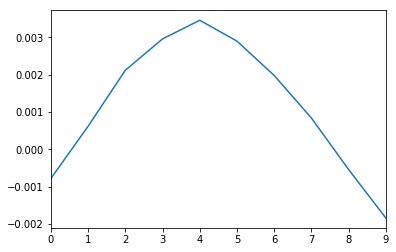

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.206x.dat


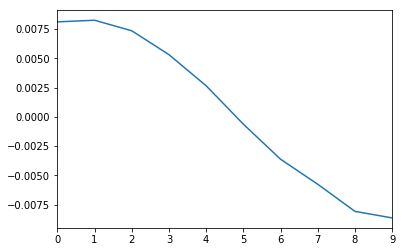

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.2x.dat


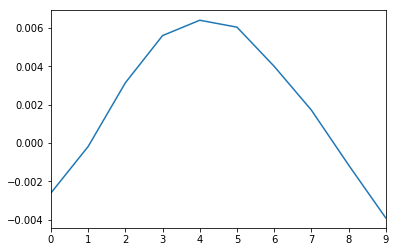

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_200_DelayTime -500_to_-50 BExternal 0.2225x.dat


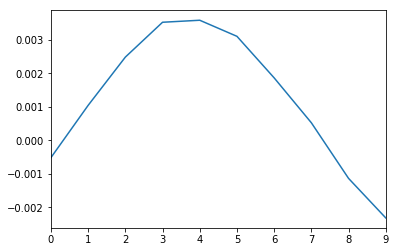

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_201_DelayTime -500_to_-50 BExternal 0.221x.dat


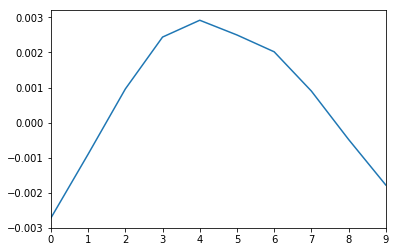

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_202_DelayTime -500_to_-50 BExternal 0.221x.dat


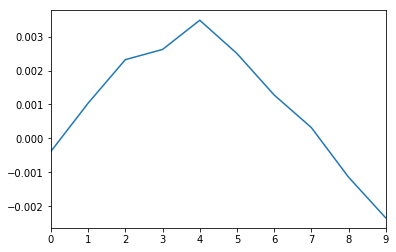

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_203_DelayTime -500_to_-50 BExternal 0.221x.dat


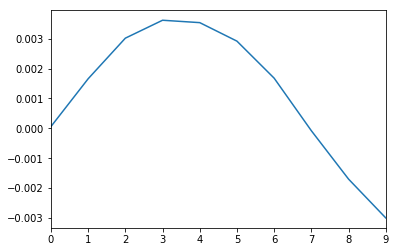

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_204_DelayTime -500_to_-50 BExternal 0.221x.dat


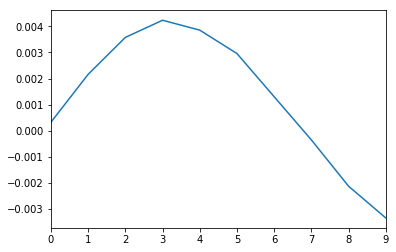

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_205_DelayTime -500_to_-50 BExternal 0.2195x.dat


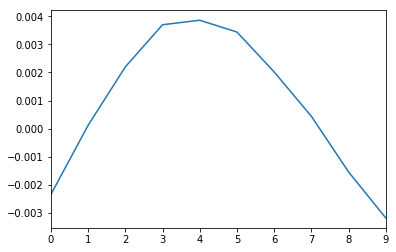

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_206_DelayTime -500_to_-50 BExternal 0.2195x.dat


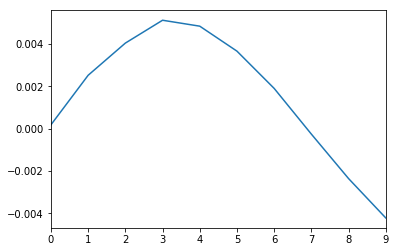

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_207_DelayTime -500_to_-50 BExternal 0.2195x.dat


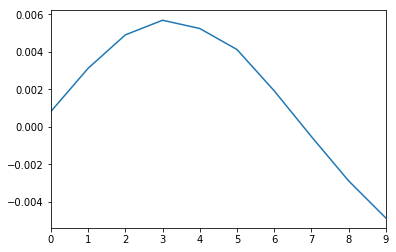

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_208_DelayTime -500_to_-50 BExternal 0.2195x.dat


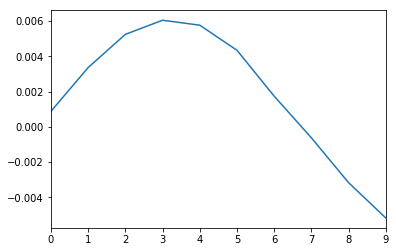

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_209_DelayTime -500_to_-50 BExternal 0.218x.dat


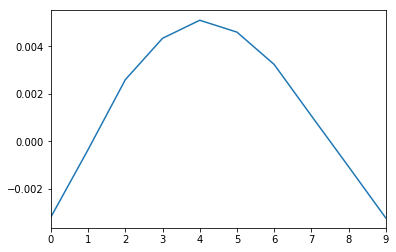

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.206x.dat


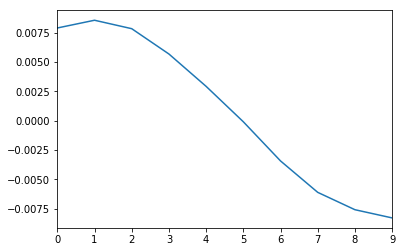

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_210_DelayTime -500_to_-50 BExternal 0.218x.dat


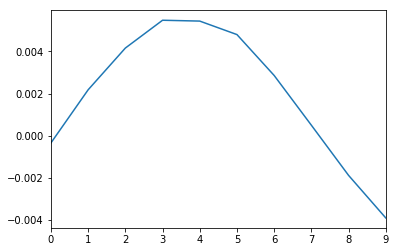

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_211_DelayTime -500_to_-50 BExternal 0.218x.dat


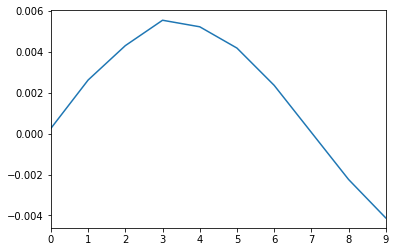

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_212_DelayTime -500_to_-50 BExternal 0.218x.dat


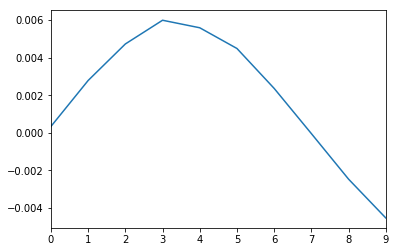

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_213_DelayTime -500_to_-50 BExternal 0.2165x.dat


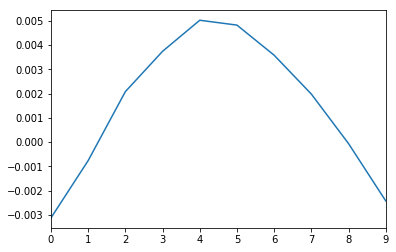

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_214_DelayTime -500_to_-50 BExternal 0.2165x.dat


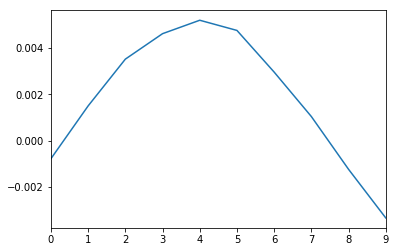

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_215_DelayTime -500_to_-50 BExternal 0.2165x.dat


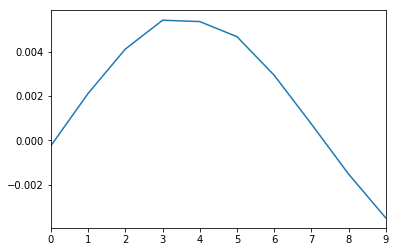

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_216_DelayTime -500_to_-50 BExternal 0.2165x.dat


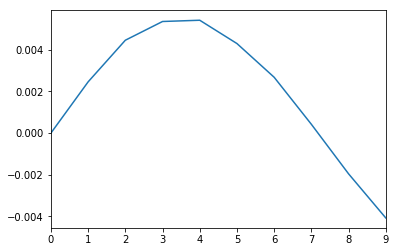

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_217_DelayTime -500_to_-50 BExternal 0.215x.dat


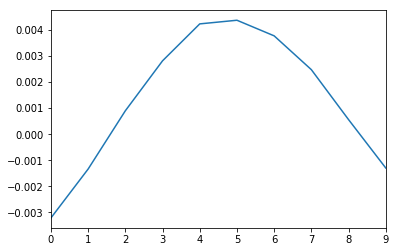

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_218_DelayTime -500_to_-50 BExternal 0.215x.dat


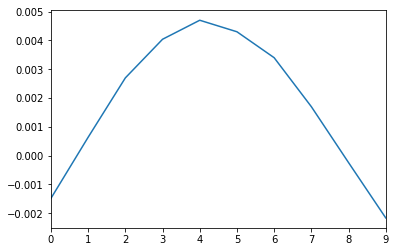

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_219_DelayTime -500_to_-50 BExternal 0.215x.dat


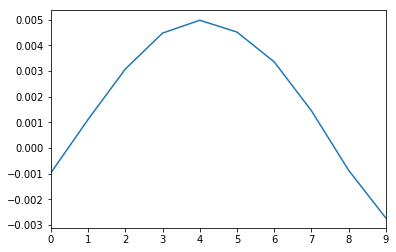

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.2075x.dat


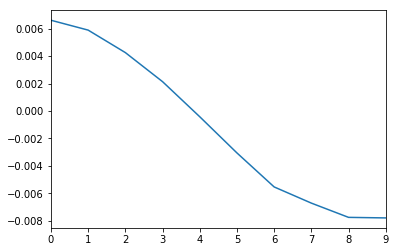

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_220_DelayTime -500_to_-50 BExternal 0.215x.dat


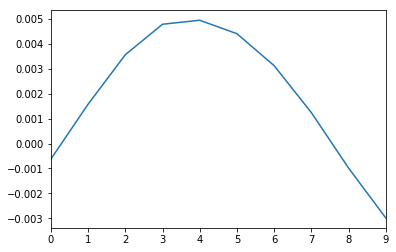

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_221_DelayTime -500_to_-50 BExternal 0.2135x.dat


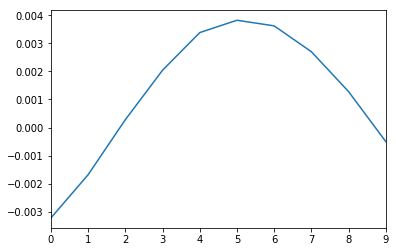

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_222_DelayTime -500_to_-50 BExternal 0.2135x.dat


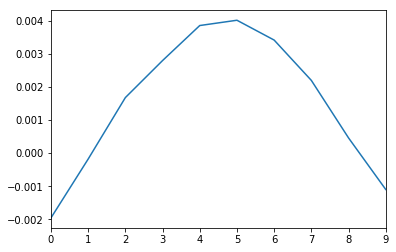

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_223_DelayTime -500_to_-50 BExternal 0.2135x.dat


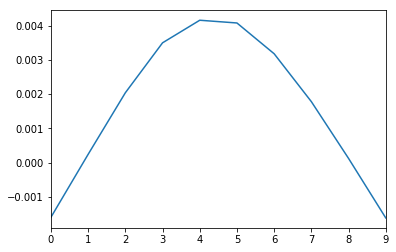

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_224_DelayTime -500_to_-50 BExternal 0.2135x.dat


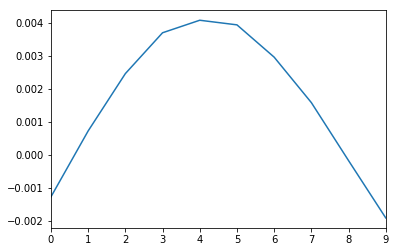

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_225_DelayTime -500_to_-50 BExternal 0.212x.dat


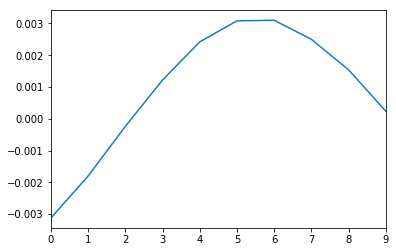

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_226_DelayTime -500_to_-50 BExternal 0.212x.dat


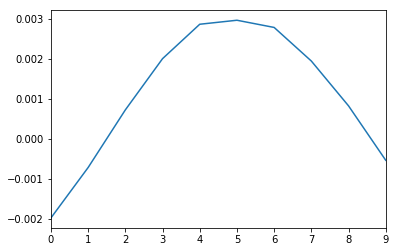

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_227_DelayTime -500_to_-50 BExternal 0.212x.dat


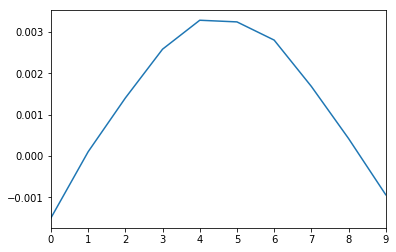

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_228_DelayTime -500_to_-50 BExternal 0.212x.dat


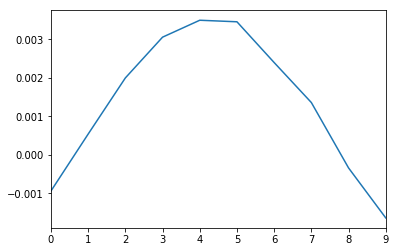

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_229_DelayTime -500_to_-50 BExternal 0.2105x.dat


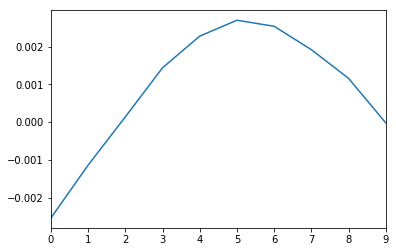

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.2075x.dat


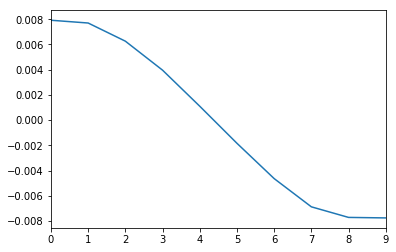

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_230_DelayTime -500_to_-50 BExternal 0.2105x.dat


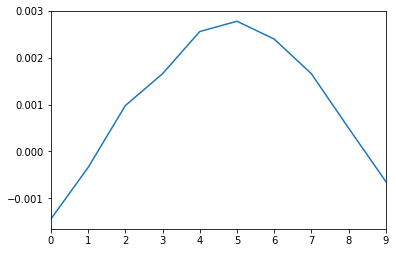

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_231_DelayTime -500_to_-50 BExternal 0.2105x.dat


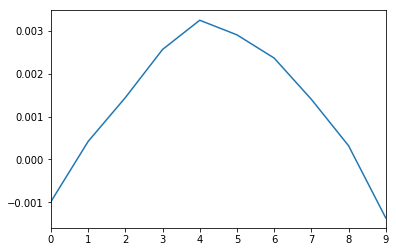

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_232_DelayTime -500_to_-50 BExternal 0.2105x.dat


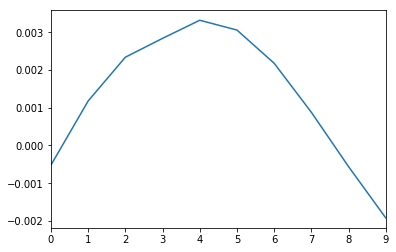

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_233_DelayTime -500_to_-50 BExternal 0.209x.dat


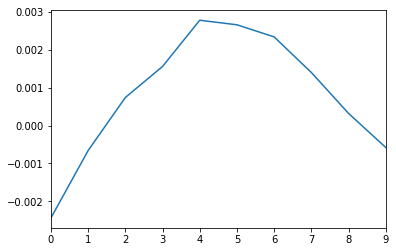

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_234_DelayTime -500_to_-50 BExternal 0.209x.dat


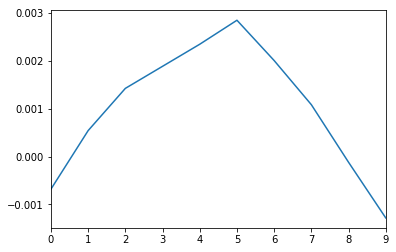

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_235_DelayTime -500_to_-50 BExternal 0.209x.dat


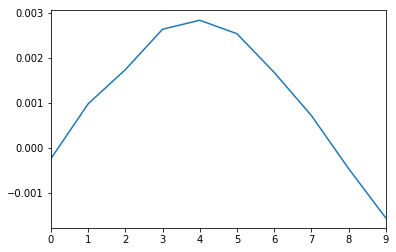

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_236_DelayTime -500_to_-50 BExternal 0.209x.dat


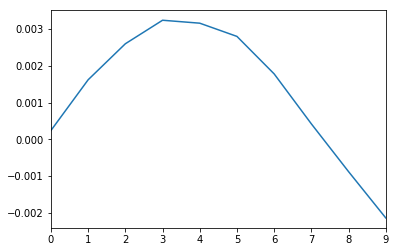

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_237_DelayTime -500_to_-50 BExternal 0.2075x.dat


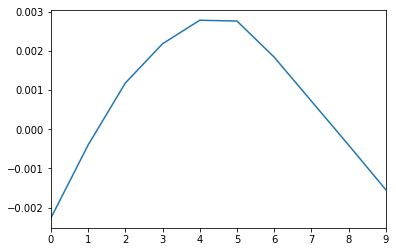

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_238_DelayTime -500_to_-50 BExternal 0.2075x.dat


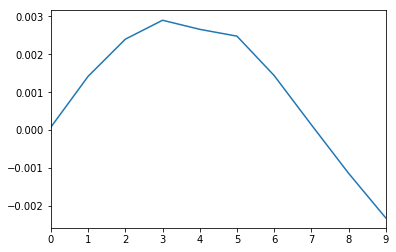

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_239_DelayTime -500_to_-50 BExternal 0.2075x.dat


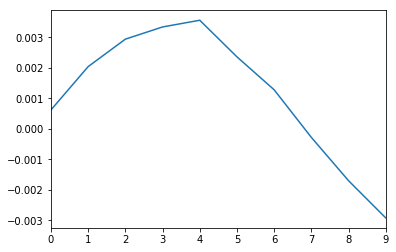

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.2075x.dat


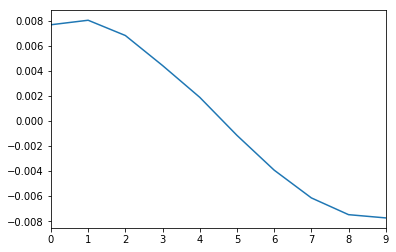

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_240_DelayTime -500_to_-50 BExternal 0.2075x.dat


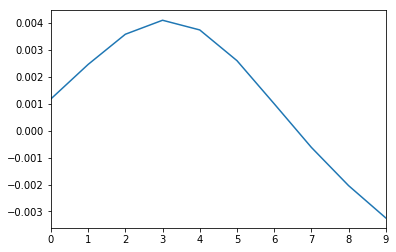

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_241_DelayTime -500_to_-50 BExternal 0.206x.dat


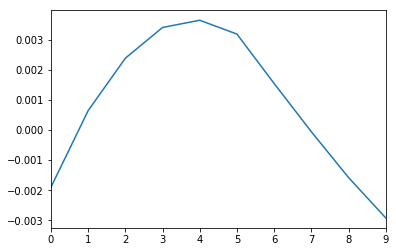

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_242_DelayTime -500_to_-50 BExternal 0.206x.dat


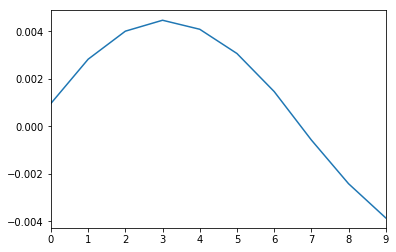

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_243_DelayTime -500_to_-50 BExternal 0.206x.dat


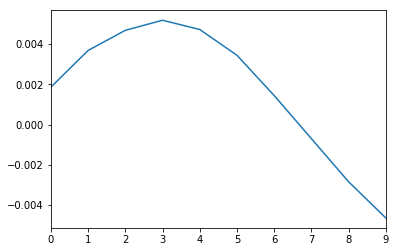

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_244_DelayTime -500_to_-50 BExternal 0.206x.dat


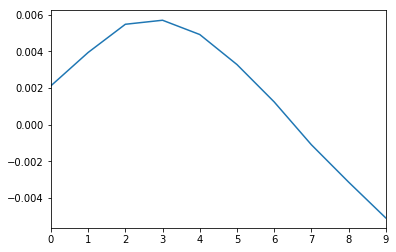

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_245_DelayTime -500_to_-50 BExternal 0.2045x.dat


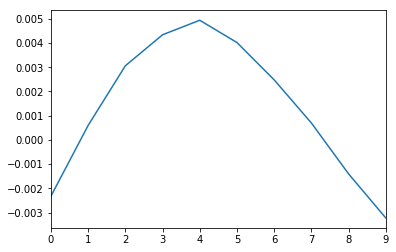

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_246_DelayTime -500_to_-50 BExternal 0.2045x.dat


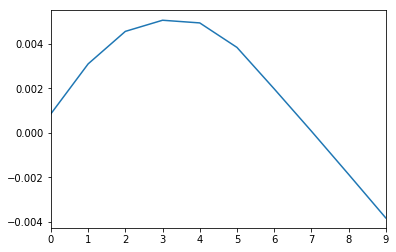

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_247_DelayTime -500_to_-50 BExternal 0.2045x.dat


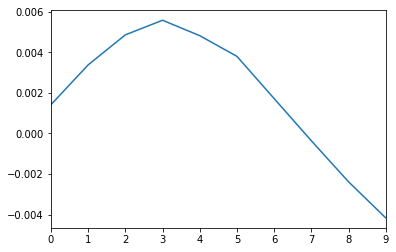

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_248_DelayTime -500_to_-50 BExternal 0.2045x.dat


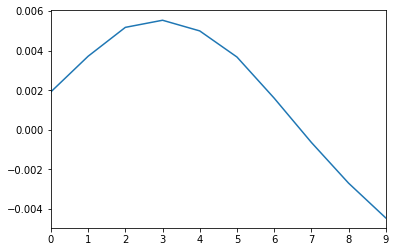

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_249_DelayTime -500_to_-50 BExternal 0.203x.dat


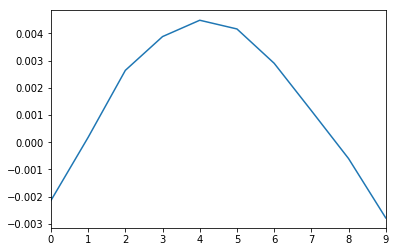

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.2075x.dat


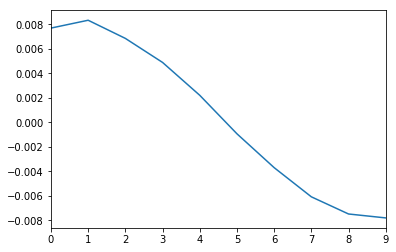

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_250_DelayTime -500_to_-50 BExternal 0.203x.dat


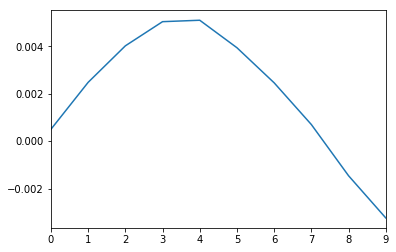

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_251_DelayTime -500_to_-50 BExternal 0.203x.dat


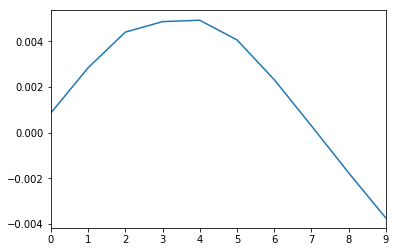

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_252_DelayTime -500_to_-50 BExternal 0.203x.dat


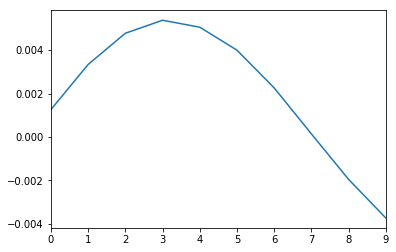

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_253_DelayTime -500_to_-50 BExternal 0.2015x.dat


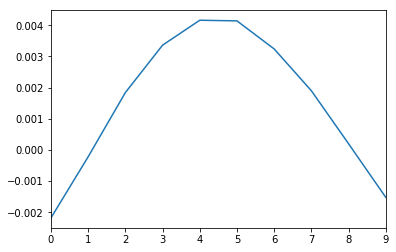

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_254_DelayTime -500_to_-50 BExternal 0.2015x.dat


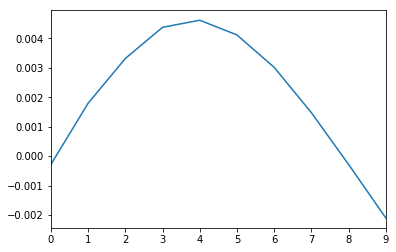

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_255_DelayTime -500_to_-50 BExternal 0.2015x.dat


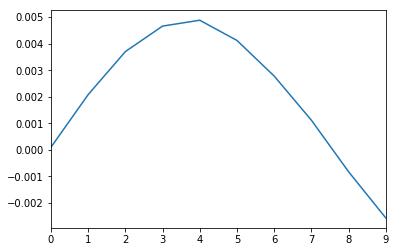

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_256_DelayTime -500_to_-50 BExternal 0.2015x.dat


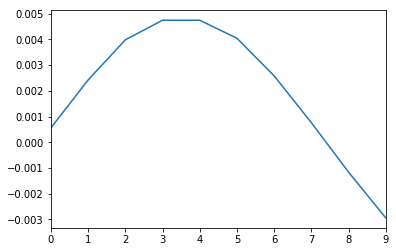

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_257_DelayTime -500_to_-50 BExternal 0.2x.dat


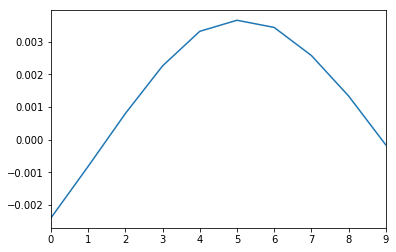

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_258_DelayTime -500_to_-50 BExternal 0.2x.dat


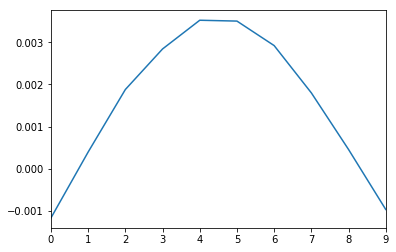

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_259_DelayTime -500_to_-50 BExternal 0.2x.dat


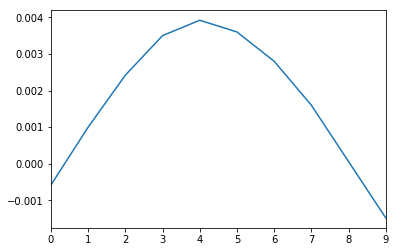

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.209x.dat


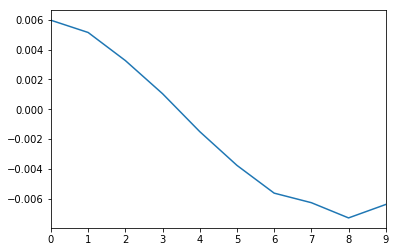

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_260_DelayTime -500_to_-50 BExternal 0.2x.dat


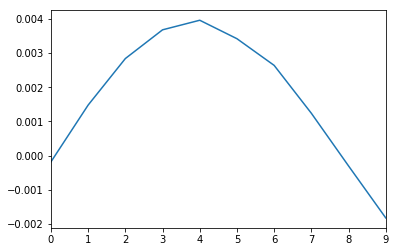

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.209x.dat


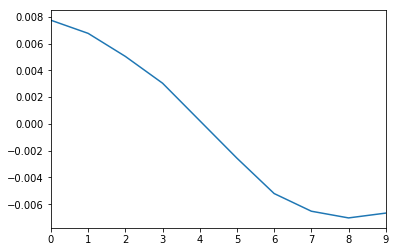

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.209x.dat


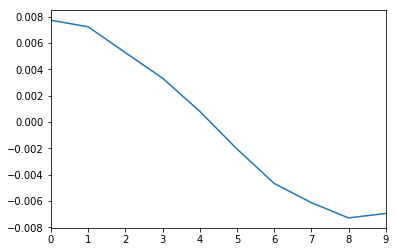

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.2105x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.2105x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.2105x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.2105x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal 0.2135x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal 0.2135x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal 0.2135x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal 0.2135x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal 0.2165x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal 0.2165x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal 0.2165x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal 0.2165x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal 0.2195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal 0.2195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal 0.2195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal 0.2195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.2015x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal 0.2225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal 0.2225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal 0.2225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal 0.2225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal 0.2255x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.2015x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -500_to_-50 BExternal 0.2255x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -500_to_-50 BExternal 0.2255x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -500_to_-50 BExternal 0.2255x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -500_to_-50 BExternal 0.2285x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -500_to_-50 BExternal 0.2285x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -500_to_-50 BExternal 0.2285x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.2015x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -500_to_-50 BExternal 0.2285x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -500_to_-50 BExternal 0.2315x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -500_to_-50 BExternal 0.2315x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -500_to_-50 BExternal 0.2315x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -500_to_-50 BExternal 0.2315x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.2015x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -500_to_-50 BExternal 0.2345x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -500_to_-50 BExternal 0.2345x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -500_to_-50 BExternal 0.2345x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -500_to_-50 BExternal 0.2345x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_1.5mTstep___818.52nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal -0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal -0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal -0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal -0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal -0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal -0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal -0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal -0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal -0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal -0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal -0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal -0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal -0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -500_to_-50 BExternal -0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -500_to_-50 BExternal -0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -500_to_-50 BExternal -0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -500_to_-50 BExternal -0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -500_to_-50 BExternal -0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -500_to_-50 BExternal -0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -500_to_-50 BExternal -0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -500_to_-50 BExternal -0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal -0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -500_to_-50 BExternal -0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -500_to_-50 BExternal -0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -500_to_-50 BExternal -0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -500_to_-50 BExternal -0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -500_to_-50 BExternal -0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -500_to_-50 BExternal -0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -500_to_-50 BExternal -0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -500_to_-50 BExternal -0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -500_to_-50 BExternal -0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -500_to_-50 BExternal -0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal -0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -500_to_-50 BExternal -0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -500_to_-50 BExternal -0.184x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -500_to_-50 BExternal -0.184x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal -0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal -0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal -0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal -0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal -0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal -0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal -0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal -0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal -0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal -0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal -0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal -0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal -0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal -0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal -0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal -0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal -0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal -0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal -0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal -0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal -0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal -0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal -0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal -0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal -0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal -0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal -0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal -0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal -0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal -0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal -0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal -0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal -0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal -0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal -0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal -0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal -0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal -0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal -0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal -0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal -0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal -0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal -0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal -0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal -0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal -0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal -0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal -0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal -0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal -0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal -0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal -0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal -0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal -0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal -0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal -0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal -0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal -0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal -0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal -0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal -0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal -0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal -0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -500_to_-50 BExternal -0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -500_to_-50 BExternal -0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -500_to_-50 BExternal -0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -500_to_-50 BExternal -0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -500_to_-50 BExternal -0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -500_to_-50 BExternal -0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -500_to_-50 BExternal -0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -500_to_-50 BExternal -0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -500_to_-50 BExternal -0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -500_to_-50 BExternal -0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal -0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -500_to_-50 BExternal -0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -500_to_-50 BExternal -0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -500_to_-50 BExternal -0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -500_to_-50 BExternal -0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -500_to_-50 BExternal -0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -500_to_-50 BExternal -0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -500_to_-50 BExternal -0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -500_to_-50 BExternal -0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -500_to_-50 BExternal -0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -500_to_-50 BExternal -0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal -0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -500_to_-50 BExternal -0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -500_to_-50 BExternal -0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -500_to_-50 BExternal -0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -500_to_-50 BExternal -0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -500_to_-50 BExternal -0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -500_to_-50 BExternal -0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -500_to_-50 BExternal -0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -500_to_-50 BExternal -0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -500_to_-50 BExternal -0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -500_to_-50 BExternal -0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_negative___818.54nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal -0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep_short___818.53nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -500_to_-50 BExternal 0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -500_to_-50 BExternal 0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -500_to_-50 BExternal 0.184x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -500_to_-50 BExternal 0.184x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.188x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_2mTstep___818.55nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal 0.249x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal 0.249x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal 0.249x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal 0.249x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.189x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal 0.249x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -500_to_-50 BExternal 0.25x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_133_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_134_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_135_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_136_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_137_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_138_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_139_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_13_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_140_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_141_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_142_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_143_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_144_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_145_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_146_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_147_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_148_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_149_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_14_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_150_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_151_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_152_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_153_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_154_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_155_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_156_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_157_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_158_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_159_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_15_DelayTime -500_to_-50 BExternal 0.192x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_160_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_161_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_162_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_163_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_164_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_165_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_166_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_167_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_168_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_169_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_16_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_170_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_171_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_172_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_173_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_174_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_175_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_176_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_177_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_178_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_179_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_17_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_180_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_181_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_182_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_183_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_184_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_185_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_186_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_187_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_188_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_189_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_18_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_190_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_191_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_192_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_193_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_194_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_195_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_196_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_197_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_198_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_199_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_19_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_200_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_201_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_202_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_203_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_204_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_205_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_206_DelayTime -500_to_-50 BExternal 0.193x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_207_DelayTime -500_to_-50 BExternal 0.193x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_208_DelayTime -500_to_-50 BExternal 0.193x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_209_DelayTime -500_to_-50 BExternal 0.193x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_20_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_210_DelayTime -500_to_-50 BExternal 0.193x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_211_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_212_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_213_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_214_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_215_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_216_DelayTime -500_to_-50 BExternal 0.187x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_217_DelayTime -500_to_-50 BExternal 0.187x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_218_DelayTime -500_to_-50 BExternal 0.187x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_219_DelayTime -500_to_-50 BExternal 0.187x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_21_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_220_DelayTime -500_to_-50 BExternal 0.187x.dat


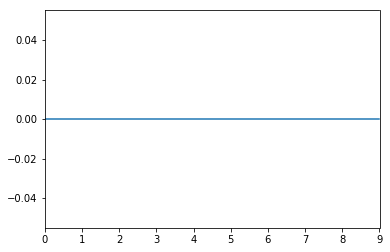

C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_22_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_23_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_24_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_25_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_26_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_27_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_28_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_29_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_2_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_30_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_31_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_32_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_33_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_34_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_35_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_36_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_37_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_38_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_39_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_3_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_40_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_41_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_42_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_43_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_44_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_45_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_46_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_47_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_48_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_49_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_4_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_50_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_51_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_52_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_53_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_54_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_55_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_56_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_57_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_58_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_59_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_5_DelayTime -500_to_-50 BExternal 0.186x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_60_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_61_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_62_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_63_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_64_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_65_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_66_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_67_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_68_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_69_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_6_DelayTime -500_to_-50 BExternal 0.189x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_70_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_71_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_72_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_73_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_74_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_75_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_76_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_77_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_78_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_79_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_7_DelayTime -500_to_-50 BExternal 0.189x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_80_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_81_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_82_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_83_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_84_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_85_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_86_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_87_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_88_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_89_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_8_DelayTime -500_to_-50 BExternal 0.189x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_90_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_91_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_92_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_93_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_94_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_95_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_96_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_97_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_98_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_99_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_3.0mTstep___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_9_DelayTime -500_to_-50 BExternal 0.189x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1000_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1001_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1002_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1003_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1004_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1005_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1006_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1007_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1008_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1009_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_100_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1010_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1011_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1012_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1013_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1014_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1015_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1016_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1017_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1018_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1019_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_101_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1020_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1021_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1022_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1023_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1024_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1025_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1026_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1027_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1028_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1029_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_102_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1030_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1031_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1032_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1033_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1034_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1035_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1036_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1037_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1038_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1039_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_103_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1040_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1041_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1042_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1043_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1044_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1045_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1046_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1047_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1048_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1049_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_104_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1050_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1051_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1052_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1053_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1054_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1055_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1056_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1057_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1058_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1059_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_105_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1060_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1061_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1062_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1063_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1064_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1065_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1066_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1067_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1068_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1069_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_106_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1070_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1071_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1072_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1073_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1074_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1075_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1076_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1077_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1078_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1079_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_107_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1080_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1081_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1082_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1083_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1084_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1085_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1086_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1087_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1088_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1089_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_108_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1090_DelayTime -500_to_-50 BExternal 0.194x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1091_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1092_DelayTime -500_to_-50 BExternal 0.195x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1093_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1094_DelayTime -500_to_-50 BExternal 0.196x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1095_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1096_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1097_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1098_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1099_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_109_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_10_DelayTime -500_to_-50 BExternal 0.19x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1100_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1101_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1102_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1103_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1104_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1105_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1106_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1107_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1108_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1109_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_110_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1110_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1111_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1112_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1113_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1114_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1115_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1116_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1117_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1118_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1119_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_111_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1120_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1121_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1122_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1123_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1124_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1125_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1126_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1127_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1128_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1129_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_112_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1130_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1131_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1132_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1133_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1134_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1135_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1136_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1137_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1138_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1139_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_113_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1140_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1141_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1142_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1143_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1144_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1145_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1146_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1147_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1148_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1149_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_114_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1150_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1151_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1152_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1153_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1154_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1155_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1156_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1157_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1158_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1159_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_115_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1160_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1161_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1162_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1163_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1164_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1165_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1166_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1167_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1168_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1169_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_116_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1170_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1171_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1172_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1173_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1174_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1175_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1176_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1177_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1178_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1179_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_117_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1180_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1181_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1182_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1183_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1184_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1185_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1186_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1187_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1188_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1189_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_118_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1190_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1191_DelayTime -500_to_-50 BExternal 0.245x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1192_DelayTime -500_to_-50 BExternal 0.245x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1193_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1194_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1195_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1196_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1197_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1198_DelayTime -500_to_-50 BExternal 0.248x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1199_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_119_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_11_DelayTime -500_to_-50 BExternal 0.191x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1200_DelayTime -500_to_-50 BExternal 0.247x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1201_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1202_DelayTime -500_to_-50 BExternal 0.246x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1203_DelayTime -500_to_-50 BExternal 0.245x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1204_DelayTime -500_to_-50 BExternal 0.245x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1205_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1206_DelayTime -500_to_-50 BExternal 0.244x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1207_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1208_DelayTime -500_to_-50 BExternal 0.243x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1209_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_120_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1210_DelayTime -500_to_-50 BExternal 0.242x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1211_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1212_DelayTime -500_to_-50 BExternal 0.241x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1213_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1214_DelayTime -500_to_-50 BExternal 0.24x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1215_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1216_DelayTime -500_to_-50 BExternal 0.239x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1217_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1218_DelayTime -500_to_-50 BExternal 0.238x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1219_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_121_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1220_DelayTime -500_to_-50 BExternal 0.237x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1221_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1222_DelayTime -500_to_-50 BExternal 0.236x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1223_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1224_DelayTime -500_to_-50 BExternal 0.235x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1225_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1226_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1227_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1228_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1229_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_122_DelayTime -500_to_-50 BExternal 0.234x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1230_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1231_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1232_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1233_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1234_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1235_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1236_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1237_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1238_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1239_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_123_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1240_DelayTime -500_to_-50 BExternal 0.227x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1241_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1242_DelayTime -500_to_-50 BExternal 0.226x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1243_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1244_DelayTime -500_to_-50 BExternal 0.225x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1245_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1246_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1247_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1248_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1249_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_124_DelayTime -500_to_-50 BExternal 0.233x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1250_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1251_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1252_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1253_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1254_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1255_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1256_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1257_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1258_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1259_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_125_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1260_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1261_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1262_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1263_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1264_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1265_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1266_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1267_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1268_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1269_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_126_DelayTime -500_to_-50 BExternal 0.232x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1270_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1271_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1272_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1273_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1274_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1275_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1276_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1277_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1278_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1279_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_127_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1280_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1281_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1282_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1283_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1284_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1285_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1286_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1287_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1288_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1289_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_128_DelayTime -500_to_-50 BExternal 0.231x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1290_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1291_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1292_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1293_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1294_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1295_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1296_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1297_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1298_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1299_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_129_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_12_DelayTime -500_to_-50 BExternal 0.191x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1300_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1301_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1302_DelayTime -500_to_-50 BExternal 0.197x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1303_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1304_DelayTime -500_to_-50 BExternal 0.198x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1305_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1306_DelayTime -500_to_-50 BExternal 0.199x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1307_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1308_DelayTime -500_to_-50 BExternal 0.2x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1309_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_130_DelayTime -500_to_-50 BExternal 0.23x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1310_DelayTime -500_to_-50 BExternal 0.201x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1311_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1312_DelayTime -500_to_-50 BExternal 0.202x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1313_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1314_DelayTime -500_to_-50 BExternal 0.203x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1315_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1316_DelayTime -500_to_-50 BExternal 0.204x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1317_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1318_DelayTime -500_to_-50 BExternal 0.205x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1319_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_131_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1320_DelayTime -500_to_-50 BExternal 0.206x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1321_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1322_DelayTime -500_to_-50 BExternal 0.207x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1323_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1324_DelayTime -500_to_-50 BExternal 0.208x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1325_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1326_DelayTime -500_to_-50 BExternal 0.209x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1327_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1328_DelayTime -500_to_-50 BExternal 0.21x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1329_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_132_DelayTime -500_to_-50 BExternal 0.229x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1330_DelayTime -500_to_-50 BExternal 0.211x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1331_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1332_DelayTime -500_to_-50 BExternal 0.212x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1333_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1334_DelayTime -500_to_-50 BExternal 0.213x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1335_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1336_DelayTime -500_to_-50 BExternal 0.214x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1337_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1338_DelayTime -500_to_-50 BExternal 0.215x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1339_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_133_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1340_DelayTime -500_to_-50 BExternal 0.216x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1341_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1342_DelayTime -500_to_-50 BExternal 0.217x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1343_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1344_DelayTime -500_to_-50 BExternal 0.218x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1345_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1346_DelayTime -500_to_-50 BExternal 0.219x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1347_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1348_DelayTime -500_to_-50 BExternal 0.22x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1349_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_134_DelayTime -500_to_-50 BExternal 0.228x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1350_DelayTime -500_to_-50 BExternal 0.221x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1351_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1352_DelayTime -500_to_-50 BExternal 0.222x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1353_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1354_DelayTime -500_to_-50 BExternal 0.223x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1355_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1356_DelayTime -500_to_-50 BExternal 0.224x.dat


C:\Data\apr2017\170409\TestPhaseShift_1030uWpump_jumpingaround___818.50nm_10K_2Dscan_BExternal_DelayTime\Ind_1357_DelayTime -500_to_-50 BExternal 0.225x.dat


KeyboardInterrupt: 

In [7]:
for df, metadata, filepath in zip(file_dataframes_list,
                                  file_metadata_list,
                                  filtered_filepath_list):
    print(filepath)
    plt.figure()
    df.lockin1x.plot()
    plt.show()
